## Import libraries

In [1]:
# Python libraries
import os
import sys
import pandas as pd # for data manipulation
import numpy as np # for data manipulation
import tensorflow as tf
from sklearn.model_selection import train_test_split
from datetime import datetime
import time

# Plotting
import matplotlib.pyplot as plt

# To enable LaTeX and select a font
plt.rcParams.update({
    "text.usetex": True,
    "font.family": "sans-serif",
    "font.sans-serif": "Helvetica",
})

# Using ipynb import functions defined in other nb
sys.path.append("myfun/")
from ipynb.fs.defs.myfun_load_dataset import *
from ipynb.fs.full.myfun_model_nn import *
from ipynb.fs.defs.myfun_plot import *

2024-02-09 10:16:57.993616: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:9261] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-02-09 10:16:57.993649: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:607] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-02-09 10:16:57.994482: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1515] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2024-02-09 10:16:58.000035: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2024-02-09 10:16:59.053596: W tensorflow/compiler/tf2

## Data Acquisition

In [2]:
# Load the dataset
par_dir = os.path.dirname(os.getcwd()) # parent dir
dir_name = par_dir + "/NN-interaction"

In [3]:
processed_flag = 'pre'
# load the data
_, dflist = load_dataset(dir_name, processed_flag)
dataset = dflist

print(f"In this dataset we have {np.sum([d.shape[0] for d in dataset])} scenes")

In this dataset we have 671 scenes


## Params

In [4]:
DOE =[1,2,2,1] #Design of experiment

In [5]:
v0 = 30
NUM_ITER = 500
LEARNING_RATE_v0 = 0.5
test = 0.33

plot_flag = True
flag_save = True

----------------------------------------------------------------------------------------------------
Analyzing 10 dfs. NN structure: 1-2-2-1
****************************************************************************************************
Analyzing 1/10 dfs.
In DataFrame n.1 we have 109 scenes.
    To train the model we use 73 scenes, the remaining 36 to test the model.

Training step. (73 scenes)
DataFrame n.1. Scene n.1/73
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [239.44,240.24]


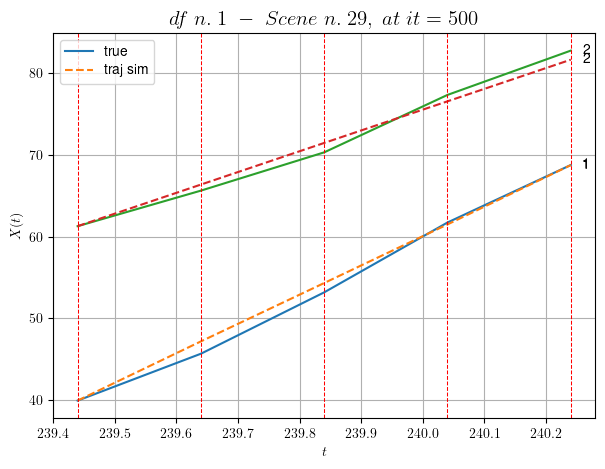

----------------------------------------------------------------------------------------------------
        For scene 1/73:
        * After LR finder: LR_NN=0.001 with mse=2.619515810097692 at it=24
        * v0 = 25.426381424530618
        * MSE = 0.6950378995677224
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.2/73
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [310.84,311.24]


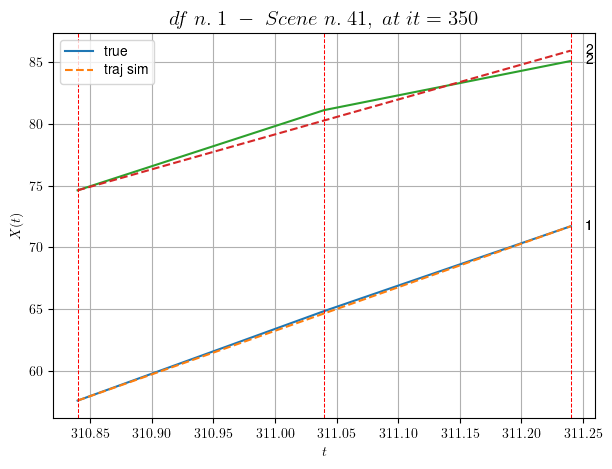

----------------------------------------------------------------------------------------------------
        For scene 2/73:
        * After LR finder: LR_NN=0.0001 with mse=0.42080446380358355 at it=24
        * v0 = 28.339874490953317
        * MSE = 0.2414878301260064
        * iterations = 350
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.3/73
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [52.84,53.84]


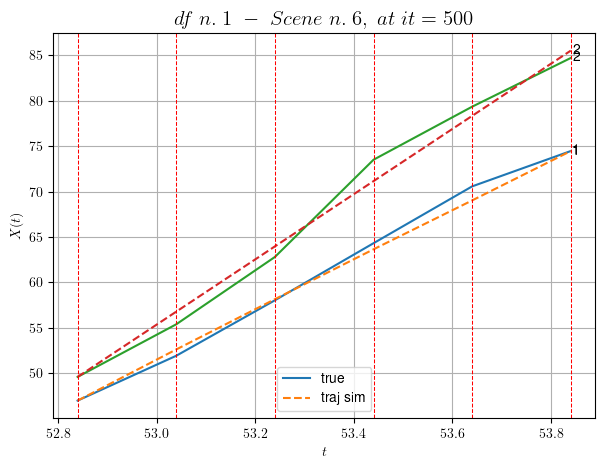

----------------------------------------------------------------------------------------------------
        For scene 3/73:
        * After LR finder: LR_NN=0.001 with mse=11.776857405500149 at it=24
        * v0 = 35.9128223540259
        * MSE = 1.147241467088139
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.4/73
----------------------------------------------------------------------------------------------------
We have 6 time intervals inside [362.84,364.04]


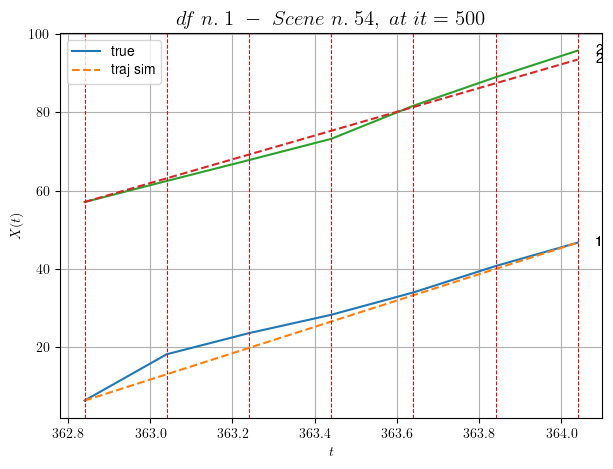

----------------------------------------------------------------------------------------------------
        For scene 4/73:
        * After LR finder: LR_NN=5e-05 with mse=3.6313365433526688 at it=24
        * v0 = 30.31397642834165
        * MSE = 4.205631313554281
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.5/73
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [444.24,445.24]


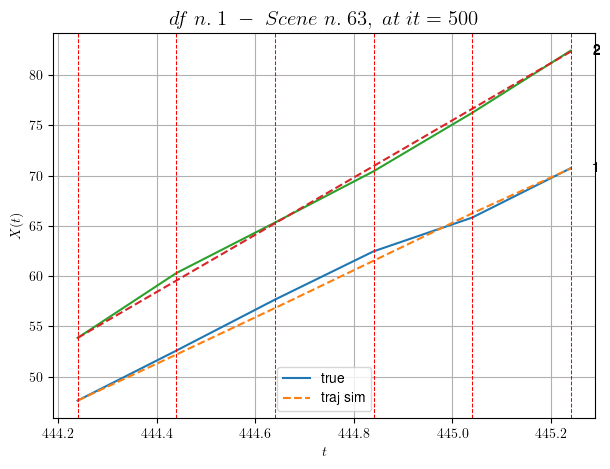

----------------------------------------------------------------------------------------------------
        For scene 5/73:
        * After LR finder: LR_NN=0.005 with mse=0.765212798302845 at it=24
        * v0 = 28.494973095575055
        * MSE = 0.2421351652623615
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.6/73
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [307.24,307.64]


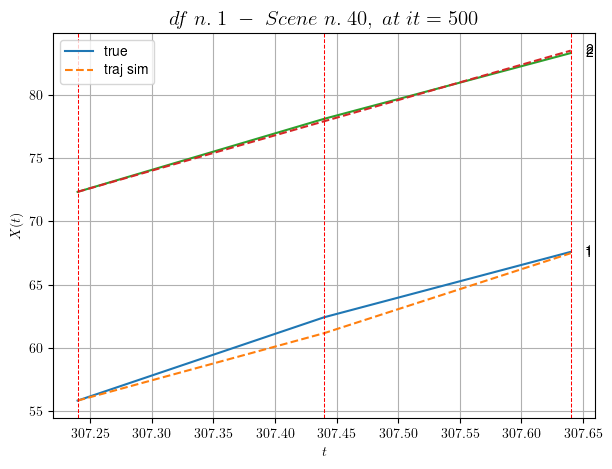

----------------------------------------------------------------------------------------------------
        For scene 6/73:
        * After LR finder: LR_NN=0.01 with mse=0.6887259237689116 at it=24
        * v0 = 27.873164065568336
        * MSE = 0.2765977467509235
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.7/73
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [294.64,295.24]


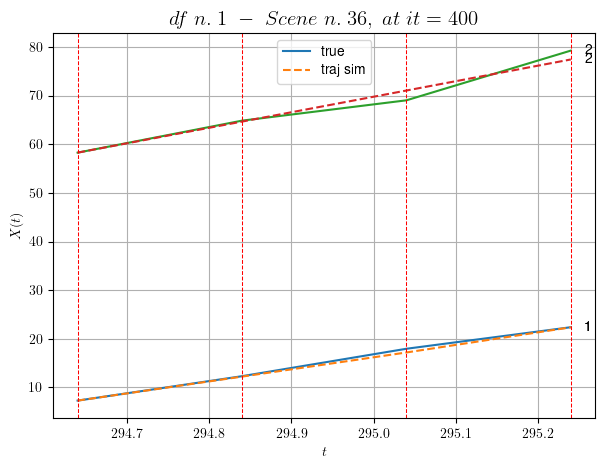

----------------------------------------------------------------------------------------------------
        For scene 7/73:
        * After LR finder: LR_NN=0.005 with mse=1.4391482939244453 at it=24
        * v0 = 31.912591416724307
        * MSE = 0.9944077216041243
        * iterations = 400
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.8/73
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [130.64,131.44]


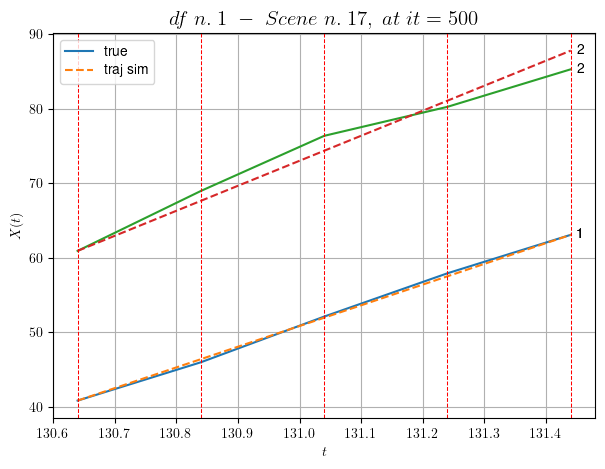

----------------------------------------------------------------------------------------------------
        For scene 8/73:
        * After LR finder: LR_NN=5e-05 with mse=1.8771624878747675 at it=24
        * v0 = 33.619245904294324
        * MSE = 1.309701453068483
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.9/73
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [496.84,497.64]


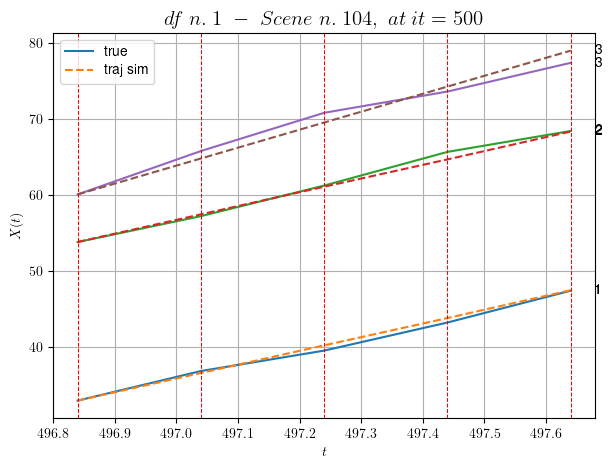

----------------------------------------------------------------------------------------------------
        For scene 9/73:
        * After LR finder: LR_NN=0.005 with mse=4.534717325195451 at it=24
        * v0 = 23.671022130118
        * MSE = 0.5045611681174828
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.10/73
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [291.64,292.64]


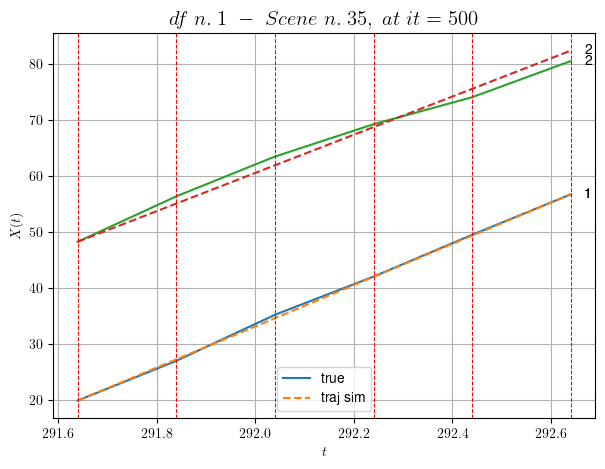

----------------------------------------------------------------------------------------------------
        For scene 10/73:
        * After LR finder: LR_NN=0.001 with mse=2.708142142994747 at it=24
        * v0 = 34.11909568875076
        * MSE = 0.7477161684127398
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.11/73
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [472.24,473.24]


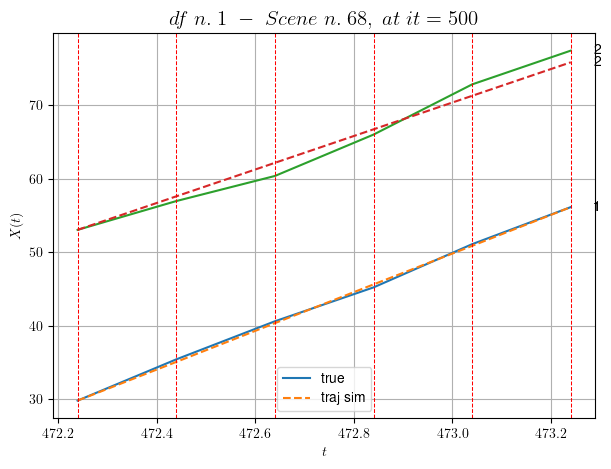

----------------------------------------------------------------------------------------------------
        For scene 11/73:
        * After LR finder: LR_NN=0.001 with mse=8.506387339301531 at it=24
        * v0 = 22.764702156056654
        * MSE = 0.6966739983732534
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.12/73
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [56.84,57.64]


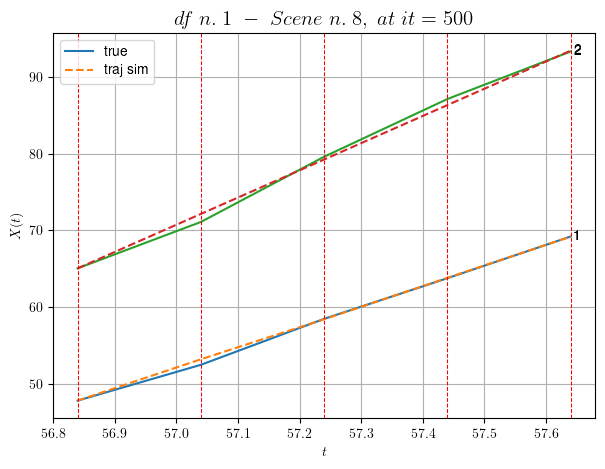

----------------------------------------------------------------------------------------------------
        For scene 12/73:
        * After LR finder: LR_NN=0.005 with mse=4.232580367744269 at it=24
        * v0 = 35.49695649017779
        * MSE = 0.23910308631186095
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.13/73
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [320.44,321.24]


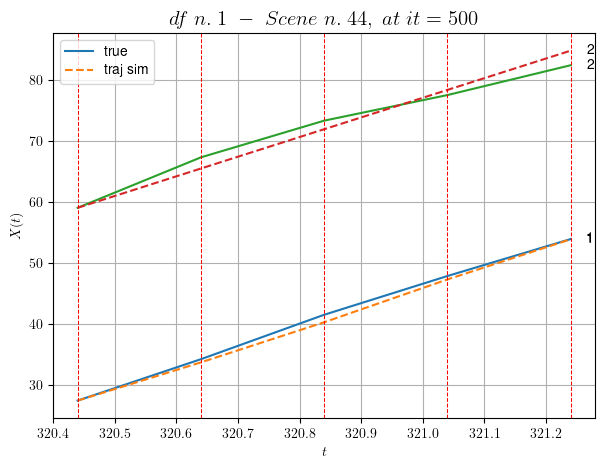

----------------------------------------------------------------------------------------------------
        For scene 13/73:
        * After LR finder: LR_NN=0.01 with mse=1.257356393438588 at it=24
        * v0 = 32.19336724924262
        * MSE = 1.1487320751191439
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.14/73
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [463.04,463.64]


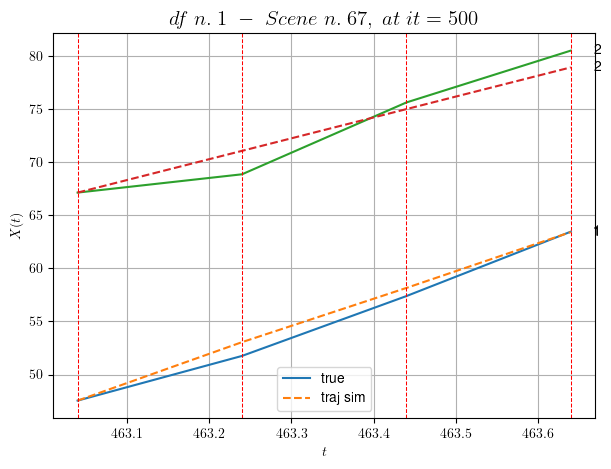

----------------------------------------------------------------------------------------------------
        For scene 14/73:
        * After LR finder: LR_NN=0.005 with mse=6.832313178351739 at it=24
        * v0 = 19.662006047653506
        * MSE = 1.1789984276138044
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.15/73
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [529.64,530.64]


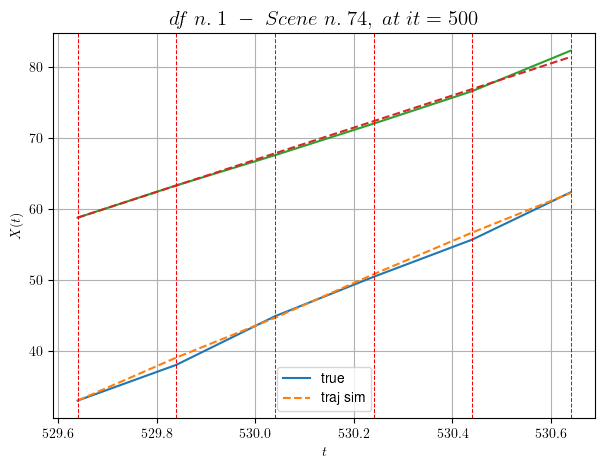

----------------------------------------------------------------------------------------------------
        For scene 15/73:
        * After LR finder: LR_NN=0.01 with mse=10.067723552105116 at it=24
        * v0 = 22.628998285033266
        * MSE = 0.26159582190073066
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.16/73
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [230.04,230.64]


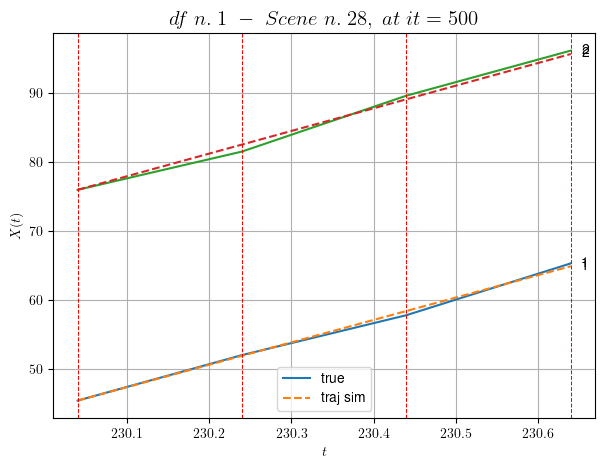

----------------------------------------------------------------------------------------------------
        For scene 16/73:
        * After LR finder: LR_NN=1e-05 with mse=0.9925249243187118 at it=24
        * v0 = 32.80710231491779
        * MSE = 0.26065113071716306
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.17/73
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [146.24,146.64]


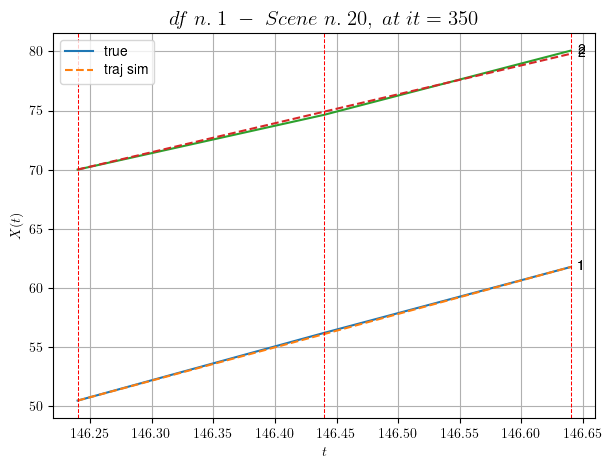

----------------------------------------------------------------------------------------------------
        For scene 17/73:
        * After LR finder: LR_NN=0.005 with mse=0.944430201079355 at it=24
        * v0 = 24.48103339277559
        * MSE = 0.02294964888014285
        * iterations = 350
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.18/73
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [164.04,164.64]


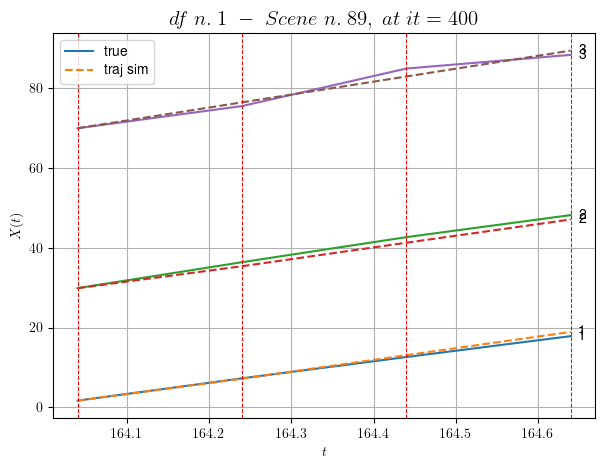

----------------------------------------------------------------------------------------------------
        For scene 18/73:
        * After LR finder: LR_NN=0.01 with mse=1.194151033112579 at it=24
        * v0 = 32.43284780829013
        * MSE = 0.9547274656450601
        * iterations = 400
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.19/73
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [262.64,263.64]


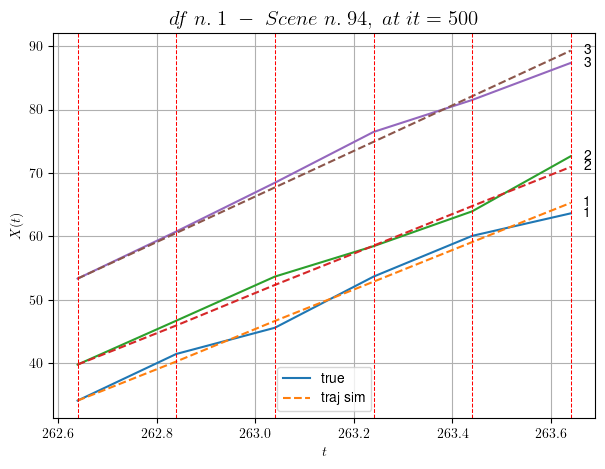

----------------------------------------------------------------------------------------------------
        For scene 19/73:
        * After LR finder: LR_NN=0.005 with mse=4.6437821156884835 at it=24
        * v0 = 35.93109742746383
        * MSE = 1.085156863261379
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.20/73
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [209.64,210.24]


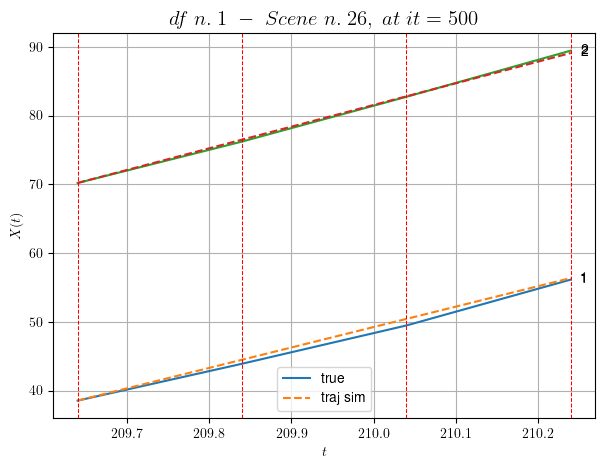

----------------------------------------------------------------------------------------------------
        For scene 20/73:
        * After LR finder: LR_NN=1e-05 with mse=0.29429880608420844 at it=24
        * v0 = 31.507071372239125
        * MSE = 0.18837879737111796
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.21/73
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [60.04,60.84]


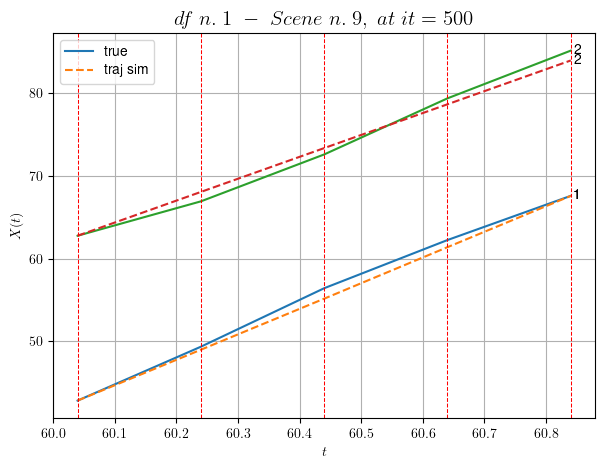

----------------------------------------------------------------------------------------------------
        For scene 21/73:
        * After LR finder: LR_NN=0.001 with mse=1.538719263748049 at it=24
        * v0 = 26.5216195910861
        * MSE = 0.5923036148238818
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.22/73
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [447.44,448.04]


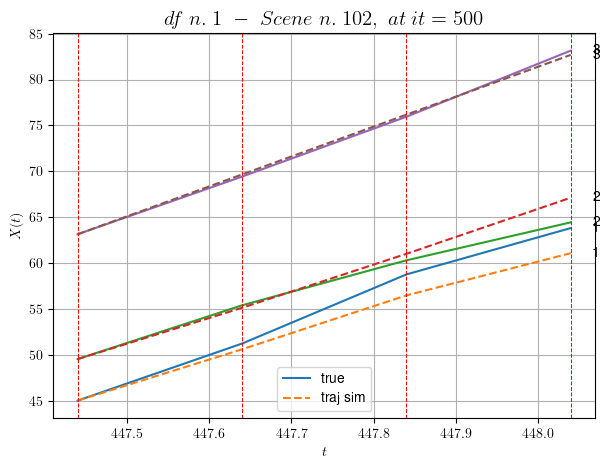

----------------------------------------------------------------------------------------------------
        For scene 22/73:
        * After LR finder: LR_NN=0.01 with mse=2.535498133184053 at it=24
        * v0 = 32.58486004517754
        * MSE = 1.7664863146327539
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.23/73
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [351.64,352.24]


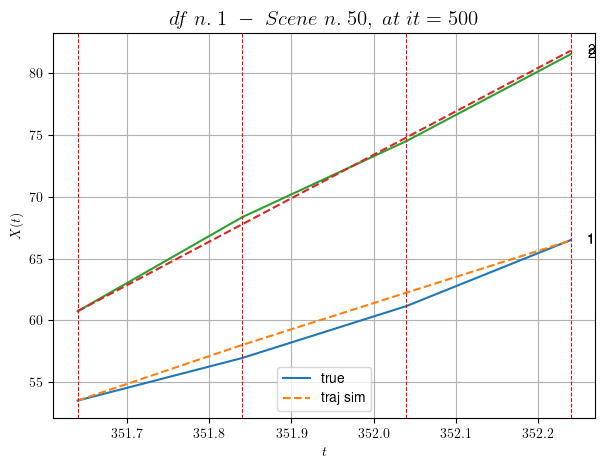

----------------------------------------------------------------------------------------------------
        For scene 23/73:
        * After LR finder: LR_NN=0.005 with mse=2.0262796274401143 at it=24
        * v0 = 35.128237730719775
        * MSE = 0.34205662512383533
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.24/73
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [109.24,109.84]


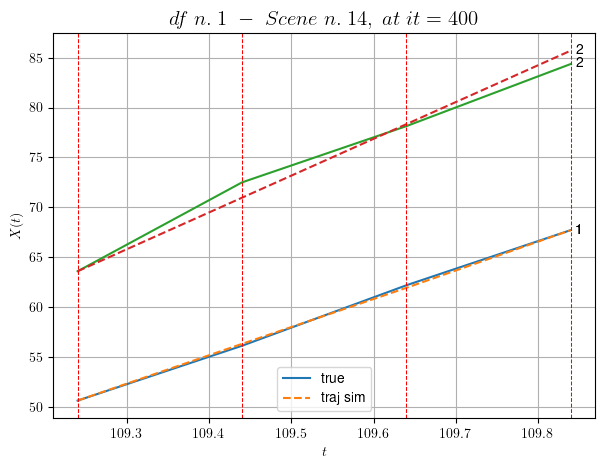

----------------------------------------------------------------------------------------------------
        For scene 24/73:
        * After LR finder: LR_NN=0.005 with mse=2.856891958023737 at it=24
        * v0 = 36.8703602591193
        * MSE = 0.4670224921685402
        * iterations = 400
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.25/73
----------------------------------------------------------------------------------------------------
We have 8 time intervals inside [571.04,572.64]


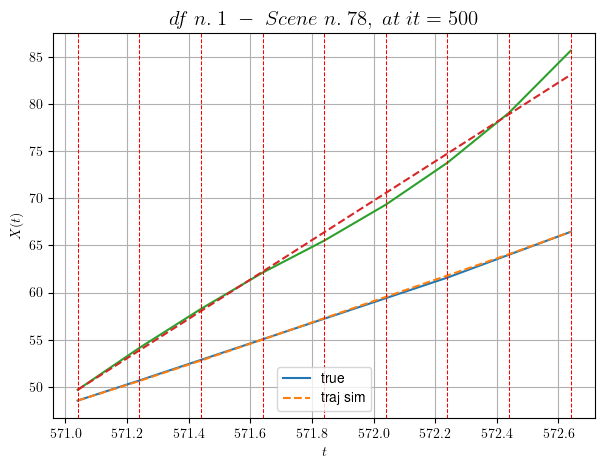

----------------------------------------------------------------------------------------------------
        For scene 25/73:
        * After LR finder: LR_NN=0.01 with mse=37.00154734647645 at it=24
        * v0 = 20.87712250055454
        * MSE = 0.557759967945613
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.26/73
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [200.44,201.24]


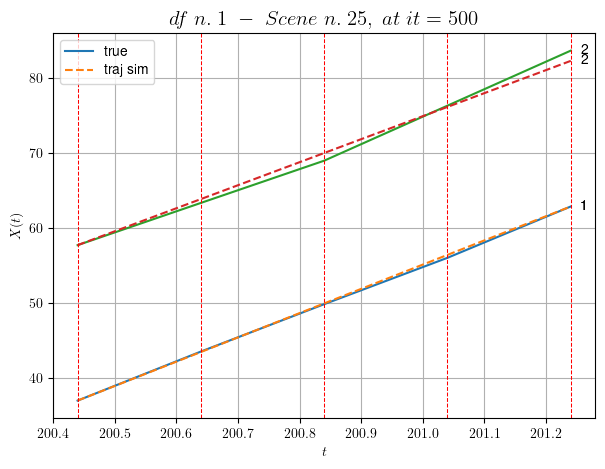

----------------------------------------------------------------------------------------------------
        For scene 26/73:
        * After LR finder: LR_NN=0.001 with mse=0.4953226332387695 at it=24
        * v0 = 30.71027389121878
        * MSE = 0.33646255603622544
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.27/73
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [37.44,38.24]


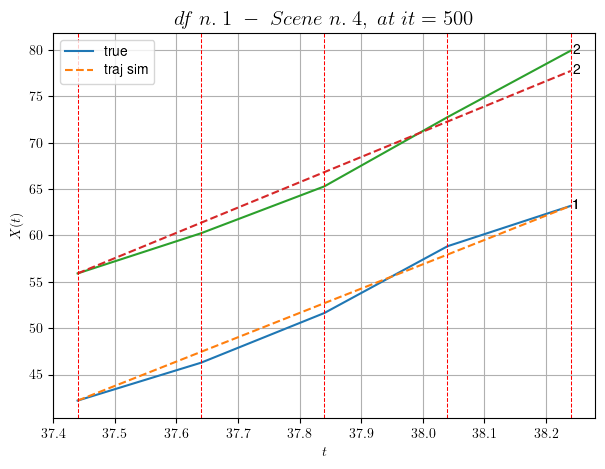

----------------------------------------------------------------------------------------------------
        For scene 27/73:
        * After LR finder: LR_NN=0.0001 with mse=1.4973083197725008 at it=24
        * v0 = 27.295254165821017
        * MSE = 1.1983204751073093
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.28/73
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [140.64,141.24]


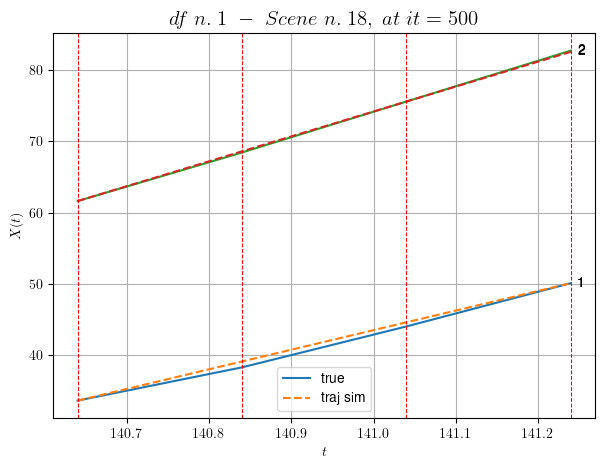

----------------------------------------------------------------------------------------------------
        For scene 28/73:
        * After LR finder: LR_NN=0.0001 with mse=1.8481241429801156 at it=24
        * v0 = 34.92834910020641
        * MSE = 0.13014786890000965
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.29/73
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [301.44,302.44]


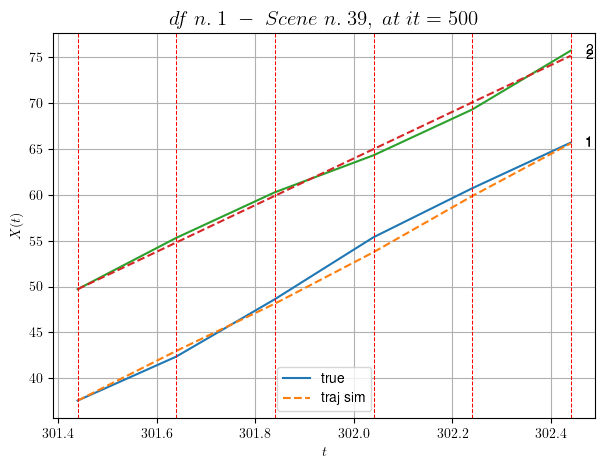

----------------------------------------------------------------------------------------------------
        For scene 29/73:
        * After LR finder: LR_NN=0.01 with mse=4.504032839118529 at it=24
        * v0 = 25.446081747008424
        * MSE = 0.4803483382976731
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.30/73
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [131.64,132.04]


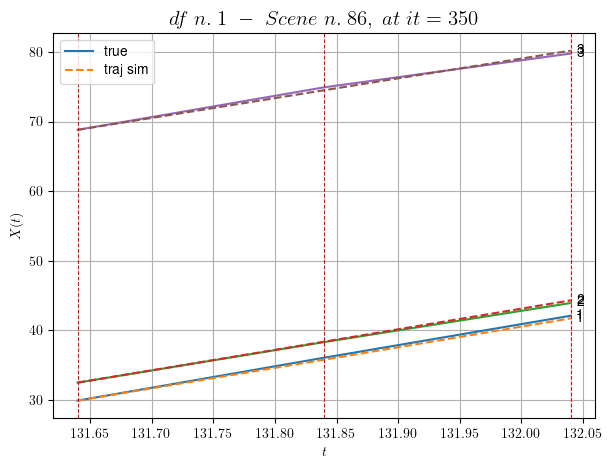

----------------------------------------------------------------------------------------------------
        For scene 30/73:
        * After LR finder: LR_NN=0.005 with mse=0.16289347703205492 at it=24
        * v0 = 28.442903953640887
        * MSE = 0.07946435755035891
        * iterations = 350
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.31/73
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [54.84,55.24]


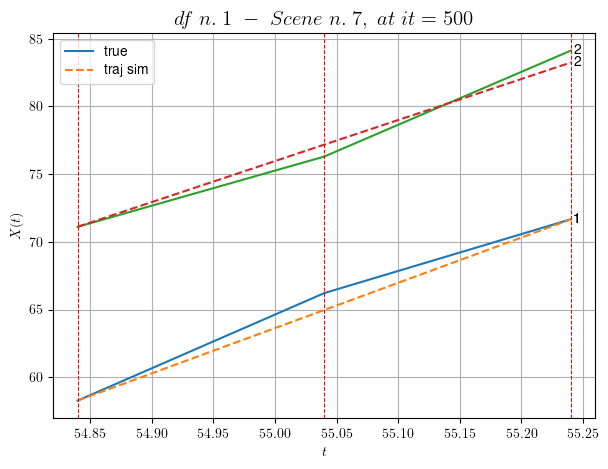

----------------------------------------------------------------------------------------------------
        For scene 31/73:
        * After LR finder: LR_NN=5e-05 with mse=0.5307461046183052 at it=24
        * v0 = 30.333444658289146
        * MSE = 0.5183015028170634
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.32/73
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [499.04,499.44]


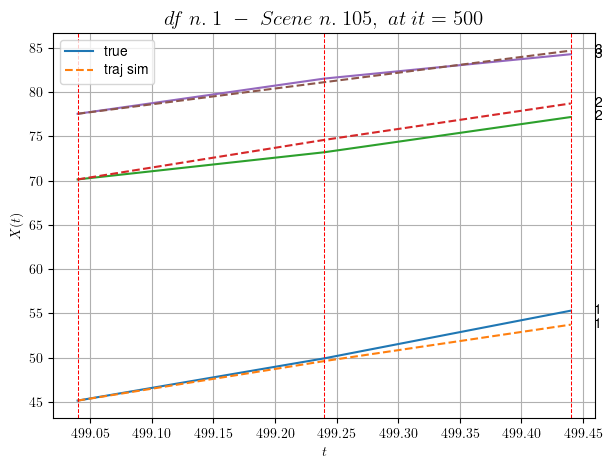

----------------------------------------------------------------------------------------------------
        For scene 32/73:
        * After LR finder: LR_NN=0.01 with mse=4.333283451651709 at it=24
        * v0 = 17.832163517130613
        * MSE = 0.7977478986984248
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.33/73
----------------------------------------------------------------------------------------------------
We have 6 time intervals inside [325.24,326.44]


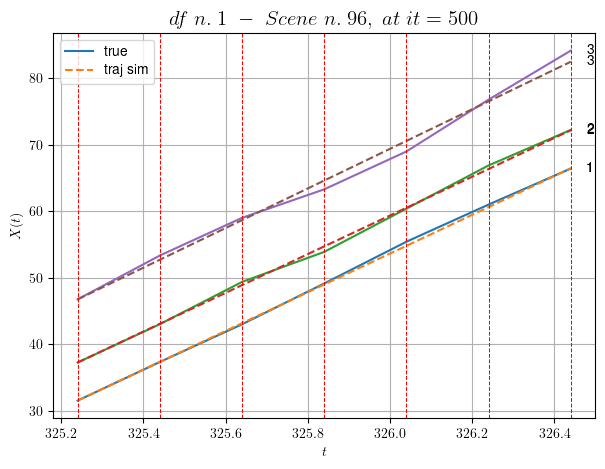

----------------------------------------------------------------------------------------------------
        For scene 33/73:
        * After LR finder: LR_NN=0.001 with mse=19.42798504407398 at it=24
        * v0 = 29.804033810068084
        * MSE = 0.45095030828038635
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.34/73
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [240.64,241.04]


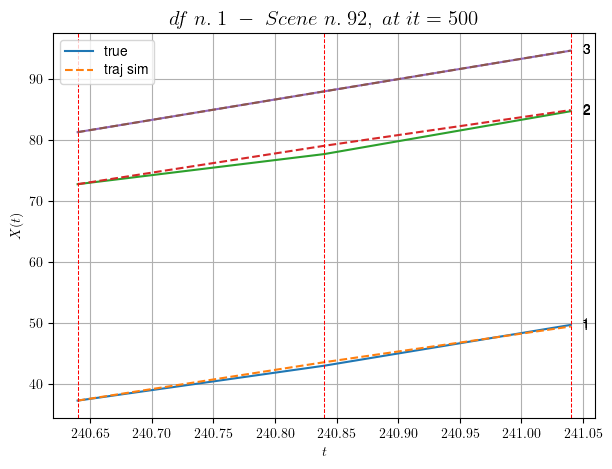

----------------------------------------------------------------------------------------------------
        For scene 34/73:
        * After LR finder: LR_NN=0.005 with mse=0.5389552804475669 at it=24
        * v0 = 33.344769841085835
        * MSE = 0.24234849057332997
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.35/73
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [380.24,380.64]


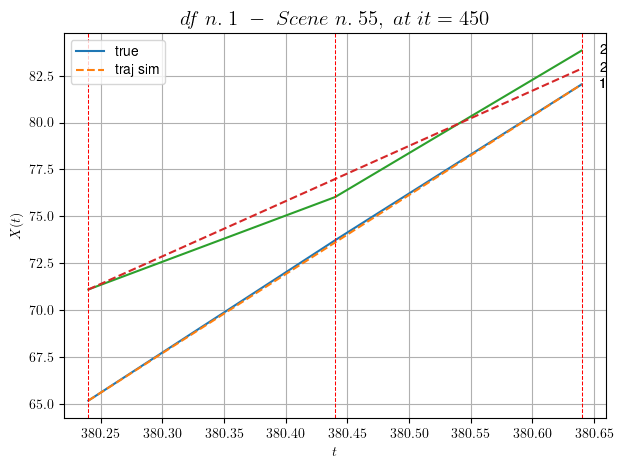

----------------------------------------------------------------------------------------------------
        For scene 35/73:
        * After LR finder: LR_NN=0.0001 with mse=2.179448021469908 at it=24
        * v0 = 29.44122626537817
        * MSE = 0.31122440334453294
        * iterations = 450
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.36/73
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [352.84,353.84]


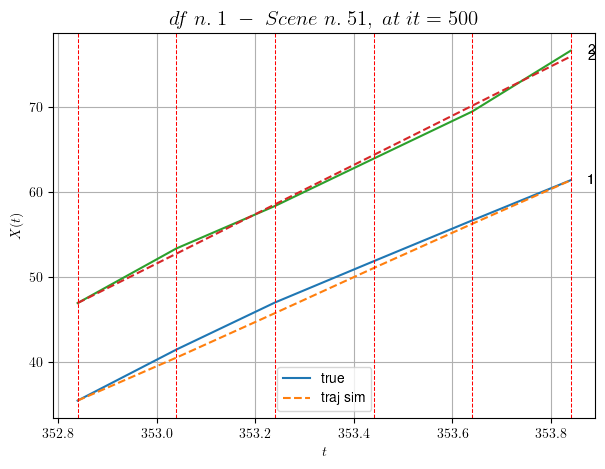

----------------------------------------------------------------------------------------------------
        For scene 36/73:
        * After LR finder: LR_NN=0.005 with mse=0.5904185188012228 at it=24
        * v0 = 29.028563577797847
        * MSE = 0.39788380769262743
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.37/73
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [386.64,387.44]


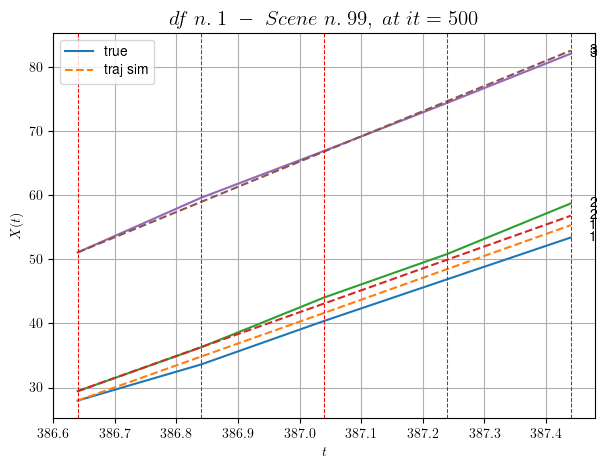

----------------------------------------------------------------------------------------------------
        For scene 37/73:
        * After LR finder: LR_NN=0.001 with mse=7.526678634369766 at it=24
        * v0 = 39.346100167623
        * MSE = 1.0209100532885647
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.38/73
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [335.24,335.84]


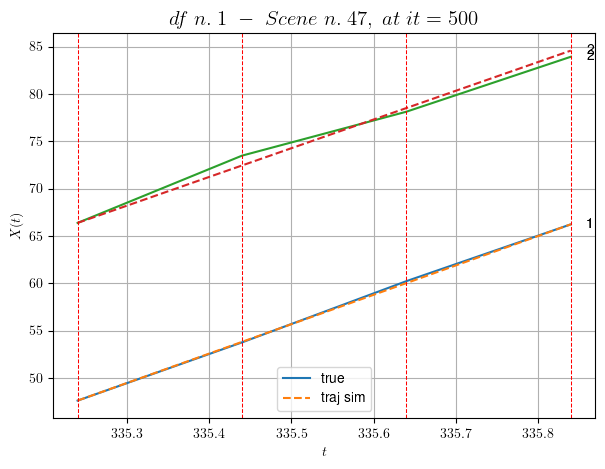

----------------------------------------------------------------------------------------------------
        For scene 38/73:
        * After LR finder: LR_NN=5e-05 with mse=0.18743472525783827 at it=24
        * v0 = 30.33723938744823
        * MSE = 0.21110622046040825
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.39/73
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [72.44,73.44]


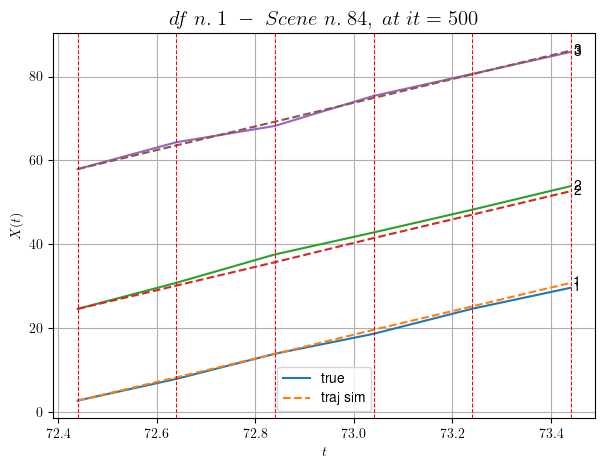

----------------------------------------------------------------------------------------------------
        For scene 39/73:
        * After LR finder: LR_NN=0.005 with mse=1.1747599066817098 at it=24
        * v0 = 28.250920573908292
        * MSE = 0.732833927844021
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.40/73
----------------------------------------------------------------------------------------------------
We have 6 time intervals inside [431.04,432.24]


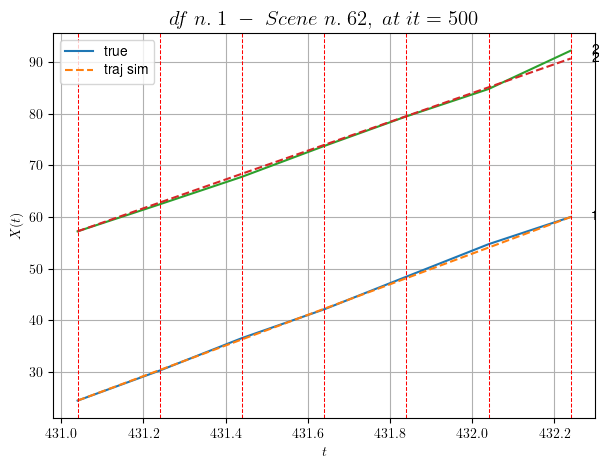

----------------------------------------------------------------------------------------------------
        For scene 40/73:
        * After LR finder: LR_NN=5e-05 with mse=1.074372168715488 at it=24
        * v0 = 27.914827173163157
        * MSE = 0.2540827303485048
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.41/73
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [500.64,501.04]


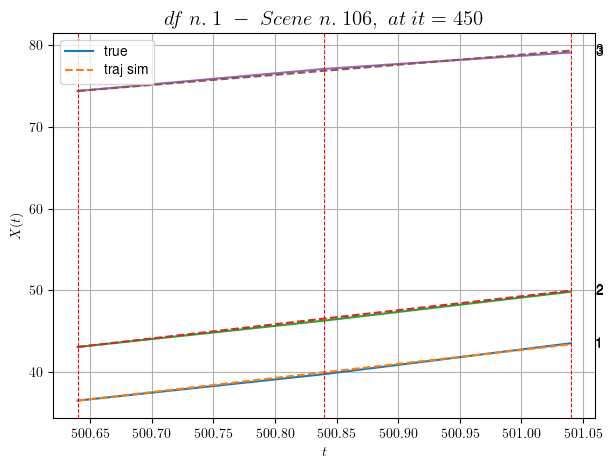

----------------------------------------------------------------------------------------------------
        For scene 41/73:
        * After LR finder: LR_NN=0.005 with mse=7.1238251475759276 at it=24
        * v0 = 12.361373747547571
        * MSE = 0.028153272655867107
        * iterations = 450
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.42/73
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [446.24,446.84]


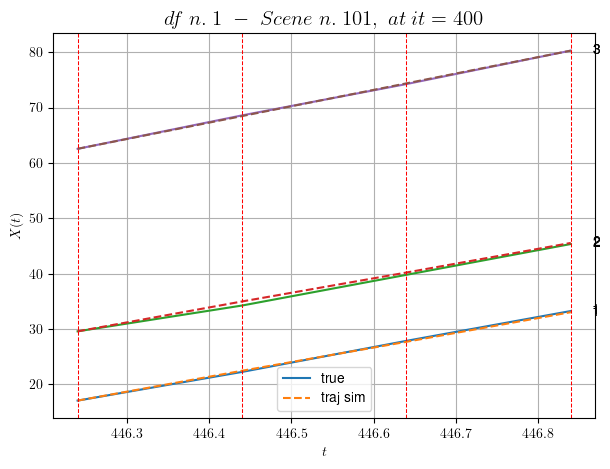

----------------------------------------------------------------------------------------------------
        For scene 42/73:
        * After LR finder: LR_NN=0.005 with mse=0.09138449065622294 at it=24
        * v0 = 29.554429783832404
        * MSE = 0.07491888471917377
        * iterations = 400
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.43/73
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [316.44,317.04]


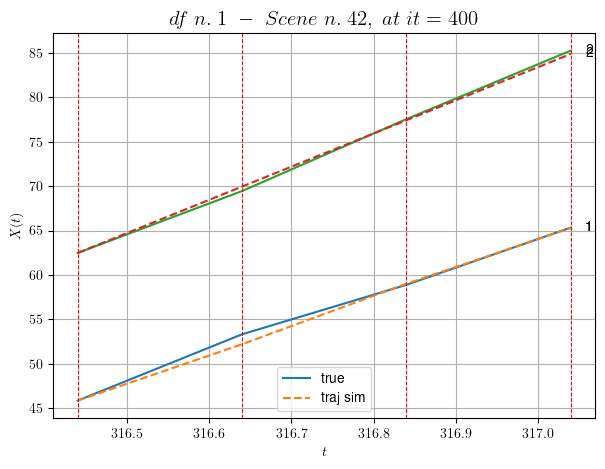

----------------------------------------------------------------------------------------------------
        For scene 43/73:
        * After LR finder: LR_NN=0.005 with mse=4.320086120017276 at it=24
        * v0 = 37.334341217713686
        * MSE = 0.20982927706499666
        * iterations = 400
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.44/73
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [403.64,404.64]


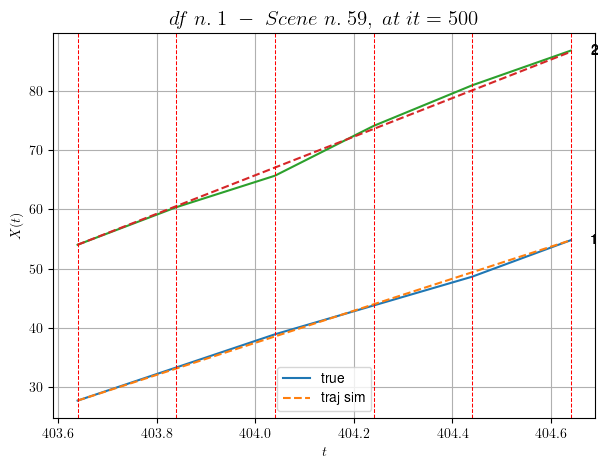

----------------------------------------------------------------------------------------------------
        For scene 44/73:
        * After LR finder: LR_NN=5e-05 with mse=1.9462283817827806 at it=24
        * v0 = 32.57978285326516
        * MSE = 0.3092626389134754
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.45/73
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [349.64,350.44]


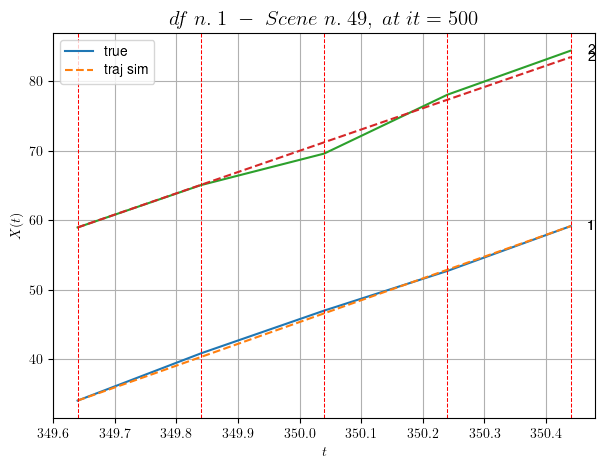

----------------------------------------------------------------------------------------------------
        For scene 45/73:
        * After LR finder: LR_NN=0.0001 with mse=0.5506955235791992 at it=24
        * v0 = 30.663808885196627
        * MSE = 0.4507046801585463
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.46/73
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [314.84,315.64]


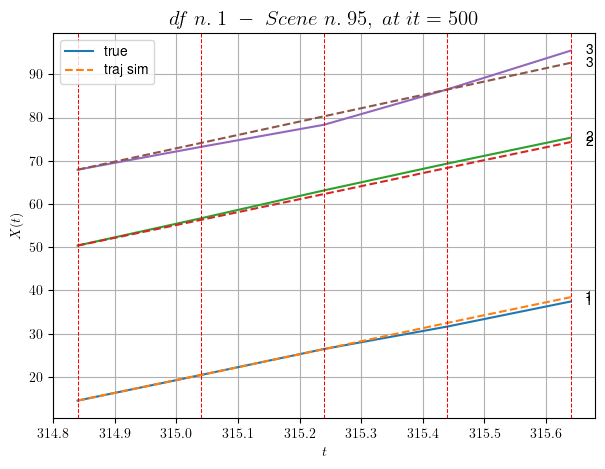

----------------------------------------------------------------------------------------------------
        For scene 46/73:
        * After LR finder: LR_NN=0.005 with mse=1.3769661081545805 at it=24
        * v0 = 30.926247858928804
        * MSE = 1.1457076370984312
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.47/73
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [402.04,402.84]


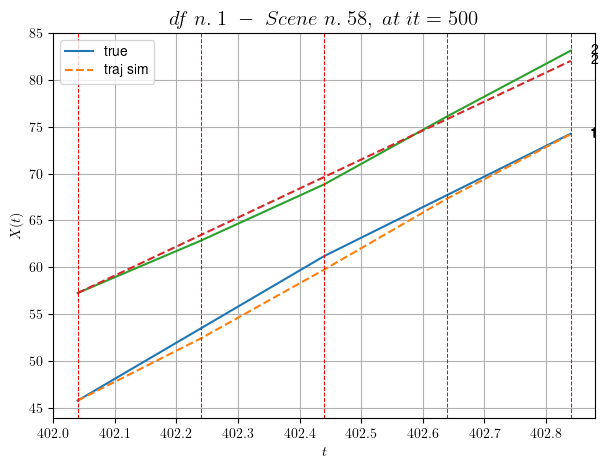

----------------------------------------------------------------------------------------------------
        For scene 47/73:
        * After LR finder: LR_NN=0.01 with mse=0.647363296166775 at it=24
        * v0 = 31.006759212235373
        * MSE = 0.4001916351374294
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.48/73
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [561.44,561.84]


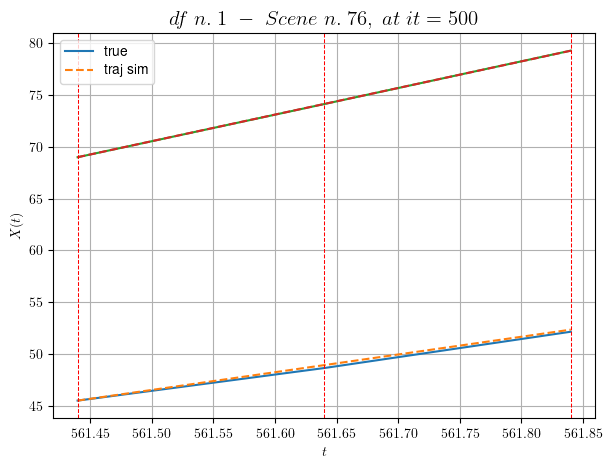

----------------------------------------------------------------------------------------------------
        For scene 48/73:
        * After LR finder: LR_NN=5e-05 with mse=0.6059512805894585 at it=24
        * v0 = 25.727722160464182
        * MSE = 0.01996957066424571
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.49/73
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [271.04,271.64]


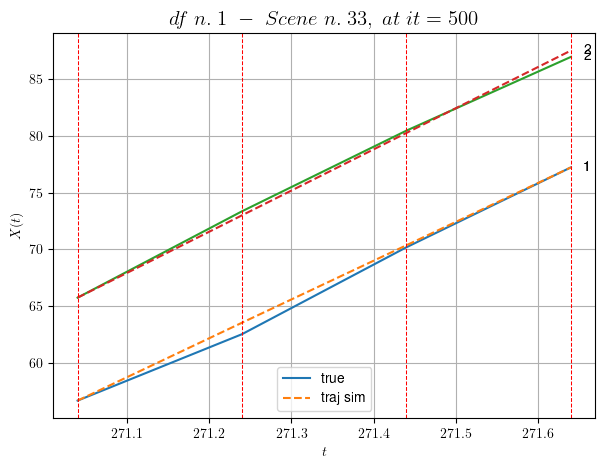

----------------------------------------------------------------------------------------------------
        For scene 49/73:
        * After LR finder: LR_NN=0.0005 with mse=2.630133772627839 at it=24
        * v0 = 36.298884665012594
        * MSE = 0.18669848199306227
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.50/73
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [573.84,574.44]


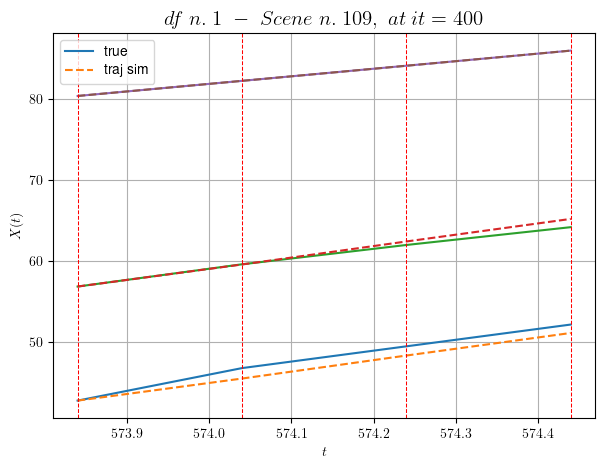

----------------------------------------------------------------------------------------------------
        For scene 50/73:
        * After LR finder: LR_NN=0.005 with mse=20.369244415559578 at it=24
        * v0 = 9.338746310354571
        * MSE = 0.4390500229439606
        * iterations = 400
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.51/73
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [411.64,412.64]


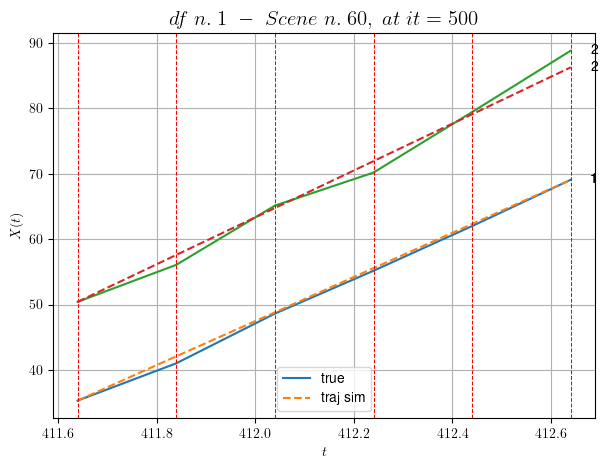

----------------------------------------------------------------------------------------------------
        For scene 51/73:
        * After LR finder: LR_NN=0.001 with mse=8.975059147784942 at it=24
        * v0 = 35.852941117110824
        * MSE = 1.1287197877691326
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.52/73
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [454.24,454.64]


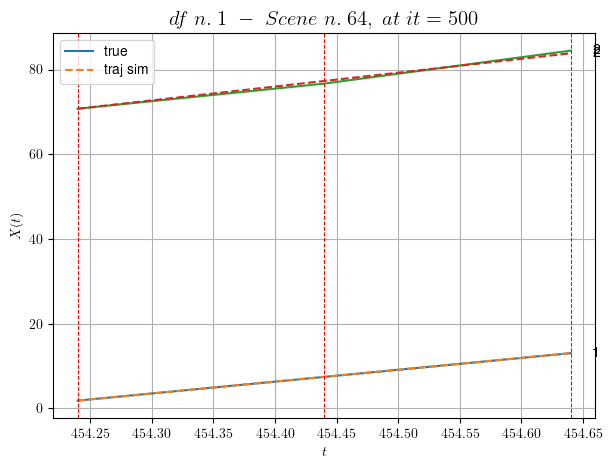

----------------------------------------------------------------------------------------------------
        For scene 52/73:
        * After LR finder: LR_NN=5e-05 with mse=0.49823746600905533 at it=24
        * v0 = 32.767095932646974
        * MSE = 0.1285167902413654
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.53/73
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [502.24,503.04]


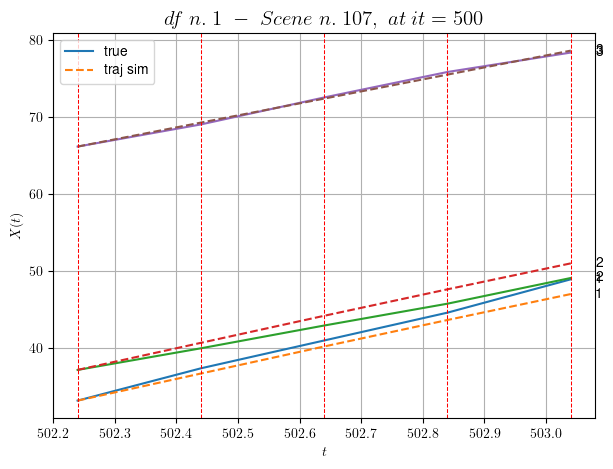

----------------------------------------------------------------------------------------------------
        For scene 53/73:
        * After LR finder: LR_NN=0.01 with mse=17.65376973176669 at it=24
        * v0 = 15.581016722934063
        * MSE = 1.007042944945899
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.54/73
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [298.04,298.84]


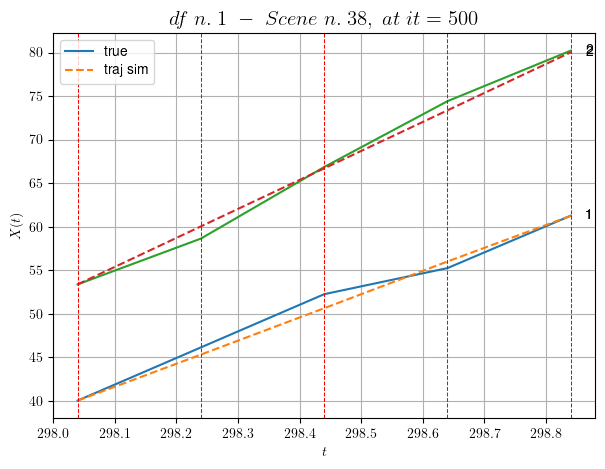

----------------------------------------------------------------------------------------------------
        For scene 54/73:
        * After LR finder: LR_NN=0.001 with mse=2.780671635913064 at it=24
        * v0 = 33.34266245905037
        * MSE = 0.6991317439575213
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.55/73
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [249.84,250.44]


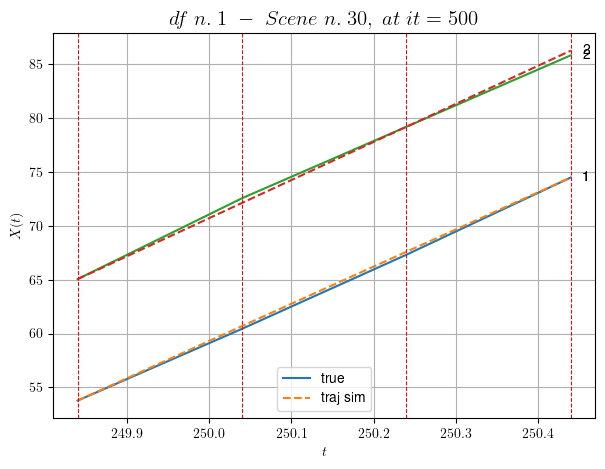

----------------------------------------------------------------------------------------------------
        For scene 55/73:
        * After LR finder: LR_NN=0.001 with mse=1.8444847288111403 at it=24
        * v0 = 35.36623656084919
        * MSE = 0.059525725432951836
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.56/73
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [363.44,364.04]


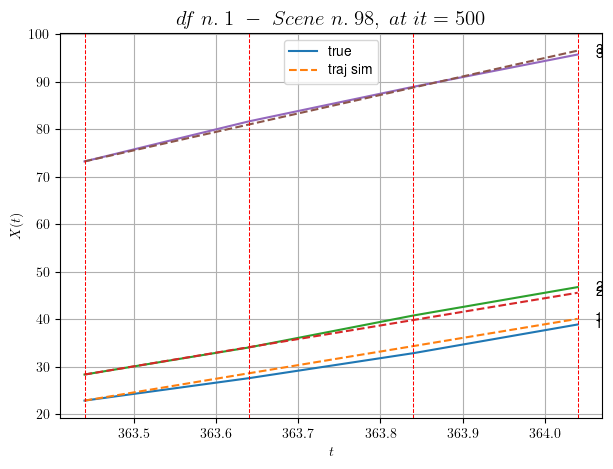

----------------------------------------------------------------------------------------------------
        For scene 56/73:
        * After LR finder: LR_NN=0.001 with mse=3.9463380810229705 at it=24
        * v0 = 38.92349444301725
        * MSE = 0.6704293082900364
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.57/73
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [16.44,16.84]


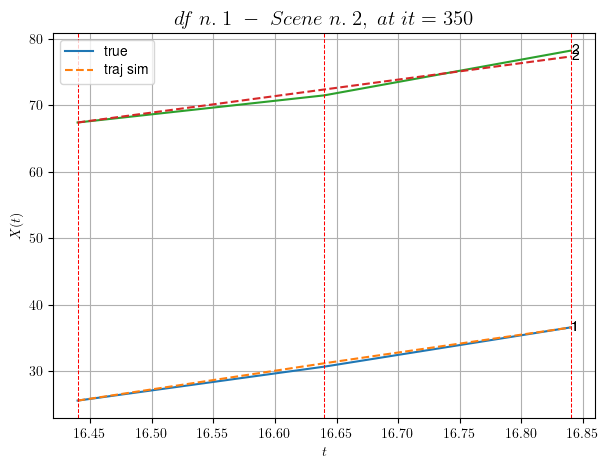

----------------------------------------------------------------------------------------------------
        For scene 57/73:
        * After LR finder: LR_NN=0.005 with mse=0.8985274705295875 at it=24
        * v0 = 24.81916992714183
        * MSE = 0.2833867586637764
        * iterations = 350
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.58/73
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [361.24,361.64]


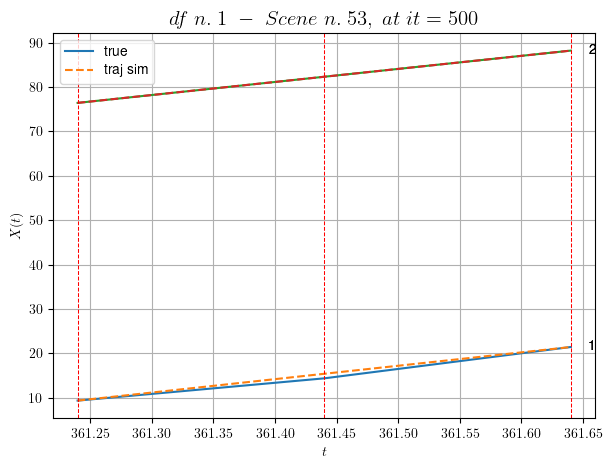

----------------------------------------------------------------------------------------------------
        For scene 58/73:
        * After LR finder: LR_NN=0.0001 with mse=0.49376160449704315 at it=24
        * v0 = 29.453860908621543
        * MSE = 0.14093809333024204
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.59/73
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [193.24,193.64]


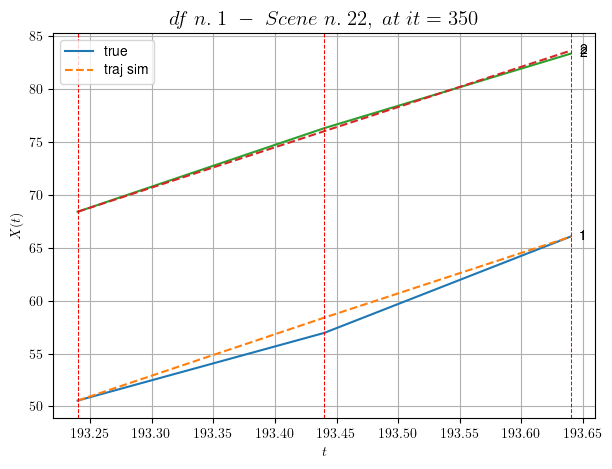

----------------------------------------------------------------------------------------------------
        For scene 59/73:
        * After LR finder: LR_NN=0.001 with mse=2.567798952753553 at it=24
        * v0 = 38.083999241096215
        * MSE = 0.3717045481231652
        * iterations = 350
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.60/73
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [33.44,34.04]


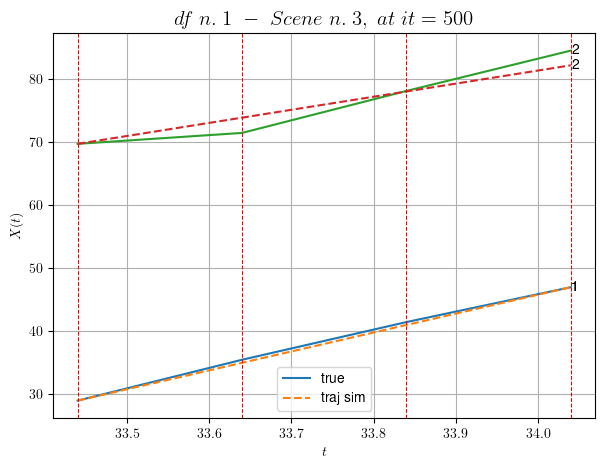

----------------------------------------------------------------------------------------------------
        For scene 60/73:
        * After LR finder: LR_NN=5e-05 with mse=5.235108668528918 at it=24
        * v0 = 20.735623985237886
        * MSE = 1.447205110919643
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.61/73
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [199.44,199.84]


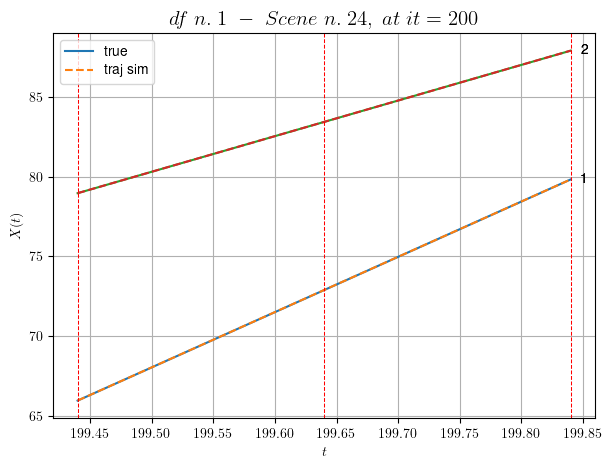

----------------------------------------------------------------------------------------------------
        For scene 61/73:
        * After LR finder: LR_NN=0.005 with mse=1.923811076193497 at it=24
        * v0 = 22.403293039970734
        * MSE = 3.3469106015074434e-06
        * iterations = 200
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.62/73
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [161.64,162.04]


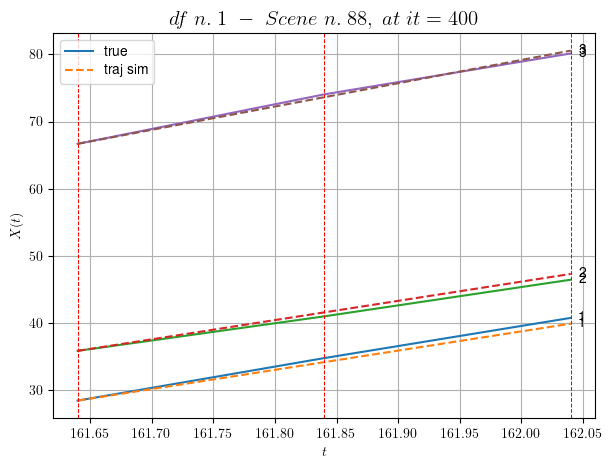

----------------------------------------------------------------------------------------------------
        For scene 62/73:
        * After LR finder: LR_NN=0.005 with mse=0.6889784690567088 at it=24
        * v0 = 34.71180912061806
        * MSE = 0.2798963790097968
        * iterations = 400
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.63/73
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [431.84,432.24]


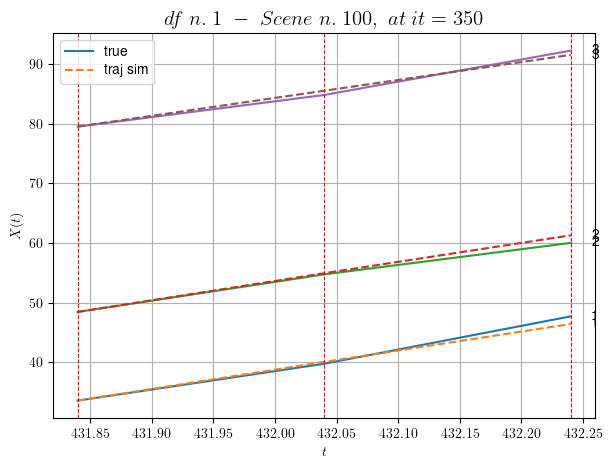

----------------------------------------------------------------------------------------------------
        For scene 63/73:
        * After LR finder: LR_NN=0.005 with mse=0.493968264477522 at it=24
        * v0 = 30.084161028051096
        * MSE = 0.4885879202469648
        * iterations = 350
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.64/73
----------------------------------------------------------------------------------------------------
We have 8 time intervals inside [531.64,533.24]


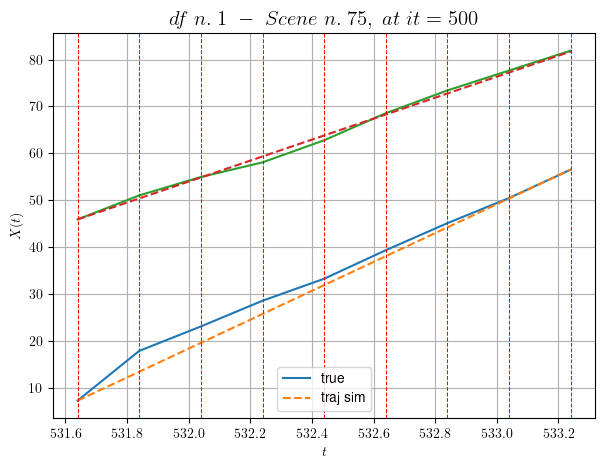

----------------------------------------------------------------------------------------------------
        For scene 64/73:
        * After LR finder: LR_NN=5e-05 with mse=26.864061056462404 at it=24
        * v0 = 22.38264840590317
        * MSE = 2.6250628856508245
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.65/73
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [148.04,148.44]


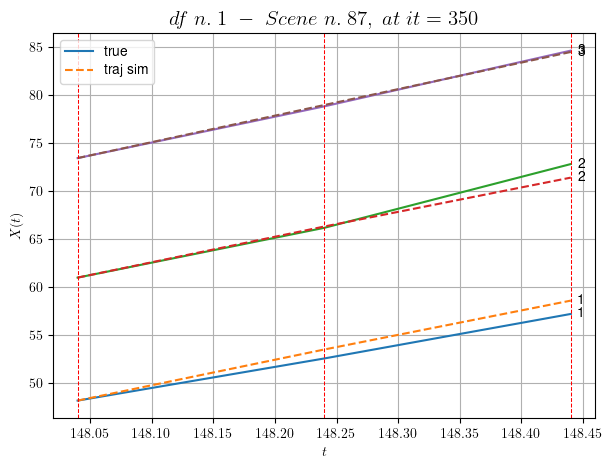

----------------------------------------------------------------------------------------------------
        For scene 65/73:
        * After LR finder: LR_NN=0.005 with mse=0.6567073213302201 at it=24
        * v0 = 27.621673906725327
        * MSE = 0.5384411299841381
        * iterations = 350
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.66/73
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [23.64,24.64]


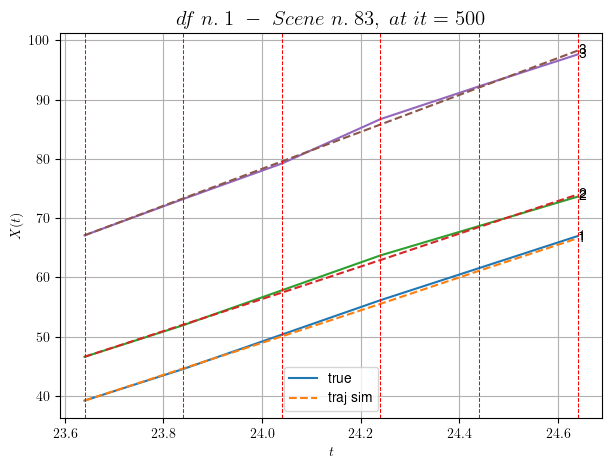

----------------------------------------------------------------------------------------------------
        For scene 66/73:
        * After LR finder: LR_NN=0.005 with mse=0.37270048349412016 at it=24
        * v0 = 31.184420565840146
        * MSE = 0.17493752488569617
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.67/73
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [159.84,160.64]


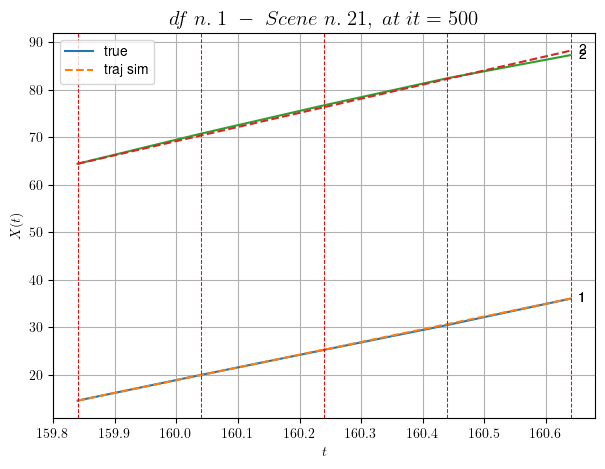

----------------------------------------------------------------------------------------------------
        For scene 67/73:
        * After LR finder: LR_NN=5e-05 with mse=0.14832093305236937 at it=24
        * v0 = 29.79906541567467
        * MSE = 0.1252477573575282
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.68/73
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [429.24,429.84]


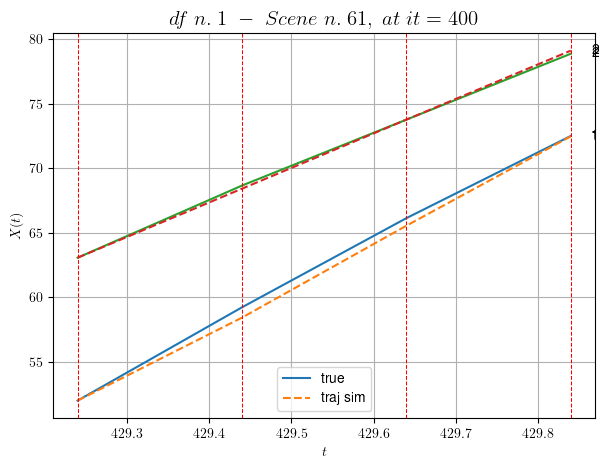

----------------------------------------------------------------------------------------------------
        For scene 68/73:
        * After LR finder: LR_NN=0.01 with mse=0.9435629640823016 at it=24
        * v0 = 26.764923518887098
        * MSE = 0.13798320402394282
        * iterations = 400
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.69/73
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [489.04,489.84]


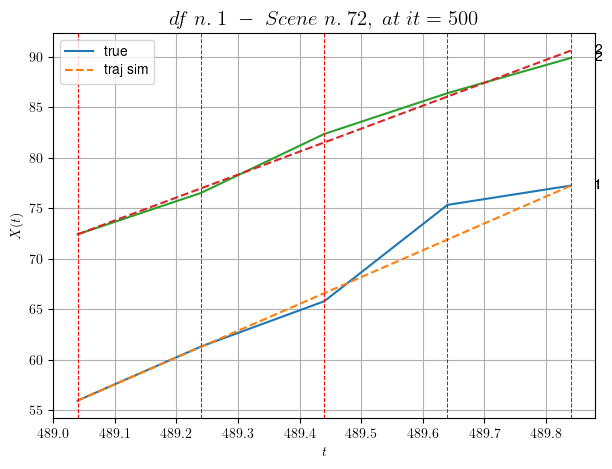

----------------------------------------------------------------------------------------------------
        For scene 69/73:
        * After LR finder: LR_NN=0.0001 with mse=7.575678921674605 at it=24
        * v0 = 22.7297341967192
        * MSE = 1.2994584776907399
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.70/73
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [116.04,117.04]


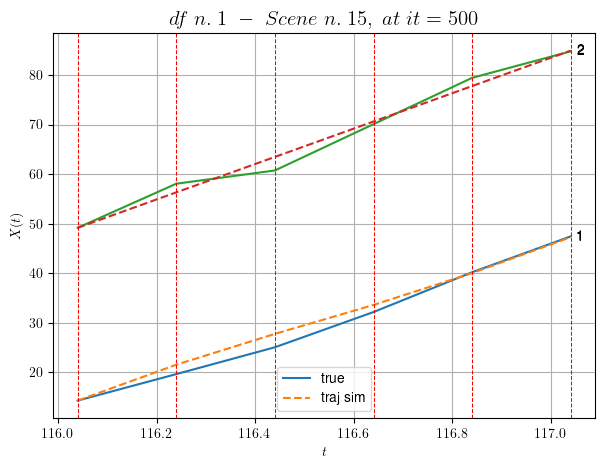

----------------------------------------------------------------------------------------------------
        For scene 70/73:
        * After LR finder: LR_NN=0.01 with mse=7.745281124532919 at it=24
        * v0 = 35.75445949476093
        * MSE = 1.6077718133299042
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.71/73
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [253.64,254.04]


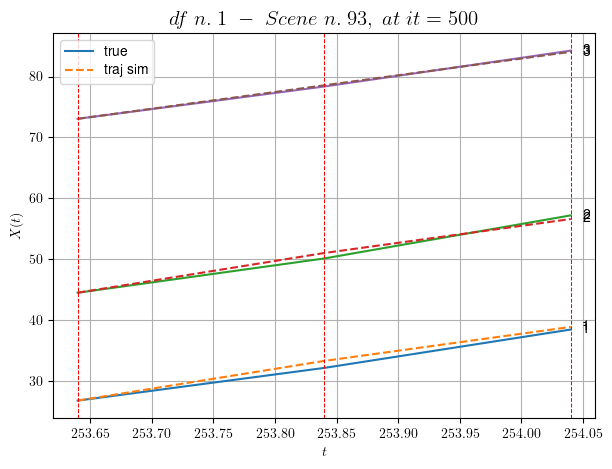

----------------------------------------------------------------------------------------------------
        For scene 71/73:
        * After LR finder: LR_NN=0.01 with mse=0.6045904511510717 at it=24
        * v0 = 27.47487958234868
        * MSE = 0.29089118066148856
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.72/73
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [358.84,359.64]


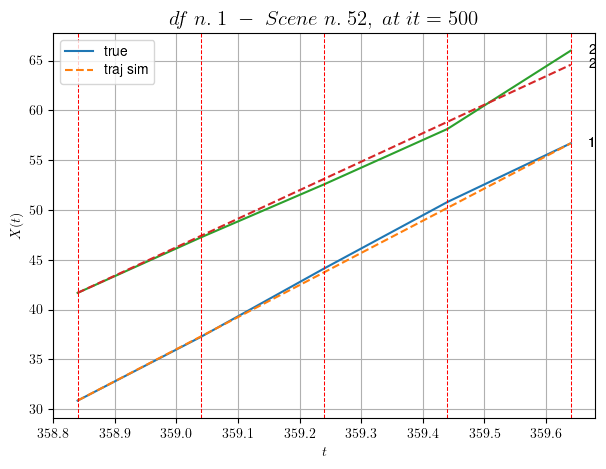

----------------------------------------------------------------------------------------------------
        For scene 72/73:
        * After LR finder: LR_NN=0.001 with mse=0.5885478964721795 at it=24
        * v0 = 28.62644197692061
        * MSE = 0.3241306198455291
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.73/73
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [495.84,496.24]


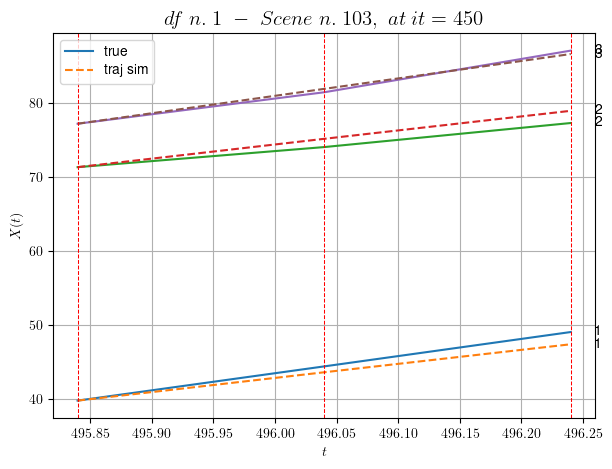

----------------------------------------------------------------------------------------------------
        For scene 73/73:
        * After LR finder: LR_NN=0.005 with mse=1.652330571091656 at it=24
        * v0 = 23.563094778667203
        * MSE = 0.858224339408603
        * iterations = 450
----------------------------------------------------------------------------------------------------


MSE train: 0.6197393245850501
- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -

Testing step. (36 scenes)
DataFrame n.1. Scene n.1/36


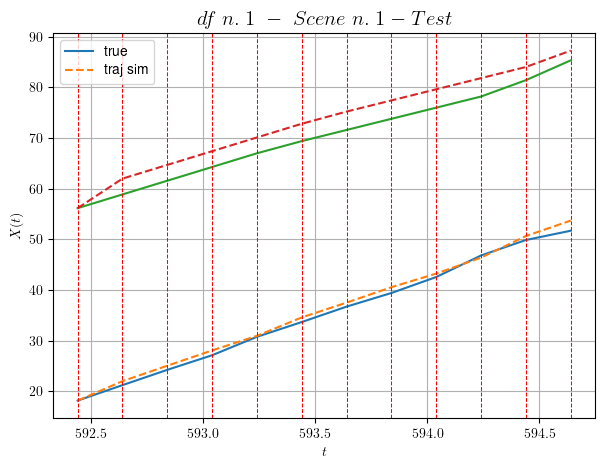

        For scene 1/36:
        * MSE = 5.168822343003464
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.2/36


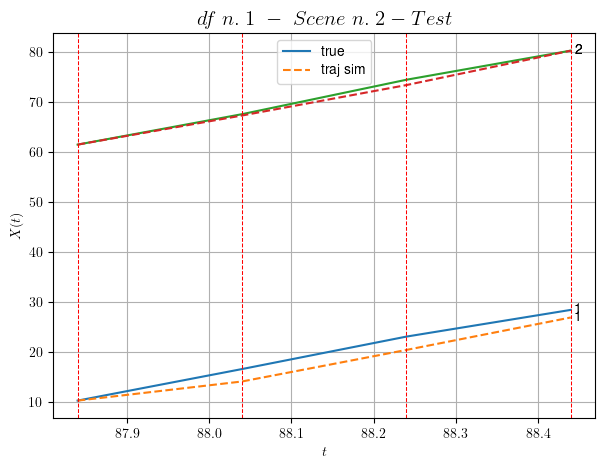

        For scene 2/36:
        * MSE = 2.1039787303586626
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.3/36


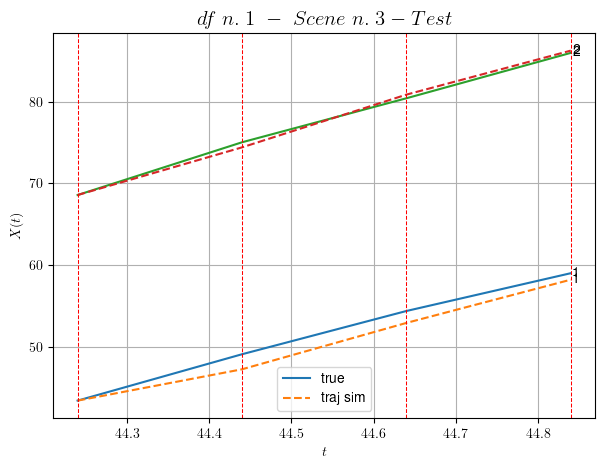

        For scene 3/36:
        * MSE = 0.8507912939828113
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.4/36


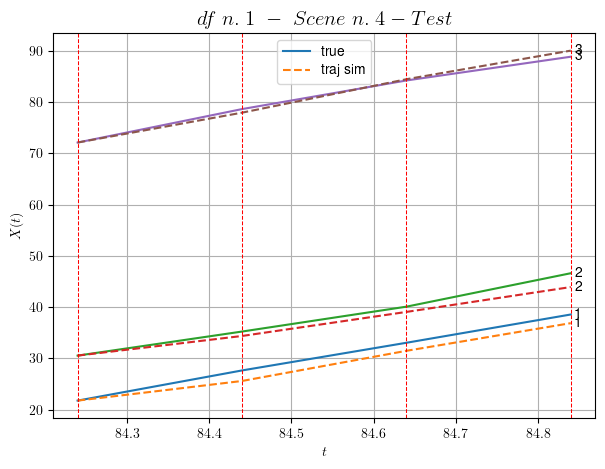

        For scene 4/36:
        * MSE = 1.7165739436623697
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.5/36


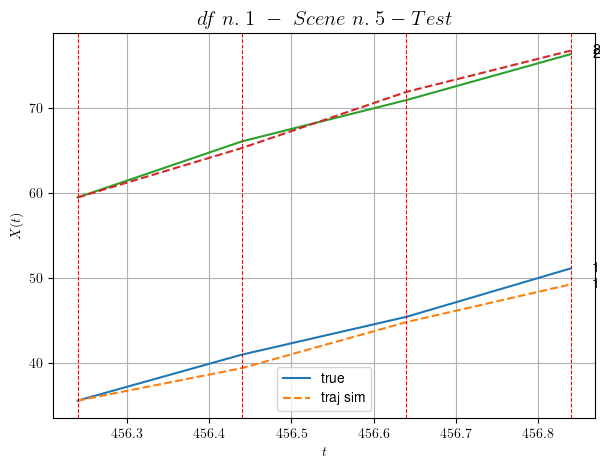

        For scene 5/36:
        * MSE = 1.0177019680478299
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.6/36


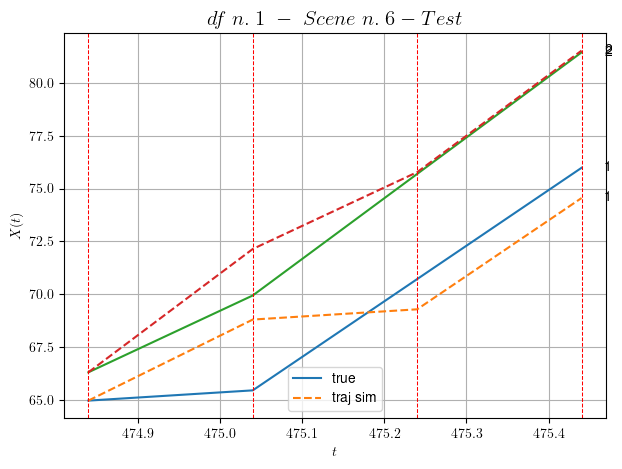

        For scene 6/36:
        * MSE = 2.5161977311897727
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.7/36


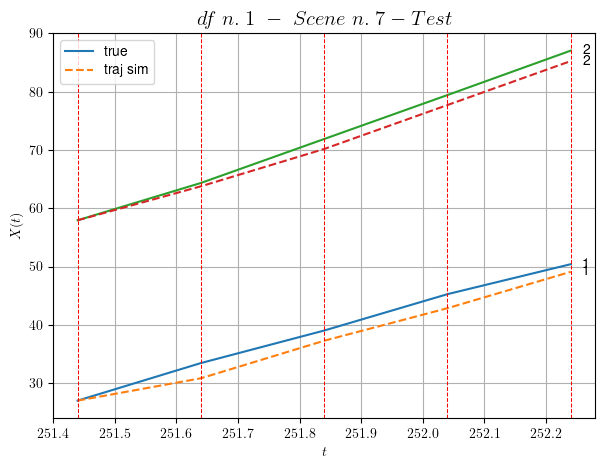

        For scene 7/36:
        * MSE = 2.676445976256731
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.8/36


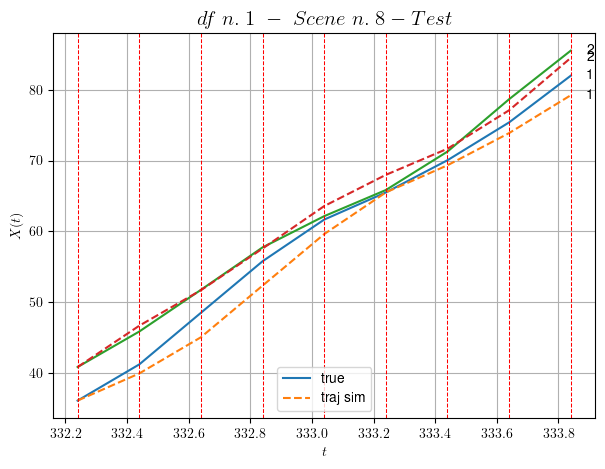

        For scene 8/36:
        * MSE = 2.829260426825652
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.9/36


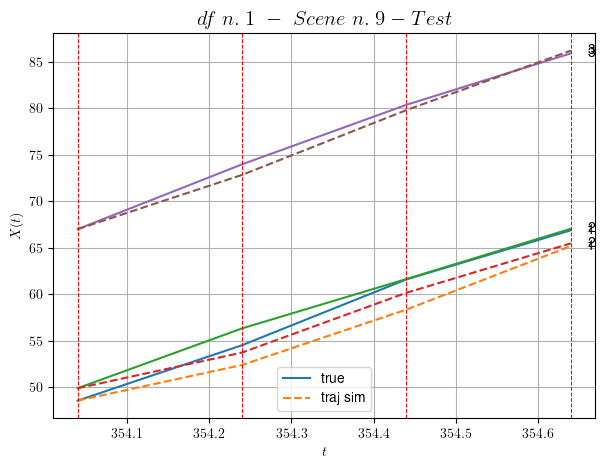

        For scene 9/36:
        * MSE = 2.586773884507515
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.10/36


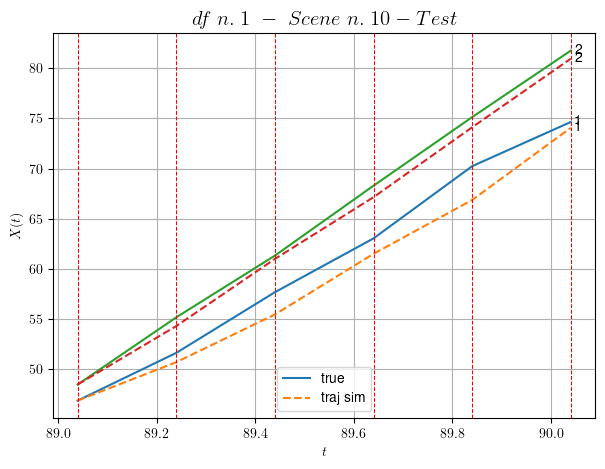

        For scene 10/36:
        * MSE = 1.9740218307465651
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.11/36


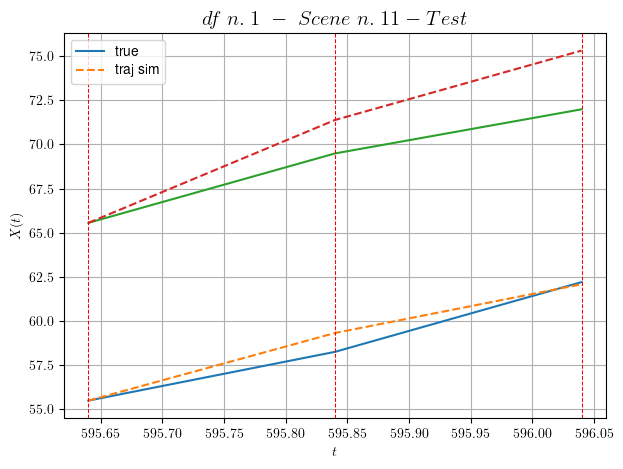

        For scene 11/36:
        * MSE = 2.6365164292311722
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.12/36


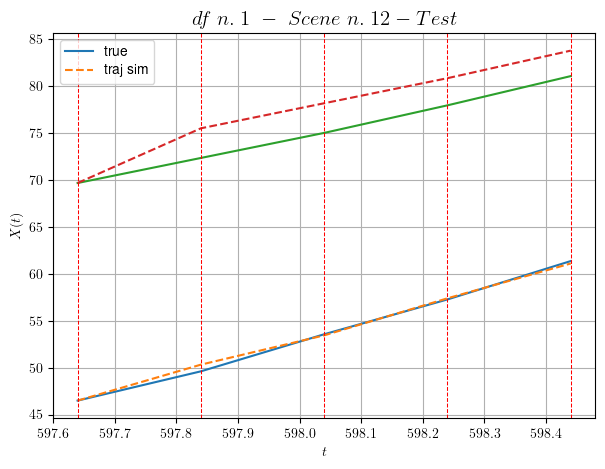

        For scene 12/36:
        * MSE = 3.6299634344308913
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.13/36


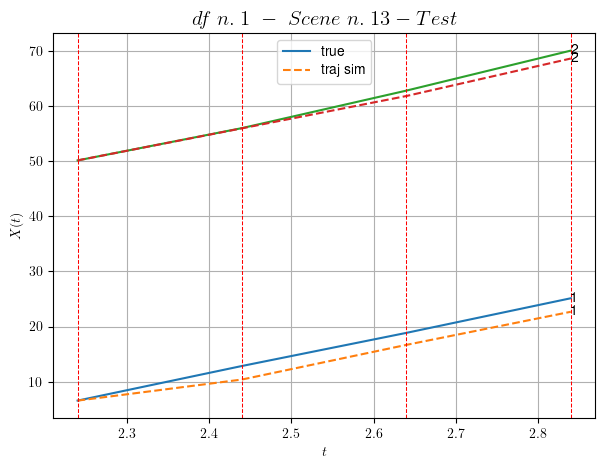

        For scene 13/36:
        * MSE = 2.4844296097592276
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.14/36


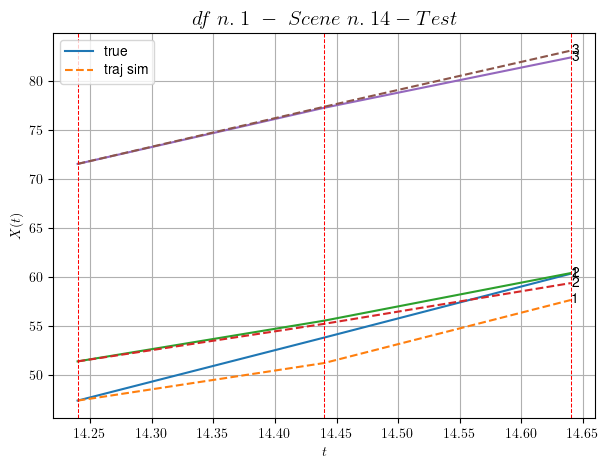

        For scene 14/36:
        * MSE = 1.7324516749670018
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.15/36


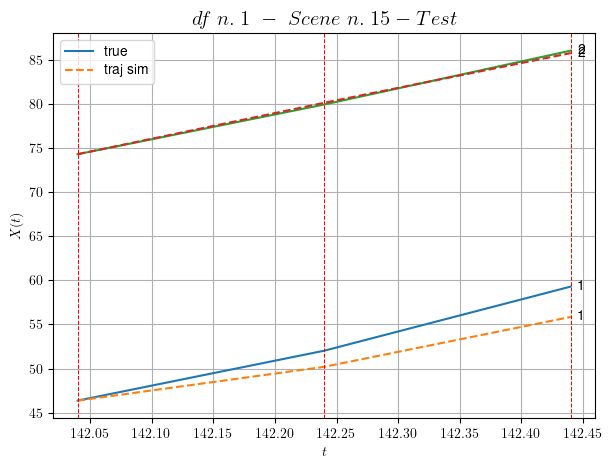

        For scene 15/36:
        * MSE = 2.5475913865561868
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.16/36


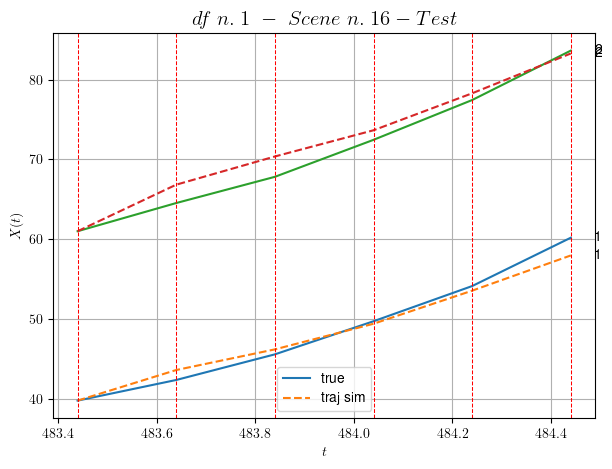

        For scene 16/36:
        * MSE = 1.7804958522984784
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.17/36


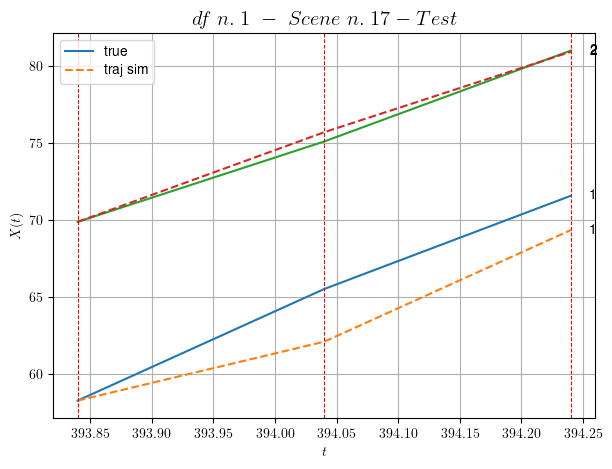

        For scene 17/36:
        * MSE = 2.8430952253750754
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.18/36


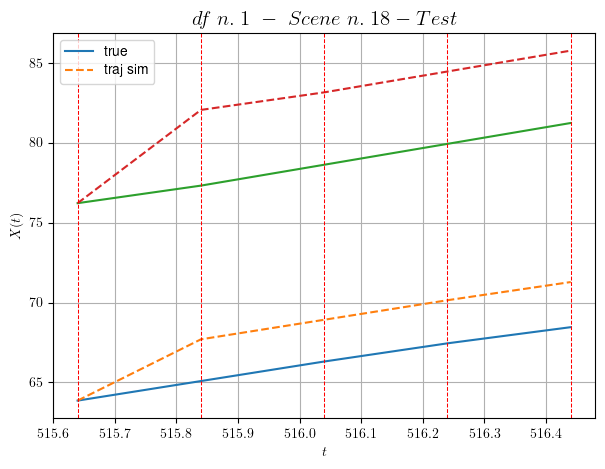

        For scene 18/36:
        * MSE = 11.265287510056318
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.19/36


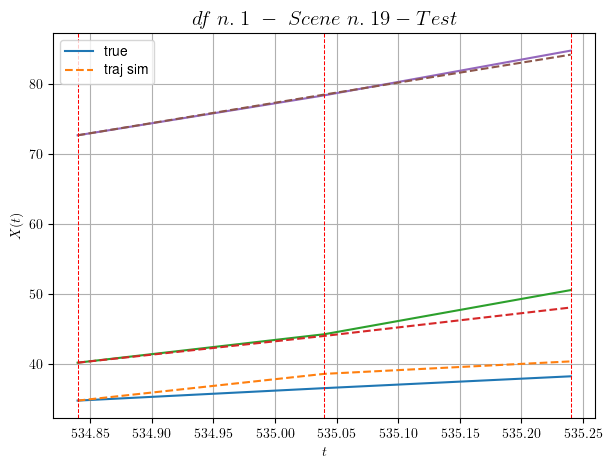

        For scene 19/36:
        * MSE = 1.7098544251237604
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.20/36


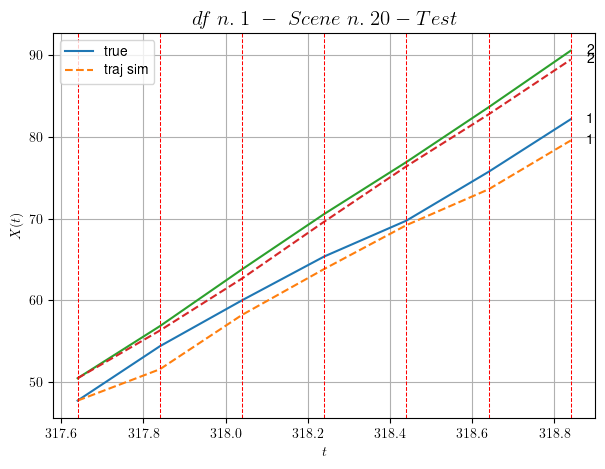

        For scene 20/36:
        * MSE = 2.1247533040935127
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.21/36


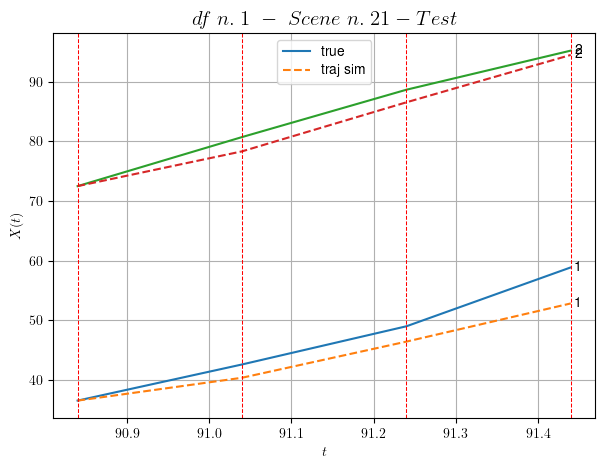

        For scene 21/36:
        * MSE = 7.351868486130323
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.22/36


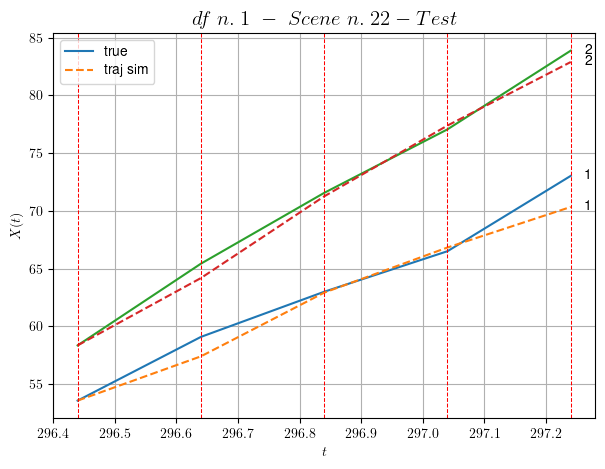

        For scene 22/36:
        * MSE = 1.2922816451297061
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.23/36


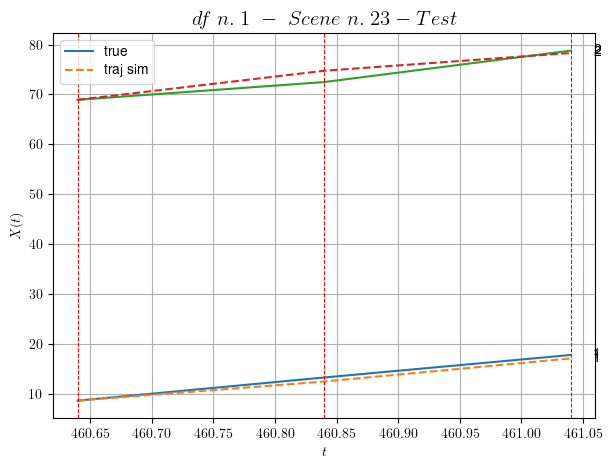

        For scene 23/36:
        * MSE = 1.0785745737959023
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.24/36


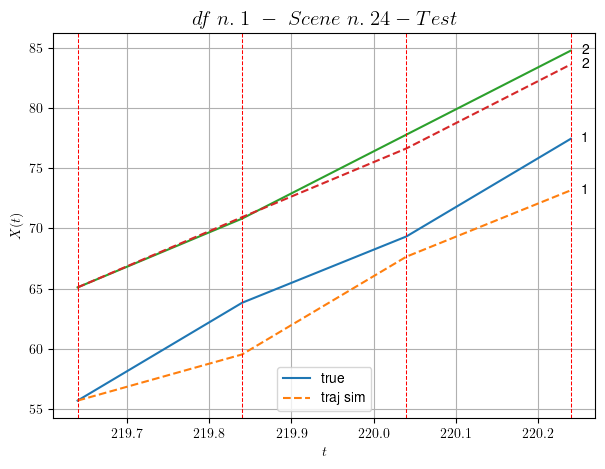

        For scene 24/36:
        * MSE = 5.270710739776148
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.25/36


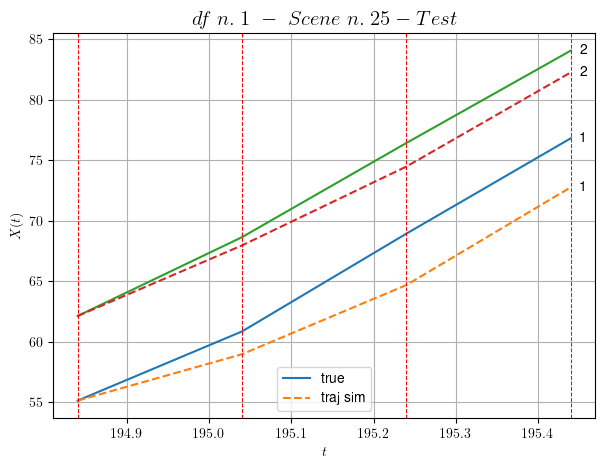

        For scene 25/36:
        * MSE = 5.671995036055298
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.26/36


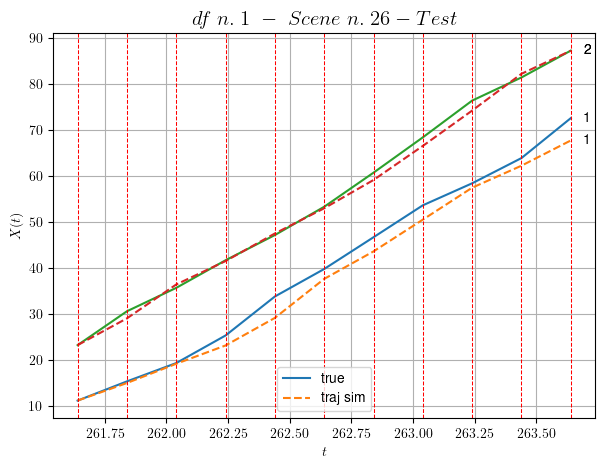

        For scene 26/36:
        * MSE = 4.193246905016186
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.27/36


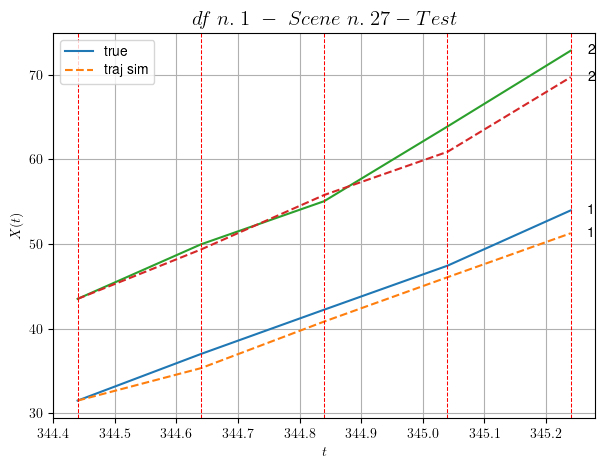

        For scene 27/36:
        * MSE = 3.359388712452086
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.28/36


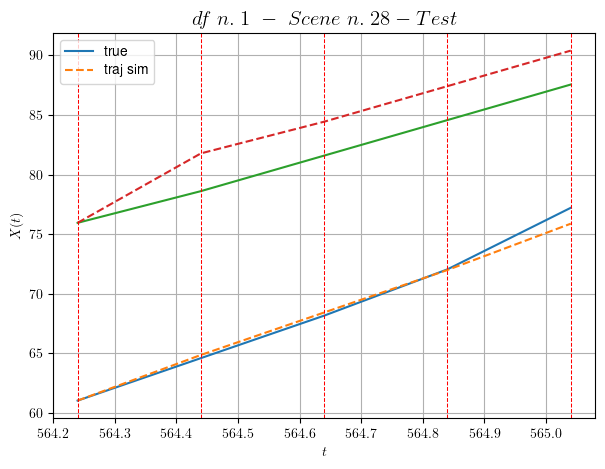

        For scene 28/36:
        * MSE = 3.6283779993473666
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.29/36


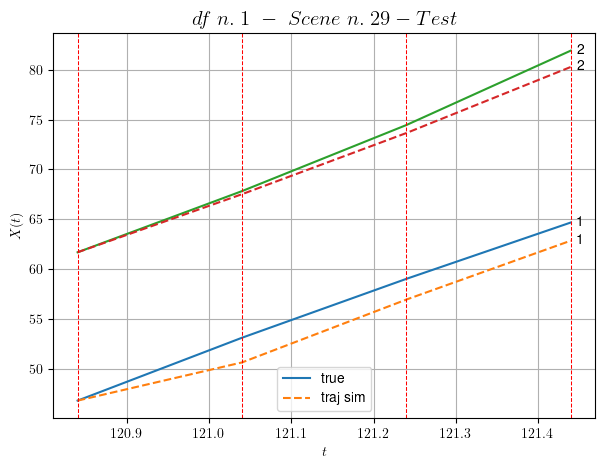

        For scene 29/36:
        * MSE = 2.1514361244154583
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.30/36


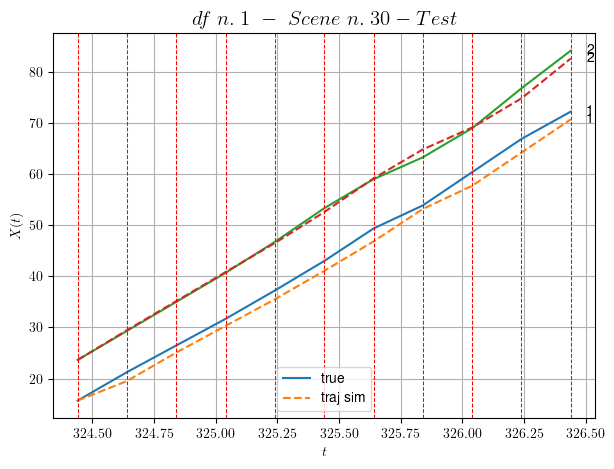

        For scene 30/36:
        * MSE = 2.1101339449591667
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.31/36


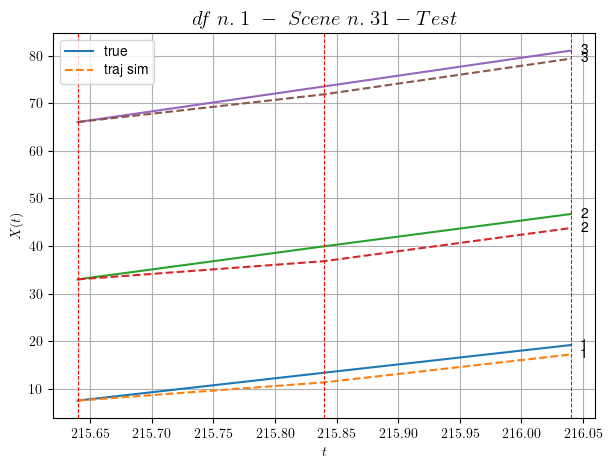

        For scene 31/36:
        * MSE = 3.5535949944267724
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.32/36


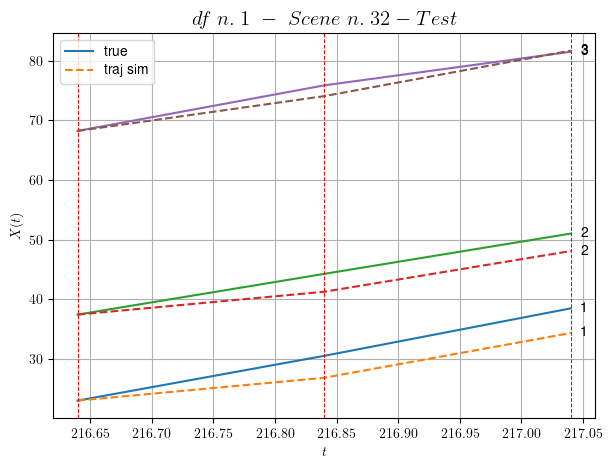

        For scene 32/36:
        * MSE = 5.714981423634513
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.33/36


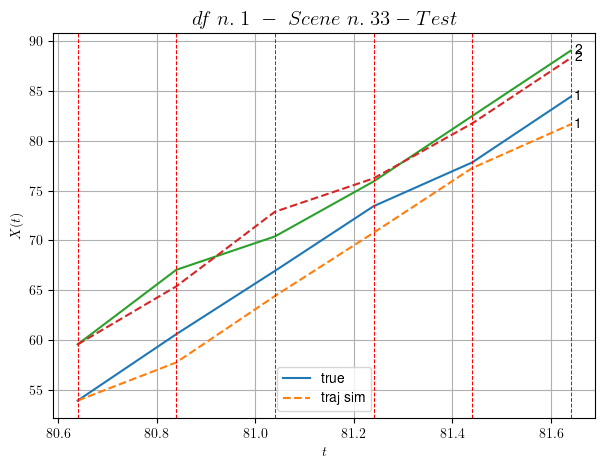

        For scene 33/36:
        * MSE = 3.2992533808651383
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.34/36


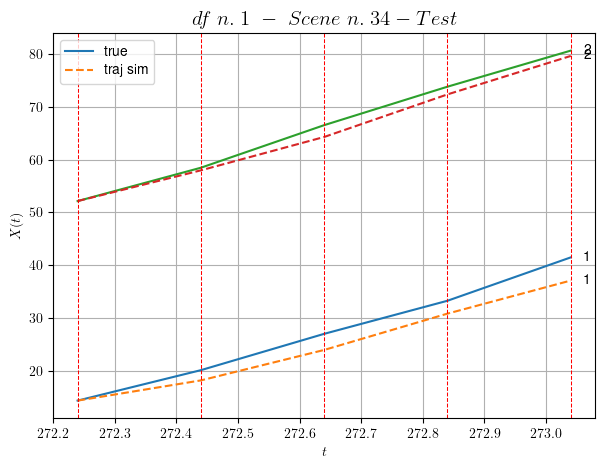

        For scene 34/36:
        * MSE = 4.675604080102515
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.35/36


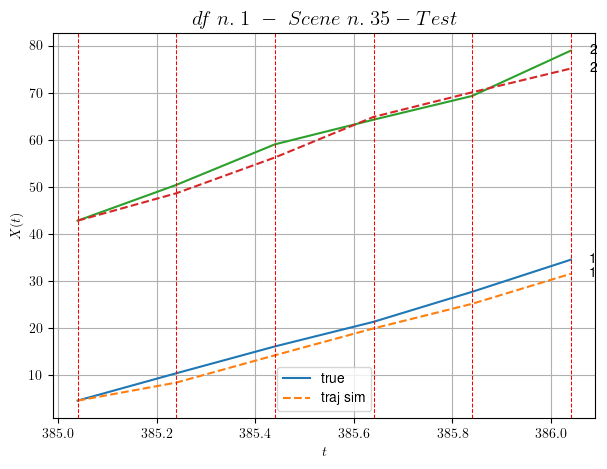

        For scene 35/36:
        * MSE = 4.28326112855947
----------------------------------------------------------------------------------------------------


DataFrame n.1. Scene n.36/36


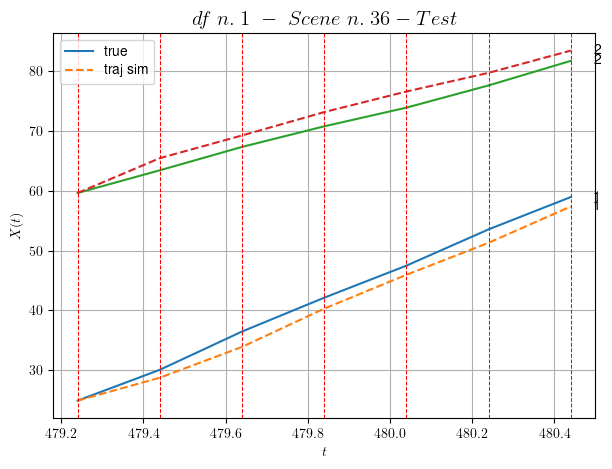

        For scene 36/36:
        * MSE = 3.557168219666864
----------------------------------------------------------------------------------------------------


MSE test: 3.2607467881890533

- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -

    Summing up:
          * MSE train: 0.6197393245850501
          * MSE test: 3.2607467881890533
          
- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -




Analyzing 2/10 dfs.
In DataFrame n.2 we have 69 scenes.
    To train the model we use 46 scenes, the remaining 23 to test the model.

Training step. (46 scenes)
DataFrame n.2. Scene n.1/46
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [292.96,293.56]


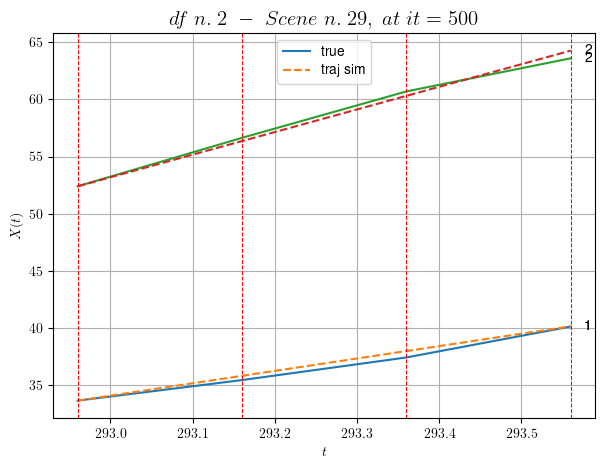

----------------------------------------------------------------------------------------------------
        For scene 1/46:
        * After LR finder: LR_NN=0.0001 with mse=7.9105366623428095 at it=24
        * v0 = 19.771247175293336
        * MSE = 0.14139888734448555
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.2/46
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [84.96,85.96]


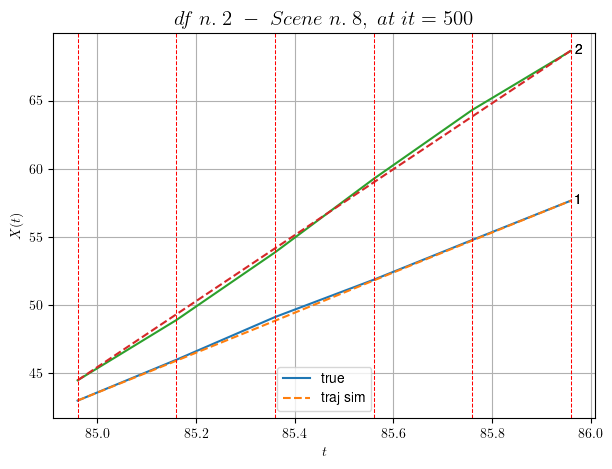

----------------------------------------------------------------------------------------------------
        For scene 2/46:
        * After LR finder: LR_NN=0.005 with mse=5.978174981736678 at it=24
        * v0 = 24.168678500842805
        * MSE = 0.05061760237947619
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.3/46
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [487.56,487.96]


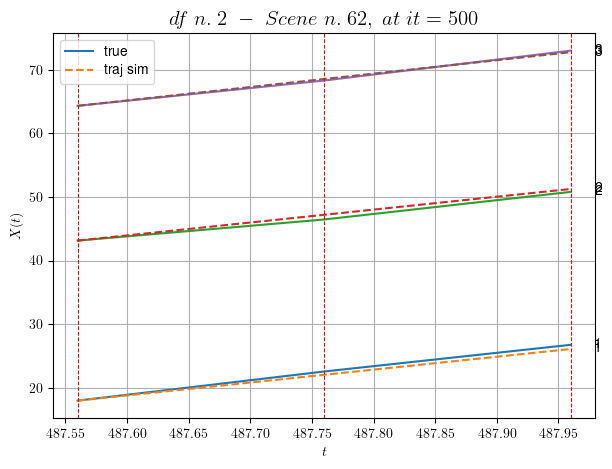

----------------------------------------------------------------------------------------------------
        For scene 3/46:
        * After LR finder: LR_NN=5e-05 with mse=1.6952902821549245 at it=24
        * v0 = 21.111900247991965
        * MSE = 0.17502185606083462
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.4/46
----------------------------------------------------------------------------------------------------
We have 6 time intervals inside [440.16,441.36]


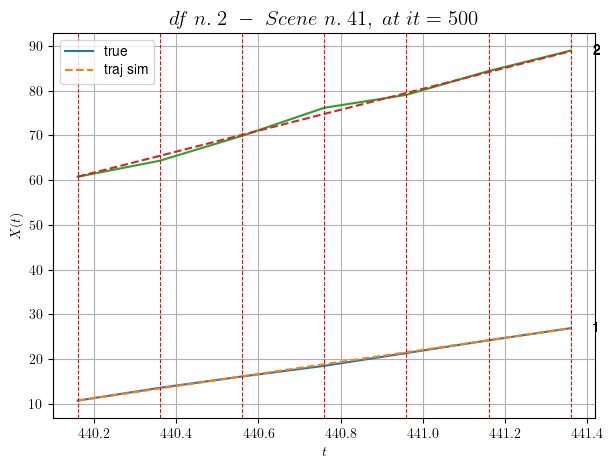

----------------------------------------------------------------------------------------------------
        For scene 4/46:
        * After LR finder: LR_NN=0.005 with mse=11.117652747335413 at it=24
        * v0 = 23.380815312671487
        * MSE = 0.24956141944396665
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.5/46
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [588.96,589.36]


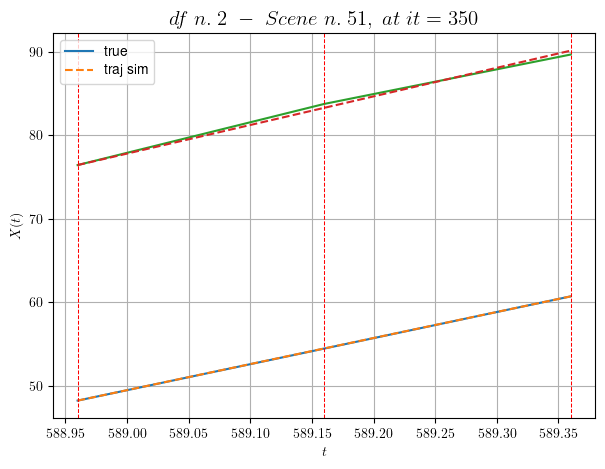

----------------------------------------------------------------------------------------------------
        For scene 5/46:
        * After LR finder: LR_NN=0.005 with mse=0.535246095505811 at it=24
        * v0 = 34.22110961912343
        * MSE = 0.06538876326481086
        * iterations = 350
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.6/46
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [530.96,531.36]


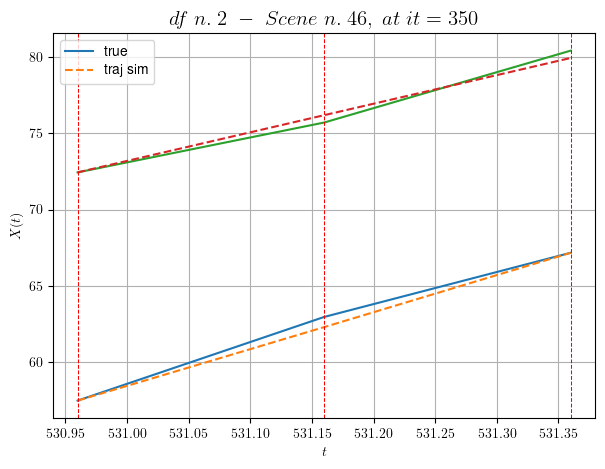

----------------------------------------------------------------------------------------------------
        For scene 6/46:
        * After LR finder: LR_NN=0.001 with mse=3.9405539254210136 at it=24
        * v0 = 18.78540851149216
        * MSE = 0.14555571050297605
        * iterations = 350
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.7/46
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [220.36,221.16]


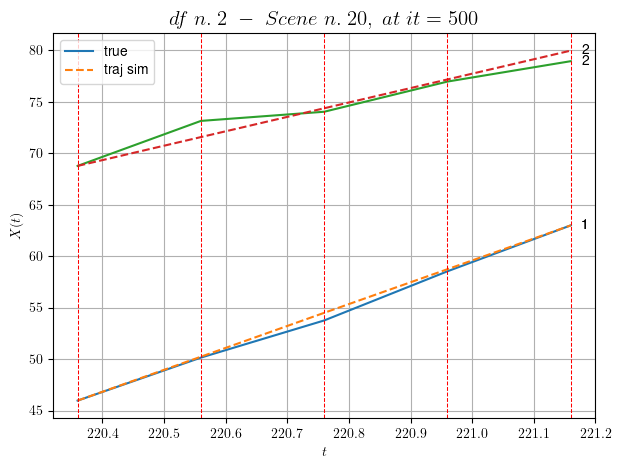

----------------------------------------------------------------------------------------------------
        For scene 7/46:
        * After LR finder: LR_NN=0.001 with mse=33.61238804131773 at it=24
        * v0 = 13.99642713340961
        * MSE = 0.42698810113866165
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.8/46
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [199.76,200.16]


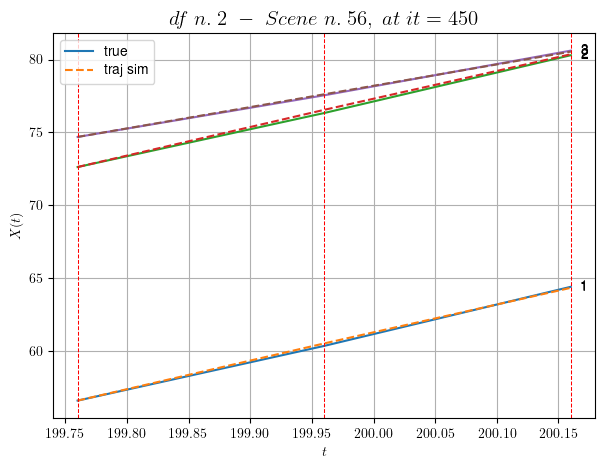

----------------------------------------------------------------------------------------------------
        For scene 8/46:
        * After LR finder: LR_NN=0.01 with mse=5.203833639984836 at it=24
        * v0 = 14.651673034685919
        * MSE = 0.010247079462241288
        * iterations = 450
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.9/46
----------------------------------------------------------------------------------------------------
We have 6 time intervals inside [428.56,429.76]


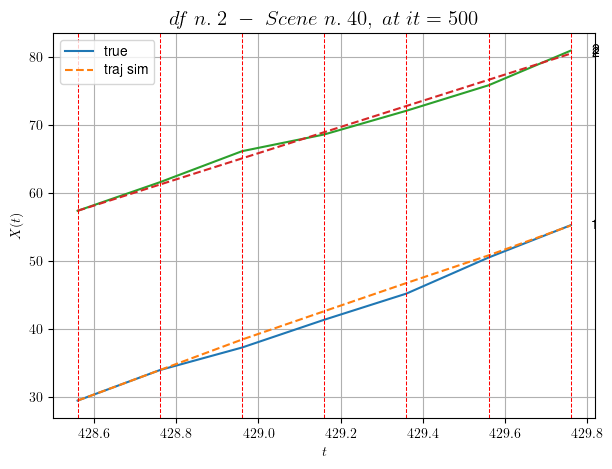

----------------------------------------------------------------------------------------------------
        For scene 9/46:
        * After LR finder: LR_NN=0.01 with mse=31.23251971266654 at it=24
        * v0 = 19.27781035652318
        * MSE = 0.5495798296294903
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.10/46
----------------------------------------------------------------------------------------------------
We have 8 time intervals inside [256.56,258.16]


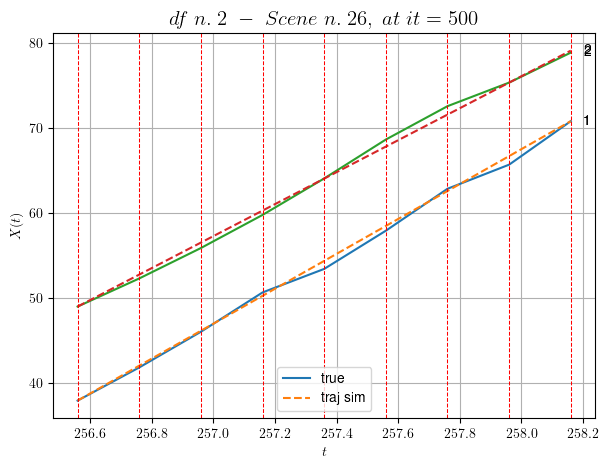

----------------------------------------------------------------------------------------------------
        For scene 10/46:
        * After LR finder: LR_NN=5e-05 with mse=55.652713243235596 at it=24
        * v0 = 18.832978045462912
        * MSE = 0.284309192226216
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.11/46
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [413.96,414.56]


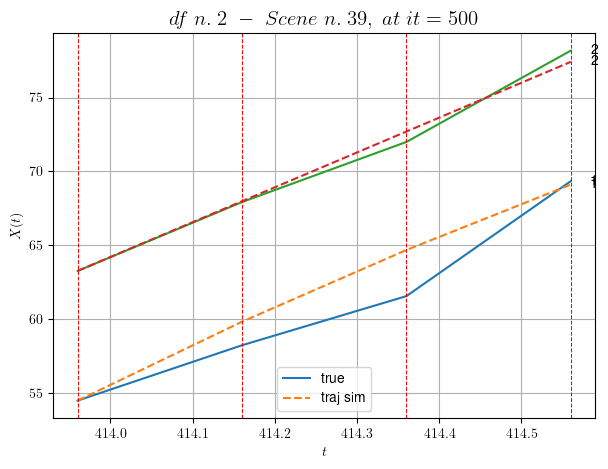

----------------------------------------------------------------------------------------------------
        For scene 11/46:
        * After LR finder: LR_NN=0.005 with mse=4.528431580456683 at it=24
        * v0 = 23.615524542916113
        * MSE = 1.6347959725777745
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.12/46
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [183.96,184.56]


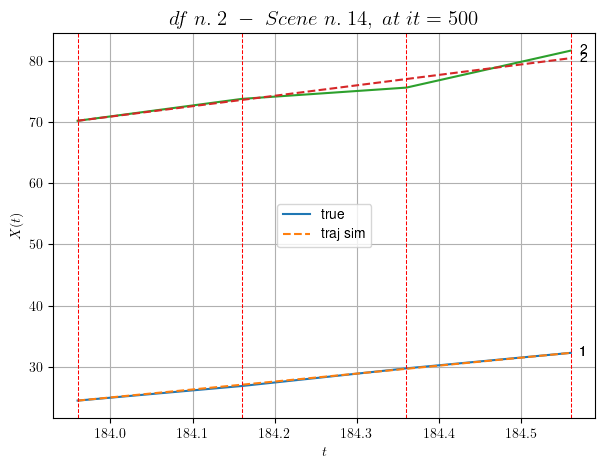

----------------------------------------------------------------------------------------------------
        For scene 12/46:
        * After LR finder: LR_NN=0.001 with mse=12.721070082155627 at it=24
        * v0 = 17.05181090872095
        * MSE = 0.4342328141175644
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.13/46
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [576.56,576.96]


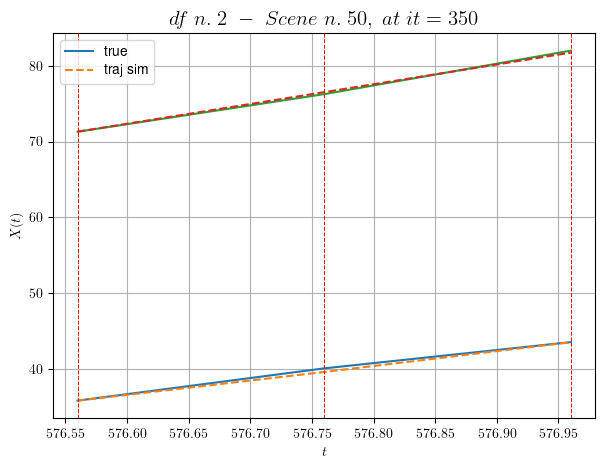

----------------------------------------------------------------------------------------------------
        For scene 13/46:
        * After LR finder: LR_NN=0.005 with mse=0.509600105759806 at it=24
        * v0 = 26.069569161158675
        * MSE = 0.06017717895971162
        * iterations = 350
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.14/46
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [54.56,55.36]


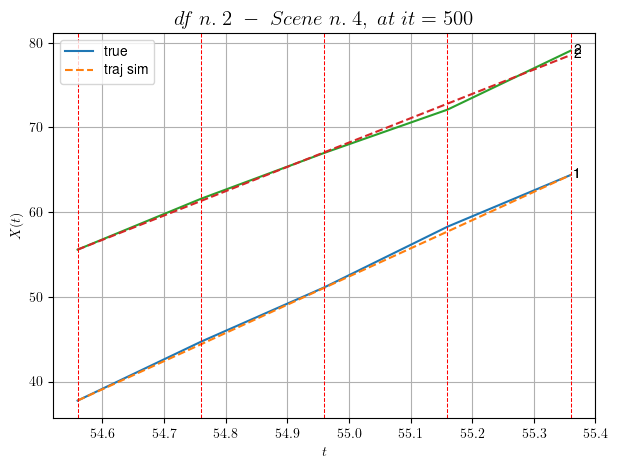

----------------------------------------------------------------------------------------------------
        For scene 14/46:
        * After LR finder: LR_NN=0.001 with mse=0.3243034002201506 at it=24
        * v0 = 28.716321309649476
        * MSE = 0.1257582733855451
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.15/46
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [215.36,215.96]


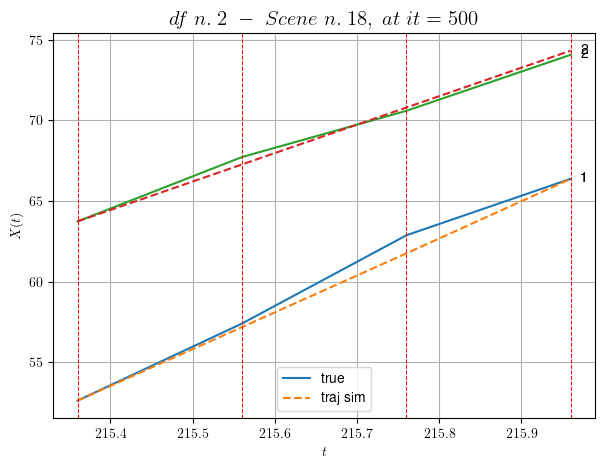

----------------------------------------------------------------------------------------------------
        For scene 15/46:
        * After LR finder: LR_NN=0.001 with mse=11.345641758040582 at it=24
        * v0 = 17.64323253685231
        * MSE = 0.20181971496915868
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.16/46
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [96.36,96.76]


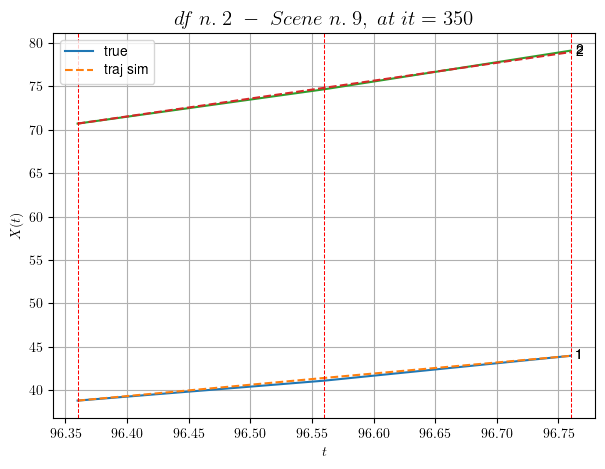

----------------------------------------------------------------------------------------------------
        For scene 16/46:
        * After LR finder: LR_NN=0.005 with mse=2.8649589179474777 at it=24
        * v0 = 20.598848373580697
        * MSE = 0.0255693944479256
        * iterations = 350
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.17/46
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [179.36,180.16]


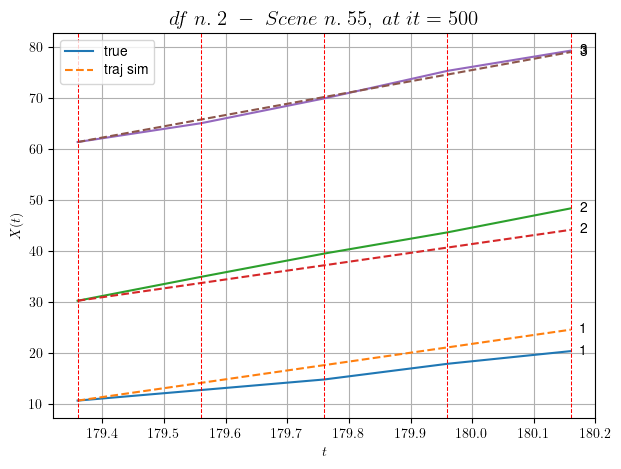

----------------------------------------------------------------------------------------------------
        For scene 17/46:
        * After LR finder: LR_NN=0.0001 with mse=6.011175209921952 at it=24
        * v0 = 22.08199952987889
        * MSE = 4.824718085475463
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.18/46
----------------------------------------------------------------------------------------------------
We have 6 time intervals inside [77.56,78.76]


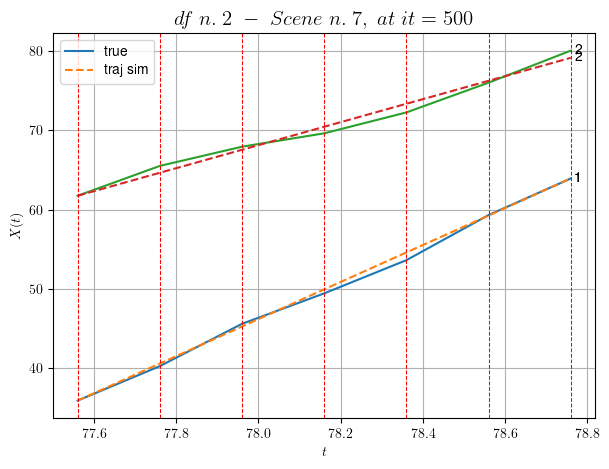

----------------------------------------------------------------------------------------------------
        For scene 18/46:
        * After LR finder: LR_NN=0.001 with mse=63.02363892427348 at it=24
        * v0 = 14.529876108312923
        * MSE = 0.36346850057508845
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.19/46
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [399.56,400.56]


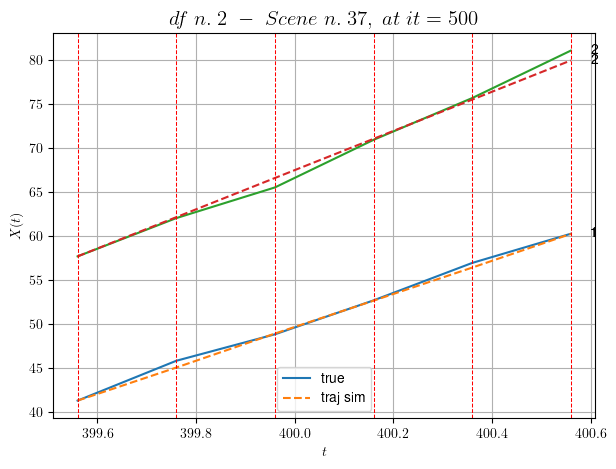

----------------------------------------------------------------------------------------------------
        For scene 19/46:
        * After LR finder: LR_NN=0.005 with mse=10.257983858442012 at it=24
        * v0 = 22.285901484028475
        * MSE = 0.2774694775951054
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.20/46
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [538.36,539.16]


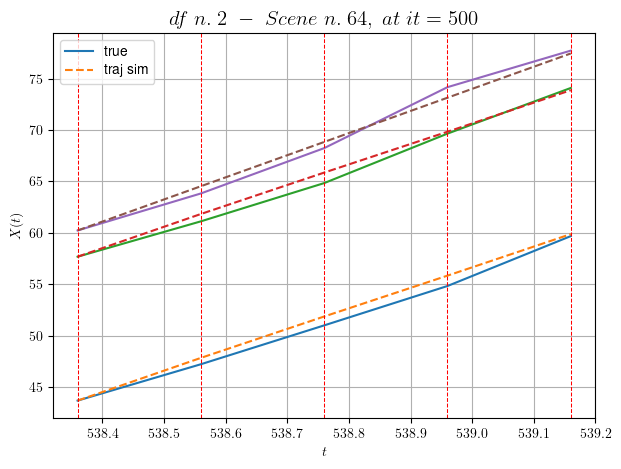

----------------------------------------------------------------------------------------------------
        For scene 20/46:
        * After LR finder: LR_NN=0.005 with mse=5.671426142577208 at it=24
        * v0 = 21.518869344520674
        * MSE = 0.38396454448351064
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.21/46
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [87.56,88.16]


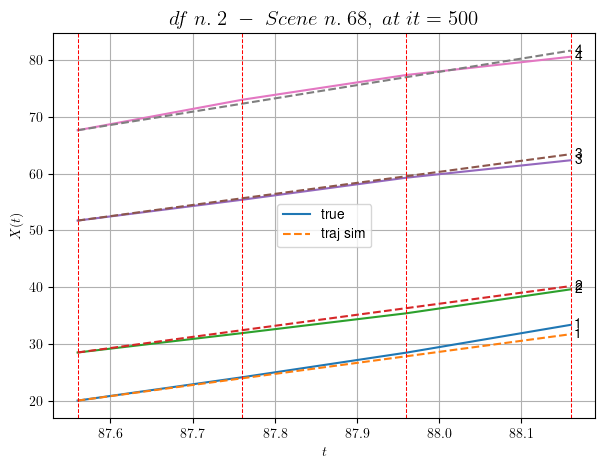

----------------------------------------------------------------------------------------------------
        For scene 21/46:
        * After LR finder: LR_NN=0.005 with mse=2.3050144423951537 at it=24
        * v0 = 23.399103331764046
        * MSE = 0.47841445333218413
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.22/46
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [208.96,209.36]


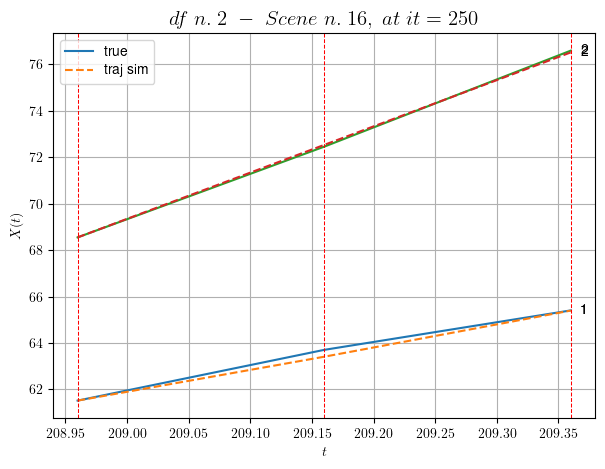

----------------------------------------------------------------------------------------------------
        For scene 22/46:
        * After LR finder: LR_NN=0.01 with mse=3.3492800349255685 at it=24
        * v0 = 19.925338217022304
        * MSE = 0.016075051435451043
        * iterations = 250
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.23/46
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [287.36,287.96]


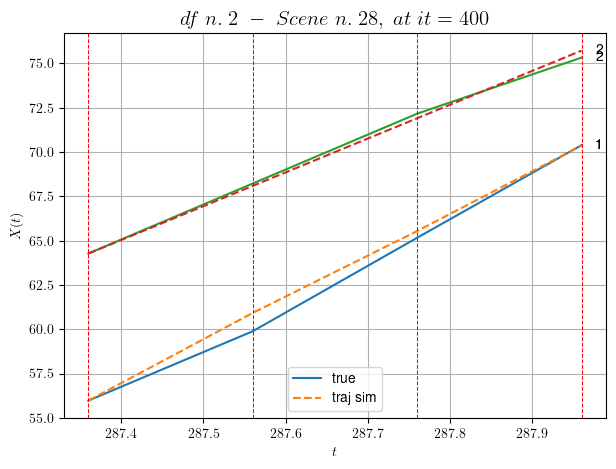

----------------------------------------------------------------------------------------------------
        For scene 23/46:
        * After LR finder: LR_NN=0.005 with mse=8.834297836628862 at it=24
        * v0 = 19.081744108376125
        * MSE = 0.18168403049817505
        * iterations = 400
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.24/46
----------------------------------------------------------------------------------------------------
We have 7 time intervals inside [442.36,443.76]


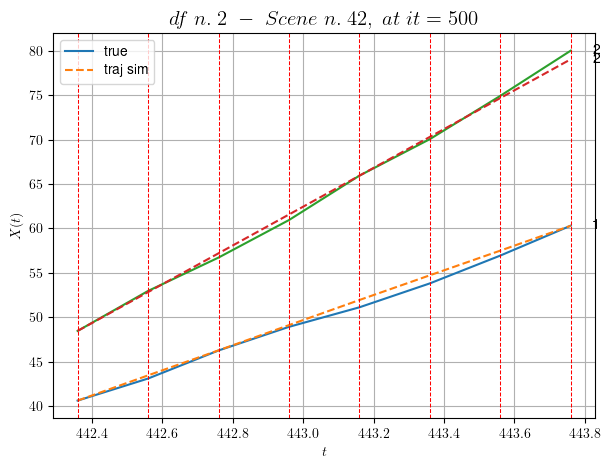

----------------------------------------------------------------------------------------------------
        For scene 24/46:
        * After LR finder: LR_NN=0.005 with mse=22.59008895881611 at it=24
        * v0 = 21.85795817065097
        * MSE = 0.23109011134005453
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.25/46
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [275.56,275.96]


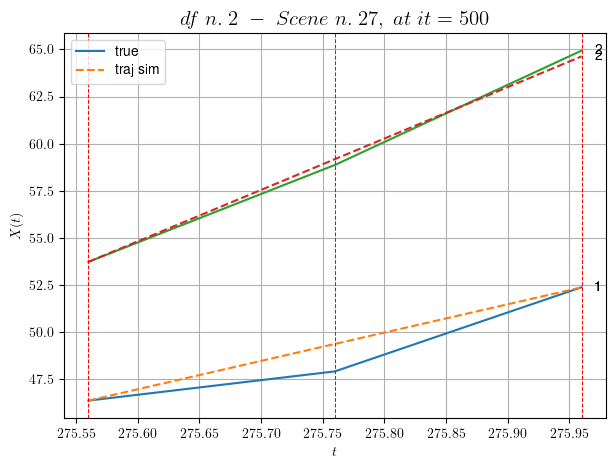

----------------------------------------------------------------------------------------------------
        For scene 25/46:
        * After LR finder: LR_NN=0.0001 with mse=0.3573965943456166 at it=24
        * v0 = 27.245148829197323
        * MSE = 0.3395363670877492
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.26/46
----------------------------------------------------------------------------------------------------
We have 6 time intervals inside [557.96,559.16]


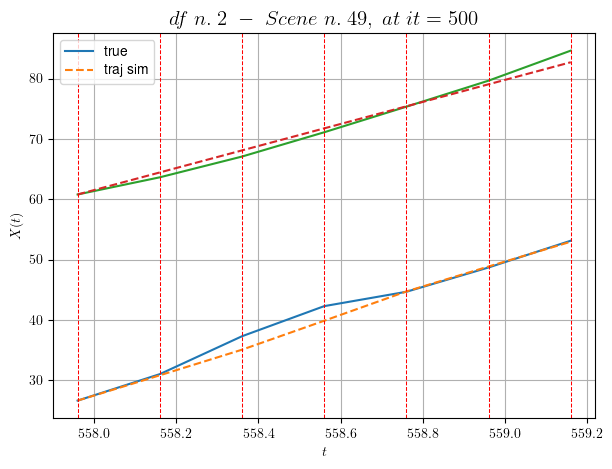

----------------------------------------------------------------------------------------------------
        For scene 26/46:
        * After LR finder: LR_NN=0.01 with mse=33.642408118635 at it=24
        * v0 = 18.265989604983368
        * MSE = 1.0039979291542163
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.27/46
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [253.96,254.56]


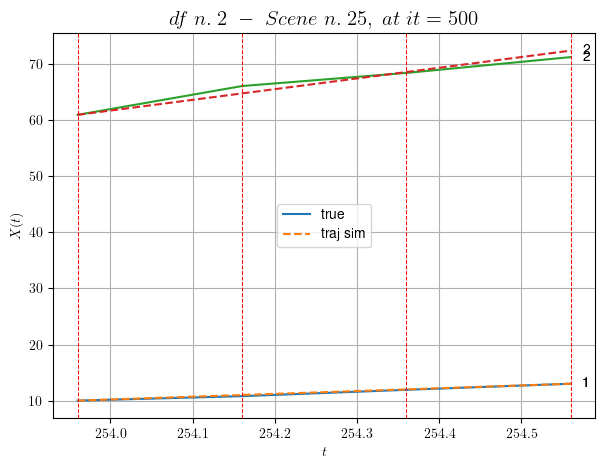

----------------------------------------------------------------------------------------------------
        For scene 27/46:
        * After LR finder: LR_NN=0.0005 with mse=10.115663152263041 at it=24
        * v0 = 19.059884309201756
        * MSE = 0.3913537449264675
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.28/46
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [430.16,430.96]


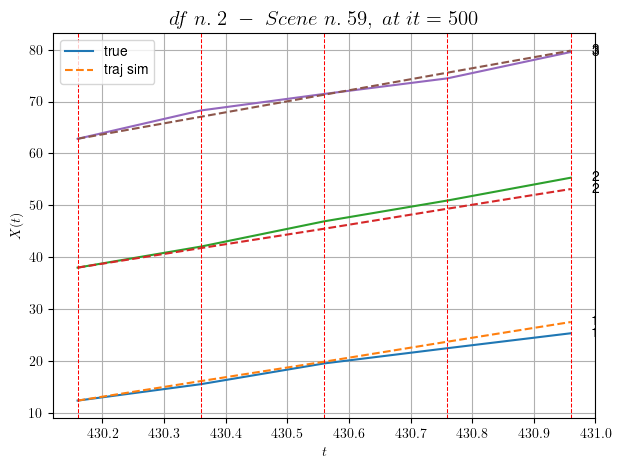

----------------------------------------------------------------------------------------------------
        For scene 28/46:
        * After LR finder: LR_NN=0.005 with mse=8.07988708213379 at it=24
        * v0 = 21.236902740722694
        * MSE = 1.2574453458831263
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.29/46
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [531.76,532.76]


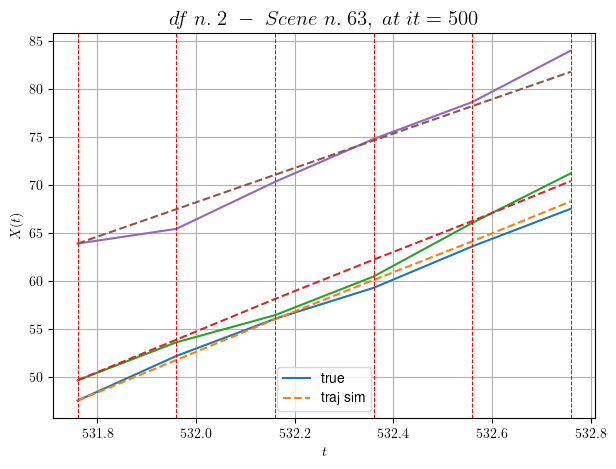

----------------------------------------------------------------------------------------------------
        For scene 29/46:
        * After LR finder: LR_NN=0.005 with mse=16.36251103430873 at it=24
        * v0 = 17.91173132808019
        * MSE = 0.9816110926592847
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.30/46
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [145.16,145.56]


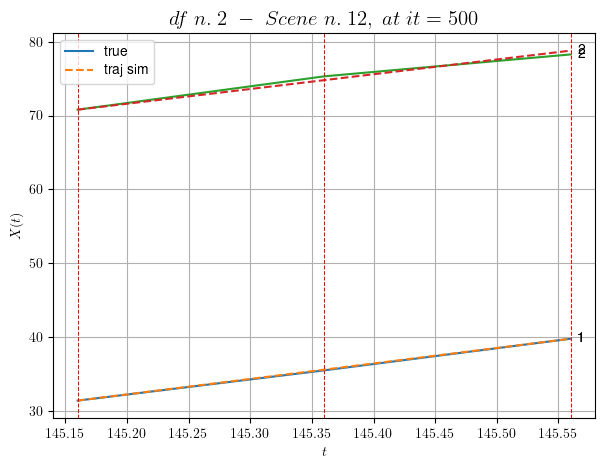

----------------------------------------------------------------------------------------------------
        For scene 30/46:
        * After LR finder: LR_NN=5e-05 with mse=3.7546977256828575 at it=24
        * v0 = 20.018762316549207
        * MSE = 0.09053920262879596
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.31/46
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [358.16,358.76]


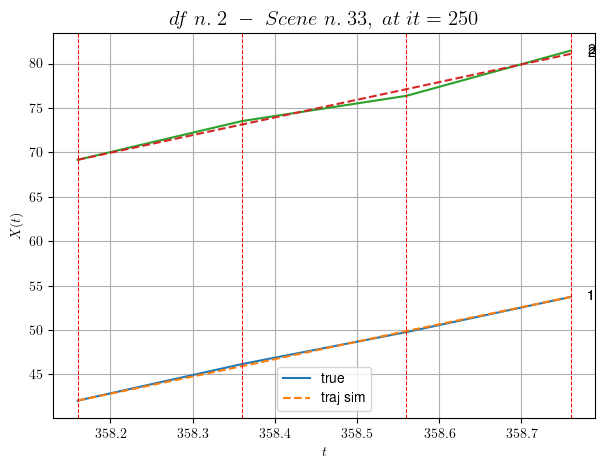

----------------------------------------------------------------------------------------------------
        For scene 31/46:
        * After LR finder: LR_NN=0.005 with mse=7.297744063441811 at it=24
        * v0 = 19.87712656027294
        * MSE = 0.113965427603415
        * iterations = 250
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.32/46
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [549.76,550.16]


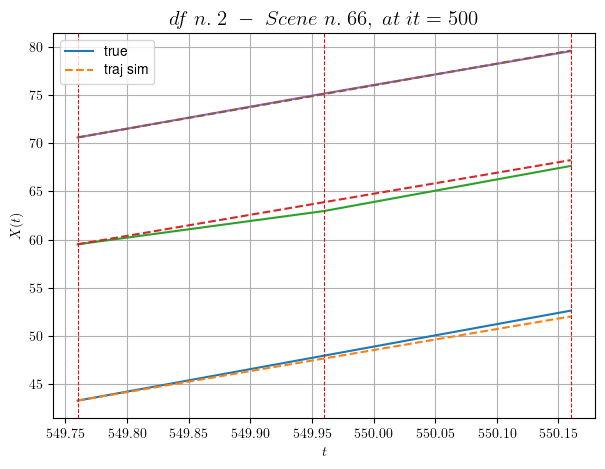

----------------------------------------------------------------------------------------------------
        For scene 32/46:
        * After LR finder: LR_NN=0.0005 with mse=1.4682940511438975 at it=24
        * v0 = 22.495719525414984
        * MSE = 0.18327360495716025
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.33/46
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [566.76,567.16]


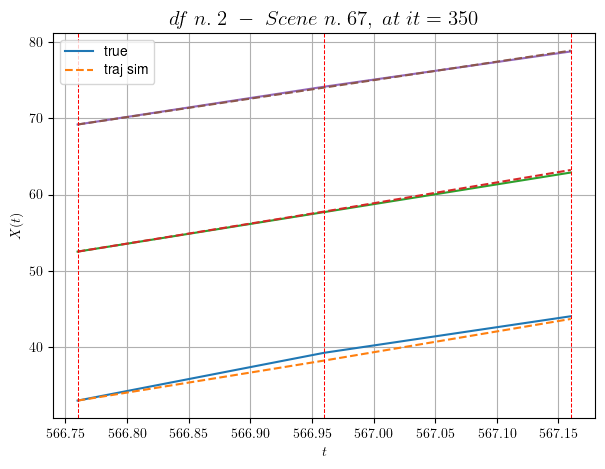

----------------------------------------------------------------------------------------------------
        For scene 33/46:
        * After LR finder: LR_NN=0.005 with mse=0.9240329311341543 at it=24
        * v0 = 24.222562138251483
        * MSE = 0.14512727347546833
        * iterations = 350
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.34/46
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [411.36,412.16]


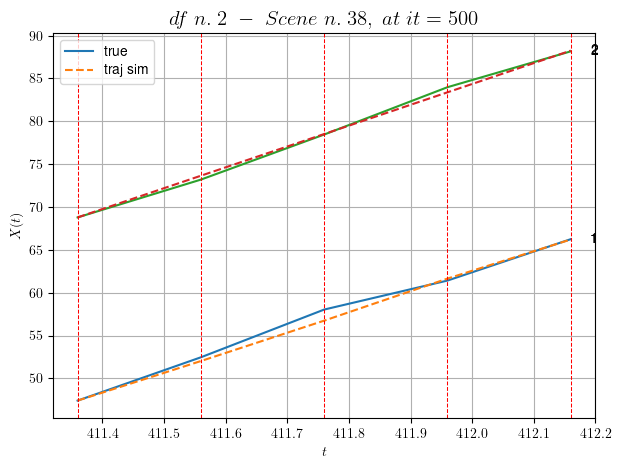

----------------------------------------------------------------------------------------------------
        For scene 34/46:
        * After LR finder: LR_NN=0.005 with mse=3.9332959258275206 at it=24
        * v0 = 24.337743181531415
        * MSE = 0.24694274565862018
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.35/46
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [314.96,315.36]


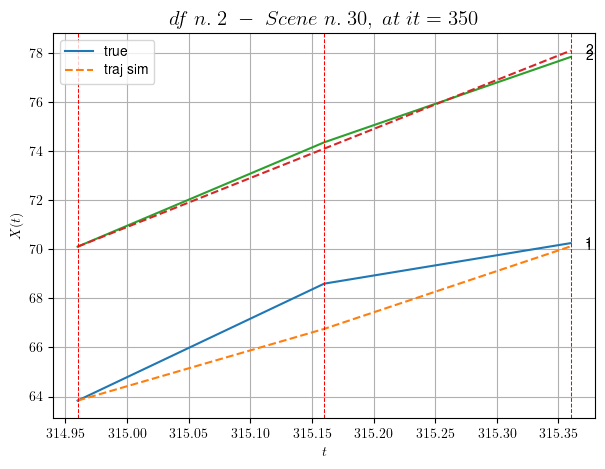

----------------------------------------------------------------------------------------------------
        For scene 35/46:
        * After LR finder: LR_NN=0.005 with mse=4.171330144257608 at it=24
        * v0 = 19.975403170578783
        * MSE = 0.5915005327316631
        * iterations = 350
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.36/46
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [494.76,495.36]


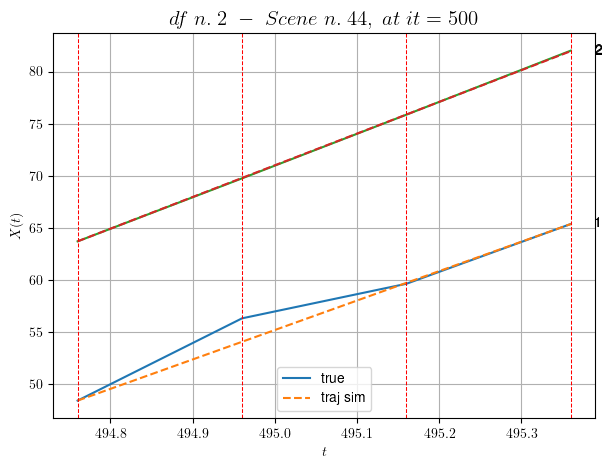

----------------------------------------------------------------------------------------------------
        For scene 36/46:
        * After LR finder: LR_NN=0.0001 with mse=0.7137000859324363 at it=24
        * v0 = 30.442979864263386
        * MSE = 0.6354040358387302
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.37/46
----------------------------------------------------------------------------------------------------
We have 6 time intervals inside [541.16,542.36]


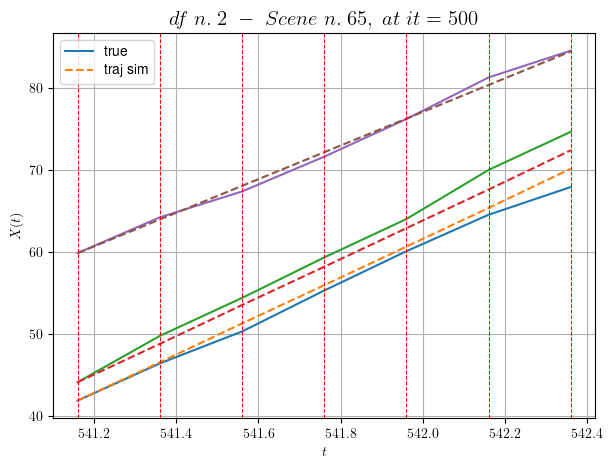

----------------------------------------------------------------------------------------------------
        For scene 37/46:
        * After LR finder: LR_NN=0.005 with mse=16.51252952014718 at it=24
        * v0 = 20.489990975465556
        * MSE = 1.1502915437524626
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.38/46
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [14.76,15.36]


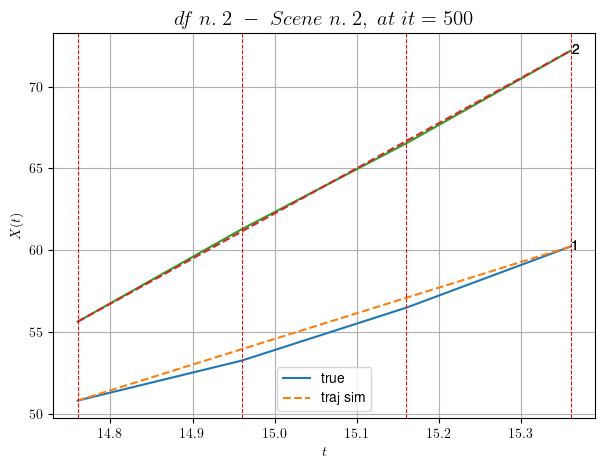

----------------------------------------------------------------------------------------------------
        For scene 38/46:
        * After LR finder: LR_NN=0.0005 with mse=0.4984019587012149 at it=24
        * v0 = 27.615406088656982
        * MSE = 0.11121398505511697
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.39/46
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [109.36,110.16]


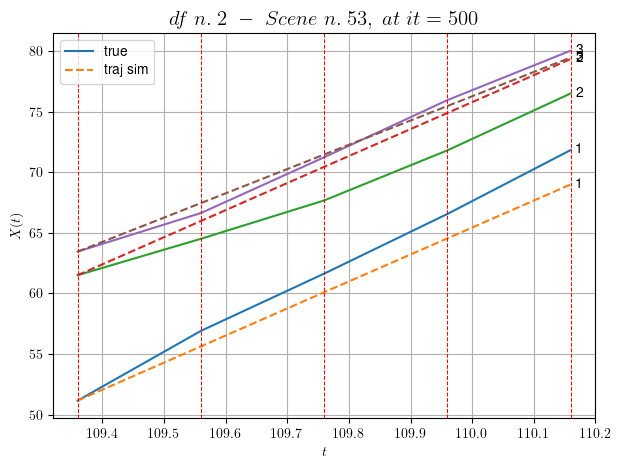

----------------------------------------------------------------------------------------------------
        For scene 39/46:
        * After LR finder: LR_NN=0.001 with mse=8.779473757117916 at it=24
        * v0 = 20.033858704330992
        * MSE = 2.9798391008412817
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.40/46
----------------------------------------------------------------------------------------------------
We have 10 time intervals inside [233.36,235.36]


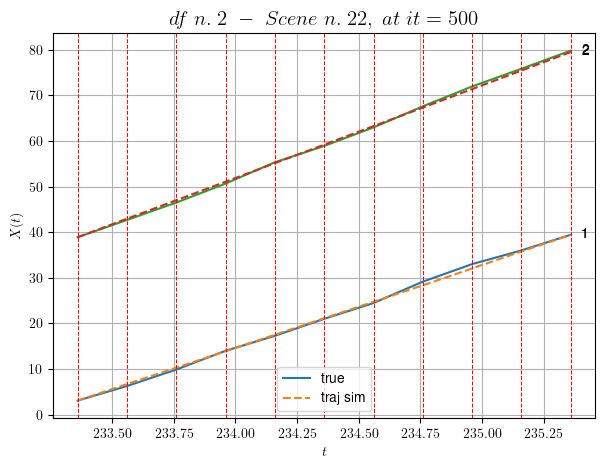

----------------------------------------------------------------------------------------------------
        For scene 40/46:
        * After LR finder: LR_NN=0.01 with mse=64.6072952554871 at it=24
        * v0 = 20.30078342708432
        * MSE = 0.15598592673174072
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.41/46
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [52.76,53.56]


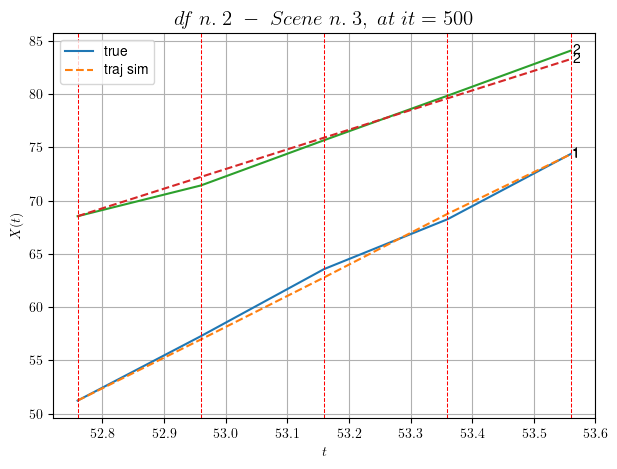

----------------------------------------------------------------------------------------------------
        For scene 41/46:
        * After LR finder: LR_NN=0.005 with mse=15.089887228131959 at it=24
        * v0 = 18.434937295304437
        * MSE = 0.2304882998527316
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.42/46
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [250.16,250.96]


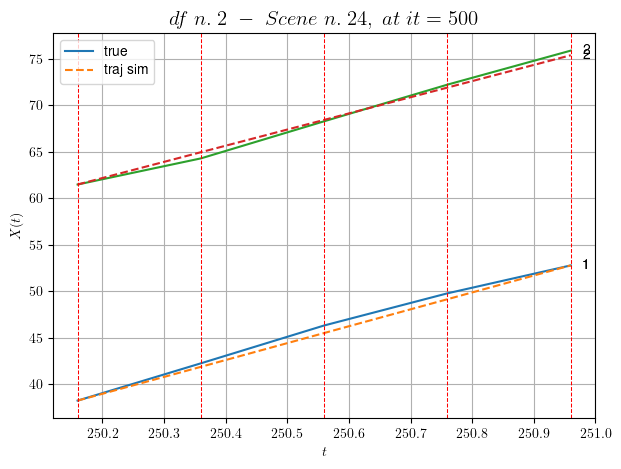

----------------------------------------------------------------------------------------------------
        For scene 42/46:
        * After LR finder: LR_NN=0.0001 with mse=18.382346358943668 at it=24
        * v0 = 17.364515373912546
        * MSE = 0.13977615310375344
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.43/46
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [223.16,223.56]


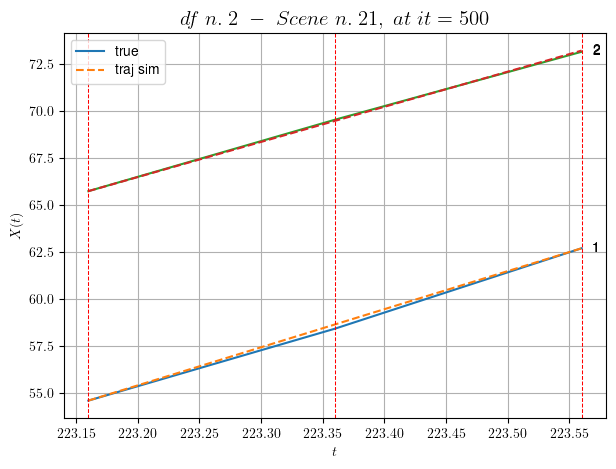

----------------------------------------------------------------------------------------------------
        For scene 43/46:
        * After LR finder: LR_NN=0.0001 with mse=4.315552220185525 at it=24
        * v0 = 18.698370205341583
        * MSE = 0.008124145279246662
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.44/46
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [442.76,443.76]


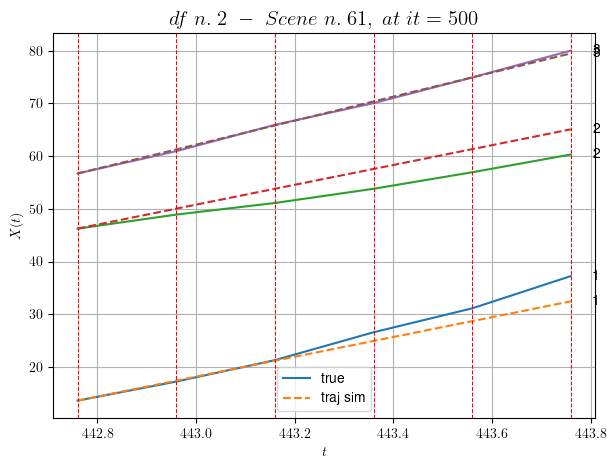

----------------------------------------------------------------------------------------------------
        For scene 44/46:
        * After LR finder: LR_NN=0.001 with mse=11.317313981666627 at it=24
        * v0 = 22.775896802504626
        * MSE = 5.378490354142994
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.45/46
----------------------------------------------------------------------------------------------------
We have 10 time intervals inside [198.16,200.16]


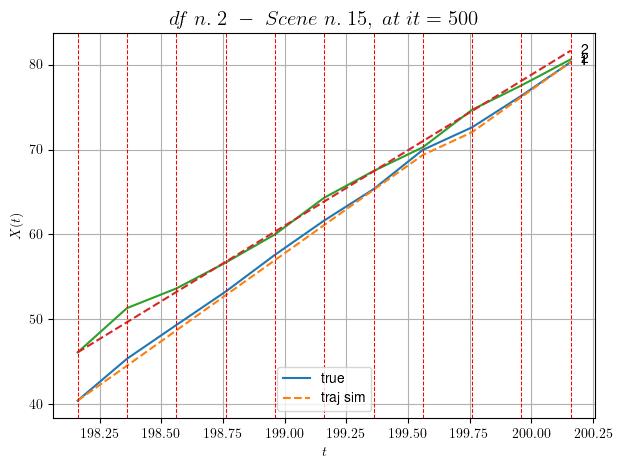

----------------------------------------------------------------------------------------------------
        For scene 45/46:
        * After LR finder: LR_NN=0.005 with mse=108.71568540177934 at it=24
        * v0 = 17.756279251513195
        * MSE = 0.35282902899375757
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.46/46
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [86.16,86.96]


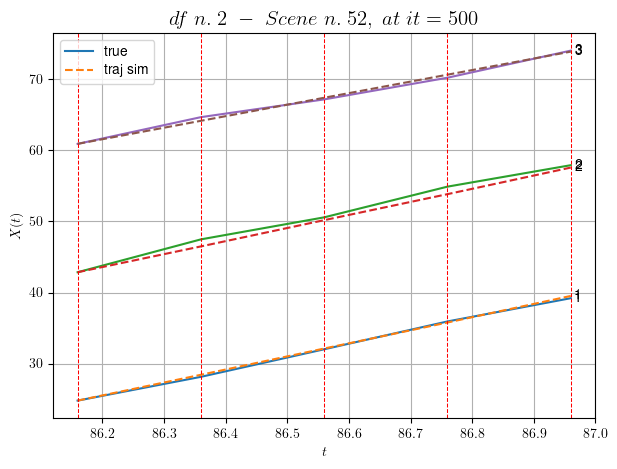

----------------------------------------------------------------------------------------------------
        For scene 46/46:
        * After LR finder: LR_NN=0.005 with mse=15.630295724970438 at it=24
        * v0 = 16.235330060145877
        * MSE = 0.20668198034131205
        * iterations = 500
----------------------------------------------------------------------------------------------------


MSE train: 0.6093983448988035
- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -

Testing step. (23 scenes)
DataFrame n.2. Scene n.1/23


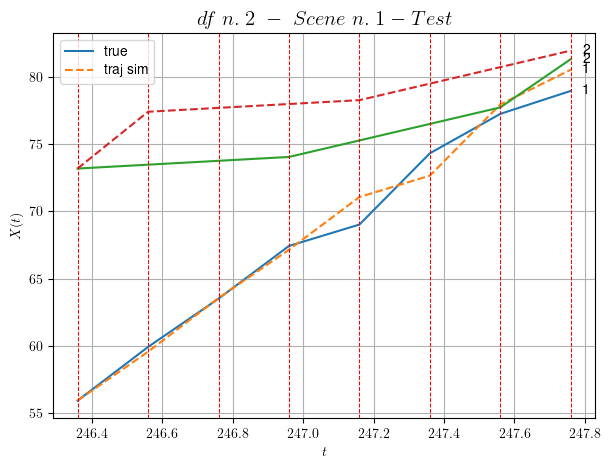

        For scene 1/23:
        * MSE = 5.245786013588953
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.2/23


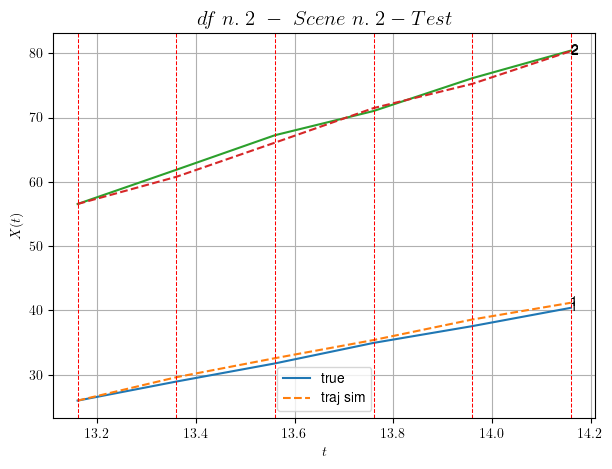

        For scene 2/23:
        * MSE = 0.5422207764882403
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.3/23


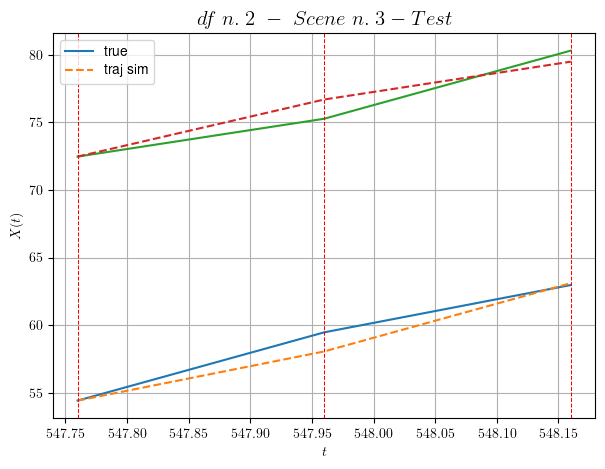

        For scene 3/23:
        * MSE = 0.784902105341216
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.4/23


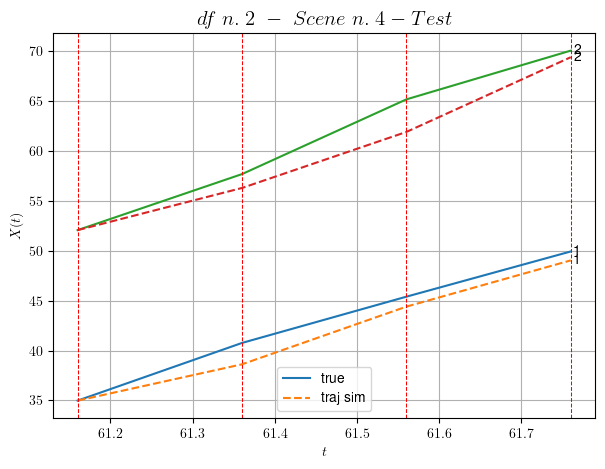

        For scene 4/23:
        * MSE = 2.4247539261509803
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.5/23


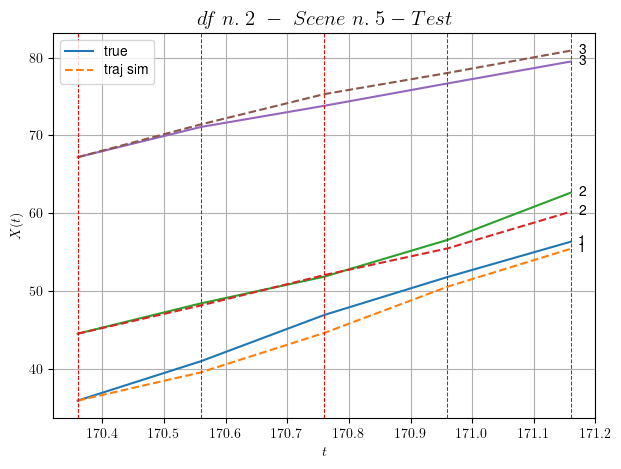

        For scene 5/23:
        * MSE = 1.5465301230654582
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.6/23


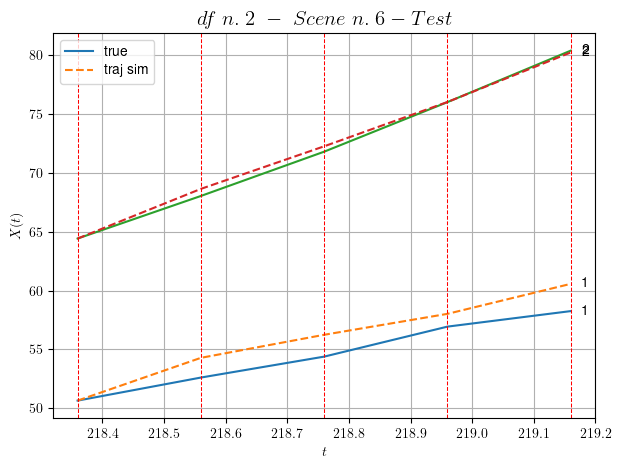

        For scene 6/23:
        * MSE = 1.3404549557646777
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.7/23


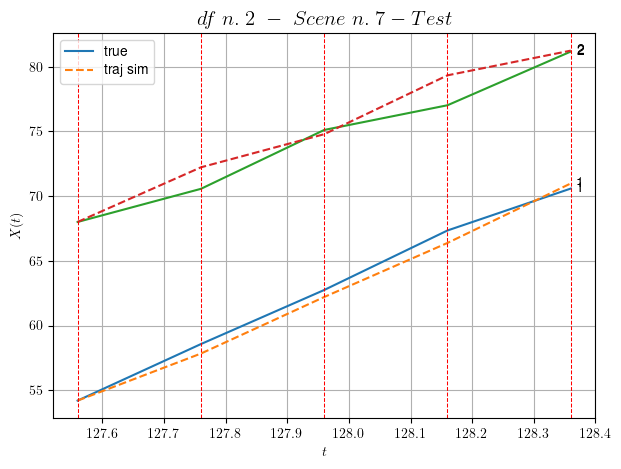

        For scene 7/23:
        * MSE = 1.0147536127876102
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.8/23


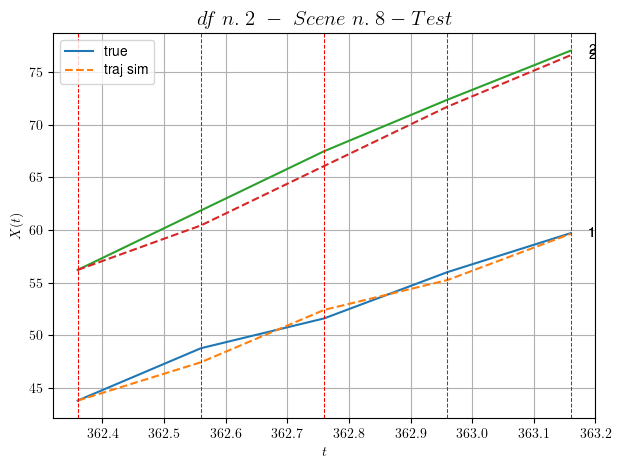

        For scene 8/23:
        * MSE = 0.7589885807435715
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.9/23


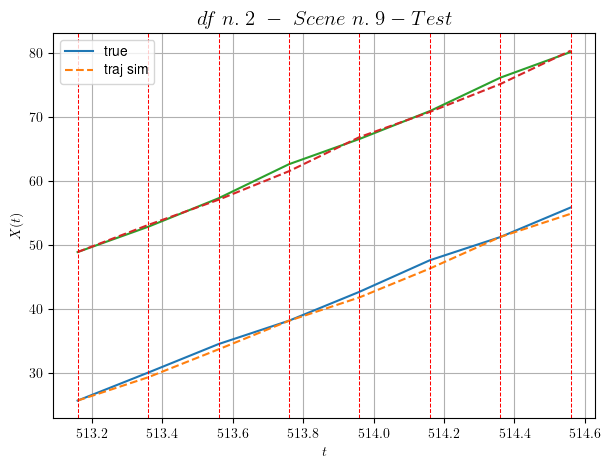

        For scene 9/23:
        * MSE = 0.4421552159441936
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.10/23


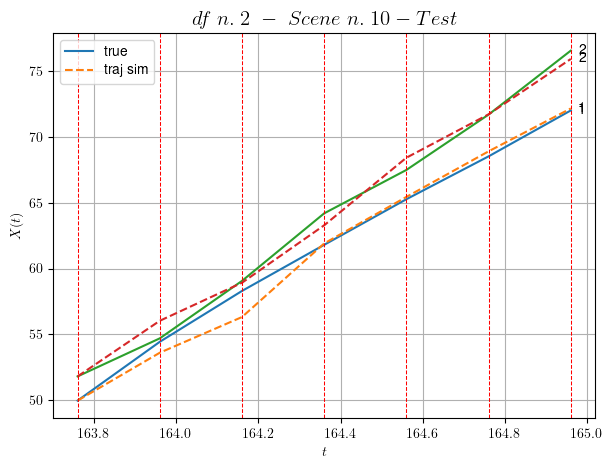

        For scene 10/23:
        * MSE = 0.6225508607765325
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.11/23


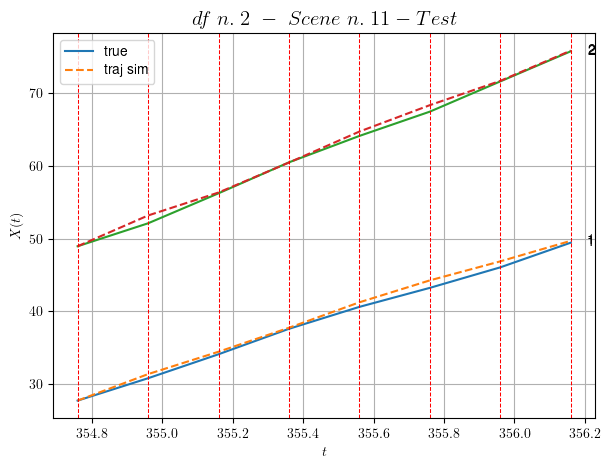

        For scene 11/23:
        * MSE = 0.3107888710566341
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.12/23


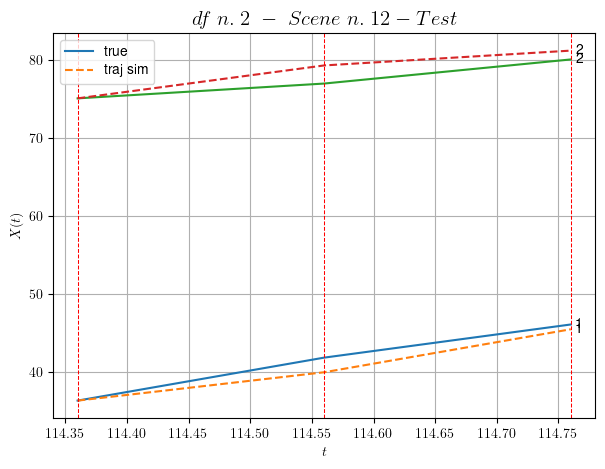

        For scene 12/23:
        * MSE = 1.7622249120775328
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.13/23


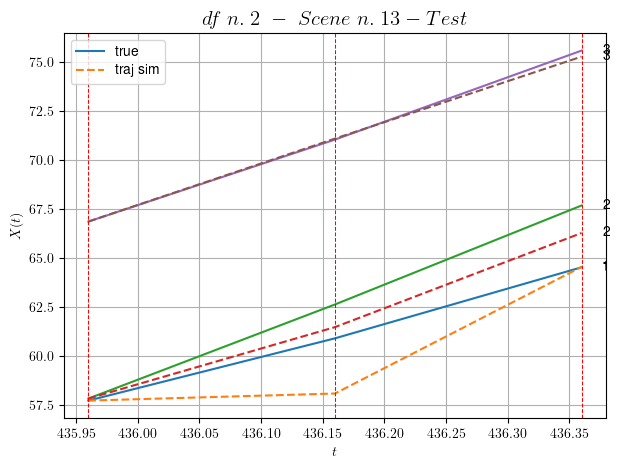

        For scene 13/23:
        * MSE = 1.2539461916732995
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.14/23


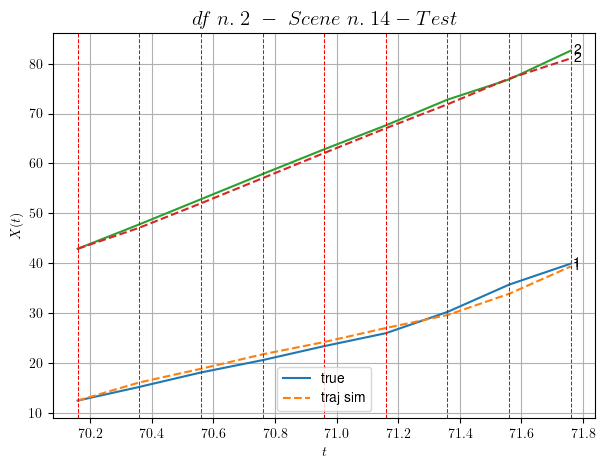

        For scene 14/23:
        * MSE = 0.8097315024715634
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.15/23


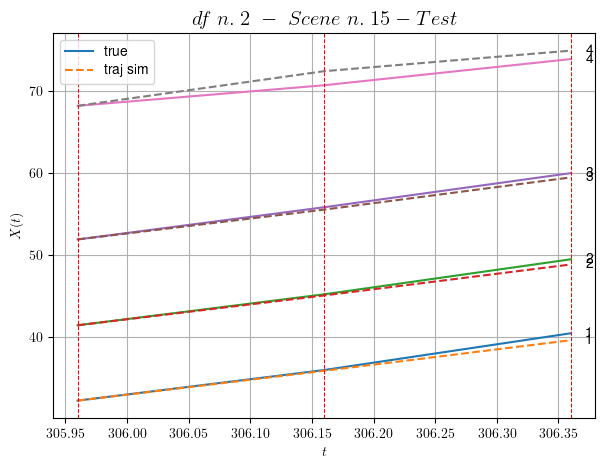

        For scene 15/23:
        * MSE = 0.4584530312046933
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.16/23


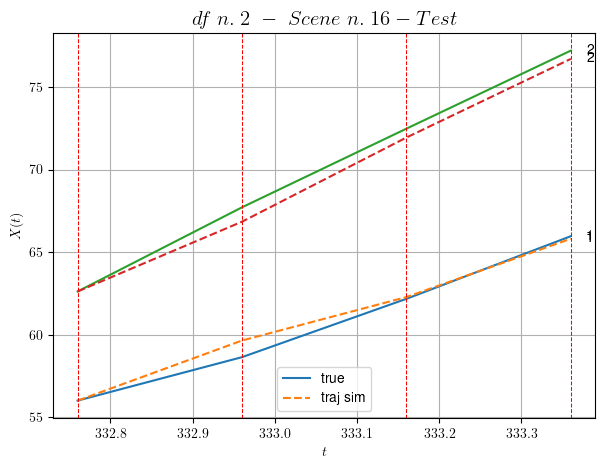

        For scene 16/23:
        * MSE = 0.29335180339975375
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.17/23


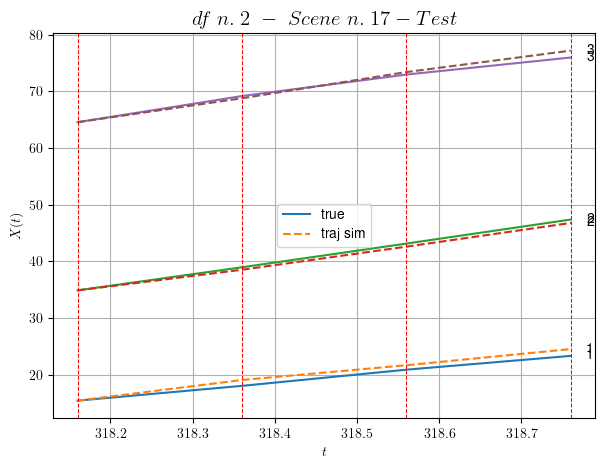

        For scene 17/23:
        * MSE = 0.4837785388277762
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.18/23


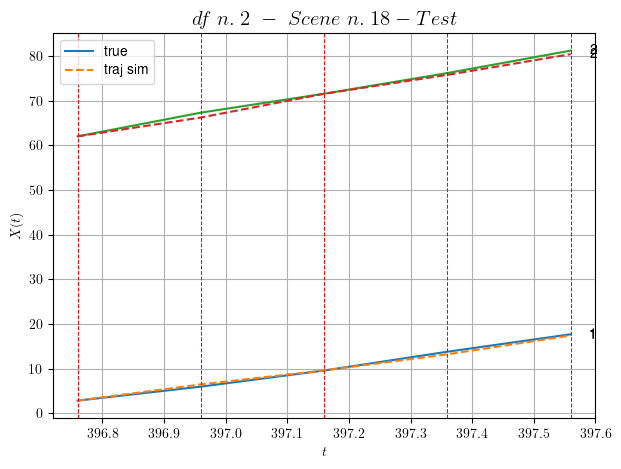

        For scene 18/23:
        * MSE = 0.2640675443871827
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.19/23


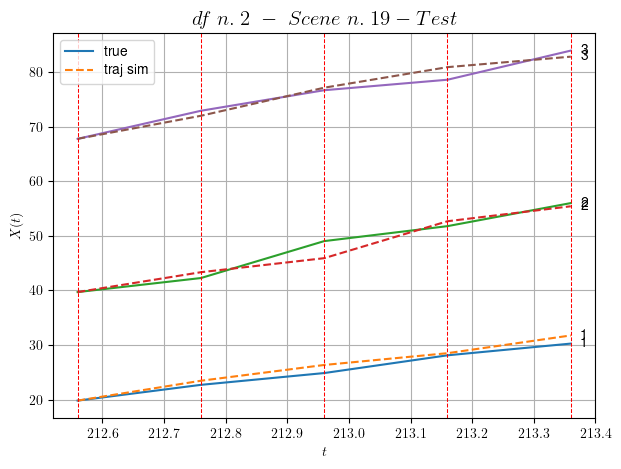

        For scene 19/23:
        * MSE = 1.6499180100833053
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.20/23


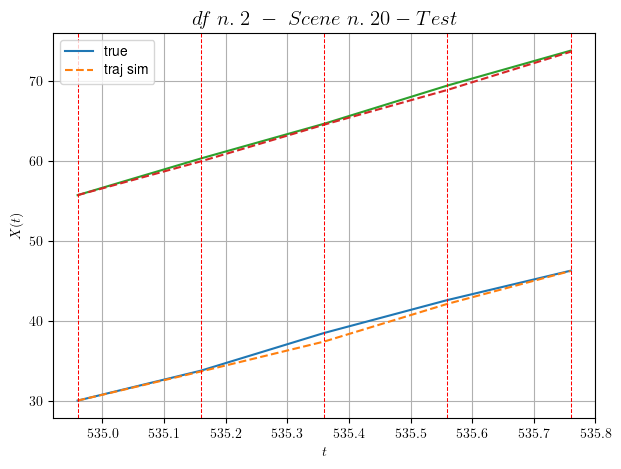

        For scene 20/23:
        * MSE = 0.18467030610091448
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.21/23


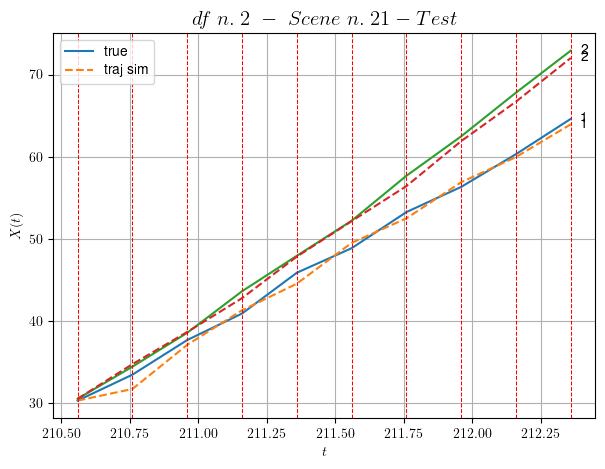

        For scene 21/23:
        * MSE = 0.5976843156241617
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.22/23


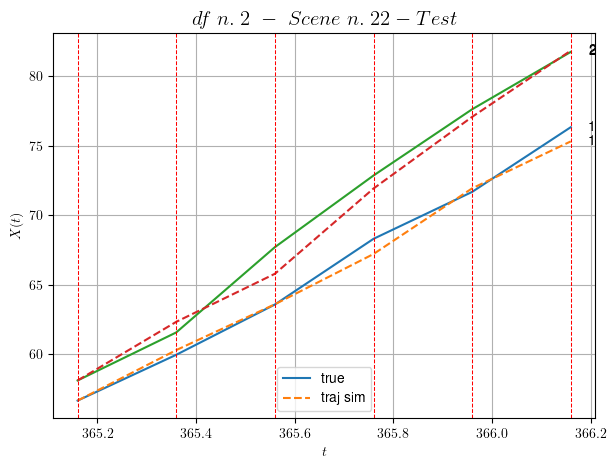

        For scene 22/23:
        * MSE = 0.6555834778360516
----------------------------------------------------------------------------------------------------


DataFrame n.2. Scene n.23/23


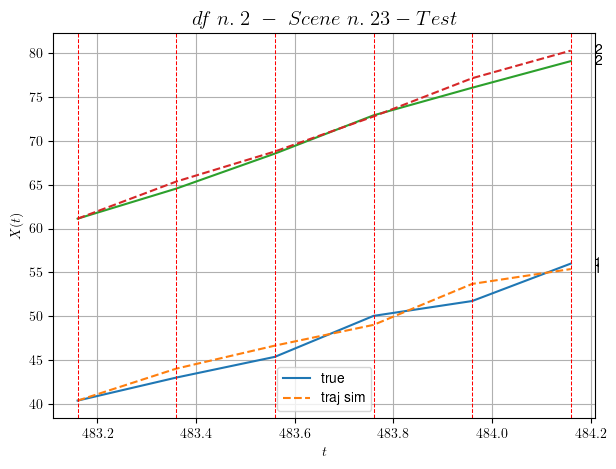

        For scene 23/23:
        * MSE = 0.9335826178240497
----------------------------------------------------------------------------------------------------


MSE test: 1.0600381431834067

- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -

    Summing up:
          * MSE train: 0.6093983448988035
          * MSE test: 1.0600381431834067
          
- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -




Analyzing 3/10 dfs.
In DataFrame n.3 we have 90 scenes.
    To train the model we use 60 scenes, the remaining 30 to test the model.

Training step. (60 scenes)
DataFrame n.3. Scene n.1/60
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [215.56,216.36]


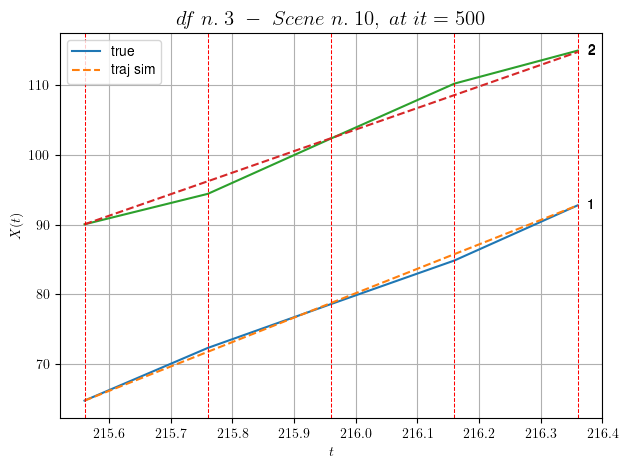

----------------------------------------------------------------------------------------------------
        For scene 1/60:
        * After LR finder: LR_NN=5e-05 with mse=0.8787510154687039 at it=24
        * v0 = 30.84289726496983
        * MSE = 0.6956120490385961
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.2/60
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [487.16,487.56]


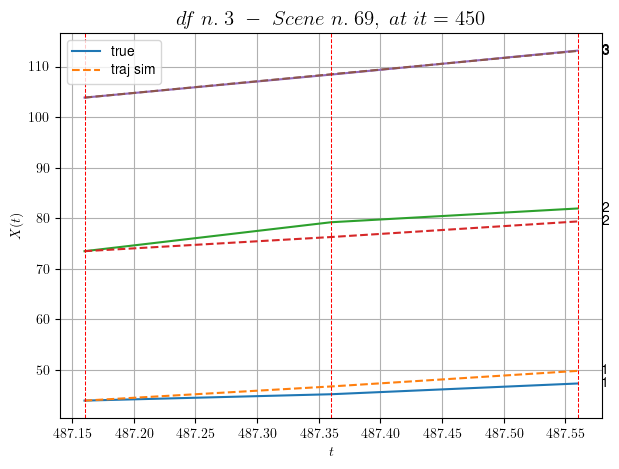

----------------------------------------------------------------------------------------------------
        For scene 2/60:
        * After LR finder: LR_NN=0.01 with mse=3.7062555354856 at it=24
        * v0 = 23.071833007762553
        * MSE = 2.63431190406827
        * iterations = 450
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.3/60
----------------------------------------------------------------------------------------------------
We have 17 time intervals inside [138.16,141.56]


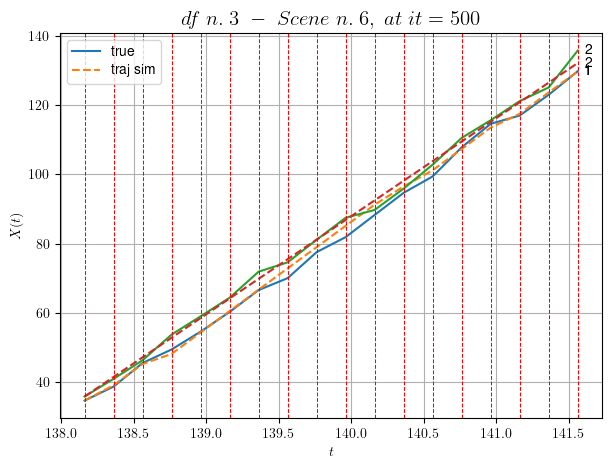

----------------------------------------------------------------------------------------------------
        For scene 3/60:
        * After LR finder: LR_NN=0.005 with mse=7.477130388190107 at it=24
        * v0 = 28.31863912796766
        * MSE = 1.7859921869935371
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.4/60
----------------------------------------------------------------------------------------------------
We have 7 time intervals inside [72.76,74.16]


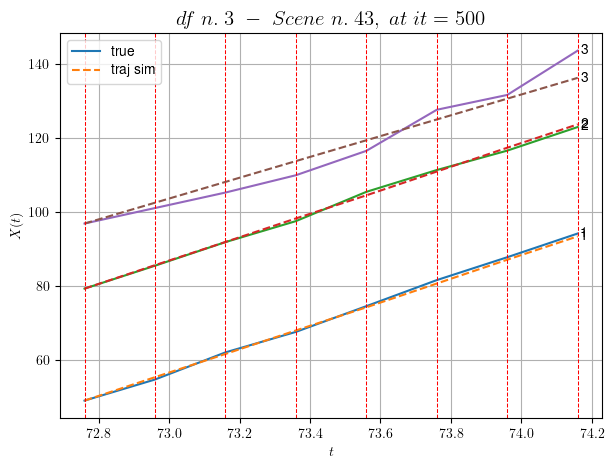

----------------------------------------------------------------------------------------------------
        For scene 4/60:
        * After LR finder: LR_NN=0.005 with mse=3.8043086103322374 at it=24
        * v0 = 28.121240263140216
        * MSE = 3.7617140817561587
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.5/60
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [143.76,144.36]


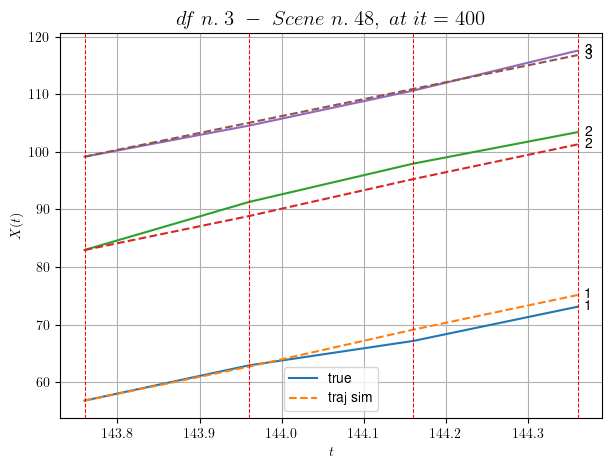

----------------------------------------------------------------------------------------------------
        For scene 5/60:
        * After LR finder: LR_NN=0.005 with mse=2.2613096477220025 at it=24
        * v0 = 29.414745218125105
        * MSE = 2.1885960996752405
        * iterations = 400
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.6/60
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [338.36,338.96]


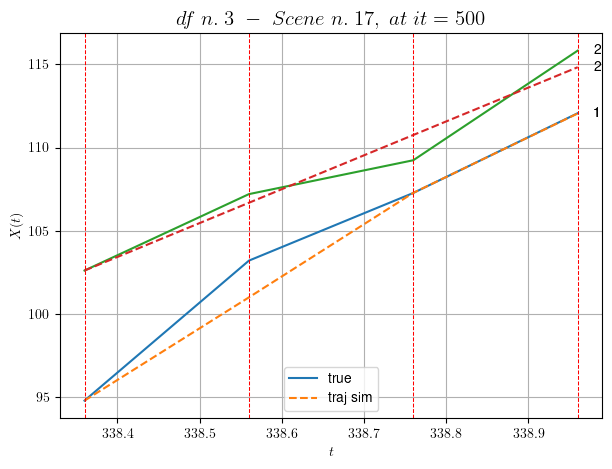

----------------------------------------------------------------------------------------------------
        For scene 6/60:
        * After LR finder: LR_NN=0.0005 with mse=7.359176946445742 at it=24
        * v0 = 20.358070226672712
        * MSE = 1.0525404766528288
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.7/60
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [130.96,131.96]


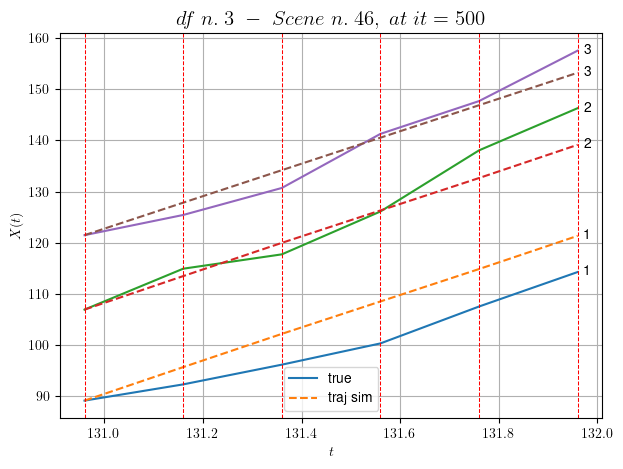

----------------------------------------------------------------------------------------------------
        For scene 7/60:
        * After LR finder: LR_NN=0.001 with mse=20.06429065867759 at it=24
        * v0 = 31.752337885124255
        * MSE = 18.93698583829259
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.8/60
----------------------------------------------------------------------------------------------------
We have 7 time intervals inside [590.36,591.76]


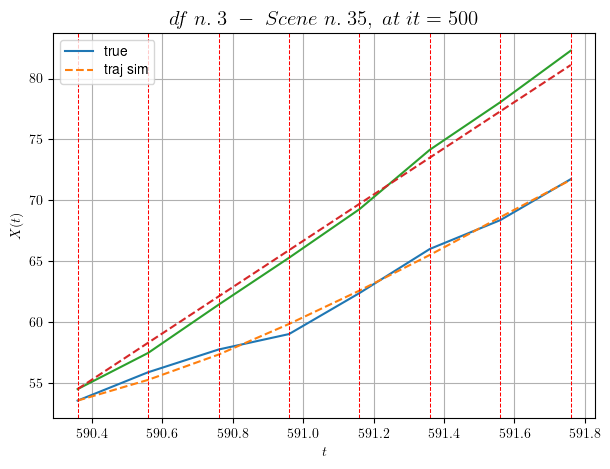

----------------------------------------------------------------------------------------------------
        For scene 8/60:
        * After LR finder: LR_NN=0.005 with mse=39.702872966069826 at it=24
        * v0 = 19.035476639426847
        * MSE = 0.3575411680591172
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.9/60
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [183.16,183.76]


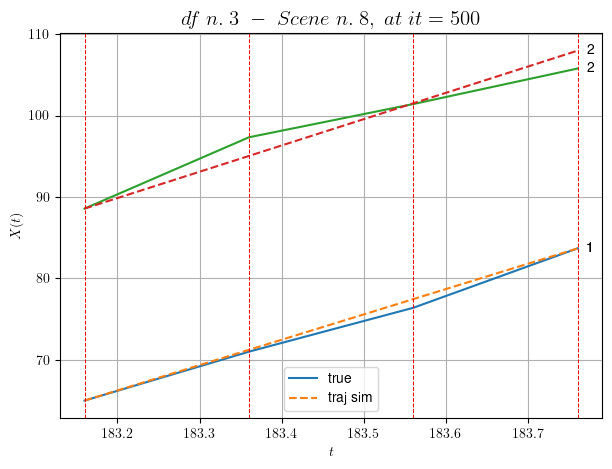

----------------------------------------------------------------------------------------------------
        For scene 9/60:
        * After LR finder: LR_NN=5e-05 with mse=1.2979603034167175 at it=24
        * v0 = 32.31398331046905
        * MSE = 1.3573530438406916
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.10/60
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [33.76,34.36]


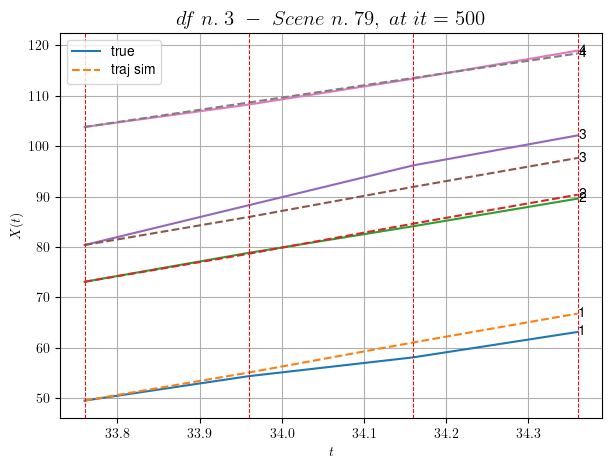

----------------------------------------------------------------------------------------------------
        For scene 10/60:
        * After LR finder: LR_NN=0.01 with mse=5.250030387904178 at it=24
        * v0 = 24.31564748296745
        * MSE = 4.229405178125876
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.11/60
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [486.56,487.56]


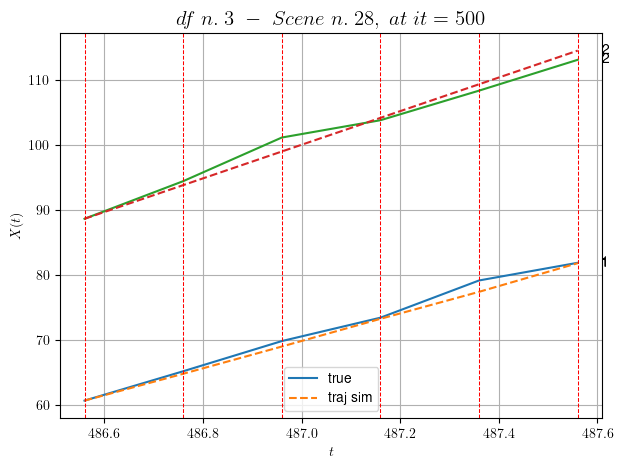

----------------------------------------------------------------------------------------------------
        For scene 11/60:
        * After LR finder: LR_NN=0.005 with mse=5.389723765283915 at it=24
        * v0 = 25.85811943170803
        * MSE = 0.9815848561545226
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.12/60
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [402.76,403.56]


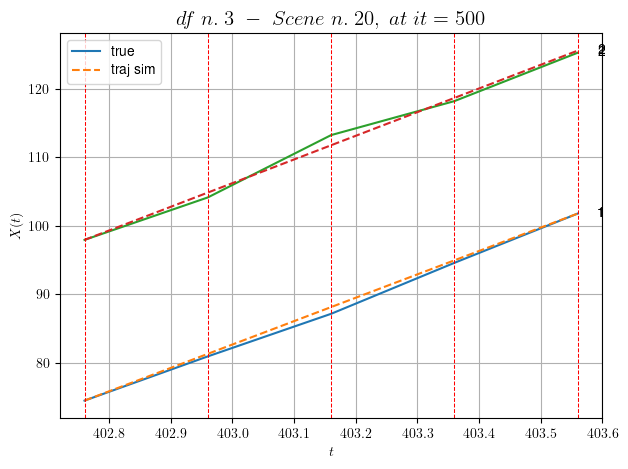

----------------------------------------------------------------------------------------------------
        For scene 12/60:
        * After LR finder: LR_NN=5e-05 with mse=2.772513465113263 at it=24
        * v0 = 34.519670722292325
        * MSE = 0.3850245017954337
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.13/60
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [248.16,248.56]


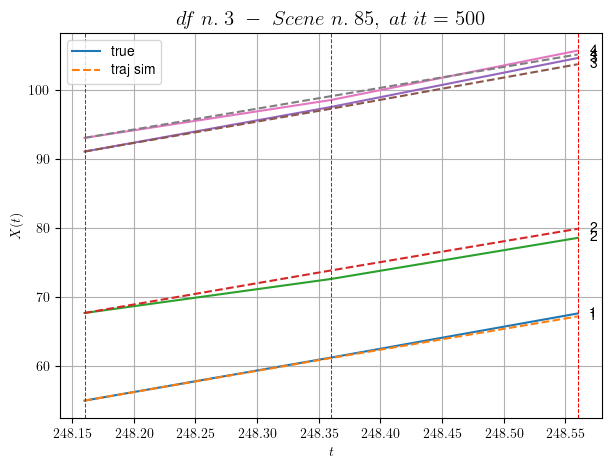

----------------------------------------------------------------------------------------------------
        For scene 13/60:
        * After LR finder: LR_NN=0.005 with mse=0.47684642555263296 at it=24
        * v0 = 30.248970609827506
        * MSE = 0.4065422373865755
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.14/60
----------------------------------------------------------------------------------------------------
We have 10 time intervals inside [464.56,466.56]


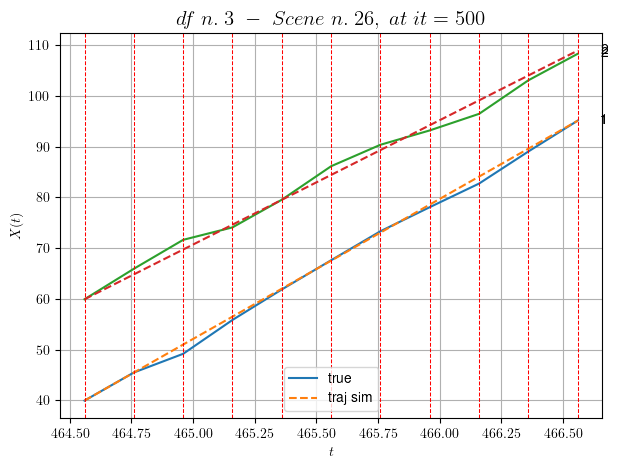

----------------------------------------------------------------------------------------------------
        For scene 14/60:
        * After LR finder: LR_NN=0.001 with mse=24.847206327009197 at it=24
        * v0 = 24.498602704881392
        * MSE = 1.1306764222301164
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.15/60
----------------------------------------------------------------------------------------------------
We have 6 time intervals inside [247.36,248.56]


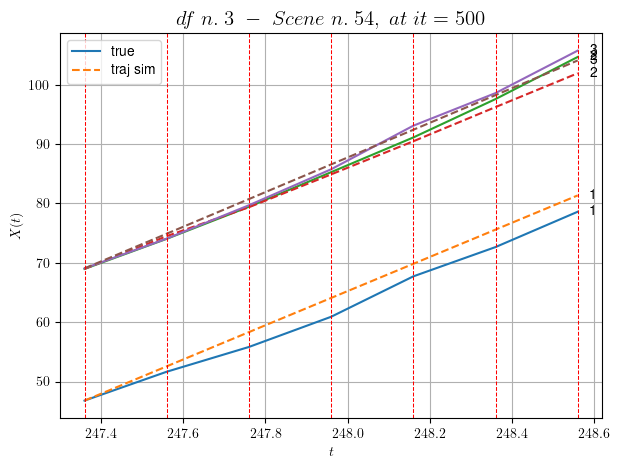

----------------------------------------------------------------------------------------------------
        For scene 15/60:
        * After LR finder: LR_NN=0.0005 with mse=1.2005768724215096 at it=24
        * v0 = 29.19954509278777
        * MSE = 1.1816906215299172
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.16/60
----------------------------------------------------------------------------------------------------
We have 10 time intervals inside [292.56,294.56]


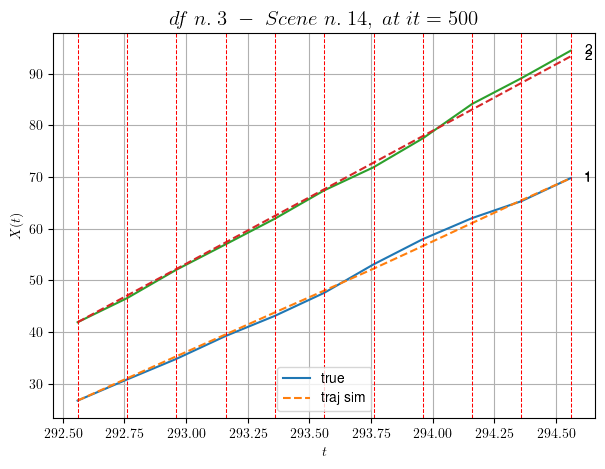

----------------------------------------------------------------------------------------------------
        For scene 16/60:
        * After LR finder: LR_NN=0.01 with mse=11.971434759059978 at it=24
        * v0 = 25.740986248380615
        * MSE = 0.39846540262008745
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.17/60
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [438.16,438.76]


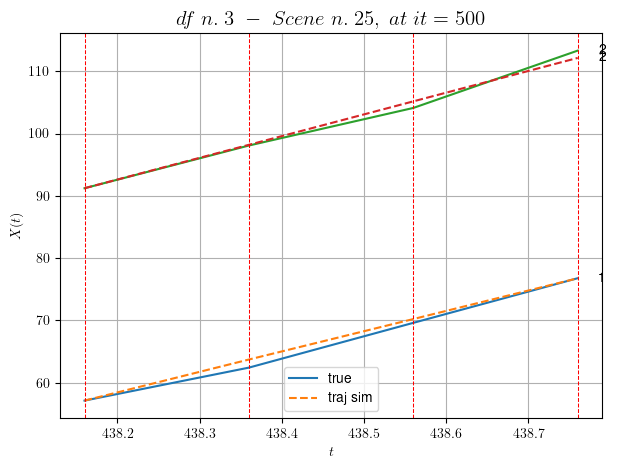

----------------------------------------------------------------------------------------------------
        For scene 17/60:
        * After LR finder: LR_NN=0.001 with mse=2.5349751574094954 at it=24
        * v0 = 34.86837809331573
        * MSE = 0.5677484562421279
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.18/60
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [79.56,80.36]


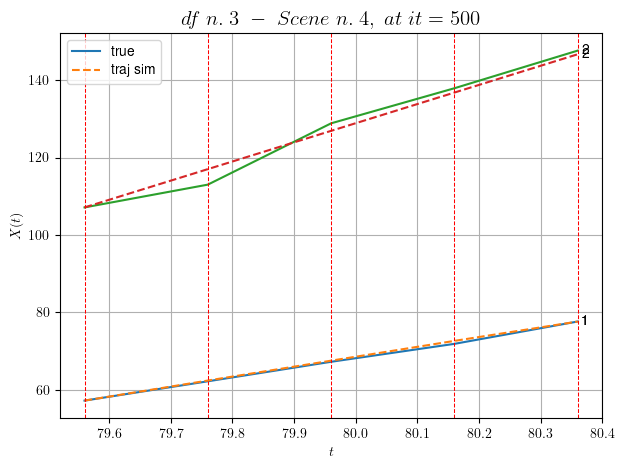

----------------------------------------------------------------------------------------------------
        For scene 18/60:
        * After LR finder: LR_NN=0.005 with mse=53.0220113794766 at it=24
        * v0 = 49.42636153730838
        * MSE = 2.2610193906688996
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.19/60
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [377.56,378.36]


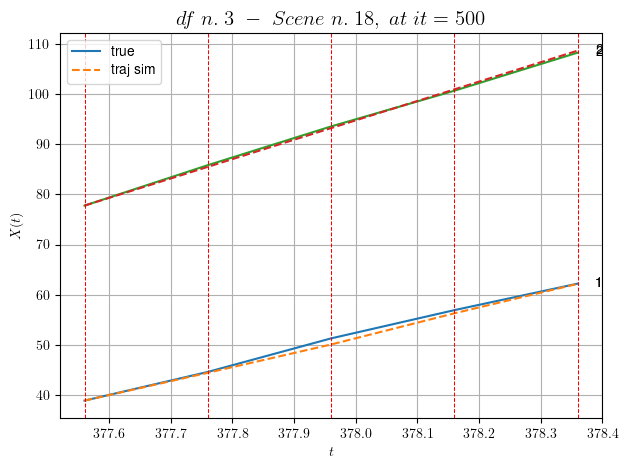

----------------------------------------------------------------------------------------------------
        For scene 19/60:
        * After LR finder: LR_NN=0.01 with mse=8.649912799665092 at it=24
        * v0 = 38.59992828378415
        * MSE = 0.2368860090863729
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.20/60
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [42.96,43.76]


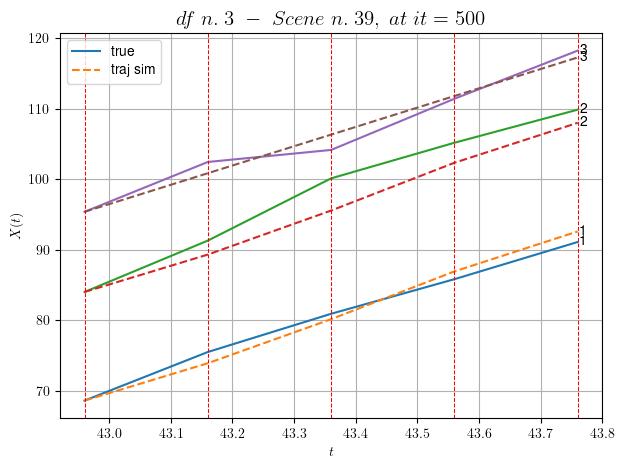

----------------------------------------------------------------------------------------------------
        For scene 20/60:
        * After LR finder: LR_NN=0.01 with mse=3.4494577670440627 at it=24
        * v0 = 27.350673440922286
        * MSE = 3.1156932514150877
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.21/60
----------------------------------------------------------------------------------------------------
We have 8 time intervals inside [199.96,201.56]


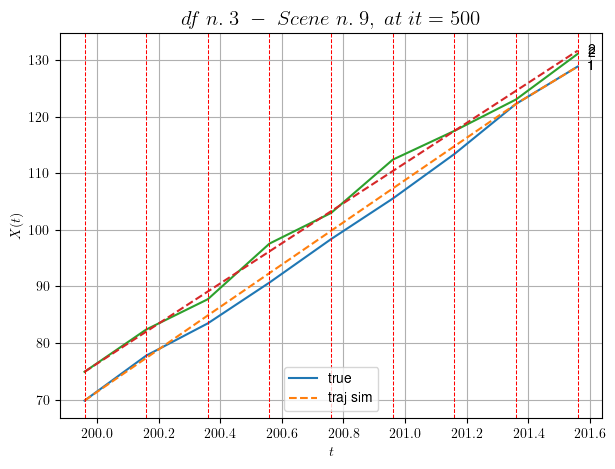

----------------------------------------------------------------------------------------------------
        For scene 21/60:
        * After LR finder: LR_NN=0.001 with mse=14.088729610506556 at it=24
        * v0 = 35.48263392775788
        * MSE = 1.2647849691652968
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.22/60
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [393.36,393.76]


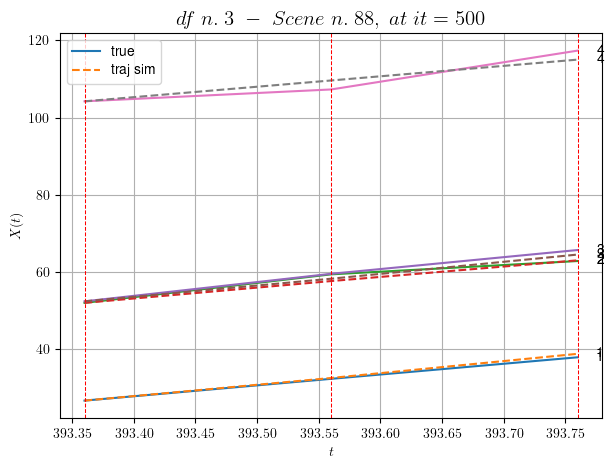

----------------------------------------------------------------------------------------------------
        For scene 22/60:
        * After LR finder: LR_NN=0.005 with mse=1.6953368824835091 at it=24
        * v0 = 27.006293536405362
        * MSE = 1.4814288908805335
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.23/60
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [154.56,155.36]


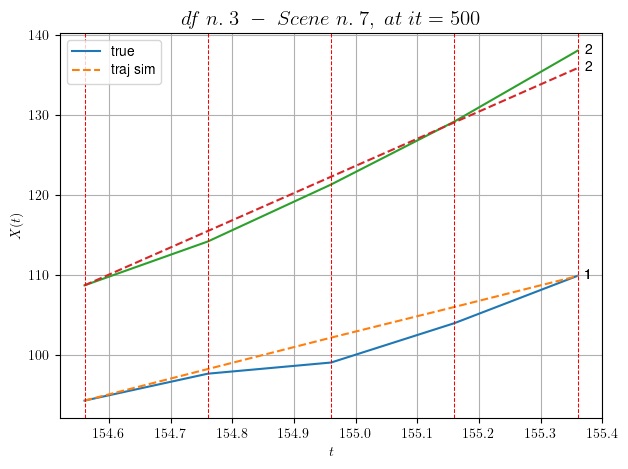

----------------------------------------------------------------------------------------------------
        For scene 23/60:
        * After LR finder: LR_NN=0.001 with mse=4.532300454966095 at it=24
        * v0 = 33.88242010375711
        * MSE = 2.1281500335257624
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.24/60
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [448.36,448.76]


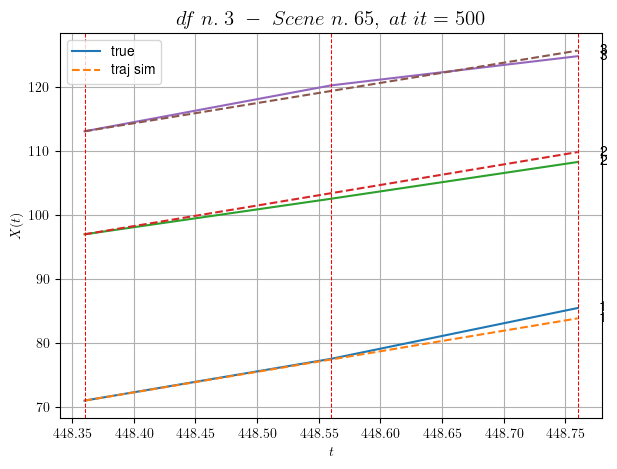

----------------------------------------------------------------------------------------------------
        For scene 24/60:
        * After LR finder: LR_NN=5e-05 with mse=0.6218164302520264 at it=24
        * v0 = 31.58504818637651
        * MSE = 0.8093959556572611
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.25/60
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [17.56,17.96]


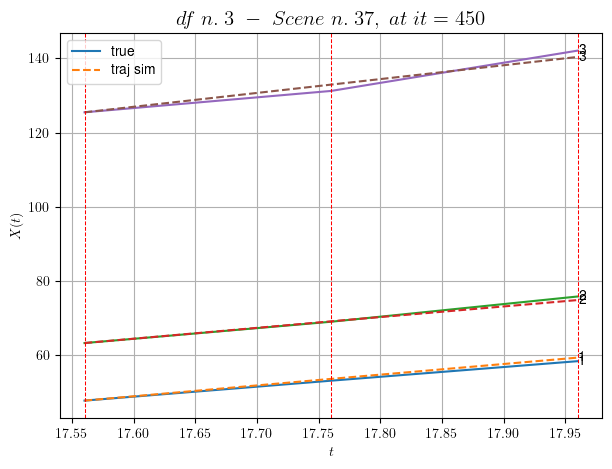

----------------------------------------------------------------------------------------------------
        For scene 25/60:
        * After LR finder: LR_NN=0.005 with mse=2.6360152756708106 at it=24
        * v0 = 37.34160747309818
        * MSE = 0.877181409827382
        * iterations = 450
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.26/60
----------------------------------------------------------------------------------------------------
We have 6 time intervals inside [83.36,84.56]


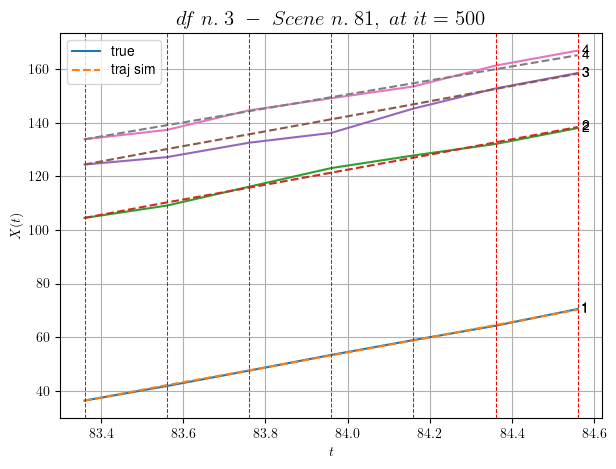

----------------------------------------------------------------------------------------------------
        For scene 26/60:
        * After LR finder: LR_NN=0.005 with mse=3.5563915256759153 at it=24
        * v0 = 26.10772419731467
        * MSE = 2.1340639300801203
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.27/60
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [95.36,95.76]


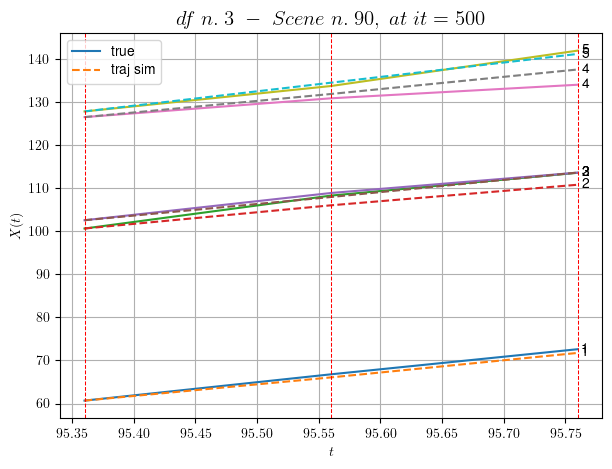

----------------------------------------------------------------------------------------------------
        For scene 27/60:
        * After LR finder: LR_NN=0.005 with mse=2.0191139514738508 at it=24
        * v0 = 33.3513742869809
        * MSE = 1.8083251309213986
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.28/60
----------------------------------------------------------------------------------------------------
We have 7 time intervals inside [269.56,270.96]


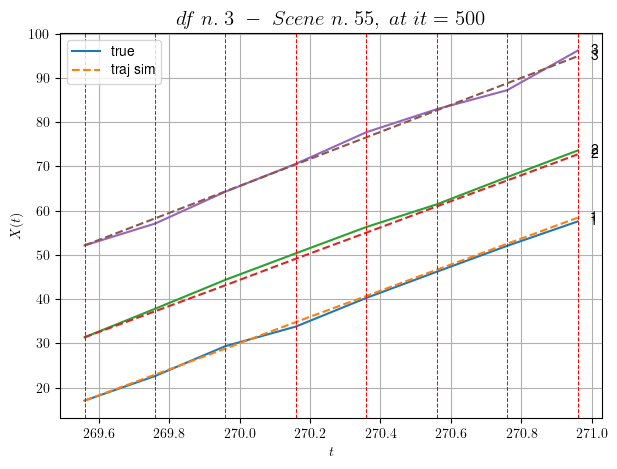

----------------------------------------------------------------------------------------------------
        For scene 28/60:
        * After LR finder: LR_NN=0.005 with mse=0.7890062824027128 at it=24
        * v0 = 30.539175669713433
        * MSE = 0.6704753672334669
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.29/60
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [82.16,82.76]


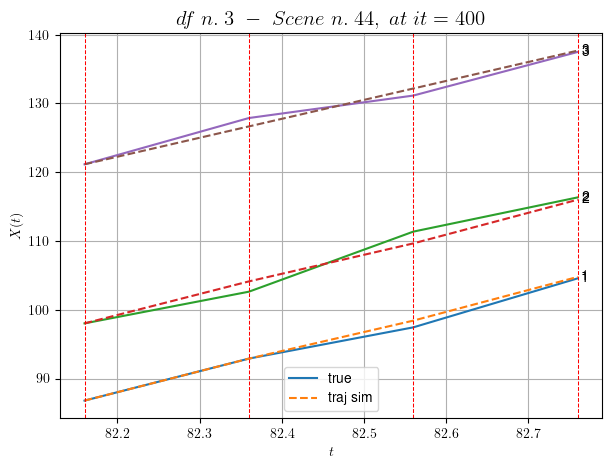

----------------------------------------------------------------------------------------------------
        For scene 29/60:
        * After LR finder: LR_NN=0.01 with mse=1.1784848748162222 at it=24
        * v0 = 27.55024057347437
        * MSE = 0.7378809864076107
        * iterations = 400
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.30/60
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [207.96,208.76]


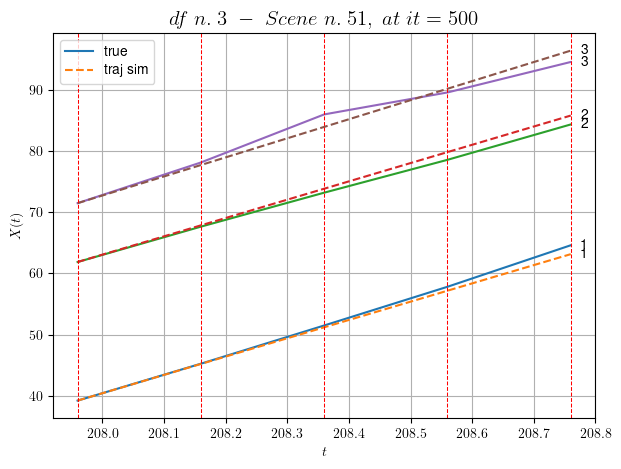

----------------------------------------------------------------------------------------------------
        For scene 30/60:
        * After LR finder: LR_NN=0.001 with mse=0.9748345716459005 at it=24
        * v0 = 31.12490964519052
        * MSE = 0.9448913641340774
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.31/60
----------------------------------------------------------------------------------------------------
We have 12 time intervals inside [139.16,141.56]


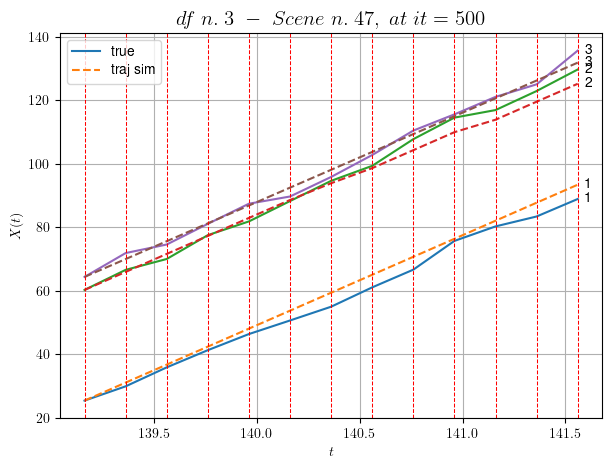

----------------------------------------------------------------------------------------------------
        For scene 31/60:
        * After LR finder: LR_NN=0.001 with mse=5.83179673855745 at it=24
        * v0 = 28.144630567259213
        * MSE = 3.885551390553386
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.32/60
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [390.36,390.76]


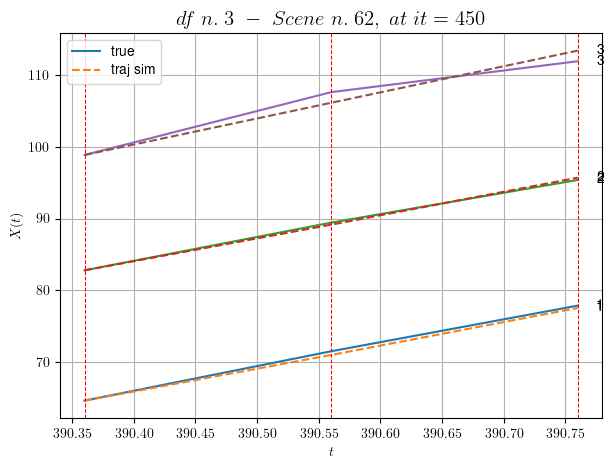

----------------------------------------------------------------------------------------------------
        For scene 32/60:
        * After LR finder: LR_NN=0.005 with mse=1.0372546717735254 at it=24
        * v0 = 36.35425916503288
        * MSE = 0.5088154568287027
        * iterations = 450
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.33/60
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [521.76,522.76]


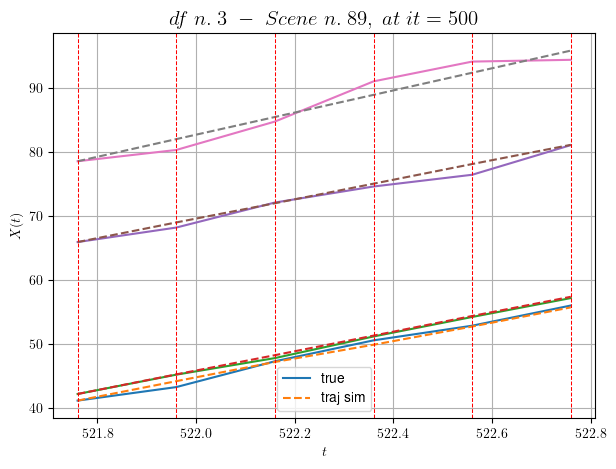

----------------------------------------------------------------------------------------------------
        For scene 33/60:
        * After LR finder: LR_NN=0.005 with mse=15.029147849616097 at it=24
        * v0 = 17.247787667046815
        * MSE = 0.7576010614379356
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.34/60
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [331.56,332.56]


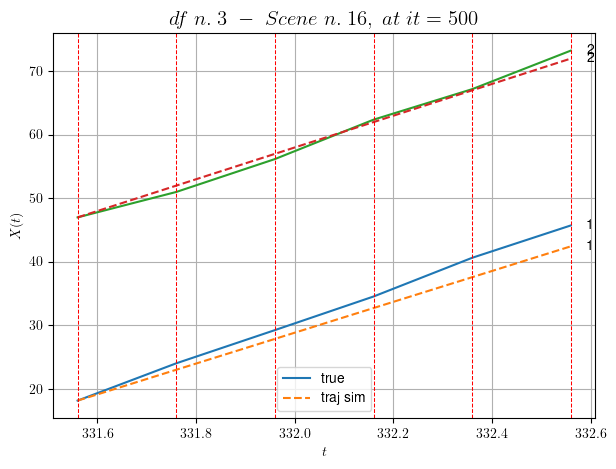

----------------------------------------------------------------------------------------------------
        For scene 34/60:
        * After LR finder: LR_NN=1e-05 with mse=3.9595050544514243 at it=24
        * v0 = 25.002166879949364
        * MSE = 2.4843654932844204
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.35/60
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [530.36,530.96]


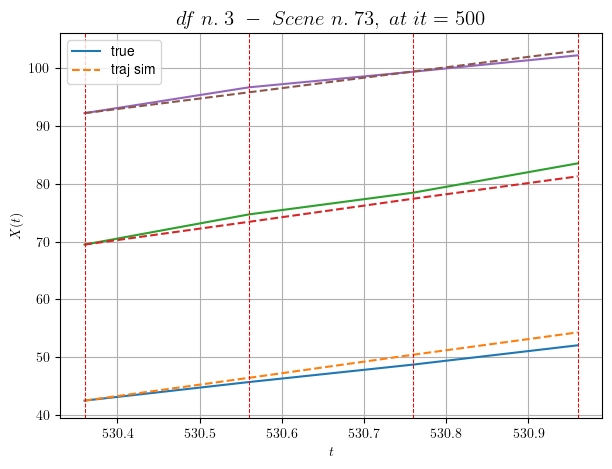

----------------------------------------------------------------------------------------------------
        For scene 35/60:
        * After LR finder: LR_NN=0.005 with mse=8.809215829110537 at it=24
        * v0 = 18.054855152785706
        * MSE = 1.4736237017937153
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.36/60
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [67.16,67.76]


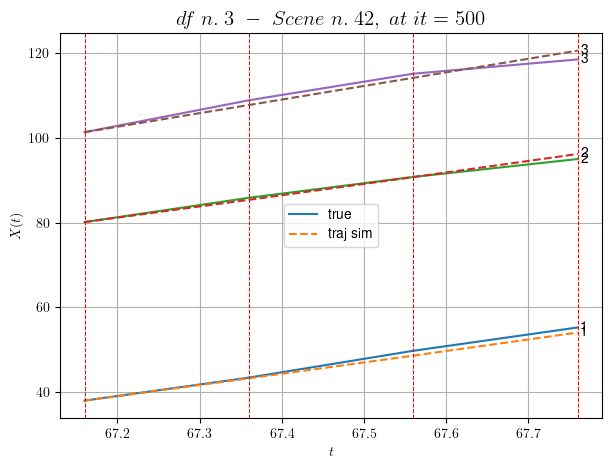

----------------------------------------------------------------------------------------------------
        For scene 36/60:
        * After LR finder: LR_NN=0.005 with mse=0.9269541804331537 at it=24
        * v0 = 32.13932154245658
        * MSE = 0.880135066812446
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.37/60
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [335.76,336.16]


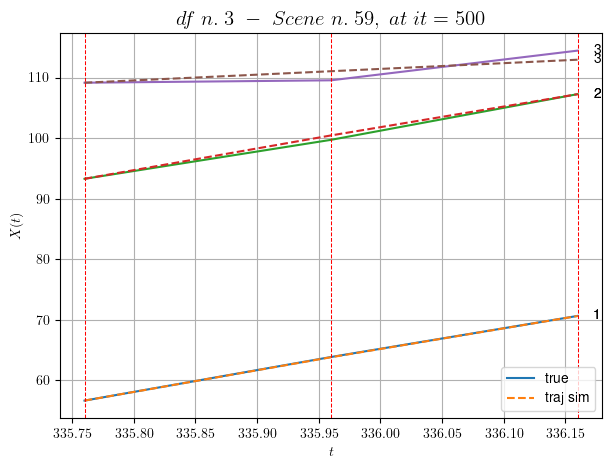

----------------------------------------------------------------------------------------------------
        For scene 37/60:
        * After LR finder: LR_NN=0.01 with mse=8.575158008422525 at it=24
        * v0 = 9.49568052439996
        * MSE = 0.5499908576691084
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.38/60
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [149.36,149.96]


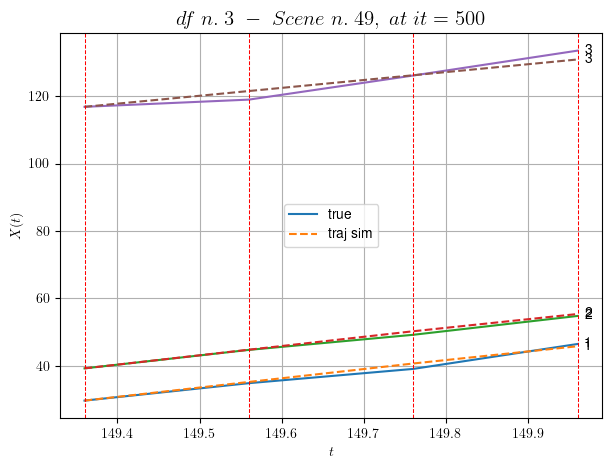

----------------------------------------------------------------------------------------------------
        For scene 38/60:
        * After LR finder: LR_NN=0.005 with mse=2.477772166106552 at it=24
        * v0 = 23.443555328519857
        * MSE = 1.4419558561439991
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.39/60
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [34.96,35.36]


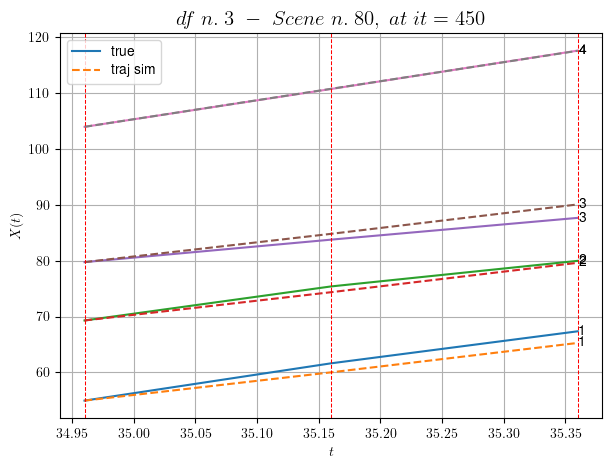

----------------------------------------------------------------------------------------------------
        For scene 39/60:
        * After LR finder: LR_NN=0.005 with mse=1.5435615930666726 at it=24
        * v0 = 34.04449095149488
        * MSE = 1.2501288345030077
        * iterations = 450
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.40/60
----------------------------------------------------------------------------------------------------
We have 6 time intervals inside [325.76,326.96]


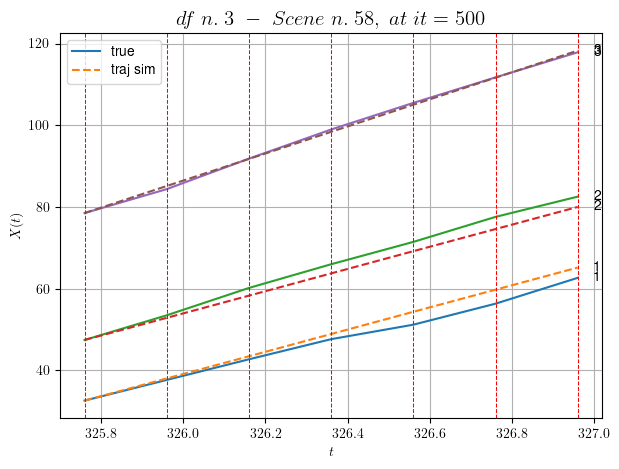

----------------------------------------------------------------------------------------------------
        For scene 40/60:
        * After LR finder: LR_NN=0.001 with mse=4.662172421378229 at it=24
        * v0 = 33.13555230710594
        * MSE = 2.904528588613779
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.41/60
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [573.76,574.56]


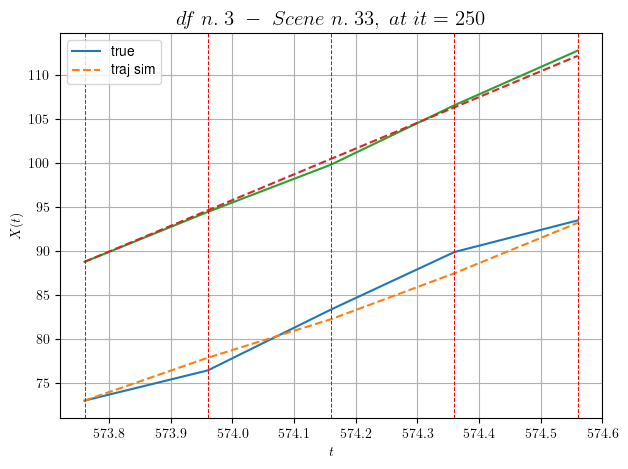

----------------------------------------------------------------------------------------------------
        For scene 41/60:
        * After LR finder: LR_NN=0.005 with mse=1.3198126251372206 at it=24
        * v0 = 29.329401723485105
        * MSE = 0.8531603951478682
        * iterations = 250
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.42/60
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [320.56,321.16]


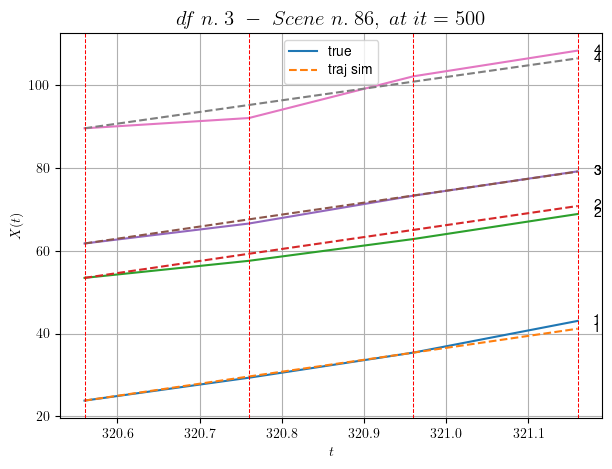

----------------------------------------------------------------------------------------------------
        For scene 42/60:
        * After LR finder: LR_NN=0.001 with mse=1.773177825924484 at it=24
        * v0 = 28.130140949140657
        * MSE = 1.7534641288209603
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.43/60
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [371.16,371.76]


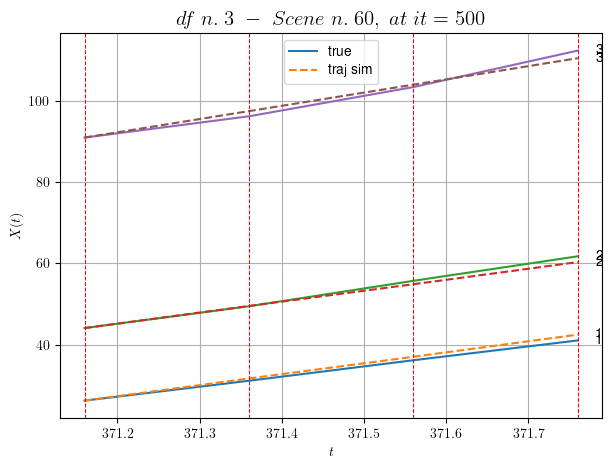

----------------------------------------------------------------------------------------------------
        For scene 43/60:
        * After LR finder: LR_NN=0.005 with mse=1.508347729430728 at it=24
        * v0 = 32.53950759922727
        * MSE = 0.9391032703258858
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.44/60
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [439.36,439.96]


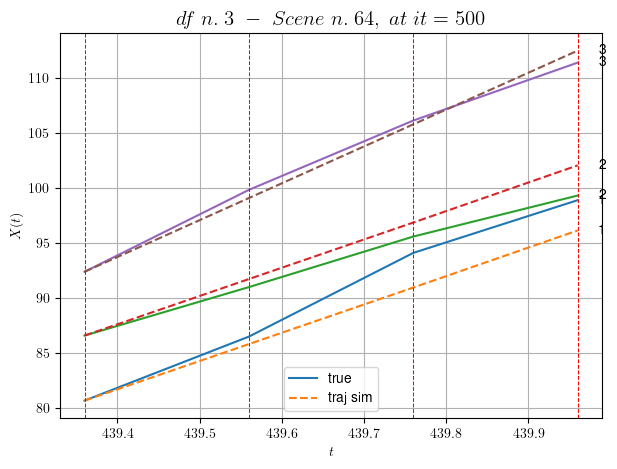

----------------------------------------------------------------------------------------------------
        For scene 44/60:
        * After LR finder: LR_NN=0.001 with mse=11.469277343820472 at it=24
        * v0 = 33.53637857273001
        * MSE = 2.4529567413250173
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.45/60
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [31.36,31.96]


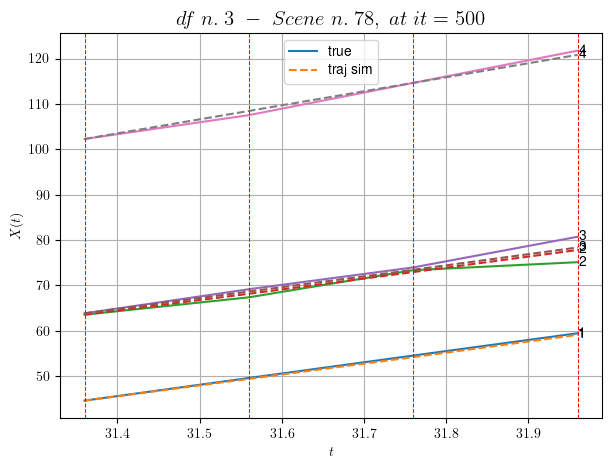

----------------------------------------------------------------------------------------------------
        For scene 45/60:
        * After LR finder: LR_NN=0.005 with mse=1.2729089119081978 at it=24
        * v0 = 30.917174059155993
        * MSE = 0.7357988478473567
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.46/60
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [23.96,24.76]


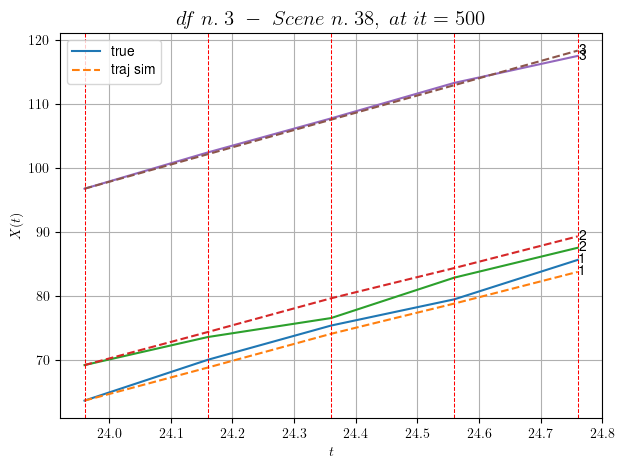

----------------------------------------------------------------------------------------------------
        For scene 46/60:
        * After LR finder: LR_NN=0.01 with mse=2.2661495763753643 at it=24
        * v0 = 27.01666435369721
        * MSE = 1.5785819841597524
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.47/60
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [544.16,545.16]


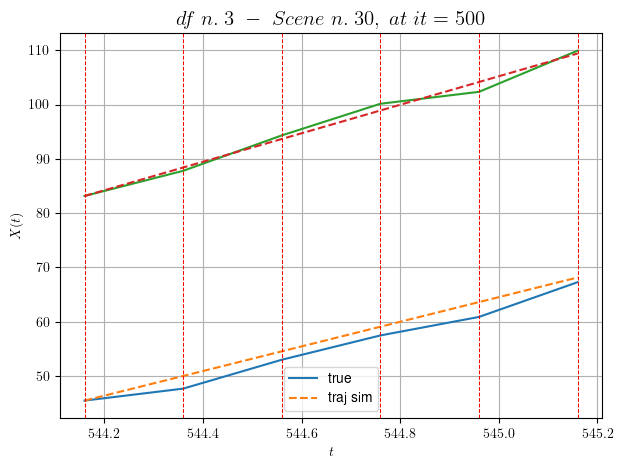

----------------------------------------------------------------------------------------------------
        For scene 47/60:
        * After LR finder: LR_NN=1e-05 with mse=3.889881436494244 at it=24
        * v0 = 26.24502129326876
        * MSE = 2.0439948432087456
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.48/60
----------------------------------------------------------------------------------------------------
We have 6 time intervals inside [12.76,13.96]


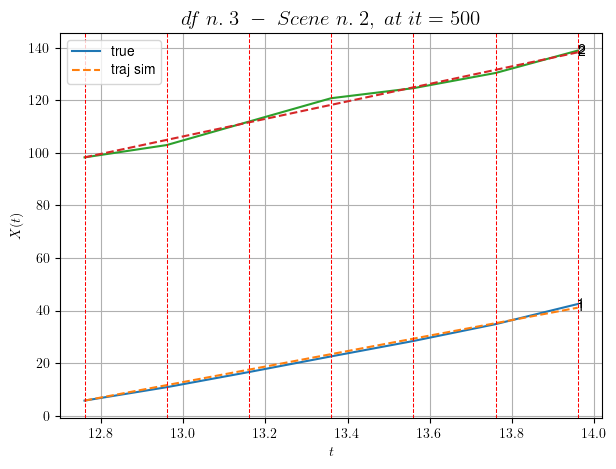

----------------------------------------------------------------------------------------------------
        For scene 48/60:
        * After LR finder: LR_NN=1e-05 with mse=4.788399769938909 at it=24
        * v0 = 33.32970746415814
        * MSE = 1.2373104751305286
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.49/60
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [222.96,223.76]


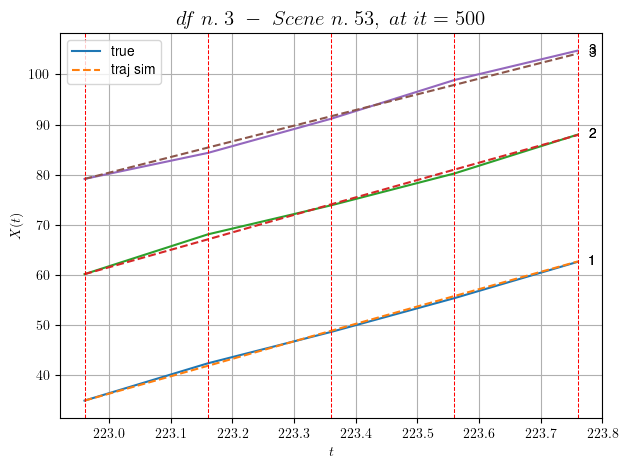

----------------------------------------------------------------------------------------------------
        For scene 49/60:
        * After LR finder: LR_NN=0.001 with mse=0.5698025540951904 at it=24
        * v0 = 31.279750687417323
        * MSE = 0.31977615055861697
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.50/60
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [427.36,427.76]


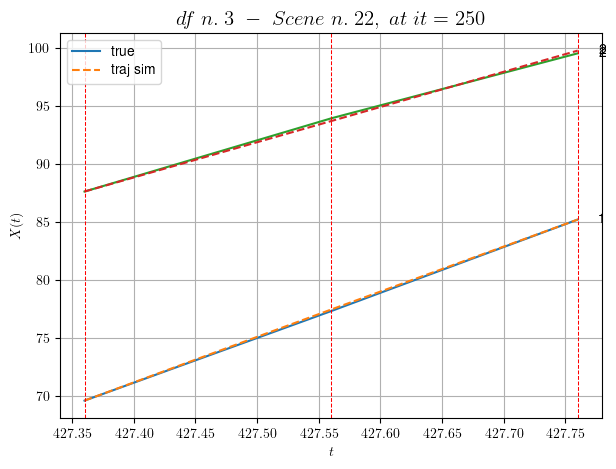

----------------------------------------------------------------------------------------------------
        For scene 50/60:
        * After LR finder: LR_NN=0.005 with mse=0.020423767146311476 at it=24
        * v0 = 30.36152457041857
        * MSE = 0.01901605755994143
        * iterations = 250
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.51/60
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [40.76,41.16]


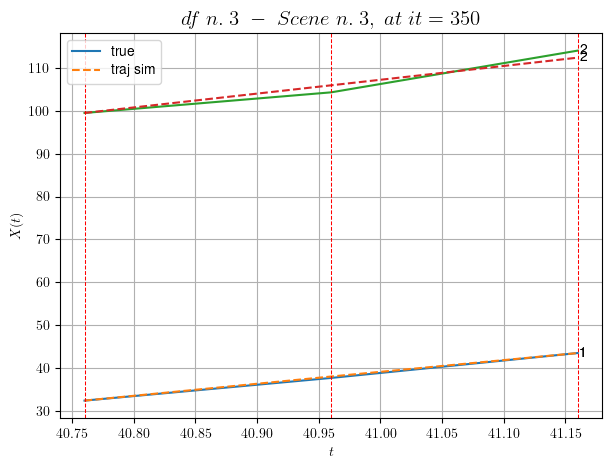

----------------------------------------------------------------------------------------------------
        For scene 51/60:
        * After LR finder: LR_NN=0.005 with mse=1.321317582023499 at it=24
        * v0 = 32.20688347720732
        * MSE = 0.9149586807081405
        * iterations = 350
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.52/60
----------------------------------------------------------------------------------------------------
We have 7 time intervals inside [436.16,437.56]


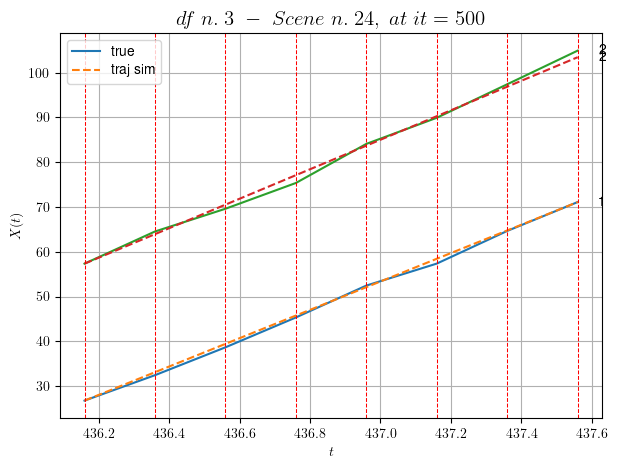

----------------------------------------------------------------------------------------------------
        For scene 52/60:
        * After LR finder: LR_NN=0.0005 with mse=4.0854239836612845 at it=24
        * v0 = 32.923939302763266
        * MSE = 0.5921382135877791
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.53/60
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [170.36,170.76]


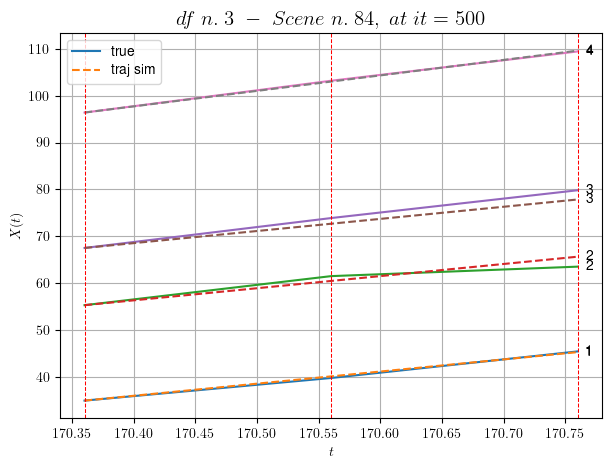

----------------------------------------------------------------------------------------------------
        For scene 53/60:
        * After LR finder: LR_NN=0.0001 with mse=1.8653888744990192 at it=24
        * v0 = 32.996539935657296
        * MSE = 0.9039469977338058
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.54/60
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [579.56,580.56]


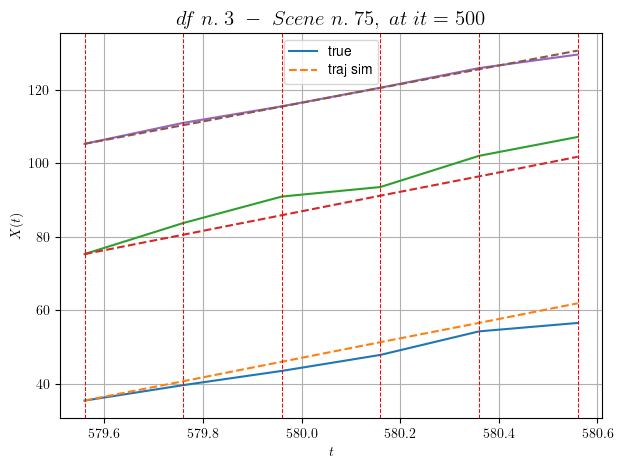

----------------------------------------------------------------------------------------------------
        For scene 54/60:
        * After LR finder: LR_NN=0.001 with mse=11.726640053160835 at it=24
        * v0 = 25.358404463471402
        * MSE = 8.690612707545897
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.55/60
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [142.16,142.76]


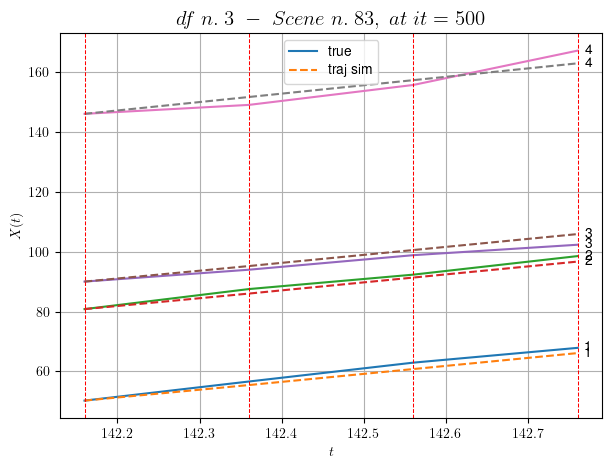

----------------------------------------------------------------------------------------------------
        For scene 55/60:
        * After LR finder: LR_NN=0.005 with mse=3.587236452659983 at it=24
        * v0 = 28.121237748538903
        * MSE = 3.538352085439957
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.56/60
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [417.16,418.16]


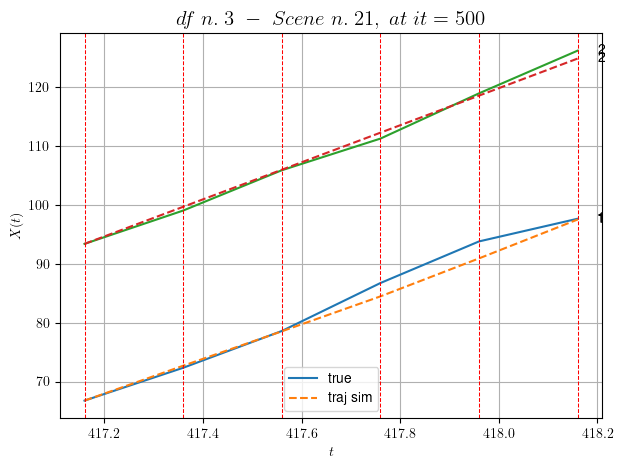

----------------------------------------------------------------------------------------------------
        For scene 56/60:
        * After LR finder: LR_NN=0.005 with mse=3.539052085727432 at it=24
        * v0 = 31.447990123716604
        * MSE = 1.3424955120620679
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.57/60
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [387.36,388.16]


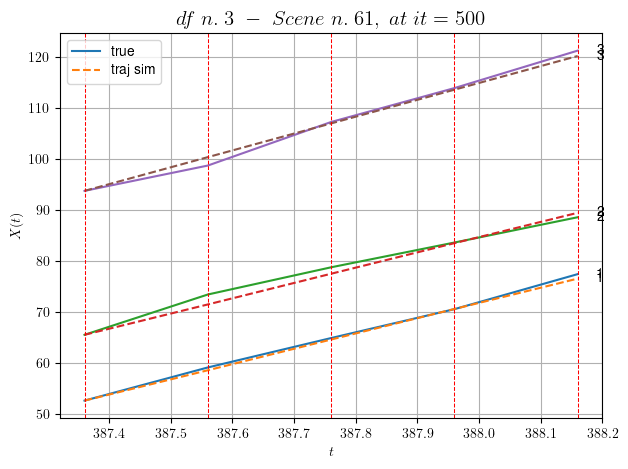

----------------------------------------------------------------------------------------------------
        For scene 57/60:
        * After LR finder: LR_NN=0.001 with mse=1.8327224129319426 at it=24
        * v0 = 33.03189808825757
        * MSE = 0.7505477675314031
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.58/60
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [527.36,528.16]


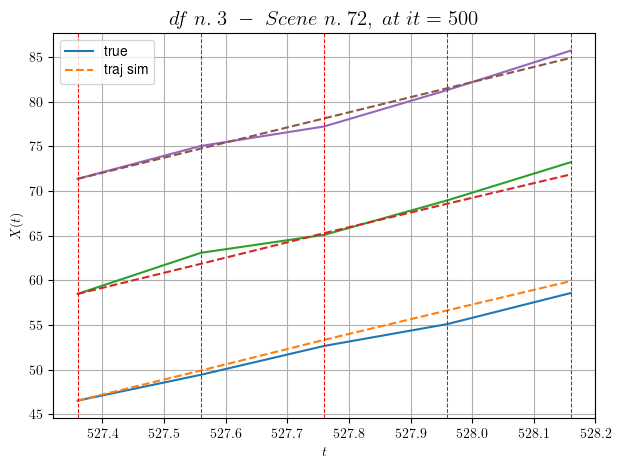

----------------------------------------------------------------------------------------------------
        For scene 58/60:
        * After LR finder: LR_NN=0.005 with mse=13.98696362382772 at it=24
        * v0 = 16.92090602277571
        * MSE = 0.665974381868473
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.59/60
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [299.76,300.56]


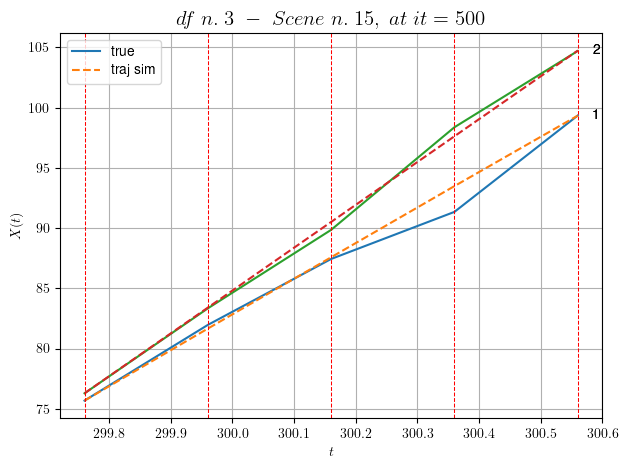

----------------------------------------------------------------------------------------------------
        For scene 59/60:
        * After LR finder: LR_NN=0.0005 with mse=4.653461999315481 at it=24
        * v0 = 35.55620181997074
        * MSE = 0.5631623915389394
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.60/60
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [218.16,219.16]


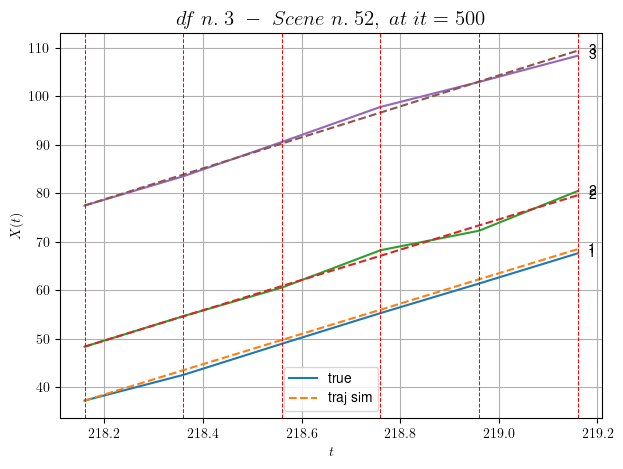

----------------------------------------------------------------------------------------------------
        For scene 60/60:
        * After LR finder: LR_NN=0.001 with mse=0.9326282184138374 at it=24
        * v0 = 31.94692558326363
        * MSE = 0.5314402139823946
        * iterations = 500
----------------------------------------------------------------------------------------------------


MSE train: 1.7847574894531495
- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -

Testing step. (30 scenes)
DataFrame n.3. Scene n.1/30


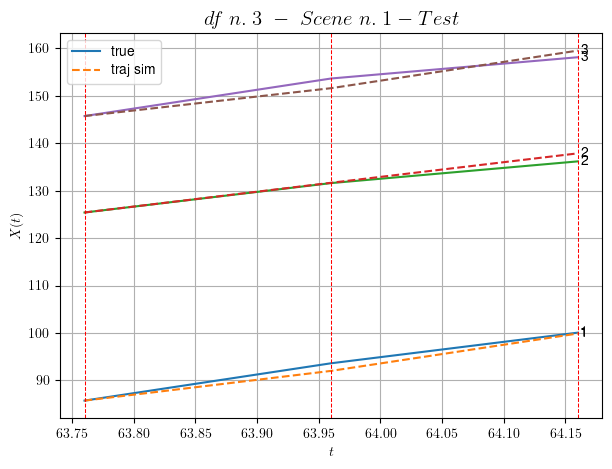

        For scene 1/30:
        * MSE = 1.2865261395324576
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.2/30


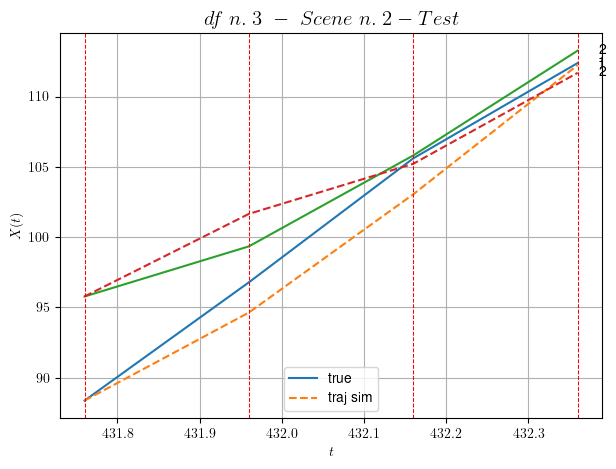

        For scene 2/30:
        * MSE = 2.415552032335894
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.3/30


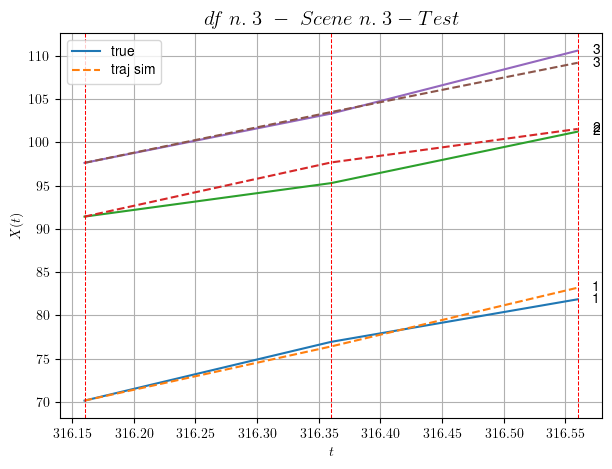

        For scene 3/30:
        * MSE = 1.0990455870808986
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.4/30


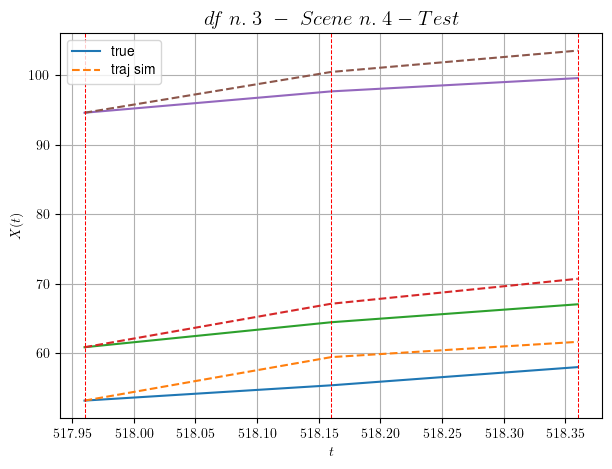

        For scene 4/30:
        * MSE = 8.205447450239383
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.5/30


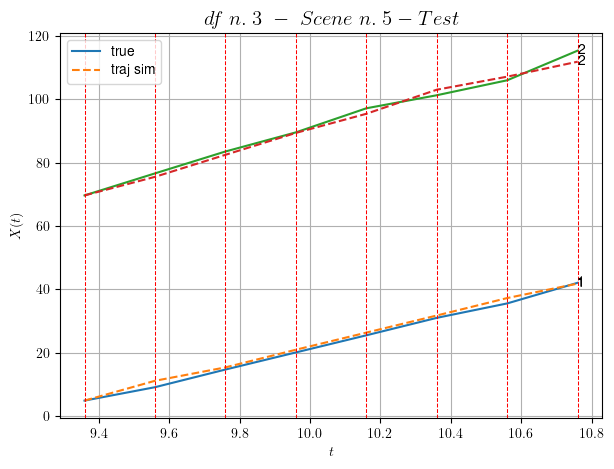

        For scene 5/30:
        * MSE = 1.9647085553203634
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.6/30


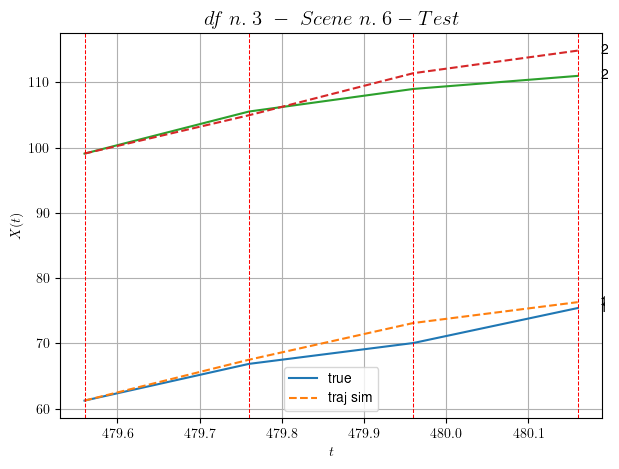

        For scene 6/30:
        * MSE = 3.97078858522452
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.7/30


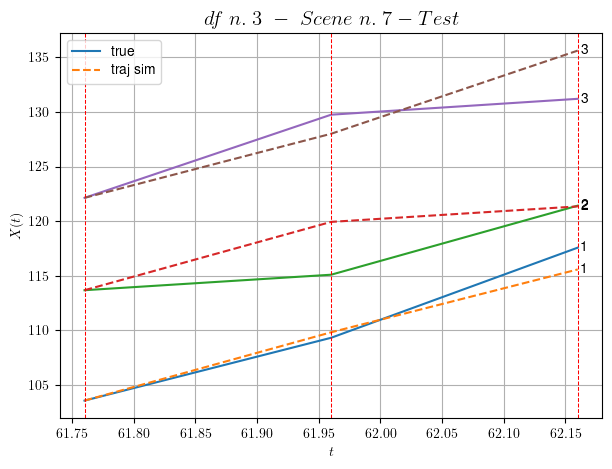

        For scene 7/30:
        * MSE = 5.584876283857067
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.8/30


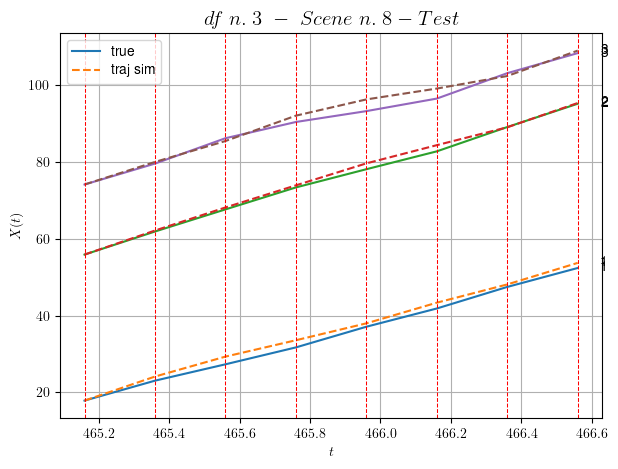

        For scene 8/30:
        * MSE = 1.6636618308721547
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.9/30


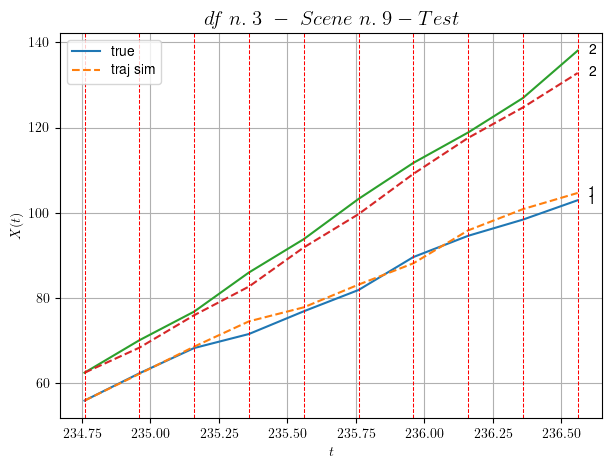

        For scene 9/30:
        * MSE = 4.813761795075831
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.10/30


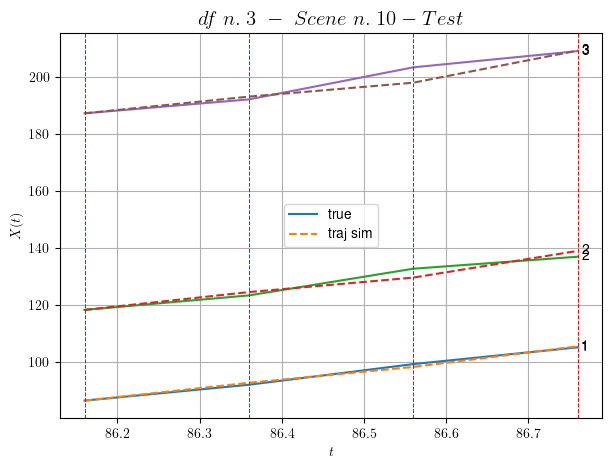

        For scene 10/30:
        * MSE = 3.9190935756753746
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.11/30


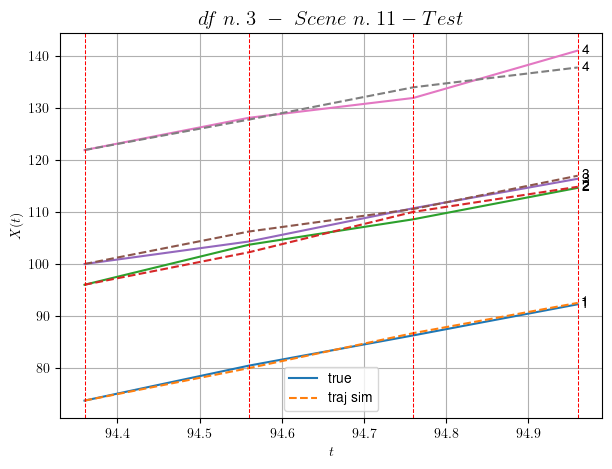

        For scene 11/30:
        * MSE = 1.4772384996657928
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.12/30


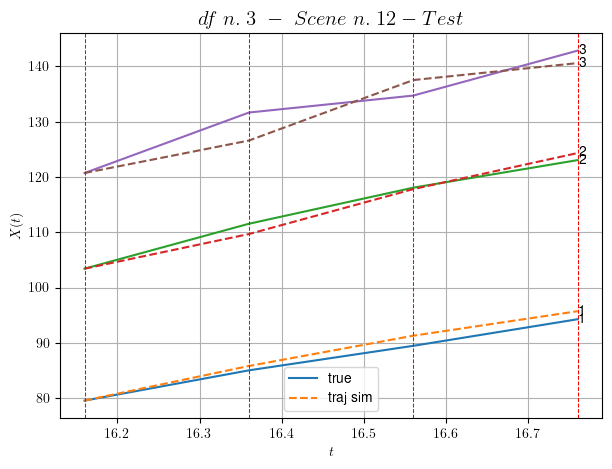

        For scene 12/30:
        * MSE = 4.151612163685048
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.13/30


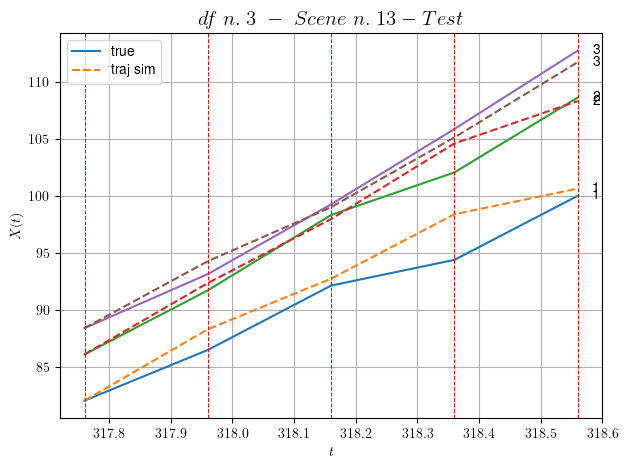

        For scene 13/30:
        * MSE = 2.007994123309226
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.14/30


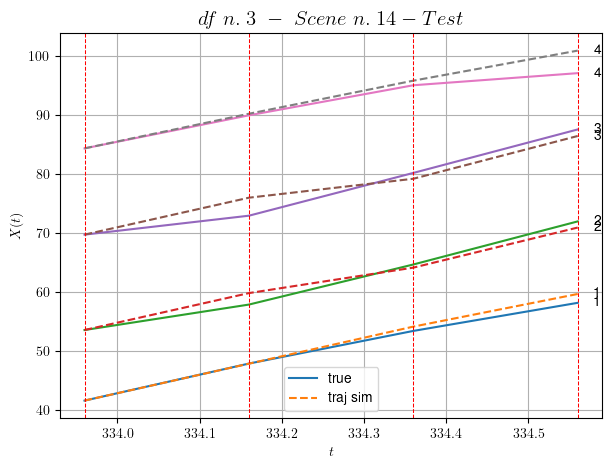

        For scene 14/30:
        * MSE = 2.1709709970802713
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.15/30


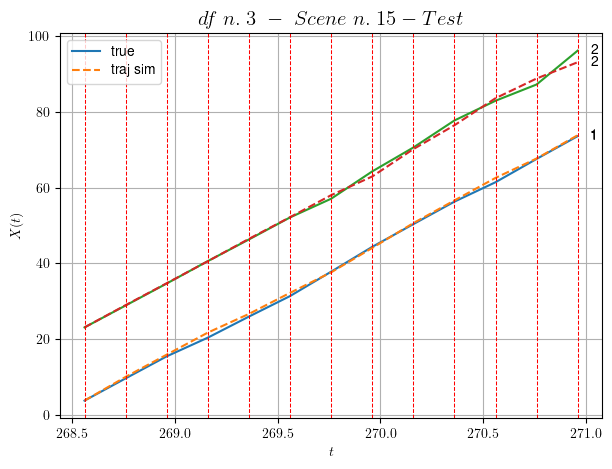

        For scene 15/30:
        * MSE = 0.8394181803350251
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.16/30


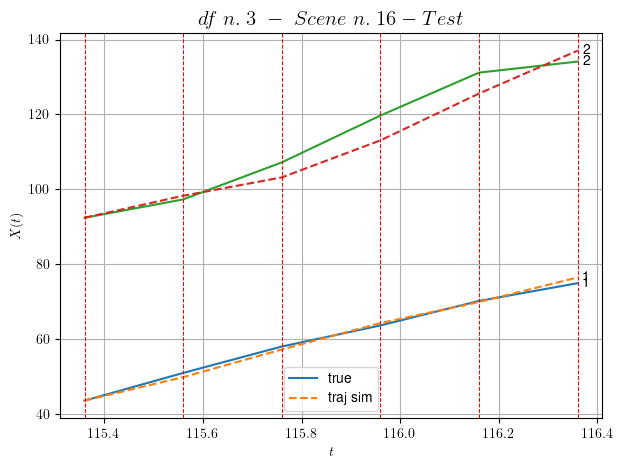

        For scene 16/30:
        * MSE = 8.781072050483342
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.17/30


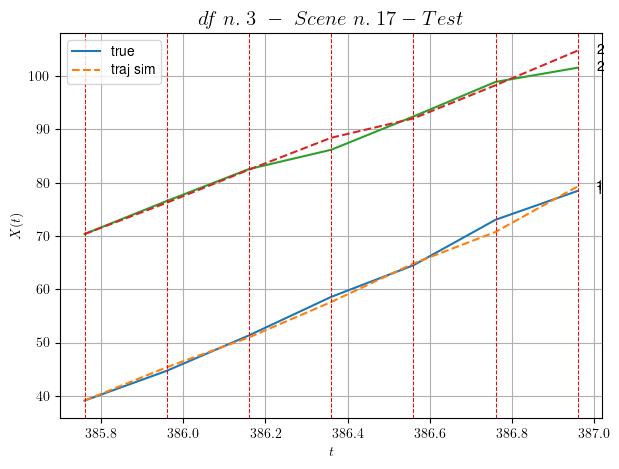

        For scene 17/30:
        * MSE = 1.6792097815083693
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.18/30


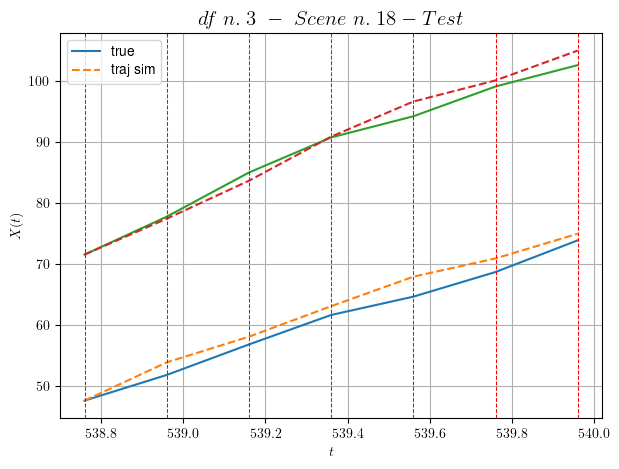

        For scene 18/30:
        * MSE = 2.79382657016027
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.19/30


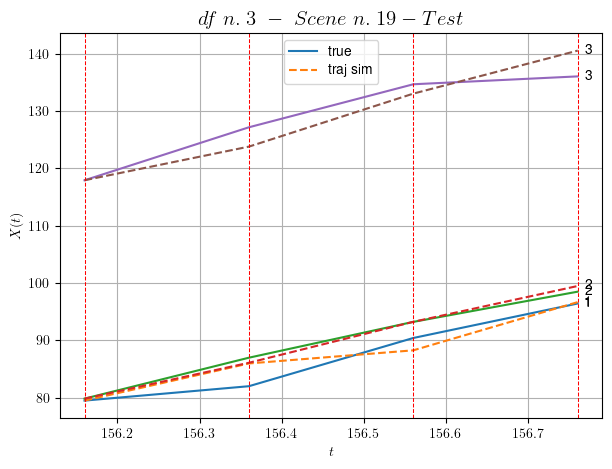

        For scene 19/30:
        * MSE = 4.708140538595509
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.20/30


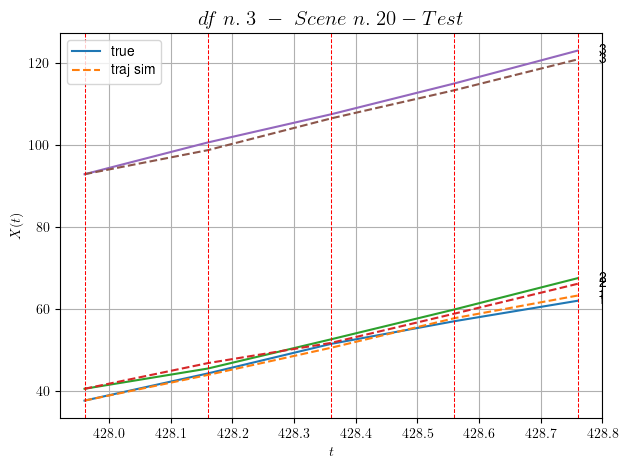

        For scene 20/30:
        * MSE = 1.3650989667401345
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.21/30


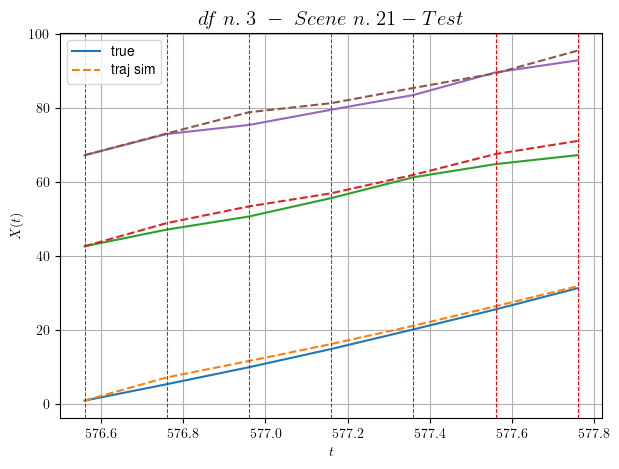

        For scene 21/30:
        * MSE = 3.3471074487563217
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.22/30


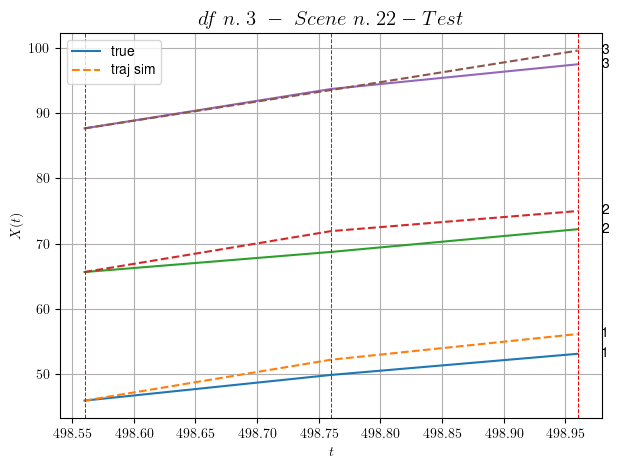

        For scene 22/30:
        * MSE = 4.10105788214983
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.23/30


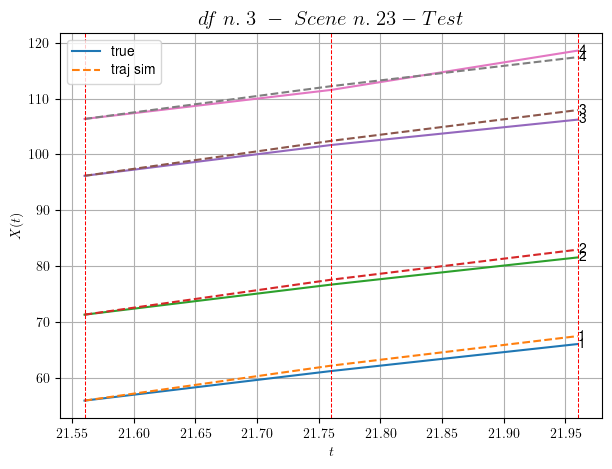

        For scene 23/30:
        * MSE = 0.9139572365786692
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.24/30


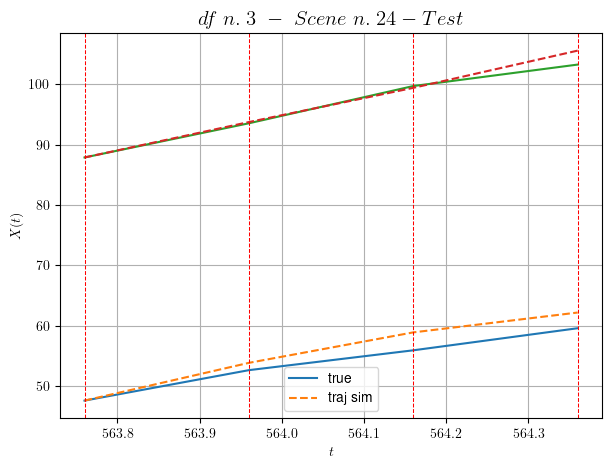

        For scene 24/30:
        * MSE = 2.8198193906269555
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.25/30


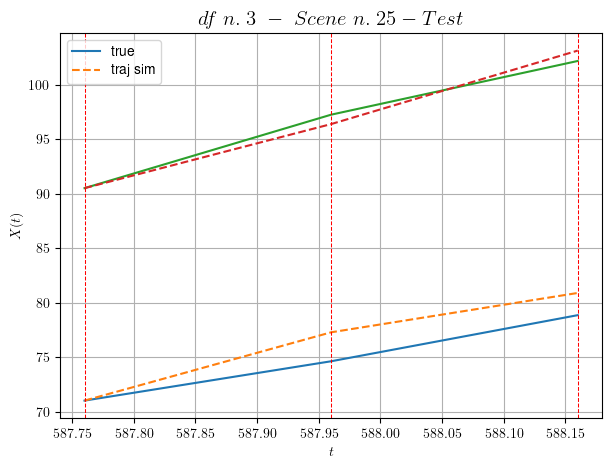

        For scene 25/30:
        * MSE = 2.140238767633306
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.26/30


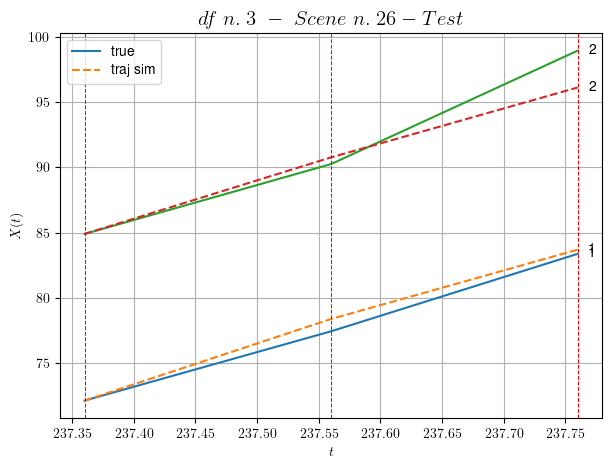

        For scene 26/30:
        * MSE = 1.5428073360145294
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.27/30


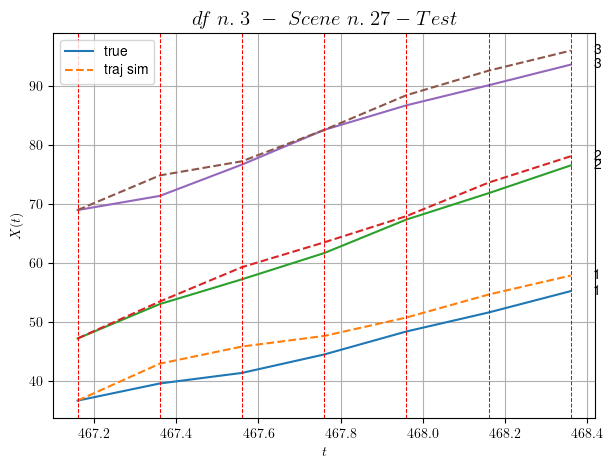

        For scene 27/30:
        * MSE = 4.936377933759581
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.28/30


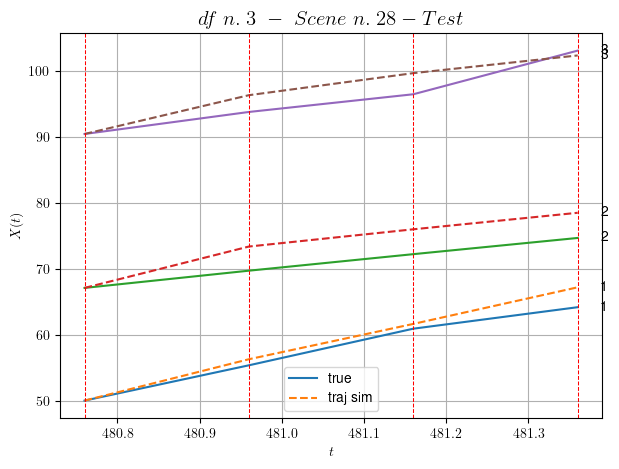

        For scene 28/30:
        * MSE = 5.802287164536458
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.29/30


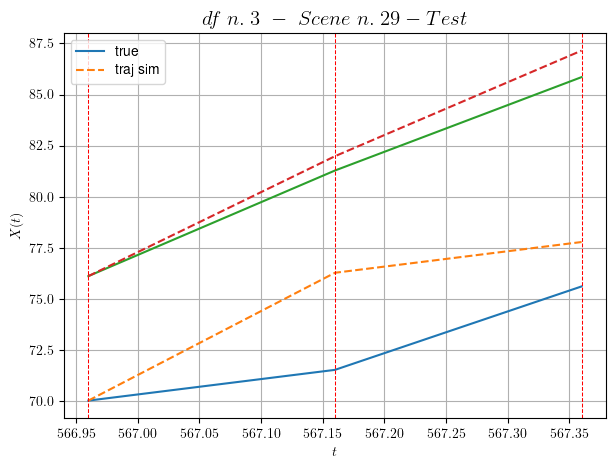

        For scene 29/30:
        * MSE = 4.921651373407777
----------------------------------------------------------------------------------------------------


DataFrame n.3. Scene n.30/30


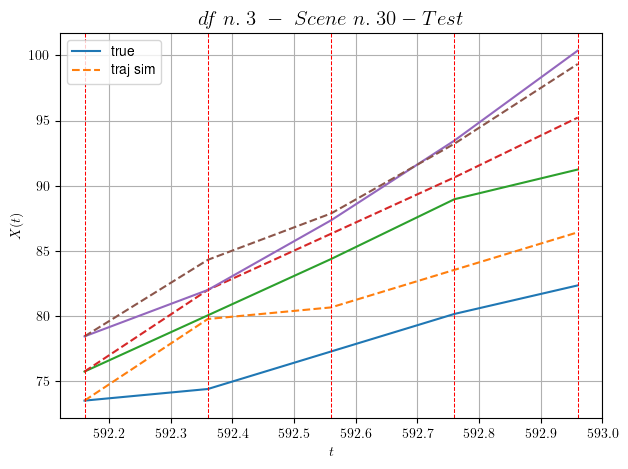

        For scene 30/30:
        * MSE = 6.753332789648599
----------------------------------------------------------------------------------------------------


MSE test: 3.4058893676629656

- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -

    Summing up:
          * MSE train: 1.7847574894531495
          * MSE test: 3.4058893676629656
          
- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -




Analyzing 4/10 dfs.
In DataFrame n.4 we have 69 scenes.
    To train the model we use 46 scenes, the remaining 23 to test the model.

Training step. (46 scenes)
DataFrame n.4. Scene n.1/46
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [399.24,399.84]


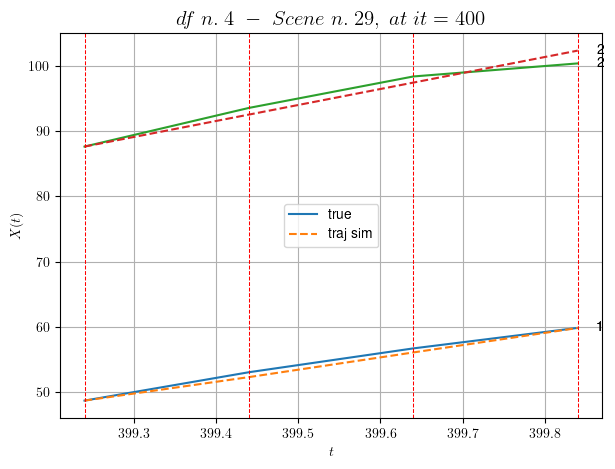

----------------------------------------------------------------------------------------------------
        For scene 1/46:
        * After LR finder: LR_NN=0.005 with mse=3.783291433866481 at it=24
        * v0 = 24.512386482354398
        * MSE = 0.8384687138992484
        * iterations = 400
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.2/46
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [128.24,129.24]


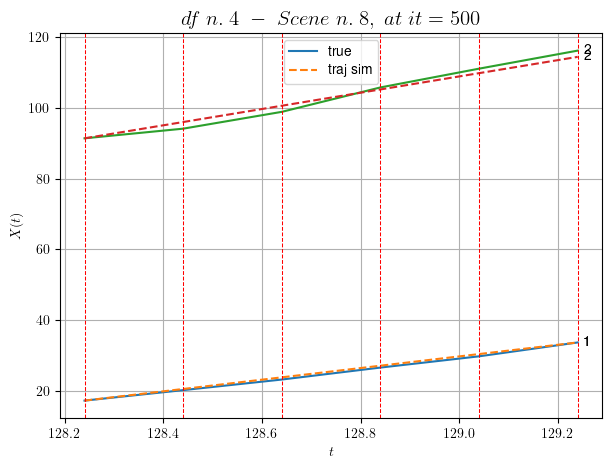

----------------------------------------------------------------------------------------------------
        For scene 2/46:
        * After LR finder: LR_NN=5e-05 with mse=7.589884010609988 at it=24
        * v0 = 23.005181028725758
        * MSE = 1.059420625345328
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.3/46
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [556.24,556.64]


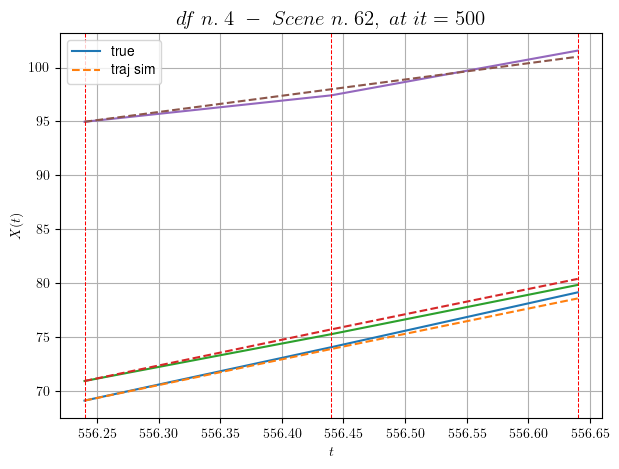

----------------------------------------------------------------------------------------------------
        For scene 3/46:
        * After LR finder: LR_NN=0.01 with mse=4.7368596464835155 at it=24
        * v0 = 15.086092436631832
        * MSE = 0.1615917630164673
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.4/46
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [19.84,20.24]


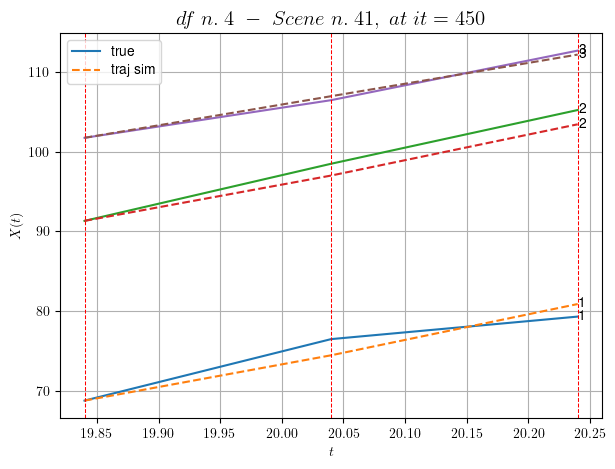

----------------------------------------------------------------------------------------------------
        For scene 4/46:
        * After LR finder: LR_NN=0.005 with mse=1.8393827447782034 at it=24
        * v0 = 26.058967459028686
        * MSE = 1.3666706916429947
        * iterations = 450
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.5/46
----------------------------------------------------------------------------------------------------
We have 7 time intervals inside [230.84,232.24]


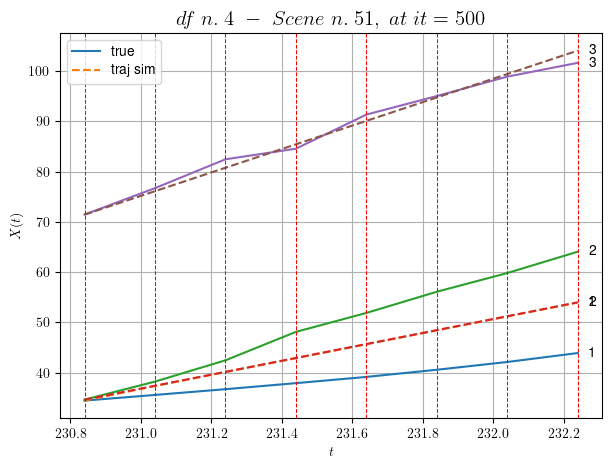

----------------------------------------------------------------------------------------------------
        For scene 5/46:
        * After LR finder: LR_NN=0.0001 with mse=21.77567270925314 at it=24
        * v0 = 23.322723002586795
        * MSE = 26.795347636917285
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.6/46
----------------------------------------------------------------------------------------------------
We have 7 time intervals inside [182.24,183.64]


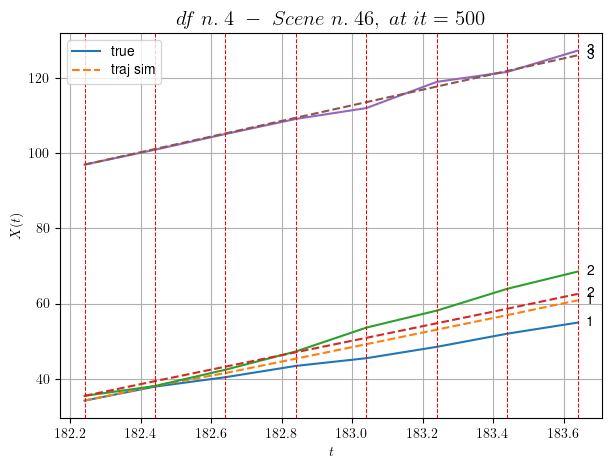

----------------------------------------------------------------------------------------------------
        For scene 6/46:
        * After LR finder: LR_NN=0.005 with mse=26.601285429099207 at it=24
        * v0 = 20.77319956727247
        * MSE = 7.899812255581474
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.7/46
----------------------------------------------------------------------------------------------------
We have 11 time intervals inside [266.84,269.04]


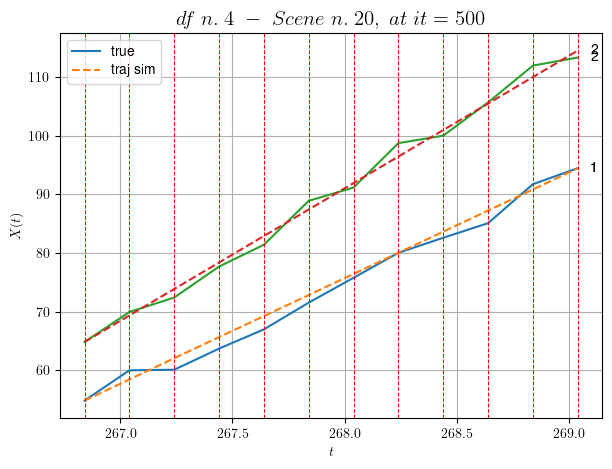

----------------------------------------------------------------------------------------------------
        For scene 7/46:
        * After LR finder: LR_NN=0.001 with mse=46.83108941559083 at it=24
        * v0 = 22.599995584638805
        * MSE = 1.782657395145101
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.8/46
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [440.44,440.84]


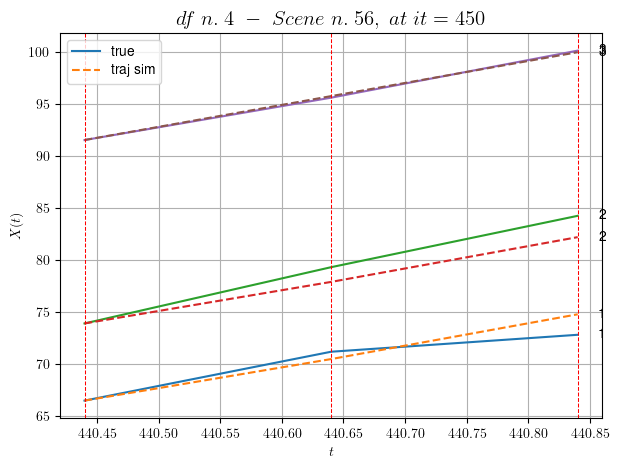

----------------------------------------------------------------------------------------------------
        For scene 8/46:
        * After LR finder: LR_NN=0.005 with mse=2.9145457914759896 at it=24
        * v0 = 21.1269962727428
        * MSE = 1.1761792924320338
        * iterations = 450
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.9/46
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [7.04,7.44]


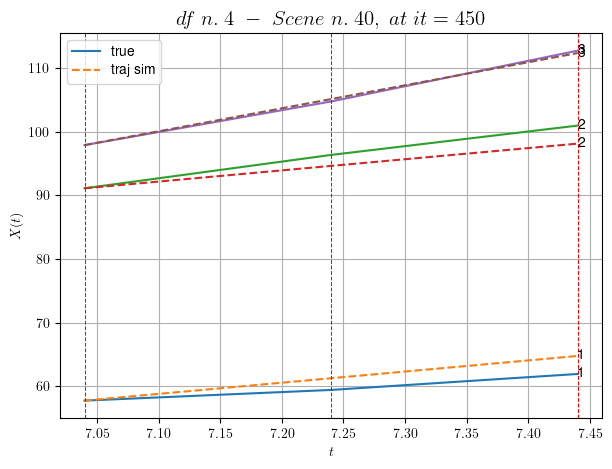

----------------------------------------------------------------------------------------------------
        For scene 9/46:
        * After LR finder: LR_NN=0.005 with mse=3.4643968634533855 at it=24
        * v0 = 36.154229124863036
        * MSE = 2.517215352918399
        * iterations = 450
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.10/46
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [374.24,375.04]


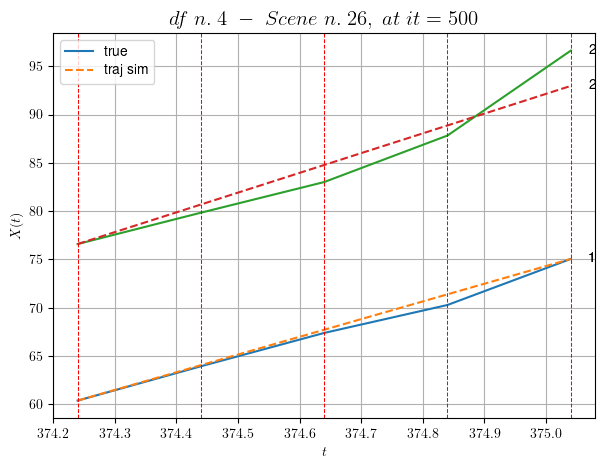

----------------------------------------------------------------------------------------------------
        For scene 10/46:
        * After LR finder: LR_NN=0.0001 with mse=10.11720629472565 at it=24
        * v0 = 20.475722036932126
        * MSE = 1.7634419110034347
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.11/46
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [584.84,585.44]


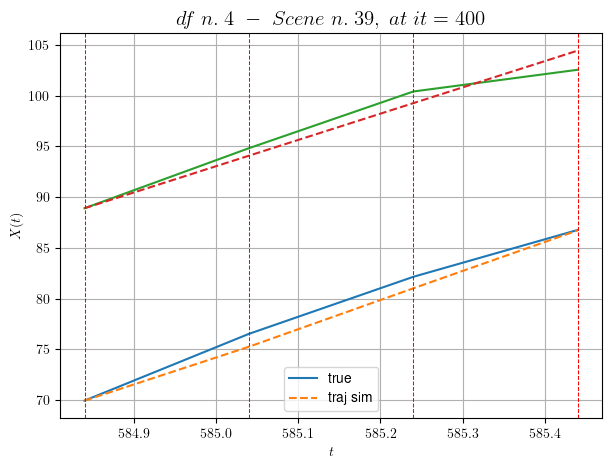

----------------------------------------------------------------------------------------------------
        For scene 11/46:
        * After LR finder: LR_NN=0.005 with mse=2.8560556154232195 at it=24
        * v0 = 25.889440534988555
        * MSE = 1.036639759712826
        * iterations = 400
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.12/46
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [176.24,177.24]


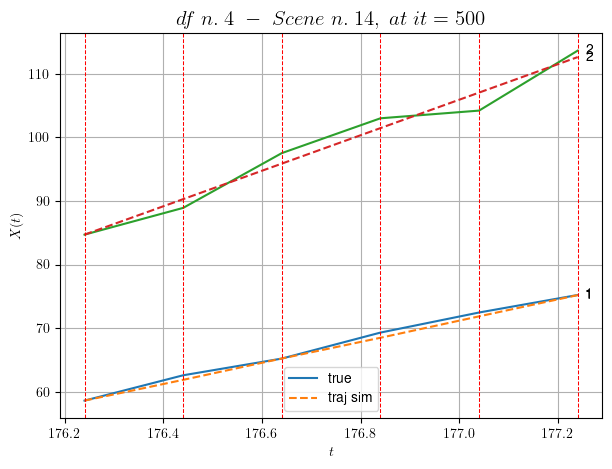

----------------------------------------------------------------------------------------------------
        For scene 12/46:
        * After LR finder: LR_NN=0.005 with mse=2.259573538644392 at it=24
        * v0 = 27.94819777081733
        * MSE = 1.4684577318070264
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.13/46
----------------------------------------------------------------------------------------------------
We have 12 time intervals inside [224.84,227.24]


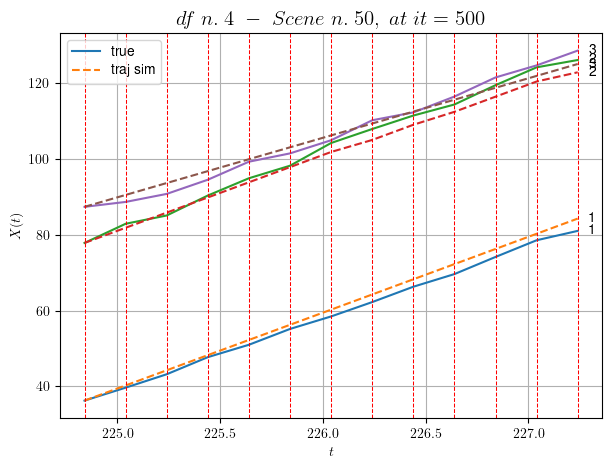

----------------------------------------------------------------------------------------------------
        For scene 13/46:
        * After LR finder: LR_NN=0.001 with mse=128.3103471082944 at it=24
        * v0 = 15.71367713005475
        * MSE = 3.087336048654062
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.14/46
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [67.64,68.04]


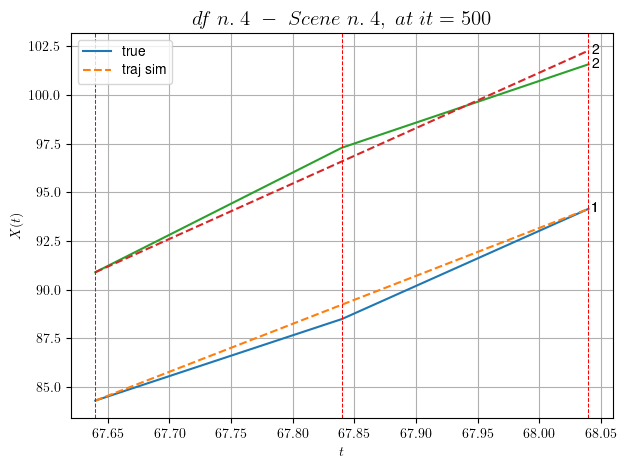

----------------------------------------------------------------------------------------------------
        For scene 14/46:
        * After LR finder: LR_NN=0.0001 with mse=0.3173217839381097 at it=24
        * v0 = 28.46498000771284
        * MSE = 0.2382374994059342
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.15/46
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [205.84,206.84]


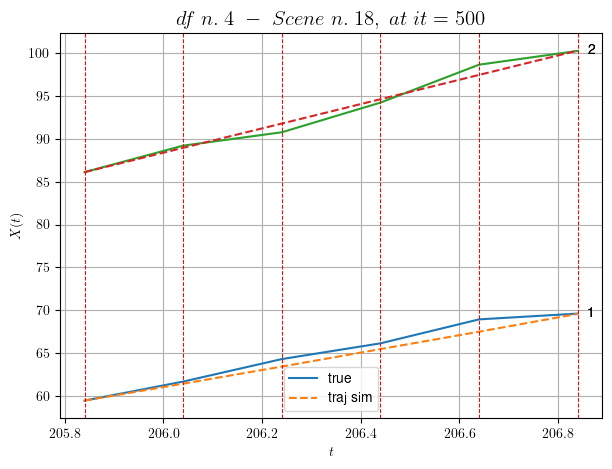

----------------------------------------------------------------------------------------------------
        For scene 15/46:
        * After LR finder: LR_NN=0.005 with mse=45.47617950817987 at it=24
        * v0 = 14.204943221368355
        * MSE = 0.4967668677267518
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.16/46
----------------------------------------------------------------------------------------------------
We have 15 time intervals inside [129.84,132.84]


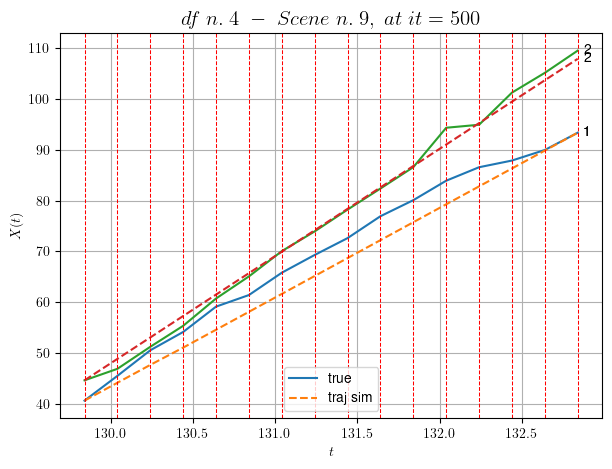

----------------------------------------------------------------------------------------------------
        For scene 16/46:
        * After LR finder: LR_NN=0.001 with mse=117.99115650089335 at it=24
        * v0 = 21.068534244852284
        * MSE = 6.590258741959675
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.17/46
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [422.64,423.64]


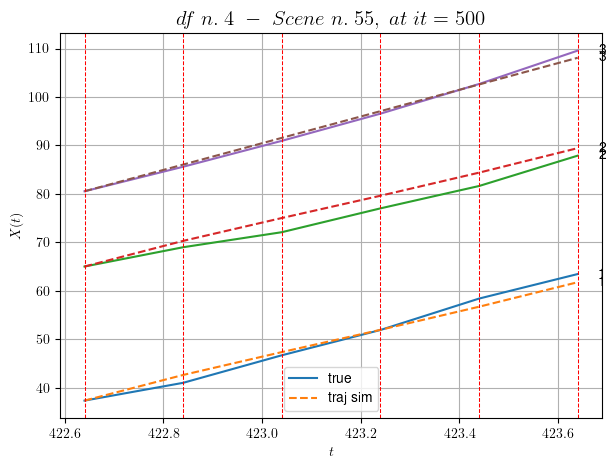

----------------------------------------------------------------------------------------------------
        For scene 17/46:
        * After LR finder: LR_NN=0.01 with mse=2.409648549263544 at it=24
        * v0 = 27.545089607777143
        * MSE = 1.8948016385063566
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.18/46
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [122.84,123.84]


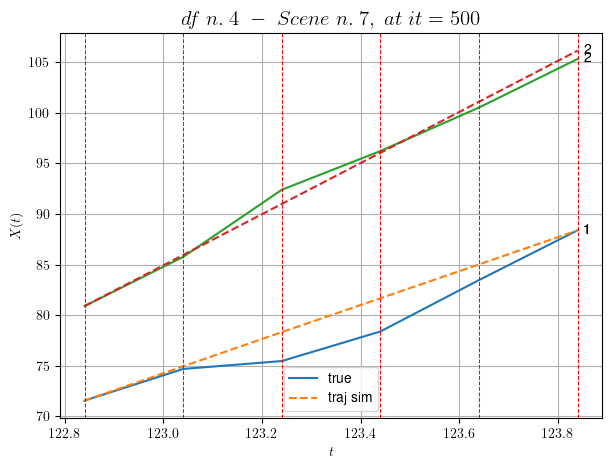

----------------------------------------------------------------------------------------------------
        For scene 18/46:
        * After LR finder: LR_NN=0.0005 with mse=5.842499812426408 at it=24
        * v0 = 25.259320008419433
        * MSE = 2.0296038610965184
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.19/46
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [500.04,501.04]


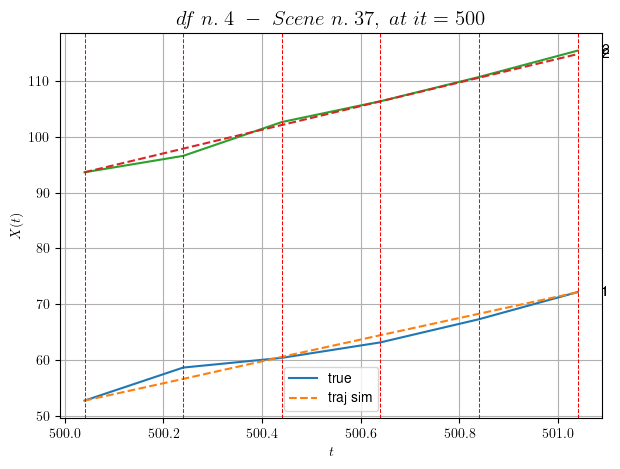

----------------------------------------------------------------------------------------------------
        For scene 19/46:
        * After LR finder: LR_NN=0.001 with mse=13.982269704454733 at it=24
        * v0 = 21.189572495102173
        * MSE = 0.7593525122355629
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.20/46
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [313.84,314.44]


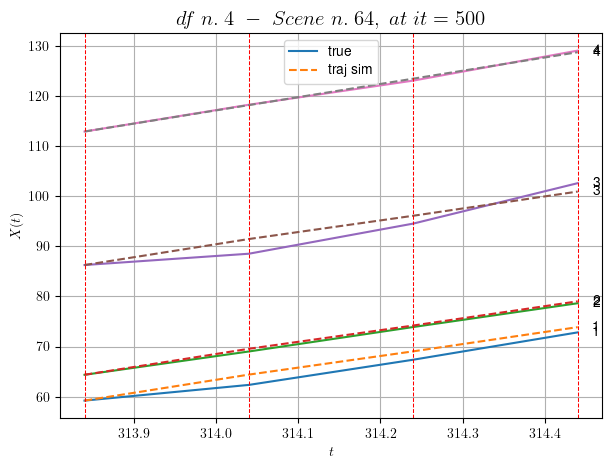

----------------------------------------------------------------------------------------------------
        For scene 20/46:
        * After LR finder: LR_NN=0.005 with mse=2.0025077875602033 at it=24
        * v0 = 26.41552952480226
        * MSE = 1.3932225125470925
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.21/46
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [541.84,542.84]


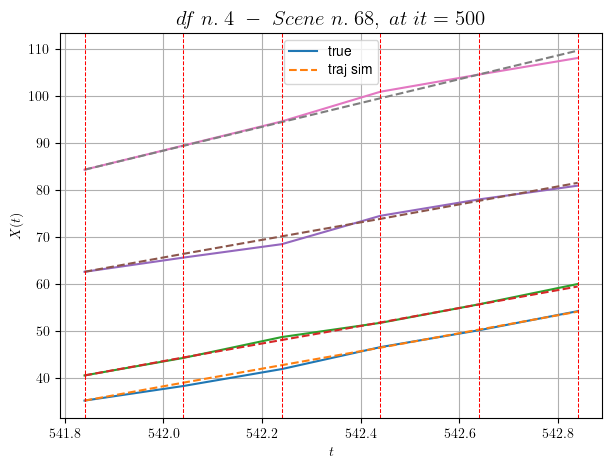

----------------------------------------------------------------------------------------------------
        For scene 21/46:
        * After LR finder: LR_NN=0.005 with mse=2.7315454620926616 at it=24
        * v0 = 25.311591600960533
        * MSE = 0.4421932626895373
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.22/46
----------------------------------------------------------------------------------------------------
We have 9 time intervals inside [195.44,197.24]


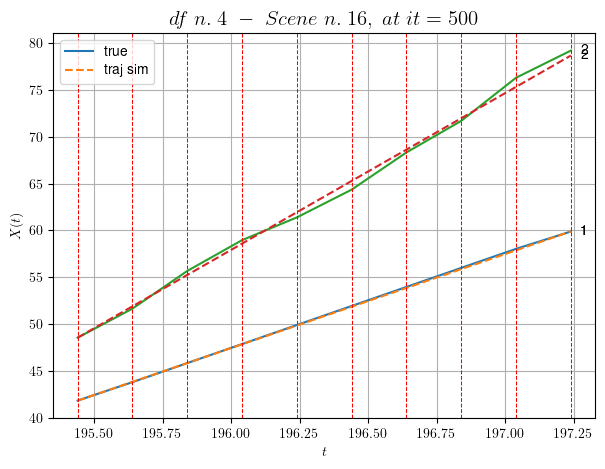

----------------------------------------------------------------------------------------------------
        For scene 22/46:
        * After LR finder: LR_NN=0.005 with mse=99.42591079750986 at it=24
        * v0 = 16.73844314065949
        * MSE = 0.14992867063542994
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.23/46
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [387.64,388.44]


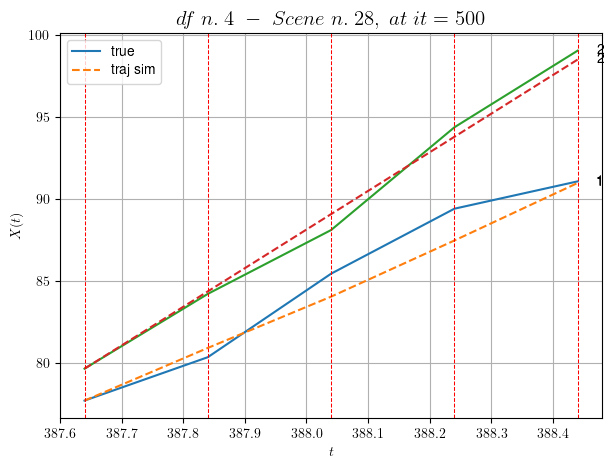

----------------------------------------------------------------------------------------------------
        For scene 23/46:
        * After LR finder: LR_NN=0.005 with mse=5.497028025151528 at it=24
        * v0 = 23.572406443207264
        * MSE = 0.764963566311815
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.24/46
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [23.64,24.64]


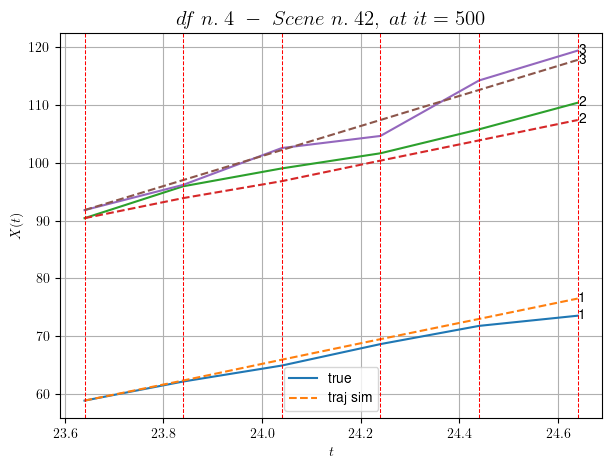

----------------------------------------------------------------------------------------------------
        For scene 24/46:
        * After LR finder: LR_NN=0.005 with mse=3.8726857969914867 at it=24
        * v0 = 25.974575559418597
        * MSE = 2.719825213874675
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.25/46
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [378.64,379.24]


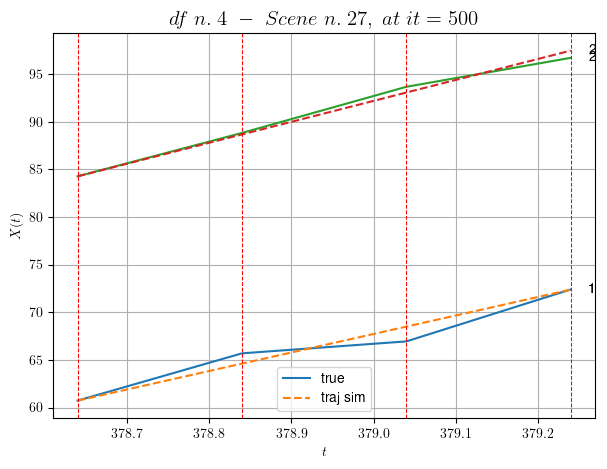

----------------------------------------------------------------------------------------------------
        For scene 25/46:
        * After LR finder: LR_NN=5e-05 with mse=5.419025190353536 at it=24
        * v0 = 21.986682448764814
        * MSE = 0.533815333593108
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.26/46
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [222.84,223.44]


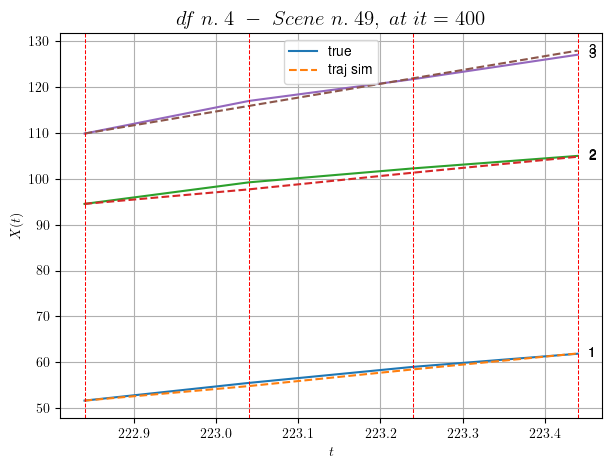

----------------------------------------------------------------------------------------------------
        For scene 26/46:
        * After LR finder: LR_NN=0.01 with mse=0.5619979451924225 at it=24
        * v0 = 30.107928523520545
        * MSE = 0.5025664302278519
        * iterations = 400
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.27/46
----------------------------------------------------------------------------------------------------
We have 10 time intervals inside [321.84,323.84]


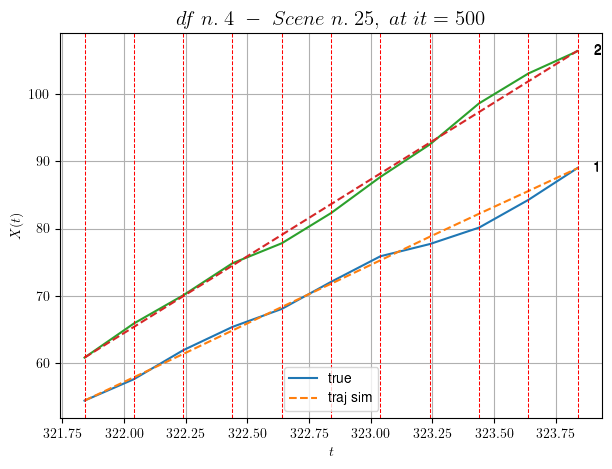

----------------------------------------------------------------------------------------------------
        For scene 27/46:
        * After LR finder: LR_NN=0.005 with mse=36.42723486934165 at it=24
        * v0 = 22.81009773351758
        * MSE = 0.6841949029937056
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.28/46
----------------------------------------------------------------------------------------------------
We have 8 time intervals inside [520.04,521.64]


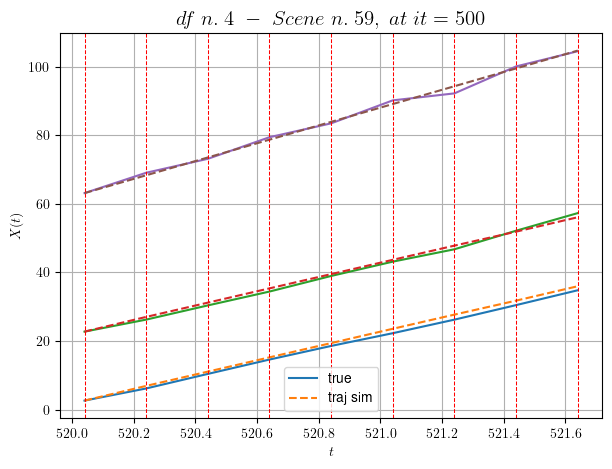

----------------------------------------------------------------------------------------------------
        For scene 28/46:
        * After LR finder: LR_NN=0.01 with mse=5.913833932069032 at it=24
        * v0 = 25.962807327177522
        * MSE = 0.7940875846876435
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.29/46
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [575.04,575.84]


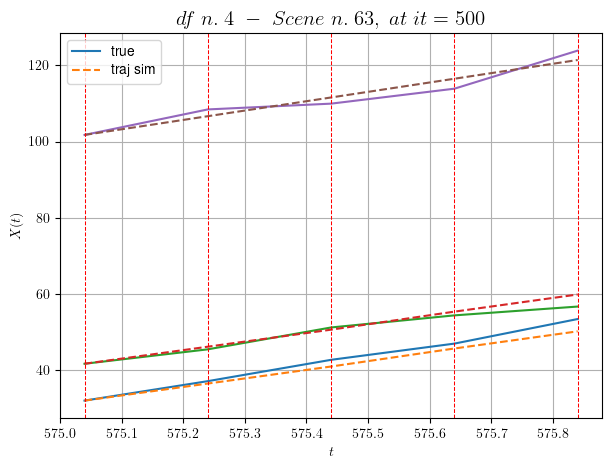

----------------------------------------------------------------------------------------------------
        For scene 29/46:
        * After LR finder: LR_NN=0.005 with mse=5.418574214999475 at it=24
        * v0 = 24.54562150740162
        * MSE = 3.058327415229209
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.30/46
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [153.04,153.44]


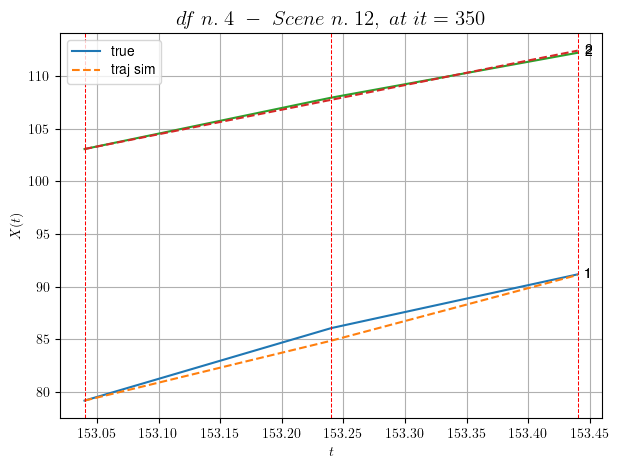

----------------------------------------------------------------------------------------------------
        For scene 30/46:
        * After LR finder: LR_NN=0.005 with mse=2.014877962572653 at it=24
        * v0 = 23.385109159663244
        * MSE = 0.2532878401814464
        * iterations = 350
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.31/46
----------------------------------------------------------------------------------------------------
We have 10 time intervals inside [419.84,421.84]


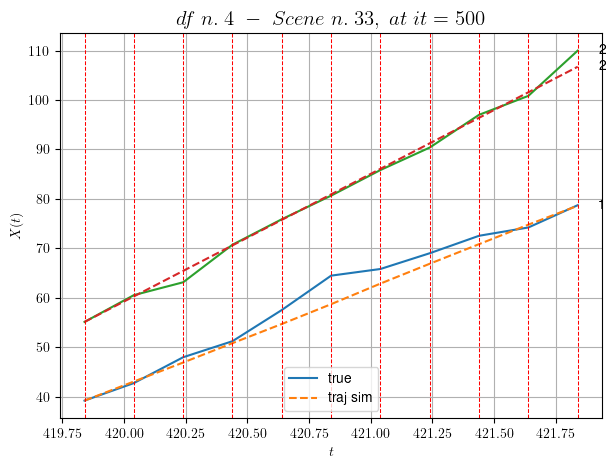

----------------------------------------------------------------------------------------------------
        For scene 31/46:
        * After LR finder: LR_NN=0.005 with mse=14.573281134056222 at it=24
        * v0 = 25.806420226564963
        * MSE = 3.451156323648673
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.32/46
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [462.64,463.04]


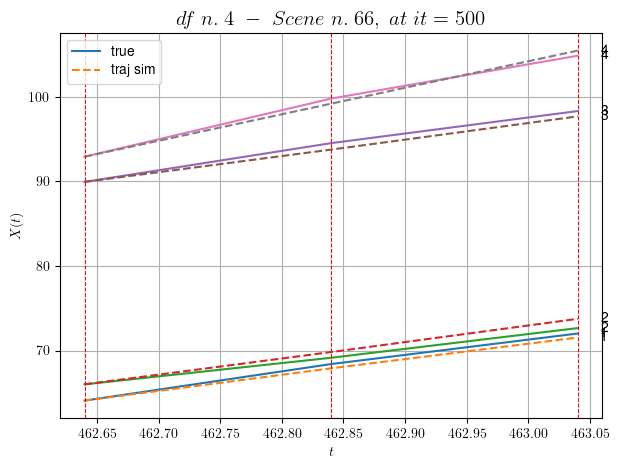

----------------------------------------------------------------------------------------------------
        For scene 32/46:
        * After LR finder: LR_NN=0.01 with mse=0.31972108049112724 at it=24
        * v0 = 31.352447205664888
        * MSE = 0.3105662113774369
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.33/46
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [495.24,495.84]


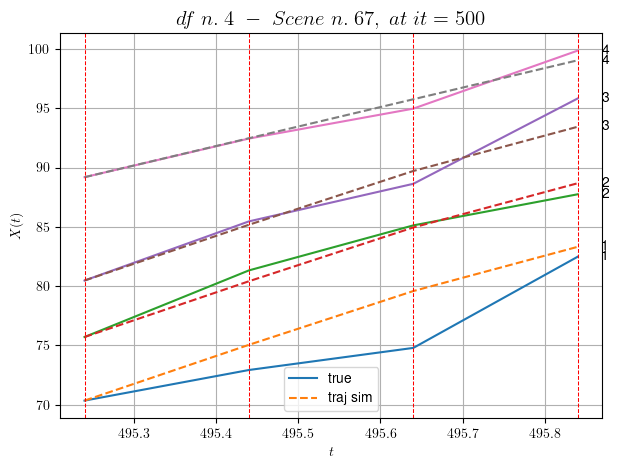

----------------------------------------------------------------------------------------------------
        For scene 33/46:
        * After LR finder: LR_NN=0.01 with mse=8.857424029701846 at it=24
        * v0 = 16.43780548223732
        * MSE = 2.364012647911741
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.34/46
----------------------------------------------------------------------------------------------------
We have 12 time intervals inside [566.84,569.24]


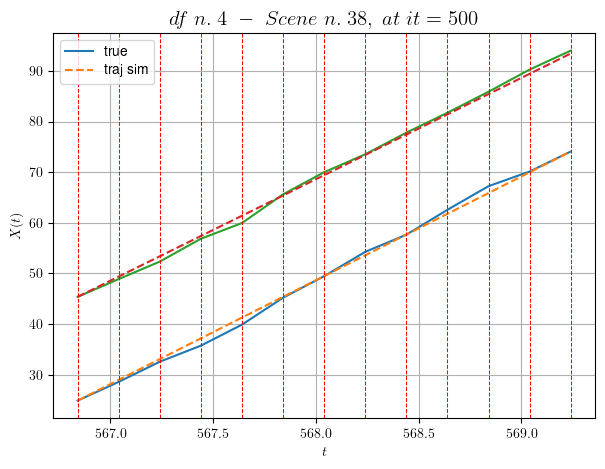

----------------------------------------------------------------------------------------------------
        For scene 34/46:
        * After LR finder: LR_NN=5e-05 with mse=96.52307426686698 at it=24
        * v0 = 20.02848758219778
        * MSE = 0.4605165178433879
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.35/46
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [406.24,406.64]


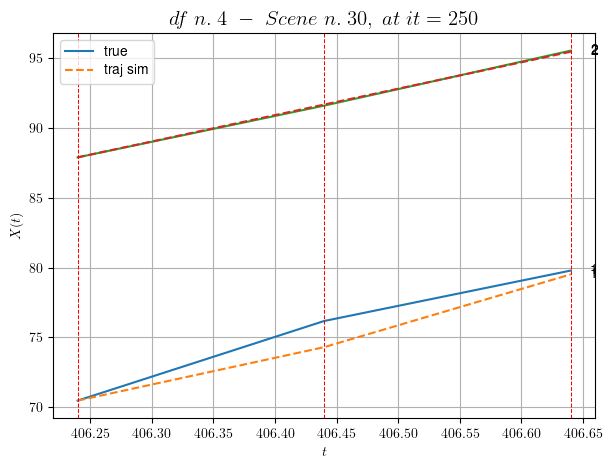

----------------------------------------------------------------------------------------------------
        For scene 35/46:
        * After LR finder: LR_NN=0.01 with mse=4.738020386499931 at it=24
        * v0 = 18.92655097985297
        * MSE = 0.5996263481939443
        * iterations = 250
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.36/46
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [89.04,89.84]


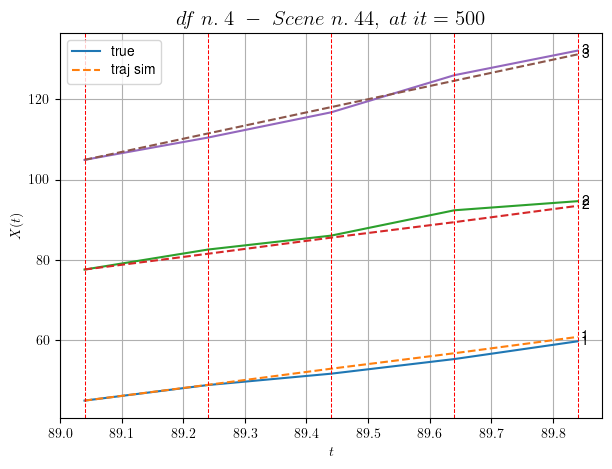

----------------------------------------------------------------------------------------------------
        For scene 36/46:
        * After LR finder: LR_NN=0.005 with mse=2.429356711595657 at it=24
        * v0 = 32.7754316326025
        * MSE = 1.4461041077396108
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.37/46
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [460.84,461.24]


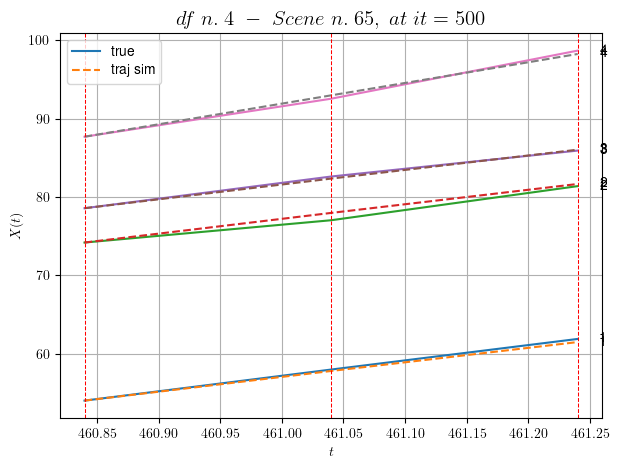

----------------------------------------------------------------------------------------------------
        For scene 37/46:
        * After LR finder: LR_NN=0.01 with mse=0.29350607624442315 at it=24
        * v0 = 26.404314529225573
        * MSE = 0.13202005383032905
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.38/46
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [59.84,60.44]


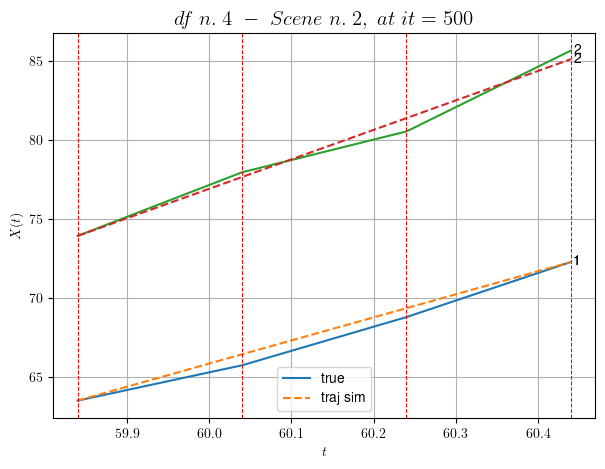

----------------------------------------------------------------------------------------------------
        For scene 38/46:
        * After LR finder: LR_NN=0.0005 with mse=9.164757904371077 at it=24
        * v0 = 18.625518273300347
        * MSE = 0.23726145565071918
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.39/46
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [302.44,302.84]


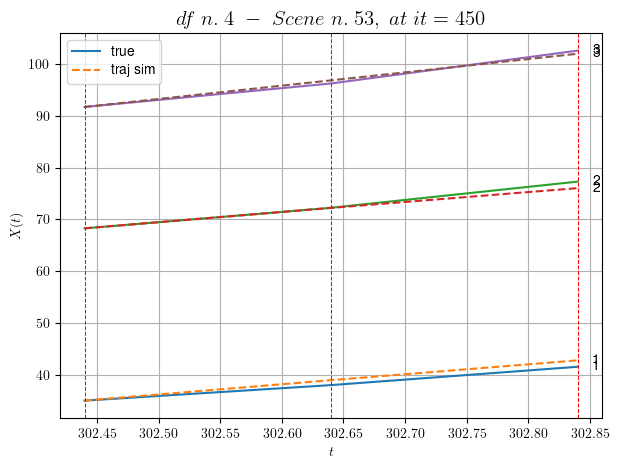

----------------------------------------------------------------------------------------------------
        For scene 39/46:
        * After LR finder: LR_NN=0.005 with mse=0.823871817365983 at it=24
        * v0 = 25.744539084395896
        * MSE = 0.5267728456597784
        * iterations = 450
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.40/46
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [288.04,289.04]


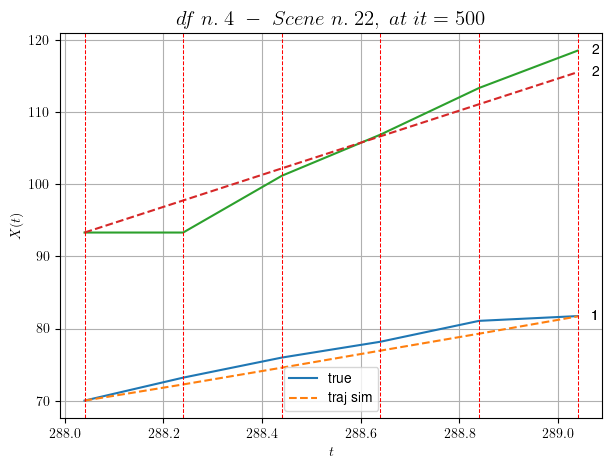

----------------------------------------------------------------------------------------------------
        For scene 40/46:
        * After LR finder: LR_NN=0.005 with mse=10.037248112046209 at it=24
        * v0 = 22.24789971530882
        * MSE = 3.218310366216668
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.41/46
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [65.04,65.64]


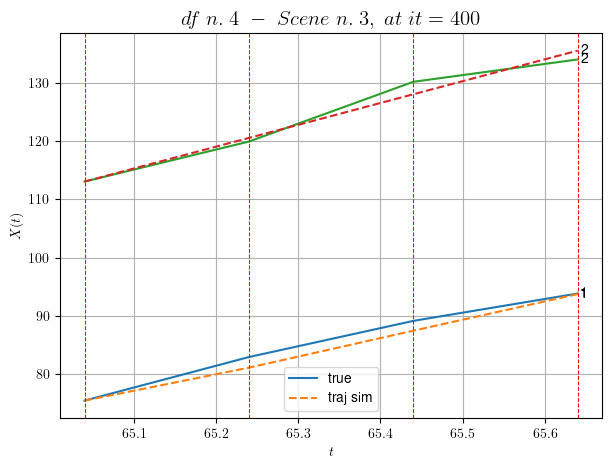

----------------------------------------------------------------------------------------------------
        For scene 41/46:
        * After LR finder: LR_NN=0.005 with mse=5.404750014610443 at it=24
        * v0 = 37.41903741194465
        * MSE = 1.6676774724119379
        * iterations = 400
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.42/46
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [320.44,321.04]


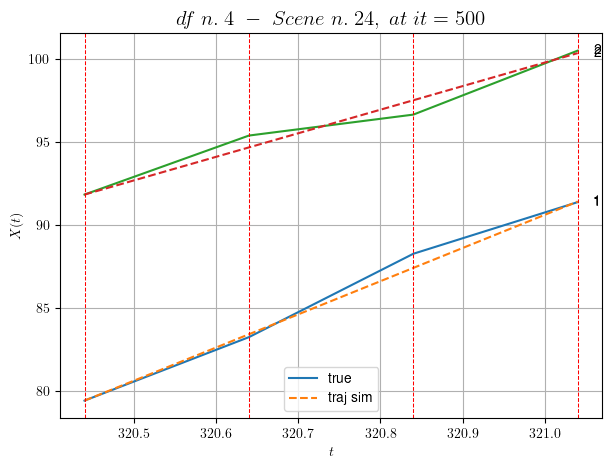

----------------------------------------------------------------------------------------------------
        For scene 42/46:
        * After LR finder: LR_NN=5e-05 with mse=18.221867841111266 at it=24
        * v0 = 14.162426648992293
        * MSE = 0.23537316678971798
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.43/46
----------------------------------------------------------------------------------------------------
We have 8 time intervals inside [285.84,287.44]


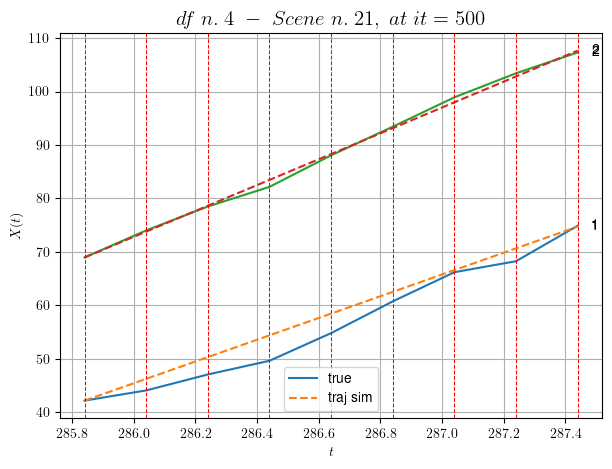

----------------------------------------------------------------------------------------------------
        For scene 43/46:
        * After LR finder: LR_NN=1e-05 with mse=16.66071889733833 at it=24
        * v0 = 24.201830847422507
        * MSE = 3.1891476271524897
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.44/46
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [554.64,555.04]


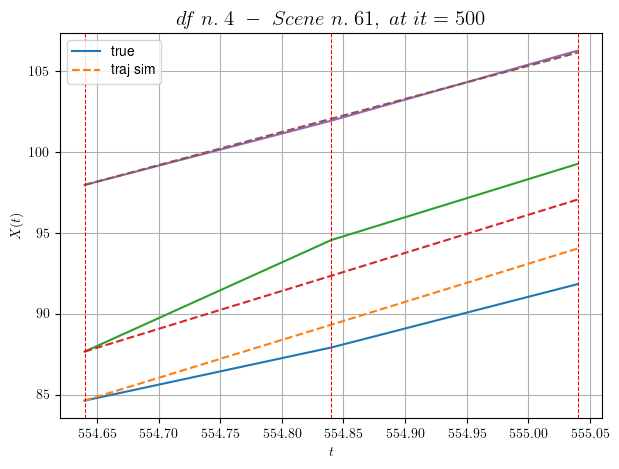

----------------------------------------------------------------------------------------------------
        For scene 44/46:
        * After LR finder: LR_NN=0.001 with mse=2.405521820417124 at it=24
        * v0 = 20.44072781876447
        * MSE = 1.837307594602439
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.45/46
----------------------------------------------------------------------------------------------------
We have 8 time intervals inside [182.04,183.64]


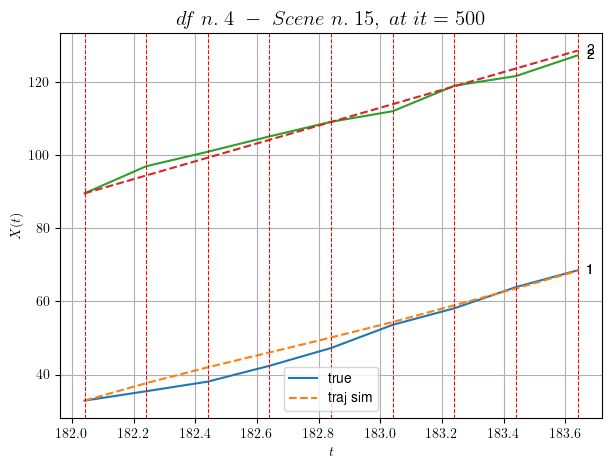

----------------------------------------------------------------------------------------------------
        For scene 45/46:
        * After LR finder: LR_NN=0.01 with mse=19.560032296197647 at it=24
        * v0 = 24.384953428580058
        * MSE = 2.2826625480404488
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.46/46
----------------------------------------------------------------------------------------------------
We have 7 time intervals inside [233.84,235.24]


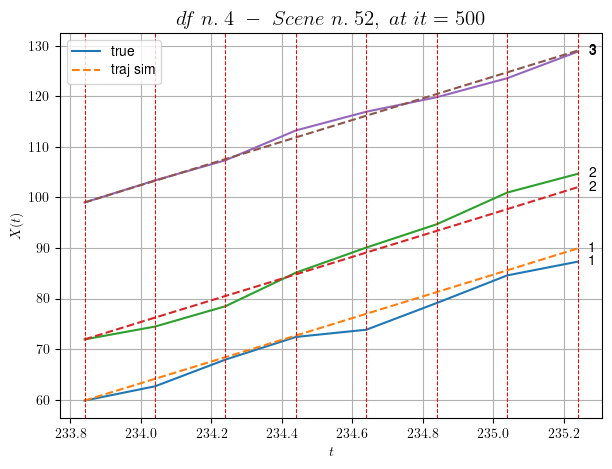

----------------------------------------------------------------------------------------------------
        For scene 46/46:
        * After LR finder: LR_NN=0.001 with mse=20.08577985161295 at it=24
        * v0 = 21.46280647198855
        * MSE = 2.3812874022031334
        * iterations = 500
----------------------------------------------------------------------------------------------------


MSE train: 2.1434451243750097
- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -

Testing step. (23 scenes)
DataFrame n.4. Scene n.1/23


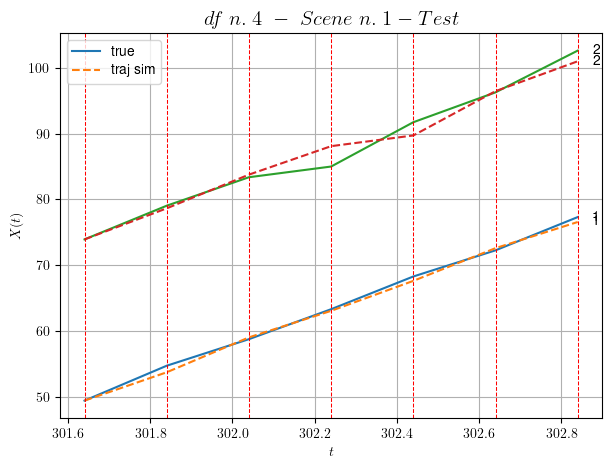

        For scene 1/23:
        * MSE = 1.350676644795801
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.2/23


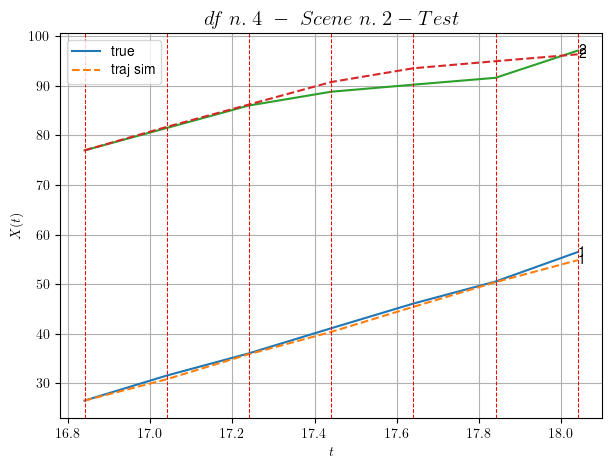

        For scene 2/23:
        * MSE = 2.201867670008858
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.3/23


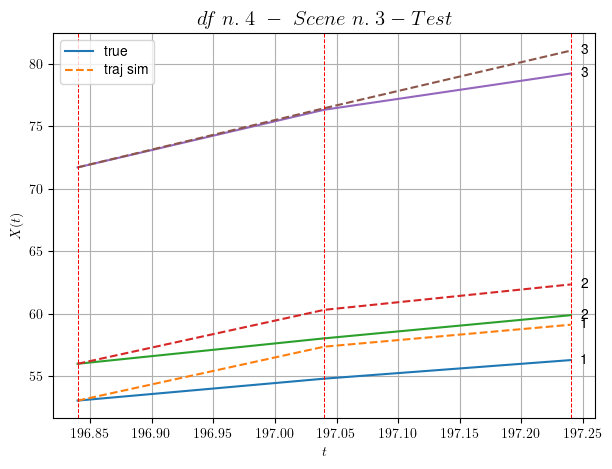

        For scene 3/23:
        * MSE = 3.236121433984062
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.4/23


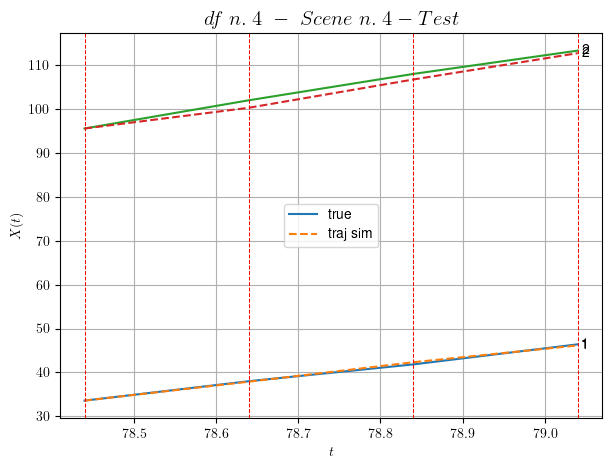

        For scene 4/23:
        * MSE = 0.6432878703501225
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.5/23


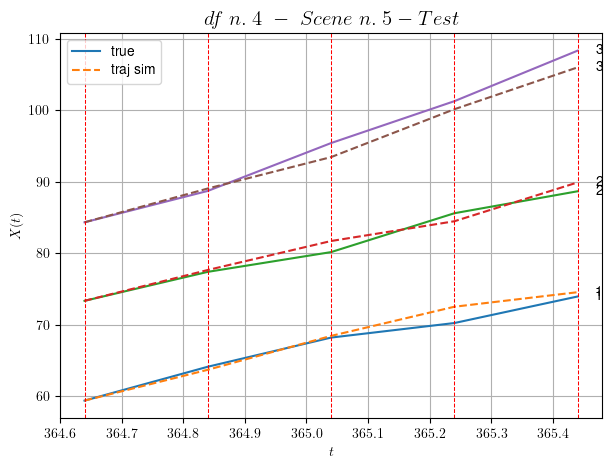

        For scene 5/23:
        * MSE = 1.4501535355734283
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.6/23


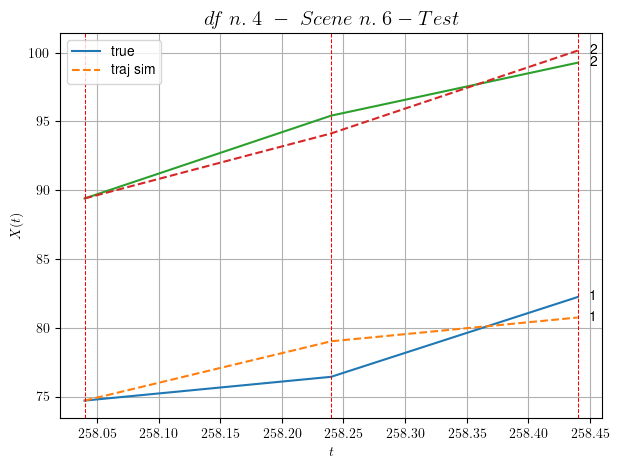

        For scene 6/23:
        * MSE = 1.8870460768017205
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.7/23


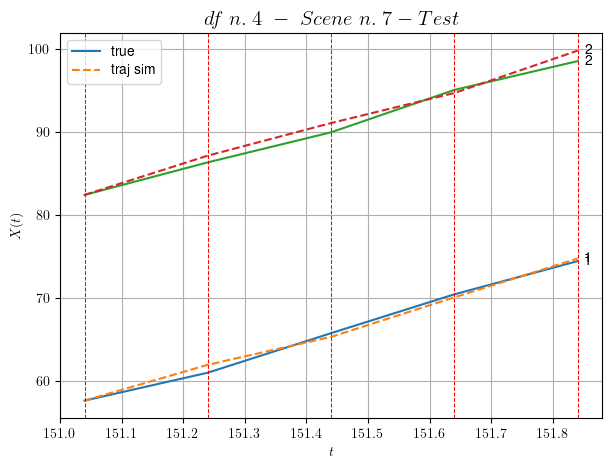

        For scene 7/23:
        * MSE = 0.49582786346371793
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.8/23


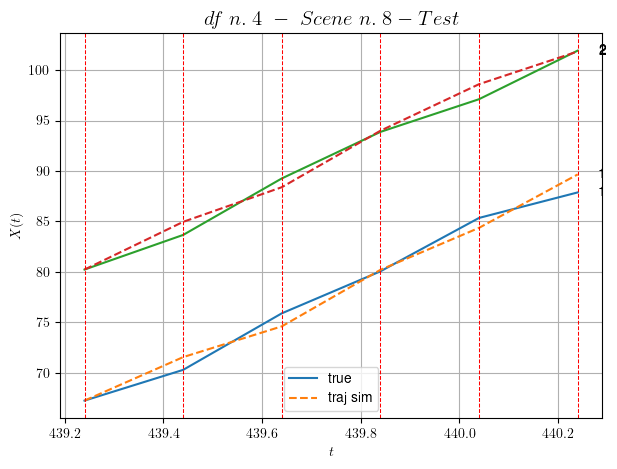

        For scene 8/23:
        * MSE = 1.008403938739025
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.9/23


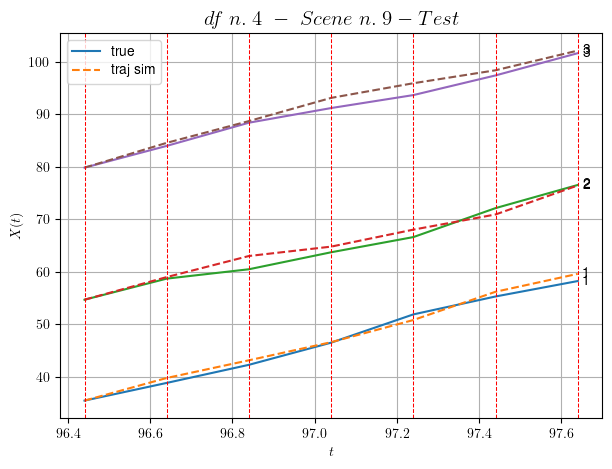

        For scene 9/23:
        * MSE = 1.2892461353773141
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.10/23


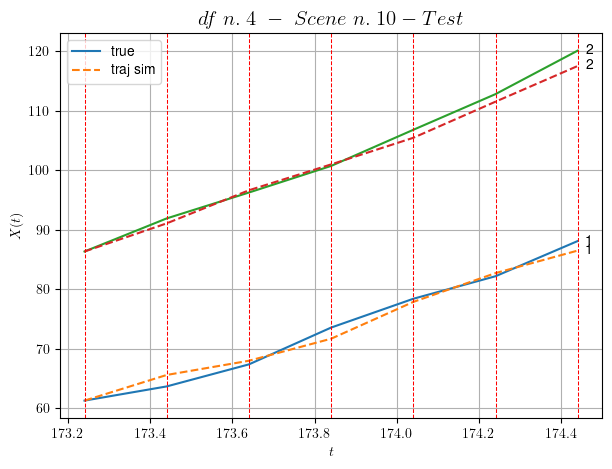

        For scene 10/23:
        * MSE = 1.5499128619780769
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.11/23


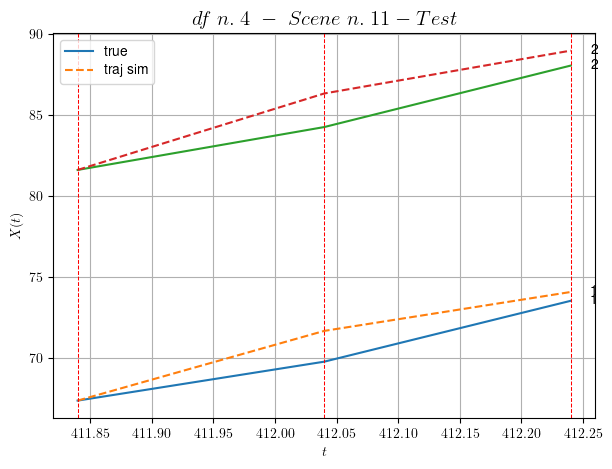

        For scene 11/23:
        * MSE = 1.5145077062100654
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.12/23


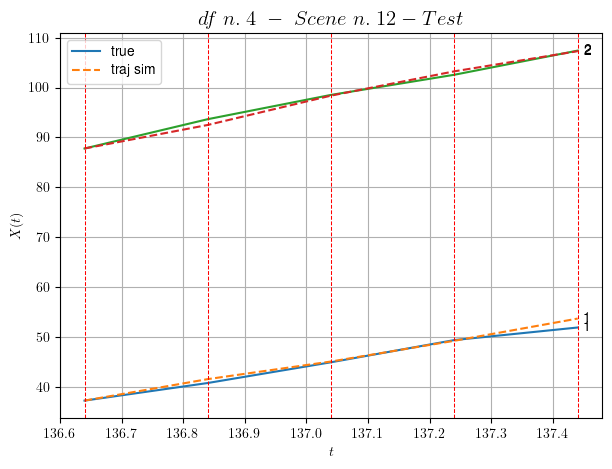

        For scene 12/23:
        * MSE = 0.5700831356080652
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.13/23


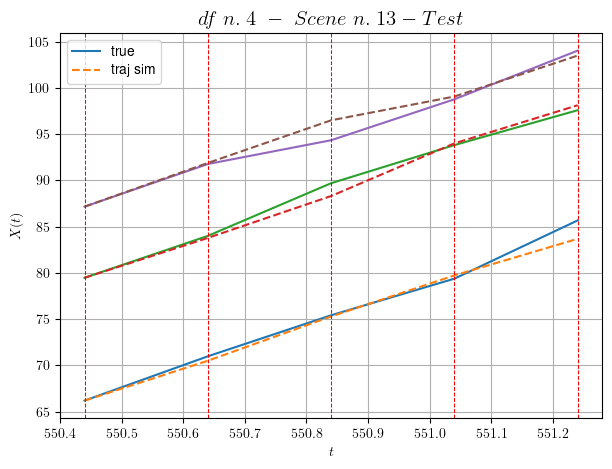

        For scene 13/23:
        * MSE = 0.7768459416641834
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.14/23


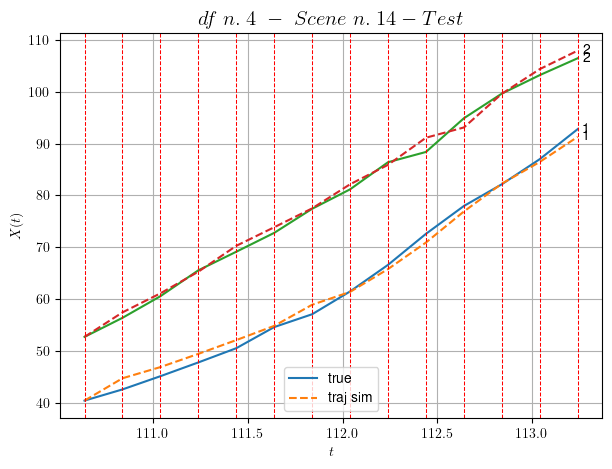

        For scene 14/23:
        * MSE = 1.5305490354453006
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.15/23


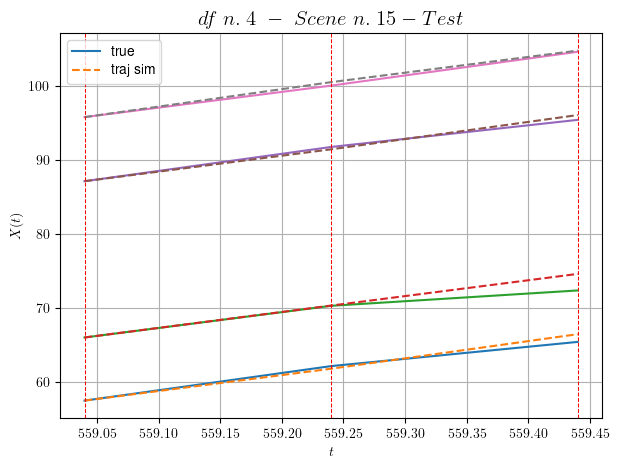

        For scene 15/23:
        * MSE = 0.5818113250615181
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.16/23


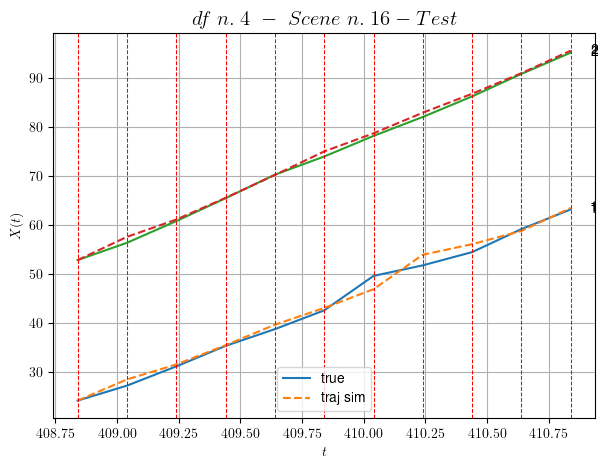

        For scene 16/23:
        * MSE = 0.9907742484634195
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.17/23


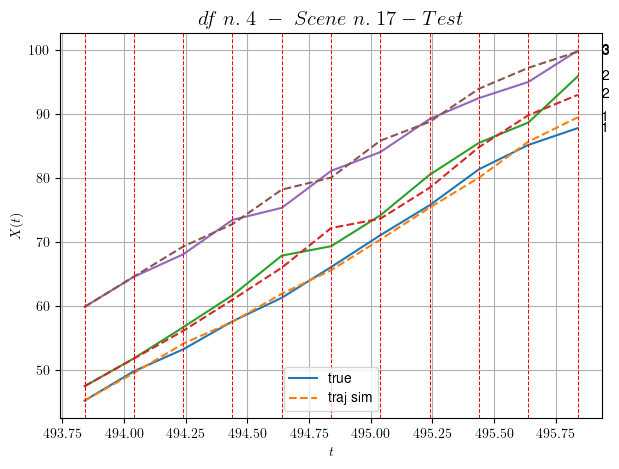

        For scene 17/23:
        * MSE = 1.676759610873188
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.18/23


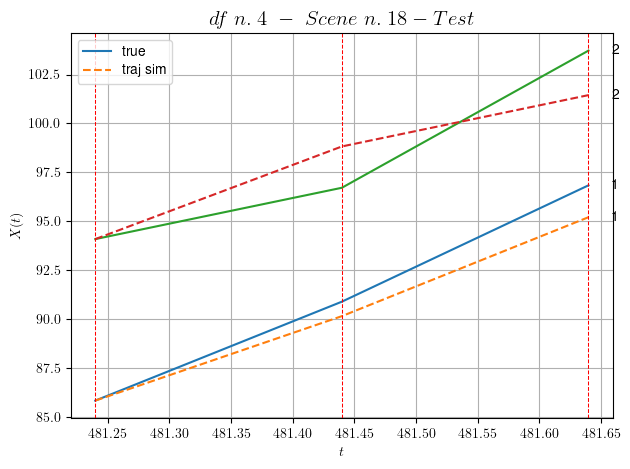

        For scene 18/23:
        * MSE = 2.1339182485114154
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.19/23


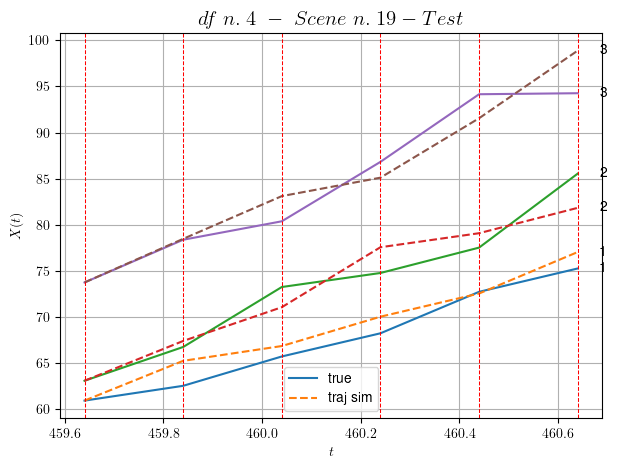

        For scene 19/23:
        * MSE = 4.5969193005697635
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.20/23


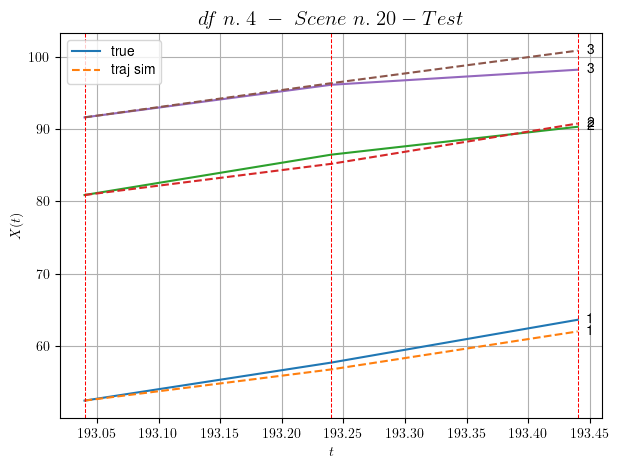

        For scene 20/23:
        * MSE = 1.3715621717922815
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.21/23


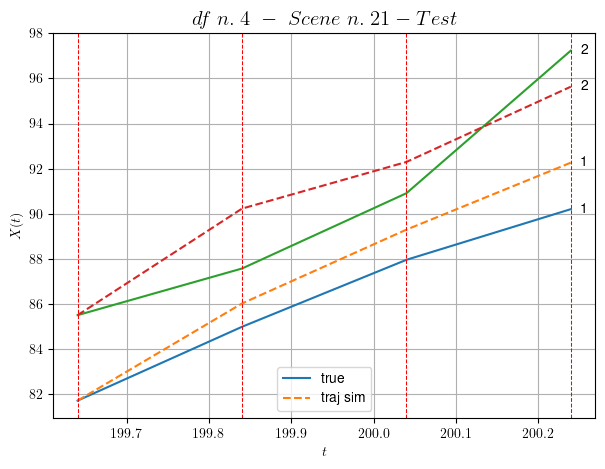

        For scene 21/23:
        * MSE = 2.3357348683663757
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.22/23


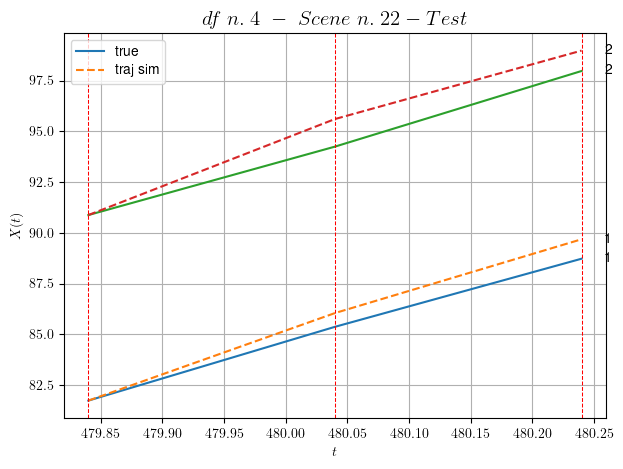

        For scene 22/23:
        * MSE = 0.7047323645232639
----------------------------------------------------------------------------------------------------


DataFrame n.4. Scene n.23/23


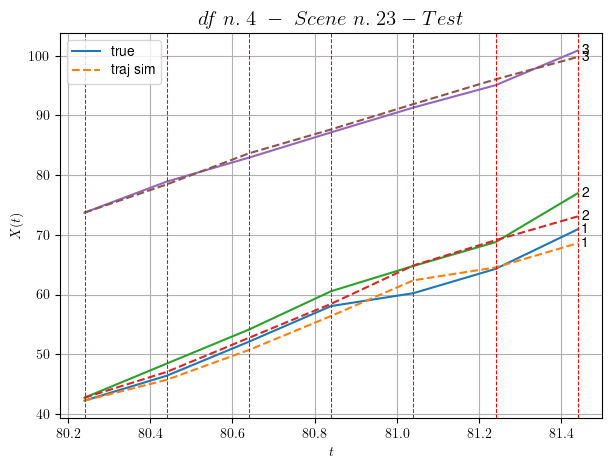

        For scene 23/23:
        * MSE = 2.0038304355372514
----------------------------------------------------------------------------------------------------


MSE test: 1.5608944532042706

- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -

    Summing up:
          * MSE train: 2.1434451243750097
          * MSE test: 1.5608944532042706
          
- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -




Analyzing 5/10 dfs.
In DataFrame n.5 we have 66 scenes.
    To train the model we use 44 scenes, the remaining 22 to test the model.

Training step. (44 scenes)
DataFrame n.5. Scene n.1/44
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [64.32,65.32]


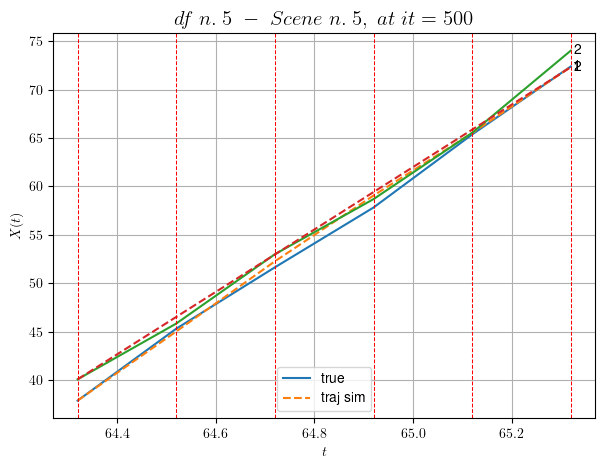

----------------------------------------------------------------------------------------------------
        For scene 1/44:
        * After LR finder: LR_NN=0.01 with mse=1.7264431615250464 at it=24
        * v0 = 32.233878573413726
        * MSE = 0.506800736936478
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.2/44
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [502.72,503.72]


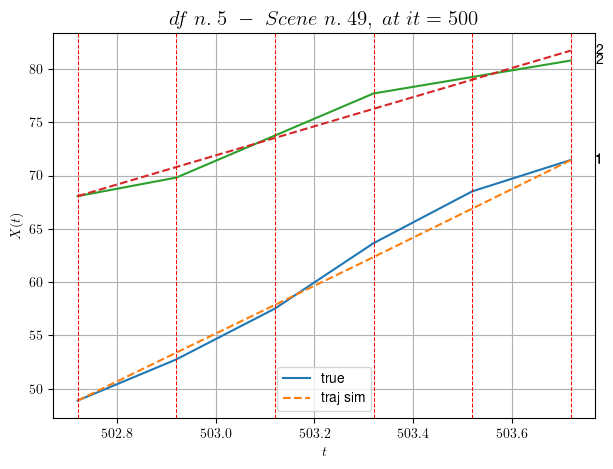

----------------------------------------------------------------------------------------------------
        For scene 2/44:
        * After LR finder: LR_NN=0.001 with mse=49.706478865499136 at it=24
        * v0 = 13.651414022049957
        * MSE = 0.7347321599994583
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.3/44
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [395.32,395.72]


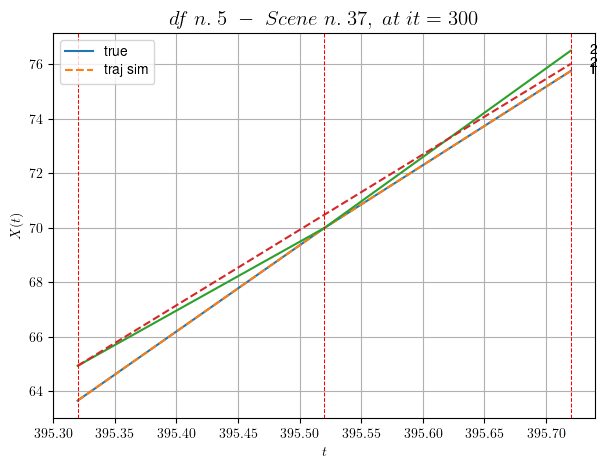

----------------------------------------------------------------------------------------------------
        For scene 3/44:
        * After LR finder: LR_NN=0.01 with mse=0.23179729279058467 at it=24
        * v0 = 27.699213779674697
        * MSE = 0.07069011322567843
        * iterations = 300
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.4/44
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [225.72,226.12]


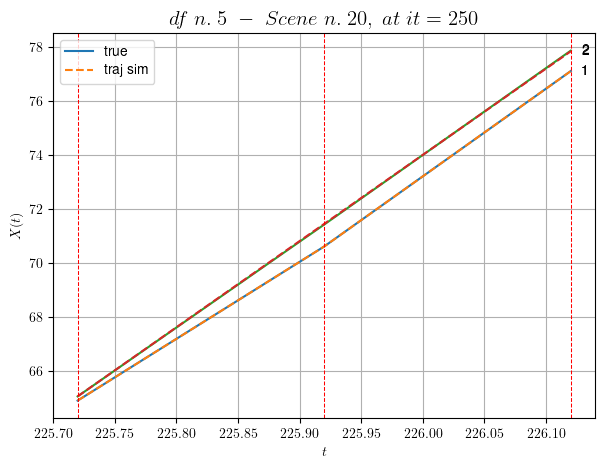

----------------------------------------------------------------------------------------------------
        For scene 4/44:
        * After LR finder: LR_NN=0.005 with mse=0.14012844907245048 at it=24
        * v0 = 32.02147602886436
        * MSE = 0.0002198692093902678
        * iterations = 250
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.5/44
----------------------------------------------------------------------------------------------------
We have 6 time intervals inside [177.32,178.52]


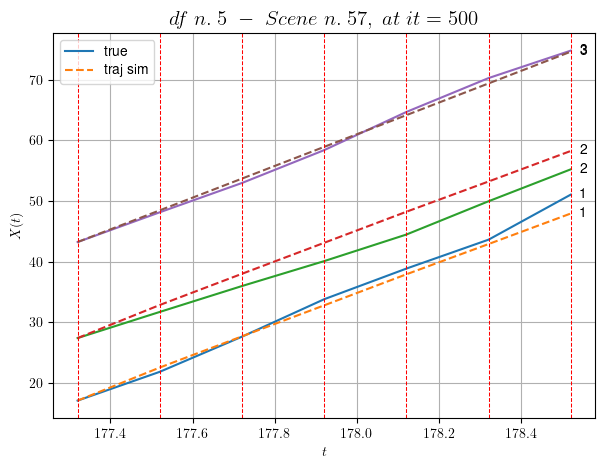

----------------------------------------------------------------------------------------------------
        For scene 5/44:
        * After LR finder: LR_NN=0.01 with mse=5.403450668256039 at it=24
        * v0 = 26.180378384786135
        * MSE = 3.004935013722271
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.6/44
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [319.52,319.92]


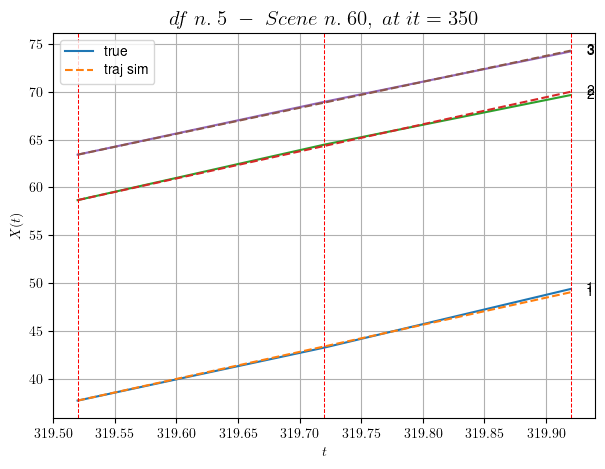

----------------------------------------------------------------------------------------------------
        For scene 6/44:
        * After LR finder: LR_NN=0.01 with mse=0.21273788907348645 at it=24
        * v0 = 27.222480010446706
        * MSE = 0.03174746556481388
        * iterations = 350
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.7/44
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [316.92,317.32]


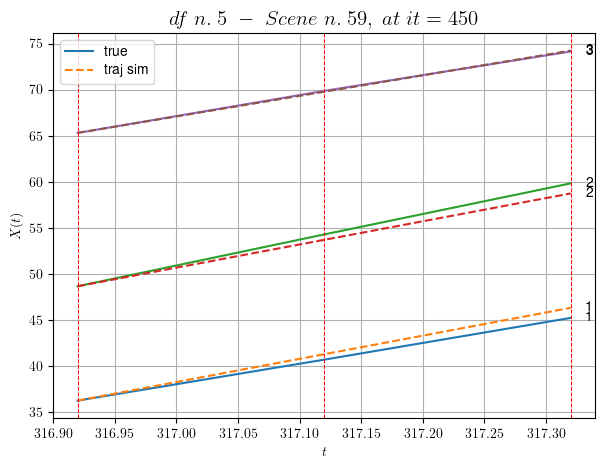

----------------------------------------------------------------------------------------------------
        For scene 7/44:
        * After LR finder: LR_NN=0.0001 with mse=1.3464190959344053 at it=24
        * v0 = 22.342047393290702
        * MSE = 0.34609861804129366
        * iterations = 450
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.8/44
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [533.12,533.52]


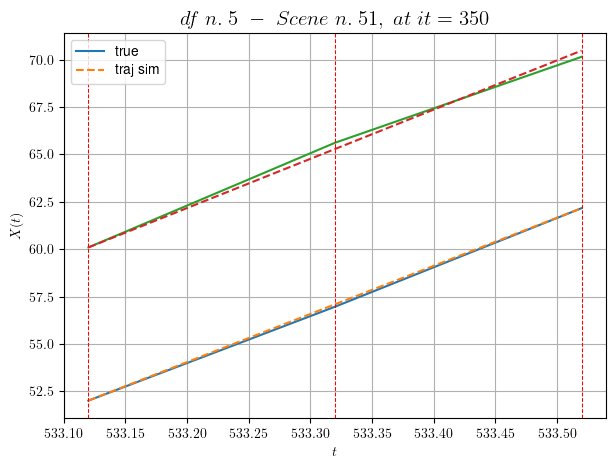

----------------------------------------------------------------------------------------------------
        For scene 8/44:
        * After LR finder: LR_NN=0.0005 with mse=0.6730459823038709 at it=24
        * v0 = 25.948720360556514
        * MSE = 0.03867968449981469
        * iterations = 350
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.9/44
----------------------------------------------------------------------------------------------------
We have 7 time intervals inside [332.72,334.12]


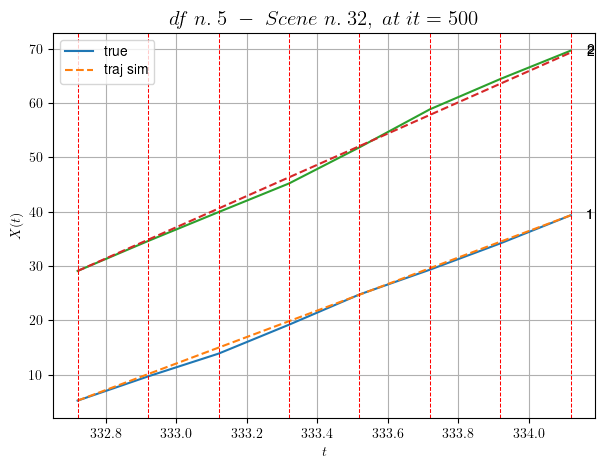

----------------------------------------------------------------------------------------------------
        For scene 9/44:
        * After LR finder: LR_NN=0.0005 with mse=0.7081976271954714 at it=24
        * v0 = 28.71468581675497
        * MSE = 0.33770218578285693
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.10/44
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [457.32,458.32]


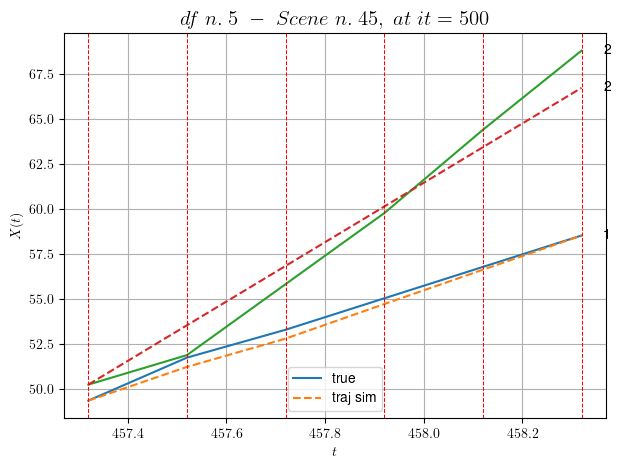

----------------------------------------------------------------------------------------------------
        For scene 10/44:
        * After LR finder: LR_NN=0.005 with mse=30.00391373566974 at it=24
        * v0 = 16.493097805853914
        * MSE = 0.6838587312123262
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.11/44
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [578.92,579.52]


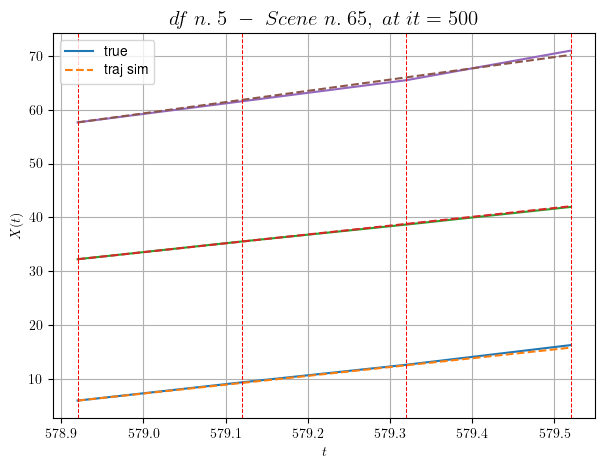

----------------------------------------------------------------------------------------------------
        For scene 11/44:
        * After LR finder: LR_NN=5e-05 with mse=3.627335246958458 at it=24
        * v0 = 20.916611347753896
        * MSE = 0.10380191777149023
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.12/44
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [167.32,167.72]


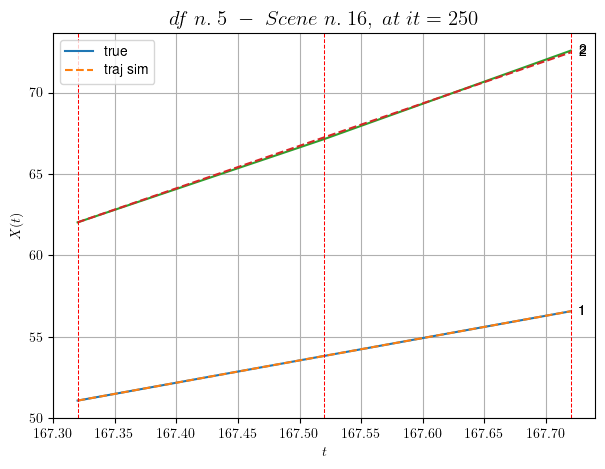

----------------------------------------------------------------------------------------------------
        For scene 12/44:
        * After LR finder: LR_NN=0.01 with mse=0.4811571449022303 at it=24
        * v0 = 26.107264726505786
        * MSE = 0.0034370013656676145
        * iterations = 250
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.13/44
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [293.52,294.32]


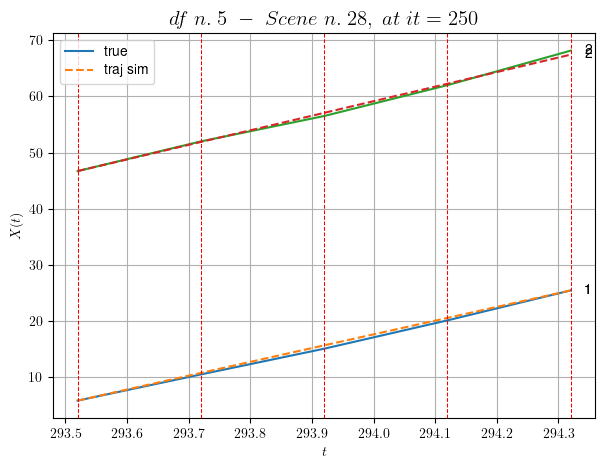

----------------------------------------------------------------------------------------------------
        For scene 13/44:
        * After LR finder: LR_NN=0.001 with mse=1.943223585564247 at it=24
        * v0 = 25.930539035901443
        * MSE = 0.14857602123860245
        * iterations = 250
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.14/44
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [282.52,282.92]


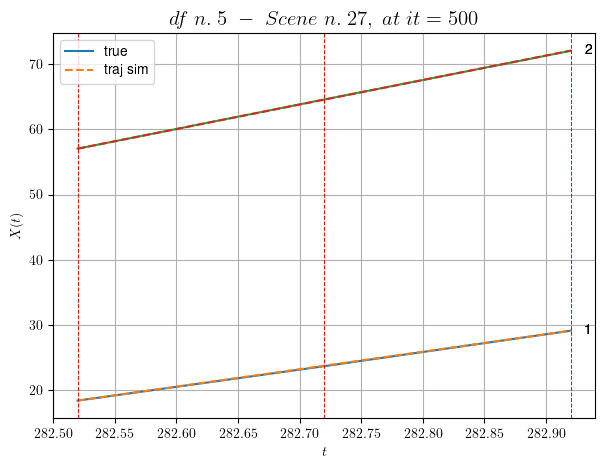

----------------------------------------------------------------------------------------------------
        For scene 14/44:
        * After LR finder: LR_NN=5e-05 with mse=1.8835799345845703 at it=24
        * v0 = 37.54120665562212
        * MSE = 0.0012043097476172914
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.15/44
----------------------------------------------------------------------------------------------------
We have 7 time intervals inside [274.12,275.52]


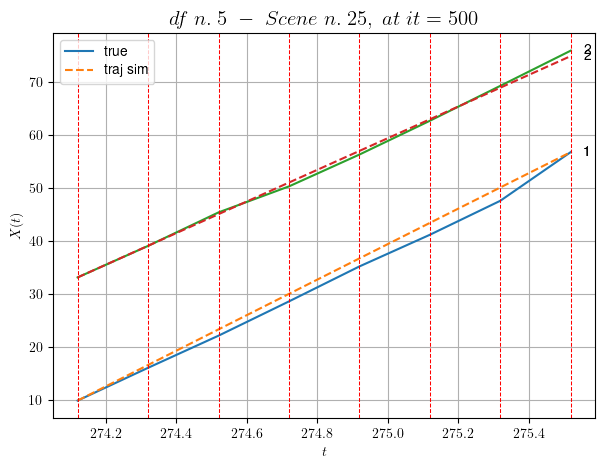

----------------------------------------------------------------------------------------------------
        For scene 15/44:
        * After LR finder: LR_NN=0.0005 with mse=1.1736176593023673 at it=24
        * v0 = 29.831436253445805
        * MSE = 0.5519168828858243
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.16/44
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [496.72,497.12]


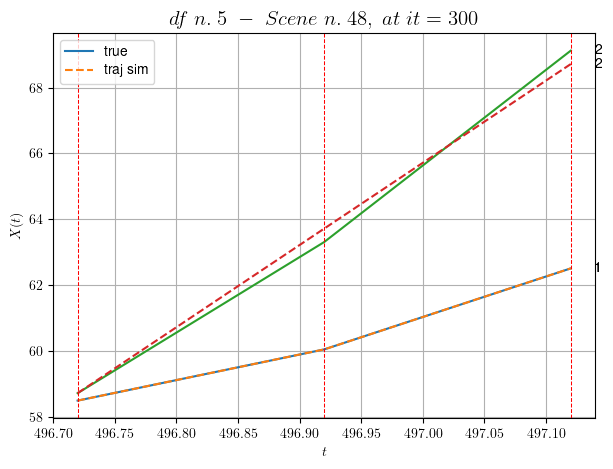

----------------------------------------------------------------------------------------------------
        For scene 16/44:
        * After LR finder: LR_NN=0.005 with mse=0.7496254995602878 at it=24
        * v0 = 25.010967354282688
        * MSE = 0.04997553351383717
        * iterations = 300
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.17/44
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [125.12,126.12]


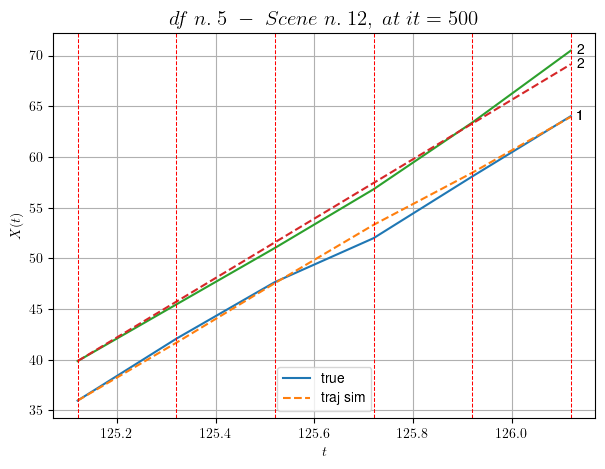

----------------------------------------------------------------------------------------------------
        For scene 17/44:
        * After LR finder: LR_NN=0.01 with mse=0.4127486339351565 at it=24
        * v0 = 29.269210394723142
        * MSE = 0.3843324069677982
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.18/44
----------------------------------------------------------------------------------------------------
We have 9 time intervals inside [337.72,339.52]


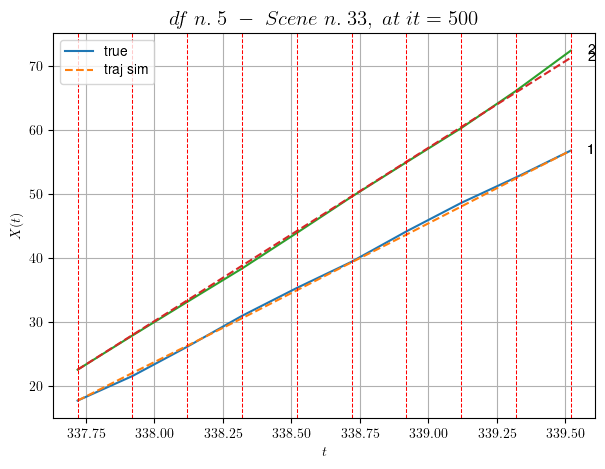

----------------------------------------------------------------------------------------------------
        For scene 18/44:
        * After LR finder: LR_NN=0.01 with mse=4.802870869730661 at it=24
        * v0 = 27.020038219088747
        * MSE = 0.13969724158384533
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.19/44
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [338.52,339.52]


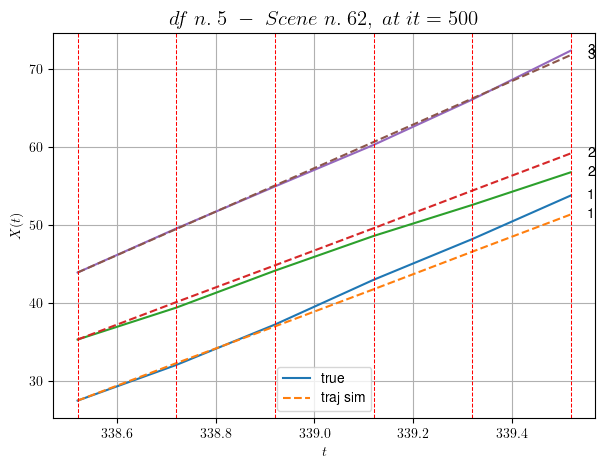

----------------------------------------------------------------------------------------------------
        For scene 19/44:
        * After LR finder: LR_NN=0.005 with mse=1.7245581346935417 at it=24
        * v0 = 27.85392842609584
        * MSE = 1.2065618487825924
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.20/44
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [490.92,491.32]


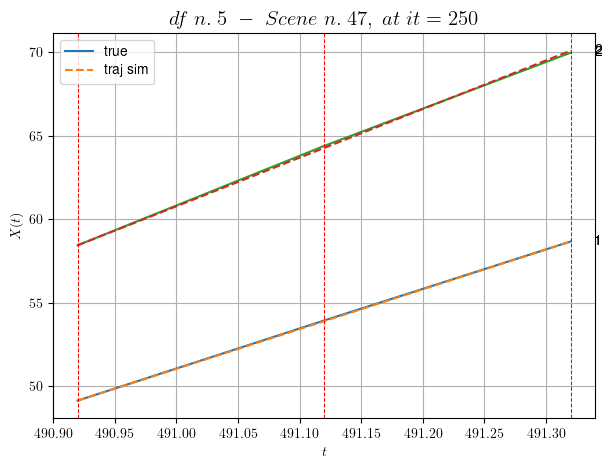

----------------------------------------------------------------------------------------------------
        For scene 20/44:
        * After LR finder: LR_NN=0.005 with mse=0.038747825139900875 at it=24
        * v0 = 29.11559727009669
        * MSE = 0.005398034841065151
        * iterations = 250
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.21/44
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [396.92,397.32]


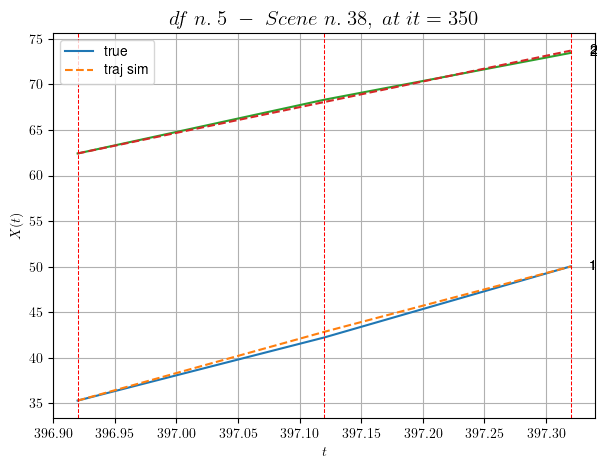

----------------------------------------------------------------------------------------------------
        For scene 21/44:
        * After LR finder: LR_NN=0.005 with mse=0.2301467364010334 at it=24
        * v0 = 28.239105422206396
        * MSE = 0.08473022941560597
        * iterations = 350
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.22/44
----------------------------------------------------------------------------------------------------
We have 7 time intervals inside [326.52,327.92]


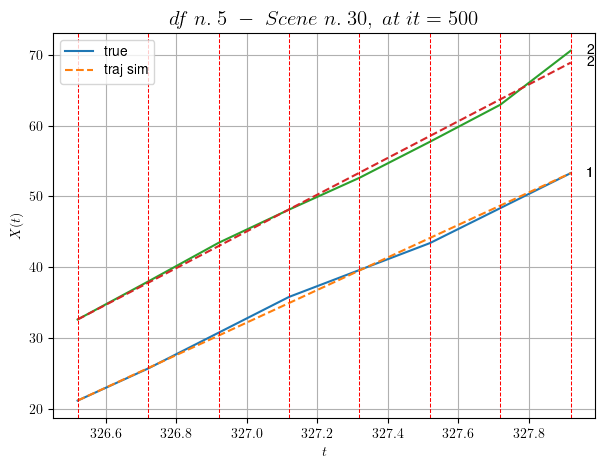

----------------------------------------------------------------------------------------------------
        For scene 22/44:
        * After LR finder: LR_NN=0.0005 with mse=6.175812439208915 at it=24
        * v0 = 25.910216862746537
        * MSE = 0.4036510292819266
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.23/44
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [450.92,451.52]


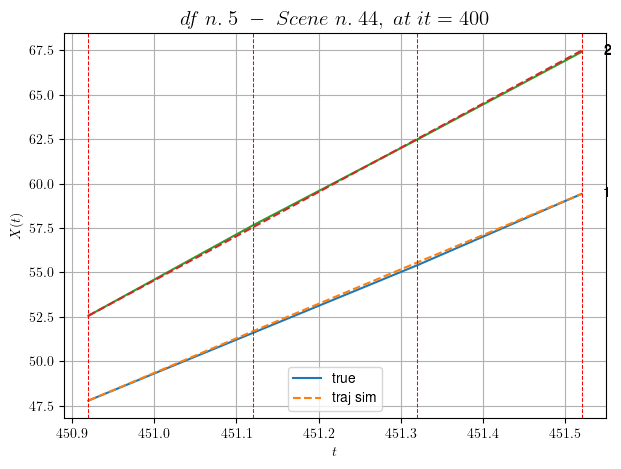

----------------------------------------------------------------------------------------------------
        For scene 23/44:
        * After LR finder: LR_NN=0.005 with mse=1.8911678179768578 at it=24
        * v0 = 24.87748266118287
        * MSE = 0.006207027484151764
        * iterations = 400
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.24/44
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [525.52,526.12]


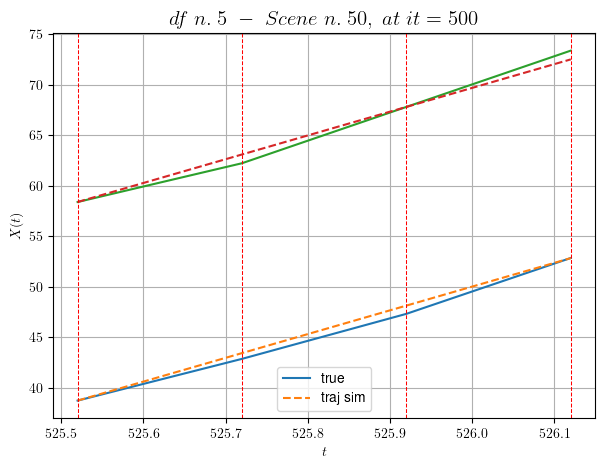

----------------------------------------------------------------------------------------------------
        For scene 24/44:
        * After LR finder: LR_NN=5e-05 with mse=2.6489204453627466 at it=24
        * v0 = 23.539355454247378
        * MSE = 0.26948990895111413
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.25/44
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [38.72,39.12]


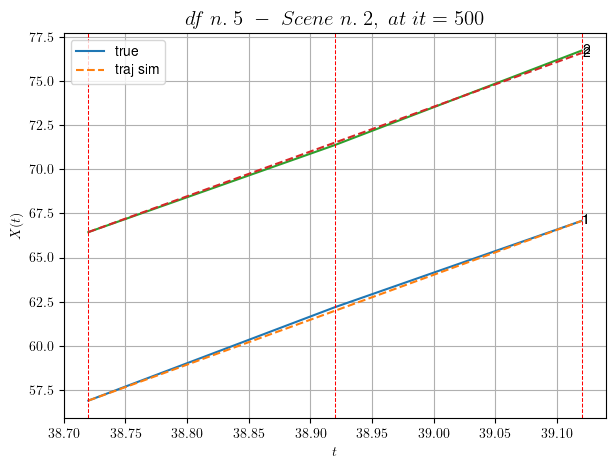

----------------------------------------------------------------------------------------------------
        For scene 25/44:
        * After LR finder: LR_NN=0.0001 with mse=0.6802516259682863 at it=24
        * v0 = 25.372431967348746
        * MSE = 0.013240242832154338
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.26/44
----------------------------------------------------------------------------------------------------
We have 6 time intervals inside [232.32,233.52]


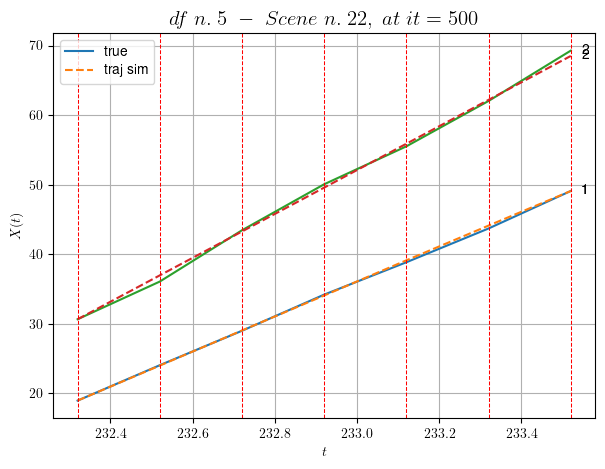

----------------------------------------------------------------------------------------------------
        For scene 26/44:
        * After LR finder: LR_NN=0.005 with mse=0.9214399588190065 at it=24
        * v0 = 31.53725778703068
        * MSE = 0.14863473086406023
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.27/44
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [47.12,47.52]


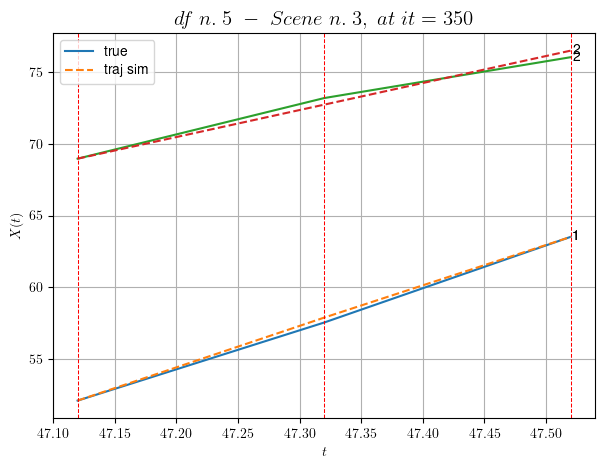

----------------------------------------------------------------------------------------------------
        For scene 27/44:
        * After LR finder: LR_NN=0.005 with mse=4.636221162205771 at it=24
        * v0 = 18.771821458610123
        * MSE = 0.0890643781225394
        * iterations = 350
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.28/44
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [28.12,28.72]


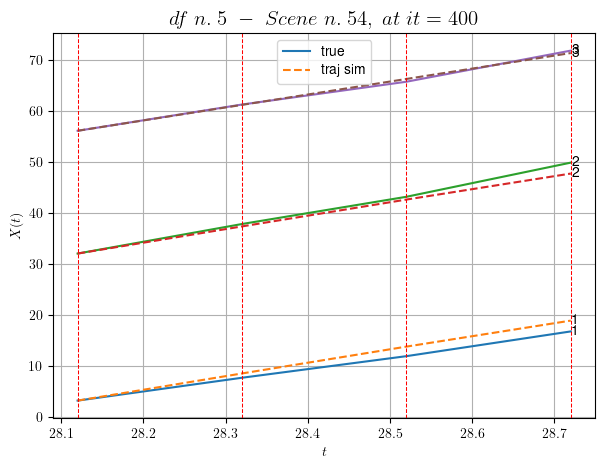

----------------------------------------------------------------------------------------------------
        For scene 28/44:
        * After LR finder: LR_NN=0.005 with mse=2.147395383432215 at it=24
        * v0 = 25.379389752272676
        * MSE = 1.1881874792503375
        * iterations = 400
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.29/44
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [415.32,416.32]


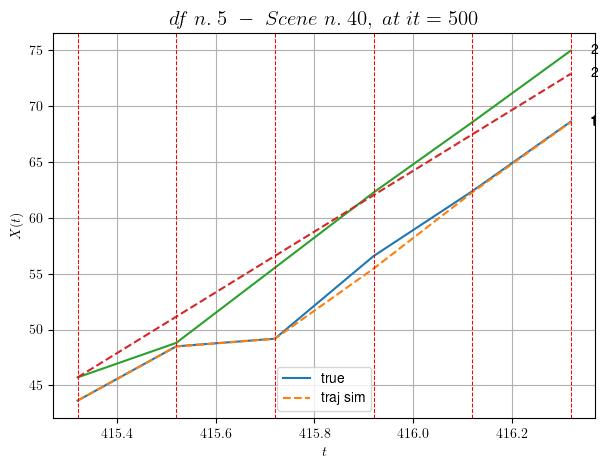

----------------------------------------------------------------------------------------------------
        For scene 29/44:
        * After LR finder: LR_NN=0.01 with mse=1.7894301955898206 at it=24
        * v0 = 27.188395316741133
        * MSE = 1.0788746056717096
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.30/44
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [368.32,368.92]


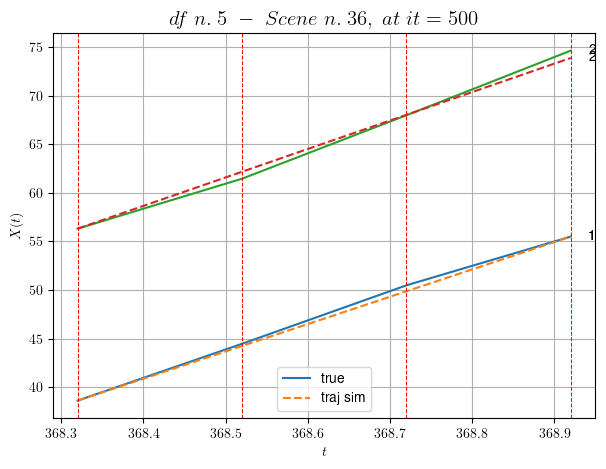

----------------------------------------------------------------------------------------------------
        For scene 30/44:
        * After LR finder: LR_NN=0.0001 with mse=0.21414636686843475 at it=24
        * v0 = 29.298139298124248
        * MSE = 0.16637942324188834
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.31/44
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [23.72,24.52]


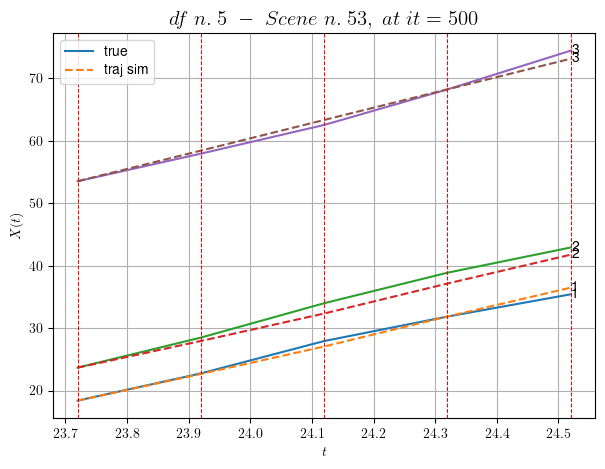

----------------------------------------------------------------------------------------------------
        For scene 31/44:
        * After LR finder: LR_NN=0.01 with mse=2.8744507130887165 at it=24
        * v0 = 24.534803734519397
        * MSE = 0.785464622519857
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.32/44
----------------------------------------------------------------------------------------------------
We have 6 time intervals inside [264.92,266.12]


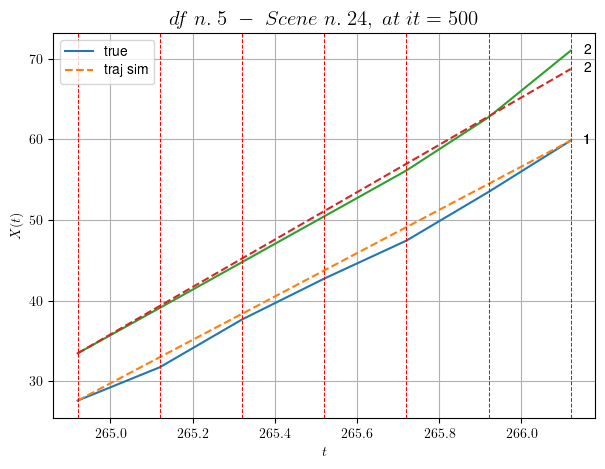

----------------------------------------------------------------------------------------------------
        For scene 32/44:
        * After LR finder: LR_NN=0.0005 with mse=0.5359944504521172 at it=24
        * v0 = 29.366788374198638
        * MSE = 0.6915690910624379
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.33/44
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [151.12,151.52]


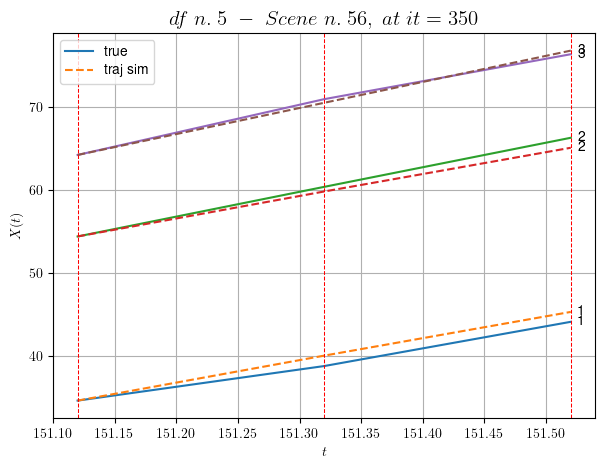

----------------------------------------------------------------------------------------------------
        For scene 33/44:
        * After LR finder: LR_NN=0.005 with mse=0.5993146702379603 at it=24
        * v0 = 31.51612778259319
        * MSE = 0.5740223325362923
        * iterations = 350
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.34/44
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [123.92,124.52]


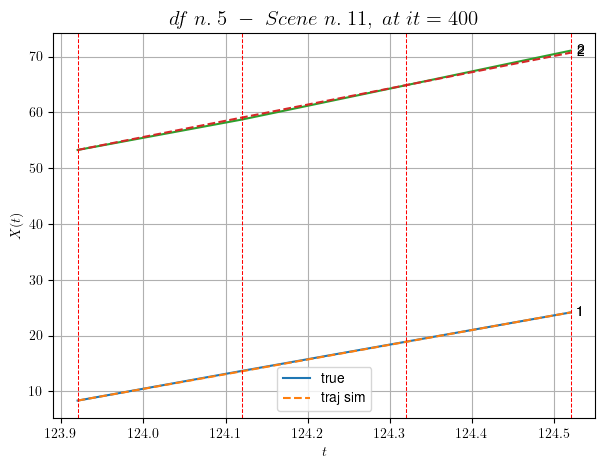

----------------------------------------------------------------------------------------------------
        For scene 34/44:
        * After LR finder: LR_NN=0.005 with mse=0.06070388251772915 at it=24
        * v0 = 29.067105023724743
        * MSE = 0.028878579839878505
        * iterations = 400
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.35/44
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [251.72,252.72]


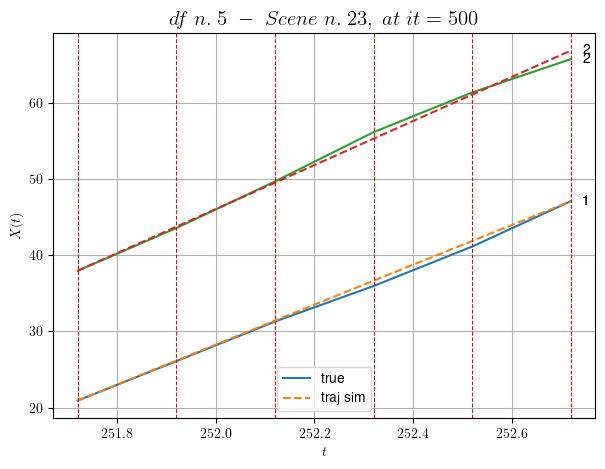

----------------------------------------------------------------------------------------------------
        For scene 35/44:
        * After LR finder: LR_NN=0.001 with mse=0.5190988705909195 at it=24
        * v0 = 28.911331954379772
        * MSE = 0.26233216324435454
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.36/44
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [214.32,214.92]


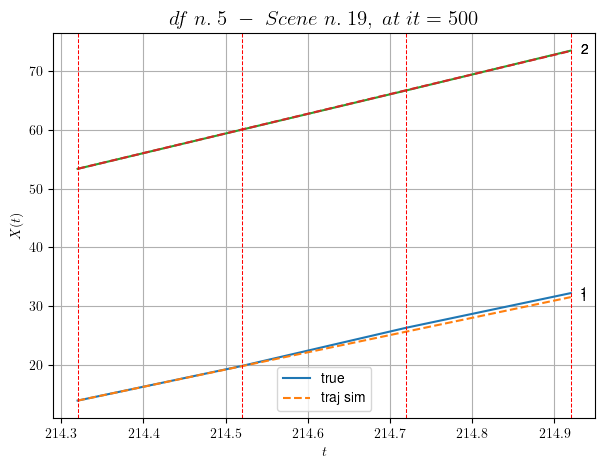

----------------------------------------------------------------------------------------------------
        For scene 36/44:
        * After LR finder: LR_NN=1e-05 with mse=0.8462056964626704 at it=24
        * v0 = 33.41665141134036
        * MSE = 0.11363039973314532
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.37/44
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [266.92,267.32]


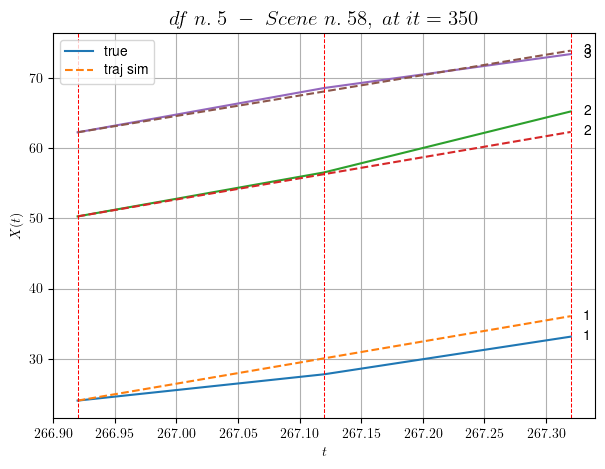

----------------------------------------------------------------------------------------------------
        For scene 37/44:
        * After LR finder: LR_NN=0.0001 with mse=13.56382215474308 at it=24
        * v0 = 29.085708232490965
        * MSE = 2.509173774862044
        * iterations = 350
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.38/44
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [407.92,408.52]


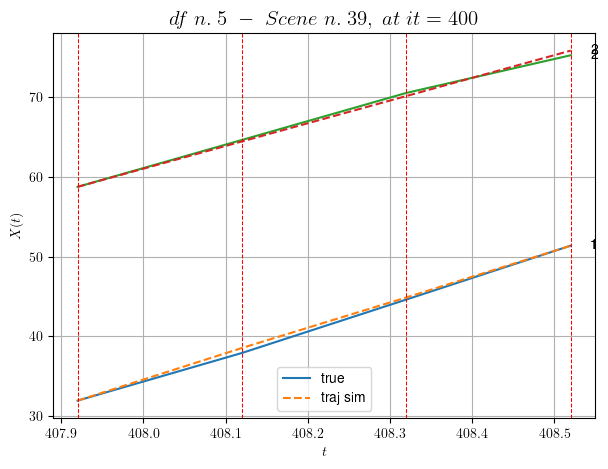

----------------------------------------------------------------------------------------------------
        For scene 38/44:
        * After LR finder: LR_NN=0.005 with mse=0.3597038686700027 at it=24
        * v0 = 28.450687364112596
        * MSE = 0.12298320529315117
        * iterations = 400
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.39/44
----------------------------------------------------------------------------------------------------
We have 6 time intervals inside [226.72,227.92]


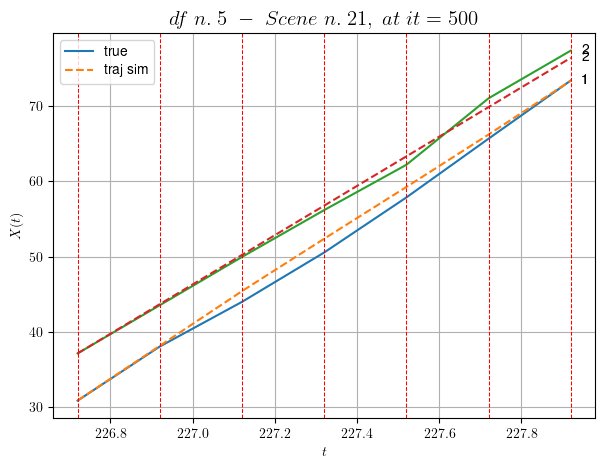

----------------------------------------------------------------------------------------------------
        For scene 39/44:
        * After LR finder: LR_NN=0.005 with mse=3.050527903656246 at it=24
        * v0 = 32.693664579613795
        * MSE = 0.8219546604725125
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.40/44
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [330.12,330.52]


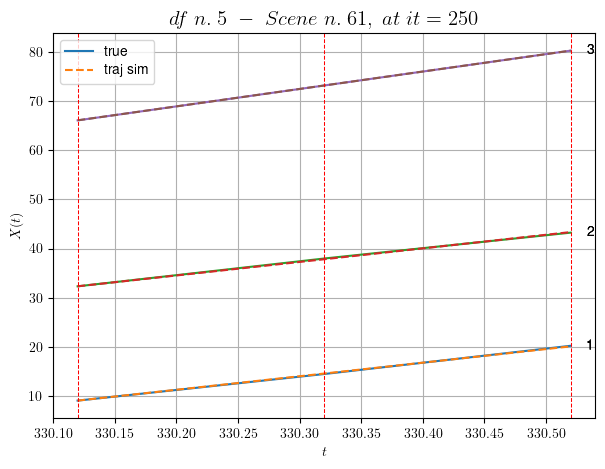

----------------------------------------------------------------------------------------------------
        For scene 40/44:
        * After LR finder: LR_NN=0.01 with mse=0.6737377562750488 at it=24
        * v0 = 35.47750160162572
        * MSE = 0.006672862124100019
        * iterations = 250
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.41/44
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [78.72,79.32]


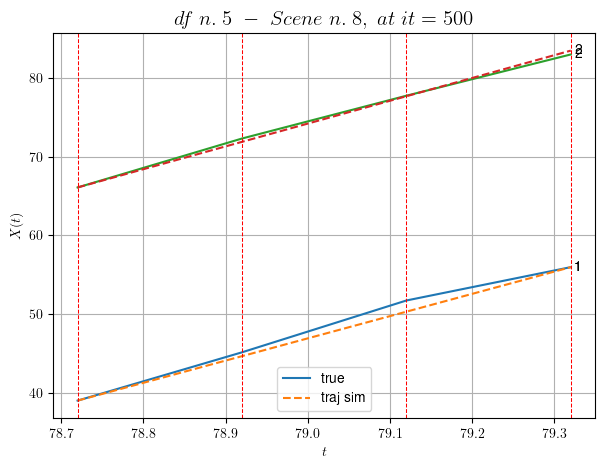

----------------------------------------------------------------------------------------------------
        For scene 41/44:
        * After LR finder: LR_NN=0.0001 with mse=0.6058659510881776 at it=24
        * v0 = 28.965407295611083
        * MSE = 0.33422325525512775
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.42/44
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [449.12,450.12]


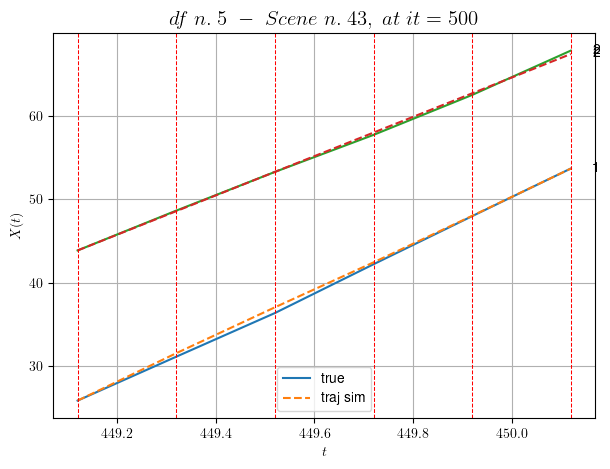

----------------------------------------------------------------------------------------------------
        For scene 42/44:
        * After LR finder: LR_NN=0.01 with mse=7.630633388305081 at it=24
        * v0 = 23.527604275732468
        * MSE = 0.06089881340006306
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.43/44
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [149.92,150.72]


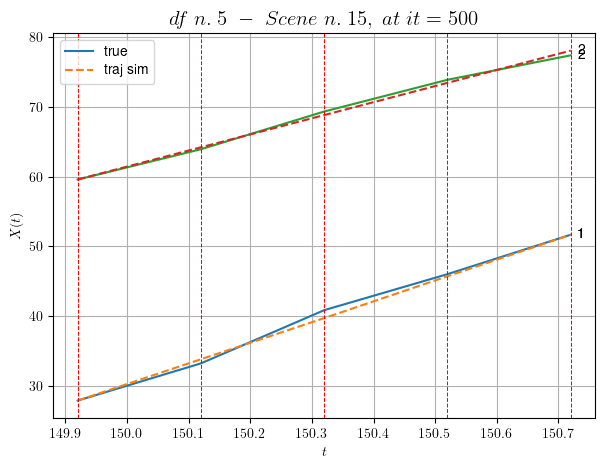

----------------------------------------------------------------------------------------------------
        For scene 43/44:
        * After LR finder: LR_NN=0.001 with mse=6.177192871050818 at it=24
        * v0 = 23.102993584361517
        * MSE = 0.26976932170603507
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.44/44
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [535.32,535.92]


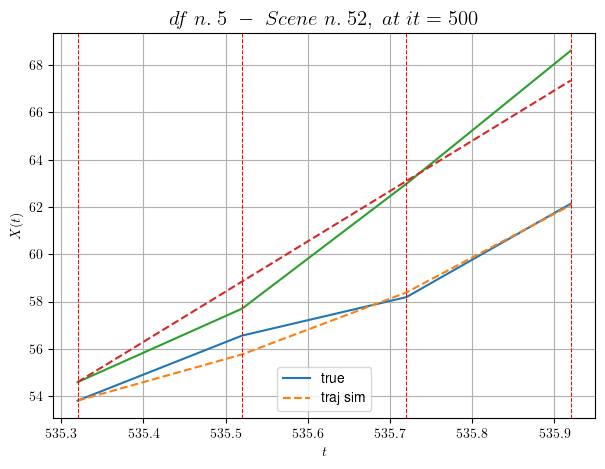

----------------------------------------------------------------------------------------------------
        For scene 44/44:
        * After LR finder: LR_NN=0.005 with mse=4.7624441372449375 at it=24
        * v0 = 21.278077520483933
        * MSE = 0.42713701147098443
        * iterations = 500
----------------------------------------------------------------------------------------------------


MSE train: 0.42744397558018626
- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -

Testing step. (22 scenes)
DataFrame n.5. Scene n.1/22


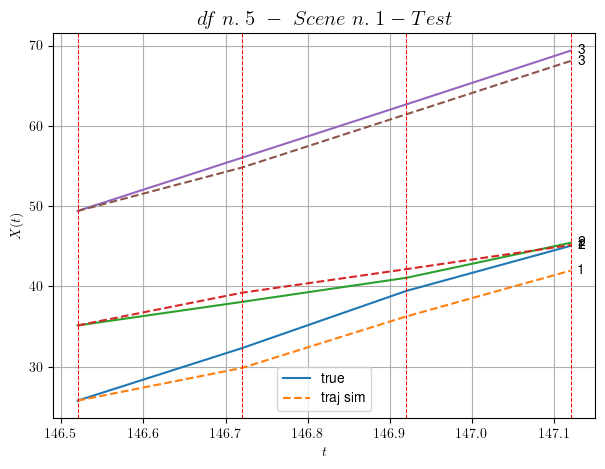

        For scene 1/22:
        * MSE = 2.746016785417455
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.2/22


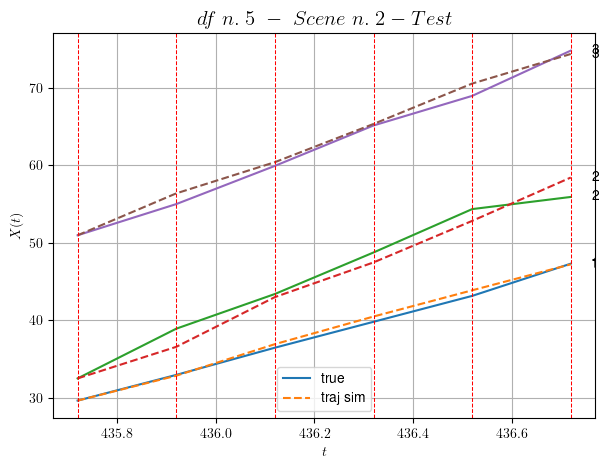

        For scene 2/22:
        * MSE = 1.2231956741353818
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.3/22


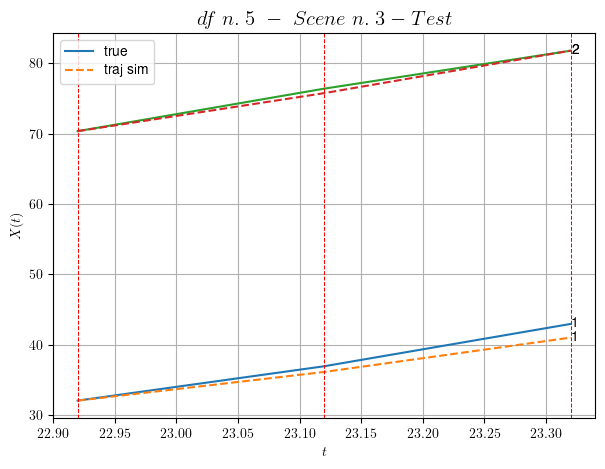

        For scene 3/22:
        * MSE = 0.8087624070658889
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.4/22


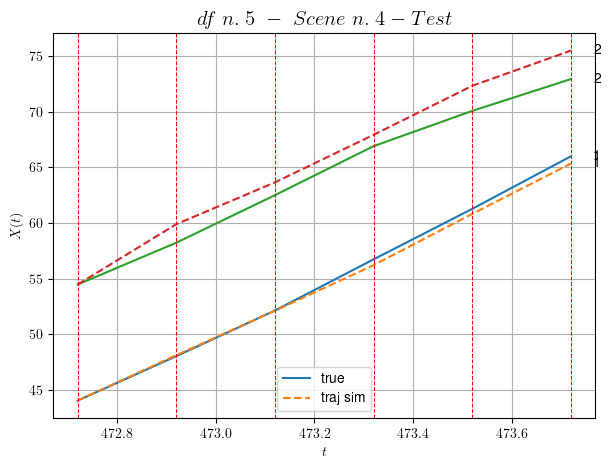

        For scene 4/22:
        * MSE = 1.4669804207722785
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.5/22


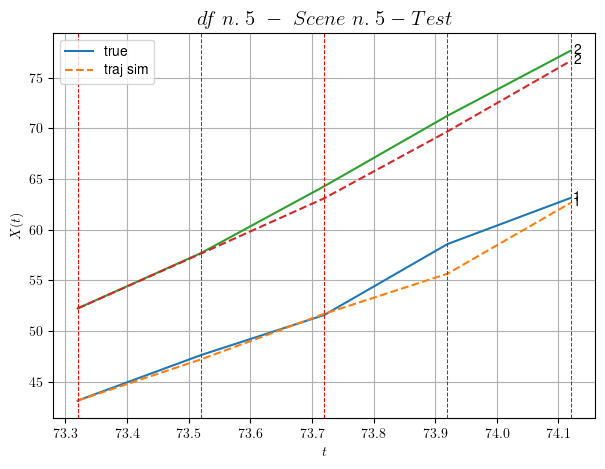

        For scene 5/22:
        * MSE = 1.3800430209301346
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.6/22


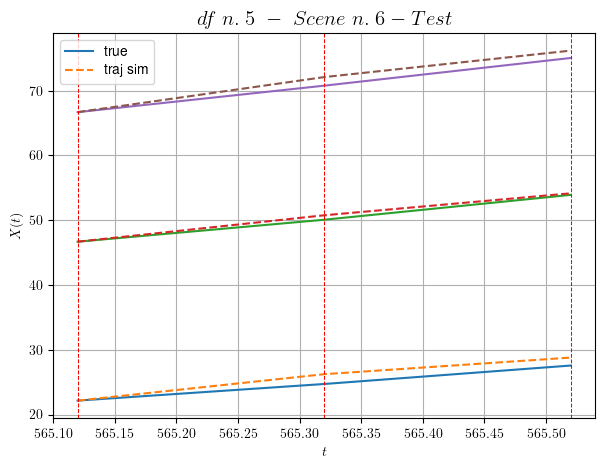

        For scene 6/22:
        * MSE = 0.8187738511070739
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.7/22


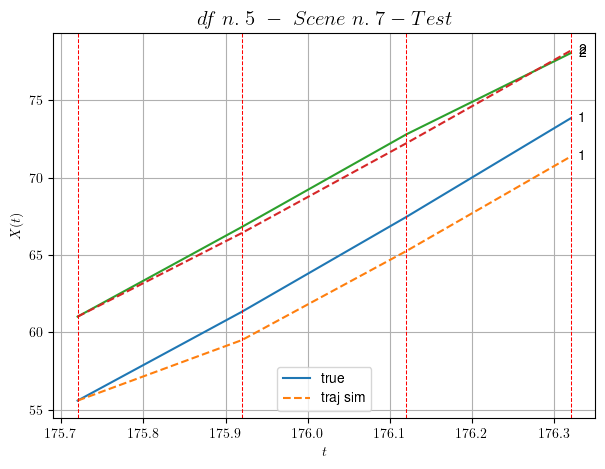

        For scene 7/22:
        * MSE = 1.8583561122886243
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.8/22


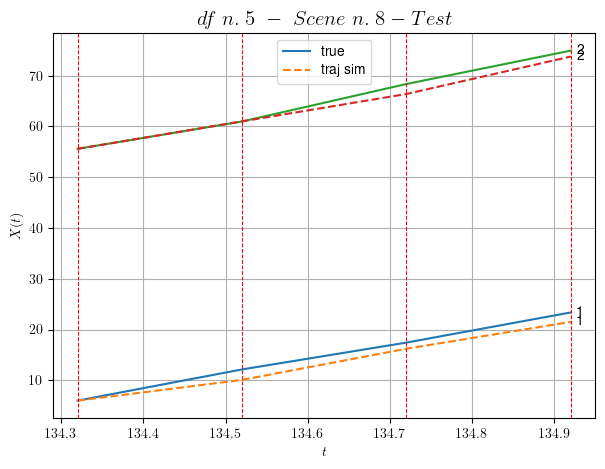

        For scene 8/22:
        * MSE = 1.797800690283079
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.9/22


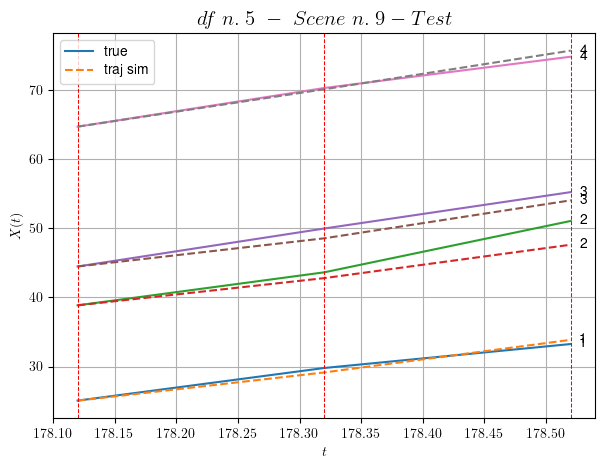

        For scene 9/22:
        * MSE = 1.4625770567177427
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.10/22


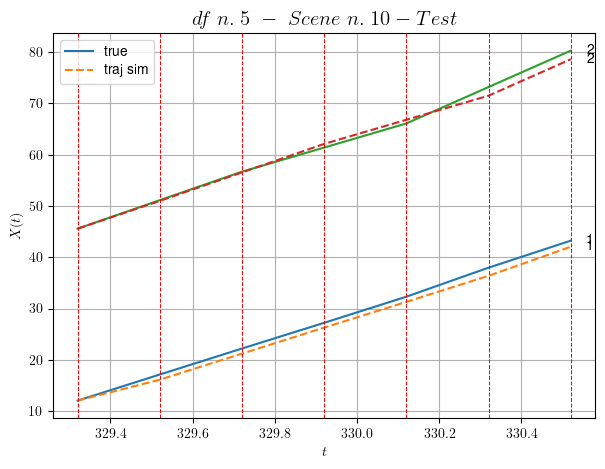

        For scene 10/22:
        * MSE = 1.0371781232130644
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.11/22


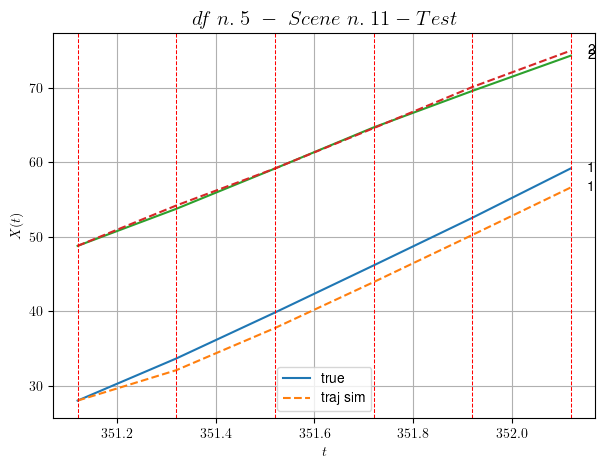

        For scene 11/22:
        * MSE = 2.048762135022899
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.12/22


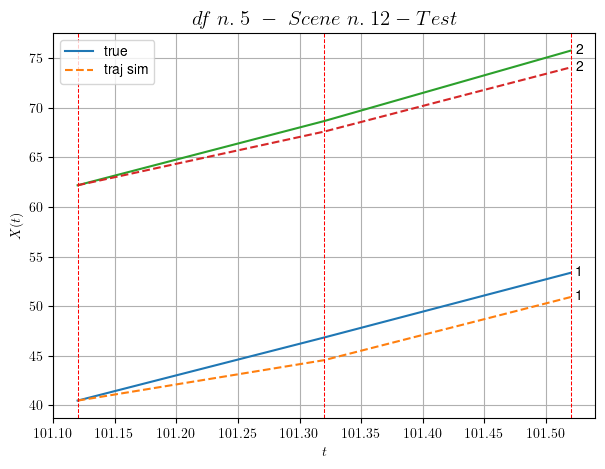

        For scene 12/22:
        * MSE = 2.529137341407103
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.13/22


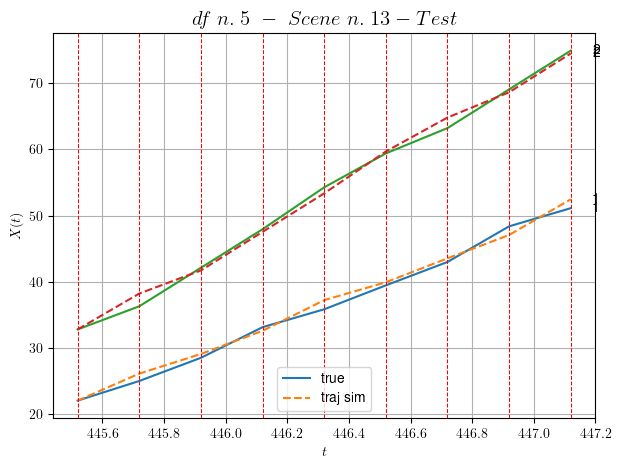

        For scene 13/22:
        * MSE = 0.867085948376501
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.14/22


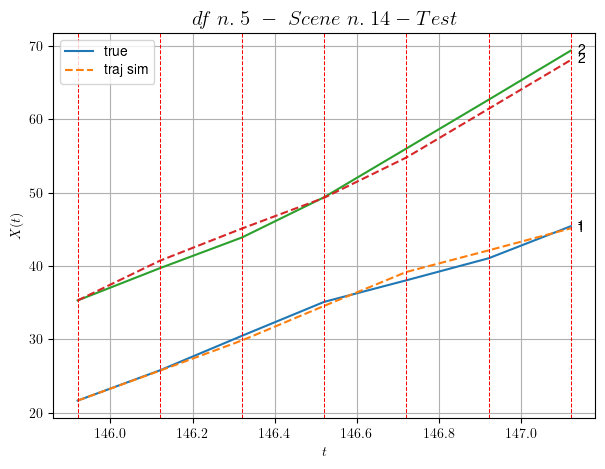

        For scene 14/22:
        * MSE = 0.7458200811730522
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.15/22


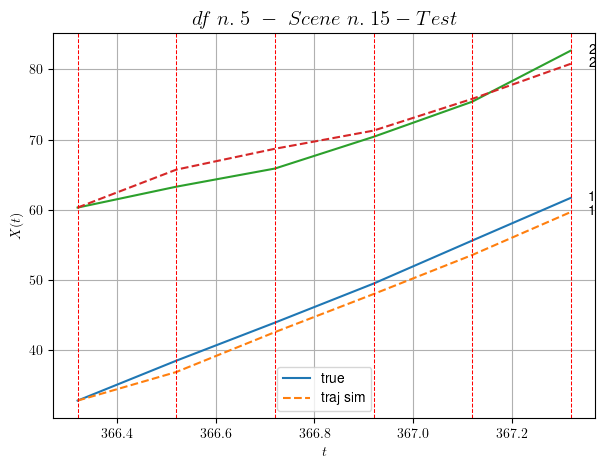

        For scene 15/22:
        * MSE = 2.77953042391211
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.16/22


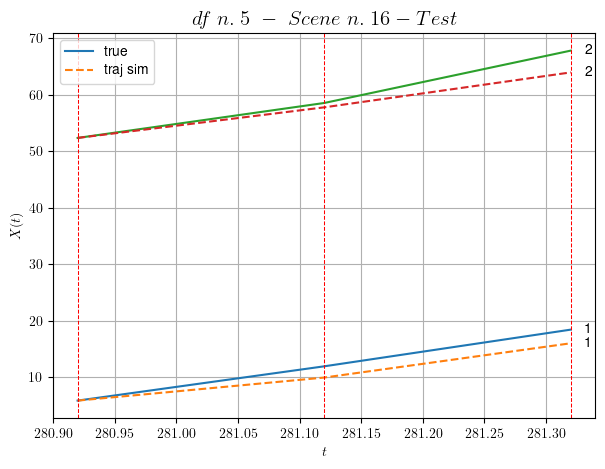

        For scene 16/22:
        * MSE = 4.203279535424609
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.17/22


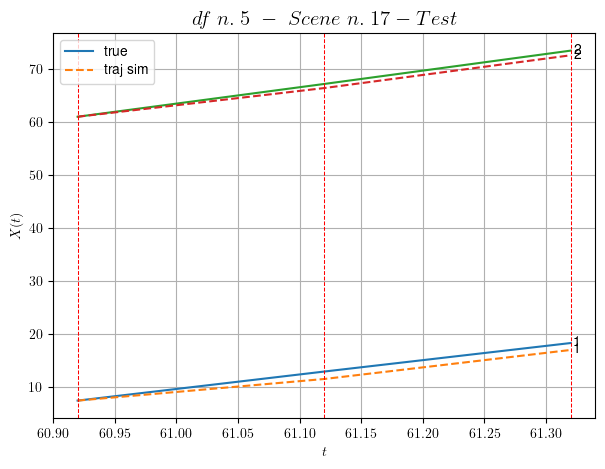

        For scene 17/22:
        * MSE = 0.8417634323341098
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.18/22


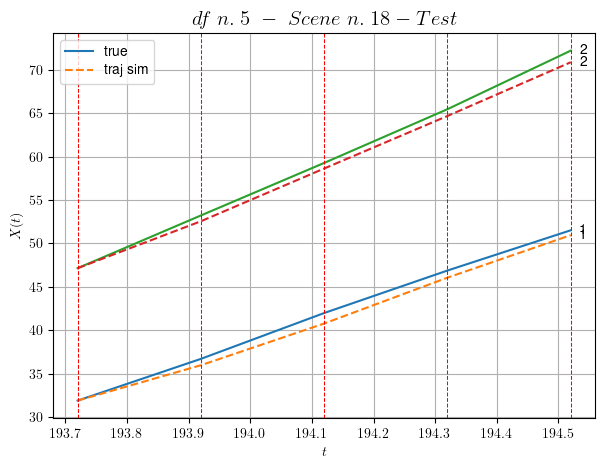

        For scene 18/22:
        * MSE = 0.6251672473501773
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.19/22


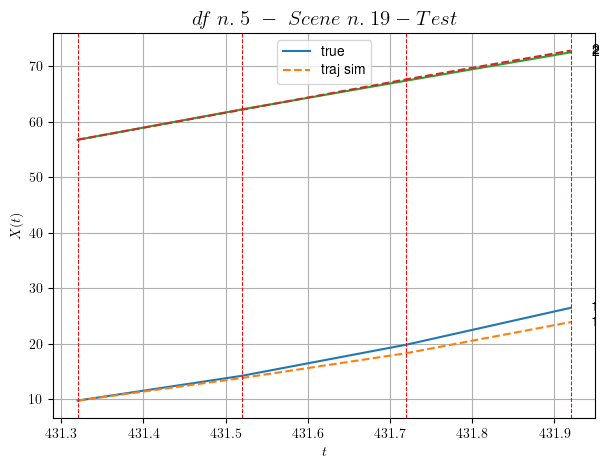

        For scene 19/22:
        * MSE = 1.1564384407536457
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.20/22


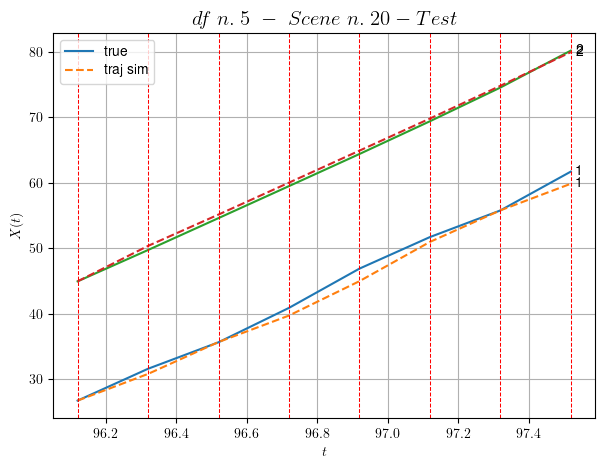

        For scene 20/22:
        * MSE = 0.6977194190665824
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.21/22


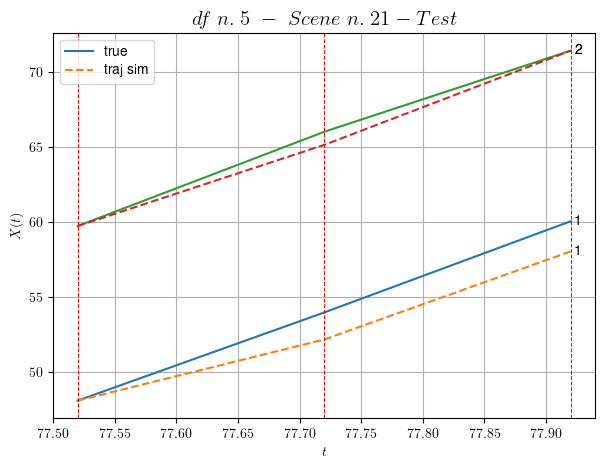

        For scene 21/22:
        * MSE = 1.343402581582607
----------------------------------------------------------------------------------------------------


DataFrame n.5. Scene n.22/22


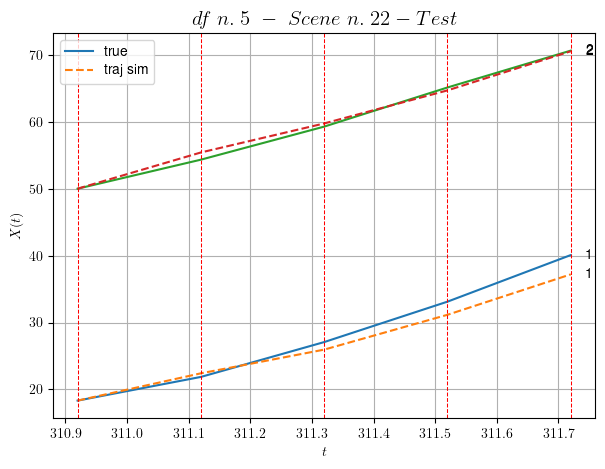

        For scene 22/22:
        * MSE = 1.5301672126641856
----------------------------------------------------------------------------------------------------


MSE test: 1.543998088227196

- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -

    Summing up:
          * MSE train: 0.42744397558018626
          * MSE test: 1.543998088227196
          
- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -




Analyzing 6/10 dfs.
In DataFrame n.6 we have 52 scenes.
    To train the model we use 34 scenes, the remaining 18 to test the model.

Training step. (34 scenes)
DataFrame n.6. Scene n.1/34
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [530.40,530.80]


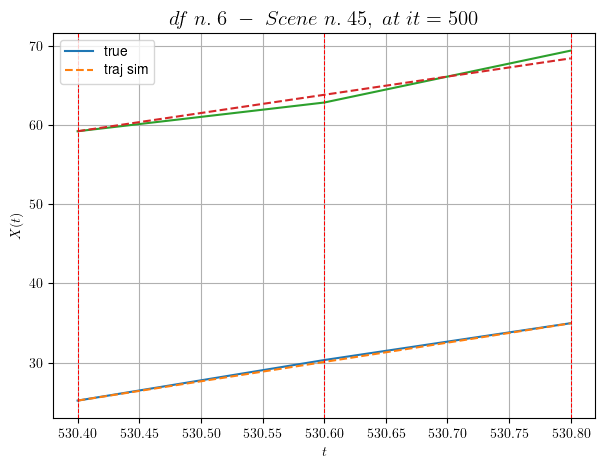

----------------------------------------------------------------------------------------------------
        For scene 1/34:
        * After LR finder: LR_NN=5e-05 with mse=1.501828987693839 at it=24
        * v0 = 22.991928031470238
        * MSE = 0.32723265660790735
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.2/34
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [446.80,447.80]


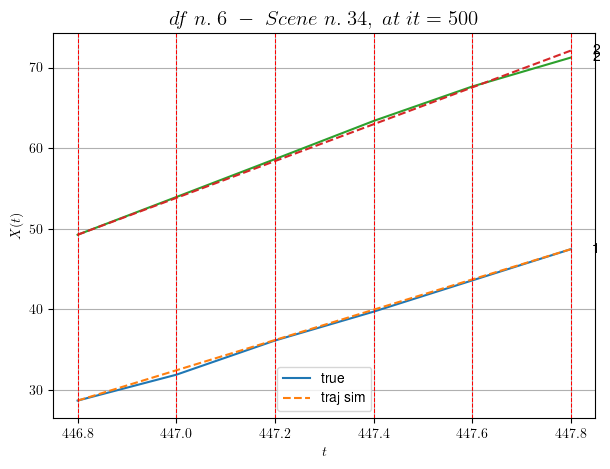

----------------------------------------------------------------------------------------------------
        For scene 2/34:
        * After LR finder: LR_NN=5e-05 with mse=9.994423347088057 at it=24
        * v0 = 22.84148292526661
        * MSE = 0.11387215370943643
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.3/34
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [552.20,552.80]


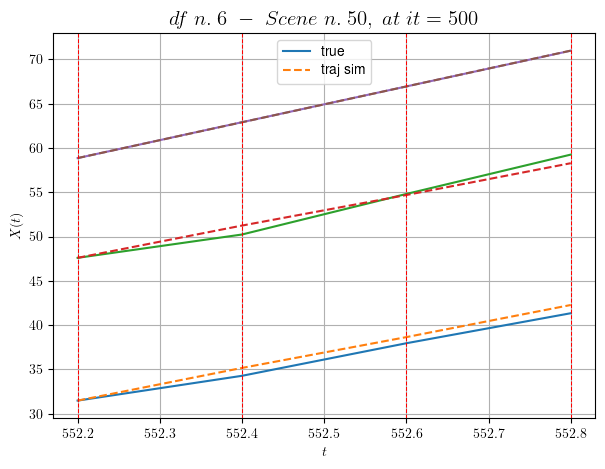

----------------------------------------------------------------------------------------------------
        For scene 3/34:
        * After LR finder: LR_NN=0.005 with mse=4.79569388869188 at it=24
        * v0 = 20.233205039552168
        * MSE = 0.336698857911819
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.4/34
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [195.80,196.80]


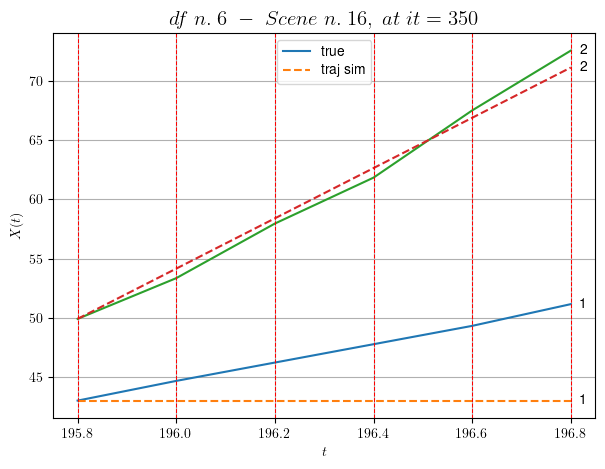

----------------------------------------------------------------------------------------------------
        For scene 4/34:
        * After LR finder: LR_NN=0.01 with mse=12.797044993168086 at it=24
        * v0 = 21.23734758802306
        * MSE = 12.126781763834616
        * iterations = 350
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.5/34
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [129.80,130.20]


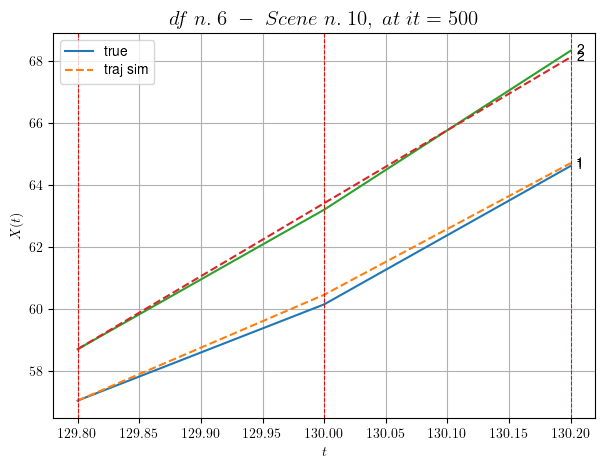

----------------------------------------------------------------------------------------------------
        For scene 5/34:
        * After LR finder: LR_NN=0.001 with mse=1.2960461654059048 at it=24
        * v0 = 23.60183293107532
        * MSE = 0.032225225991116664
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.6/34
----------------------------------------------------------------------------------------------------
We have 9 time intervals inside [204.40,206.20]


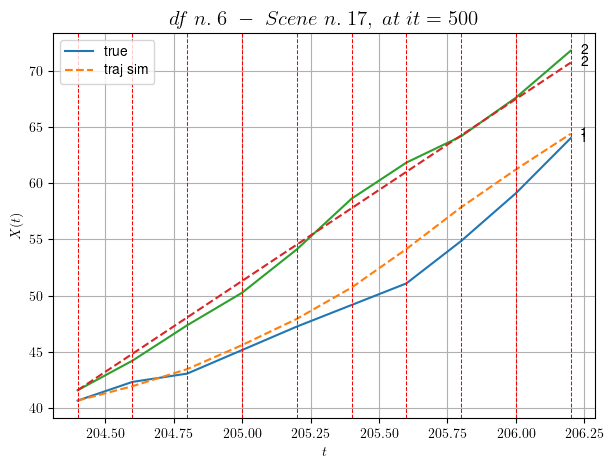

----------------------------------------------------------------------------------------------------
        For scene 6/34:
        * After LR finder: LR_NN=0.0001 with mse=106.04566948633233 at it=24
        * v0 = 16.18607059494903
        * MSE = 1.5490748778619496
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.7/34
----------------------------------------------------------------------------------------------------
We have 6 time intervals inside [396.40,397.60]


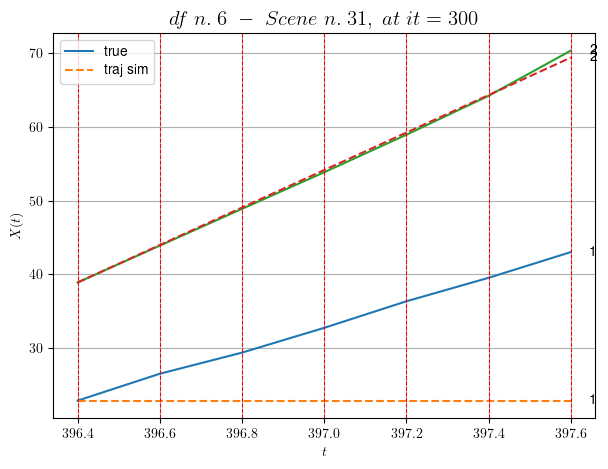

----------------------------------------------------------------------------------------------------
        For scene 7/34:
        * After LR finder: LR_NN=0.005 with mse=5.177805289557806 at it=24
        * v0 = 25.42985106742265
        * MSE = 37.66281161537065
        * iterations = 300
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.8/34
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [458.00,458.40]


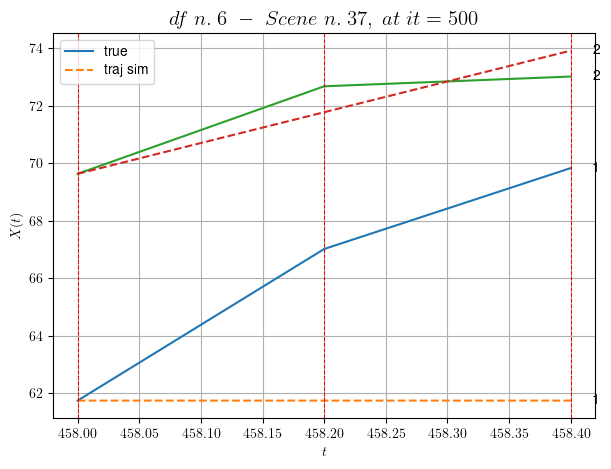

----------------------------------------------------------------------------------------------------
        For scene 8/34:
        * After LR finder: LR_NN=0.001 with mse=14.196627335655652 at it=24
        * v0 = 10.716650123126138
        * MSE = 15.819156646215507
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.9/34
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [296.40,296.80]


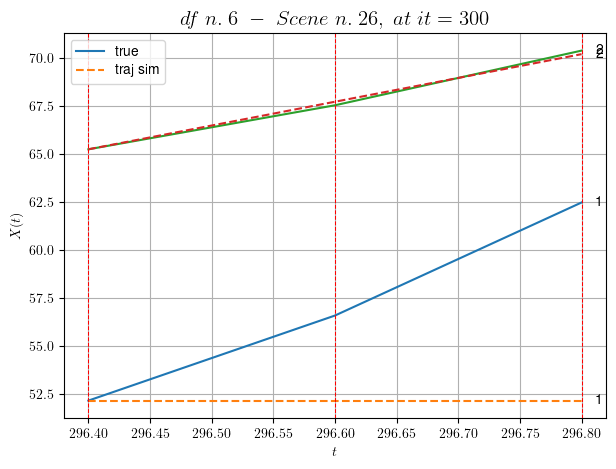

----------------------------------------------------------------------------------------------------
        For scene 9/34:
        * After LR finder: LR_NN=5e-05 with mse=10.411658990894681 at it=24
        * v0 = 12.39941633333855
        * MSE = 21.06067727072814
        * iterations = 300
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.10/34
----------------------------------------------------------------------------------------------------
We have 6 time intervals inside [134.00,135.20]


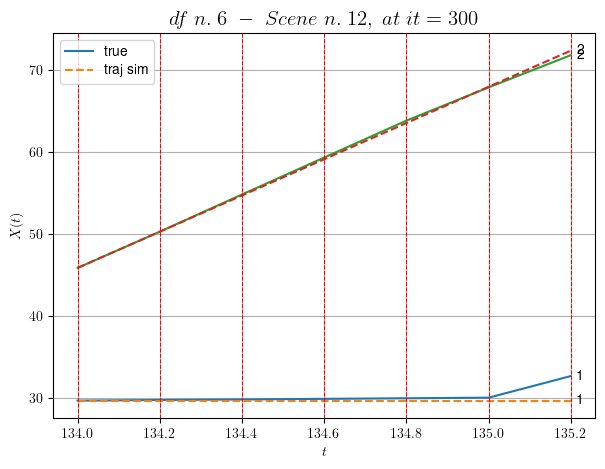

----------------------------------------------------------------------------------------------------
        For scene 10/34:
        * After LR finder: LR_NN=1e-05 with mse=17.029753245440524 at it=24
        * v0 = 22.063234069263405
        * MSE = 0.6914228963664447
        * iterations = 300
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.11/34
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [14.80,15.60]


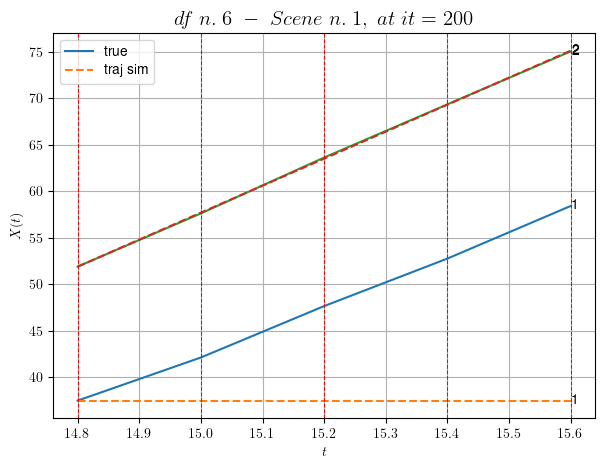

----------------------------------------------------------------------------------------------------
        For scene 11/34:
        * After LR finder: LR_NN=5e-05 with mse=0.11953605667163553 at it=24
        * v0 = 29.05713292292848
        * MSE = 79.74911773721331
        * iterations = 200
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.12/34
----------------------------------------------------------------------------------------------------
We have 8 time intervals inside [576.00,577.60]


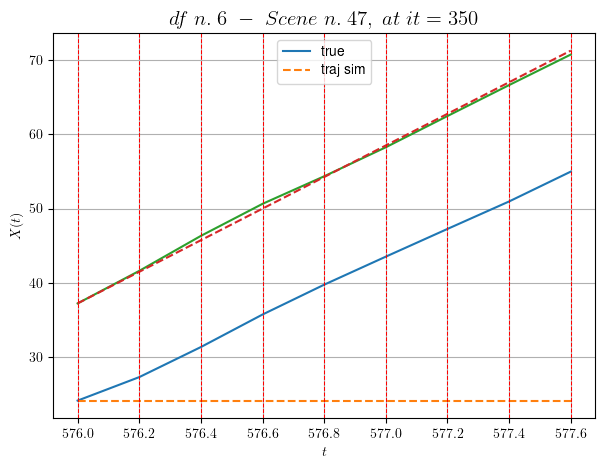

----------------------------------------------------------------------------------------------------
        For scene 12/34:
        * After LR finder: LR_NN=0.0005 with mse=35.62981448392343 at it=24
        * v0 = 21.301030766395836
        * MSE = 168.29369603134353
        * iterations = 350
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.13/34
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [359.20,359.60]


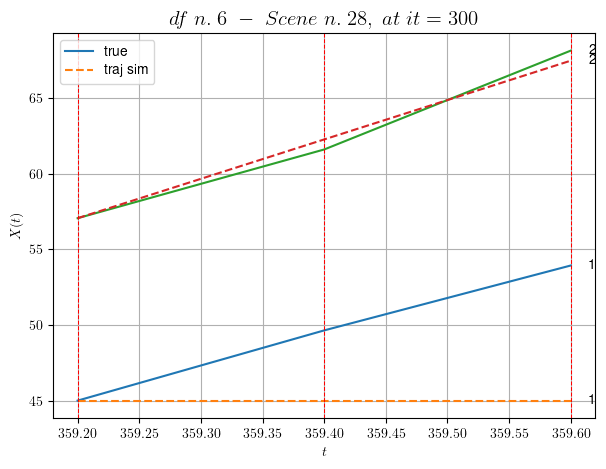

----------------------------------------------------------------------------------------------------
        For scene 13/34:
        * After LR finder: LR_NN=0.0001 with mse=0.5003715822630103 at it=24
        * v0 = 26.036962679722613
        * MSE = 17.022034269071714
        * iterations = 300
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.14/34
----------------------------------------------------------------------------------------------------
We have 7 time intervals inside [407.80,409.20]


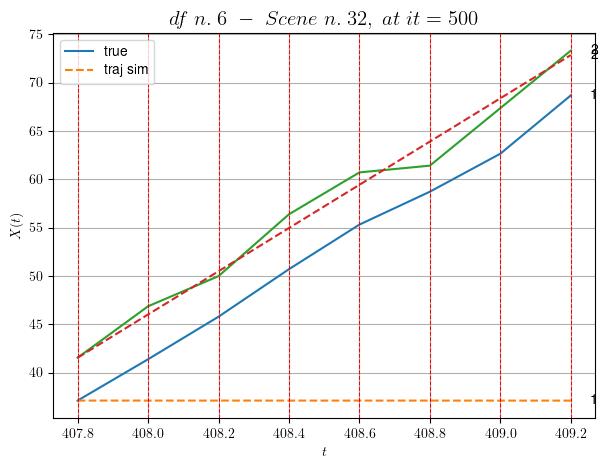

----------------------------------------------------------------------------------------------------
        For scene 14/34:
        * After LR finder: LR_NN=5e-05 with mse=22.633253860433776 at it=24
        * v0 = 22.363716298521343
        * MSE = 171.16821873330196
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.15/34
----------------------------------------------------------------------------------------------------
We have 6 time intervals inside [467.00,468.20]


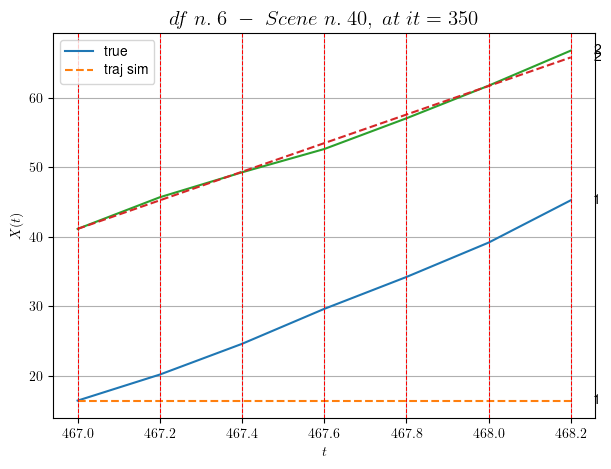

----------------------------------------------------------------------------------------------------
        For scene 15/34:
        * After LR finder: LR_NN=0.01 with mse=23.661668533042967 at it=24
        * v0 = 20.547439360583393
        * MSE = 137.04289344559064
        * iterations = 350
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.16/34
----------------------------------------------------------------------------------------------------
We have 8 time intervals inside [374.40,376.00]


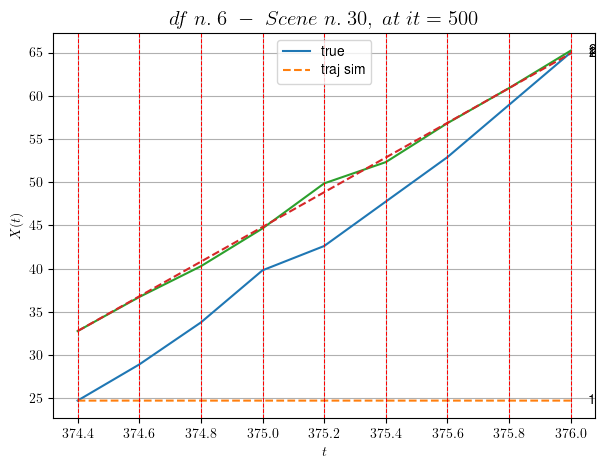

----------------------------------------------------------------------------------------------------
        For scene 16/34:
        * After LR finder: LR_NN=0.001 with mse=44.88171158250875 at it=24
        * v0 = 20.073696885977988
        * MSE = 264.5667431595581
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.17/34
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [551.40,552.00]


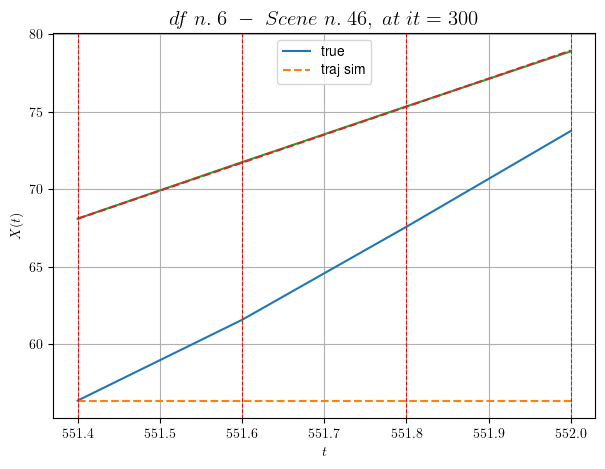

----------------------------------------------------------------------------------------------------
        For scene 17/34:
        * After LR finder: LR_NN=0.01 with mse=10.08360975802144 at it=24
        * v0 = 18.10266114839419
        * MSE = 57.10081660852134
        * iterations = 300
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.18/34
----------------------------------------------------------------------------------------------------
We have 9 time intervals inside [24.60,26.40]


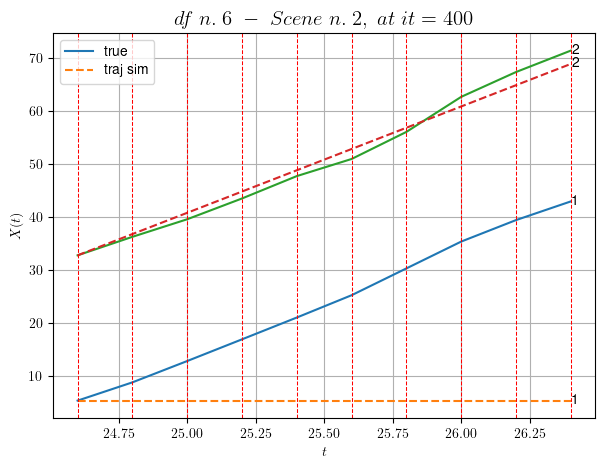

----------------------------------------------------------------------------------------------------
        For scene 18/34:
        * After LR finder: LR_NN=0.01 with mse=51.855137305655255 at it=24
        * v0 = 20.07254373855542
        * MSE = 248.22591175450117
        * iterations = 400
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.19/34
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [236.20,237.00]


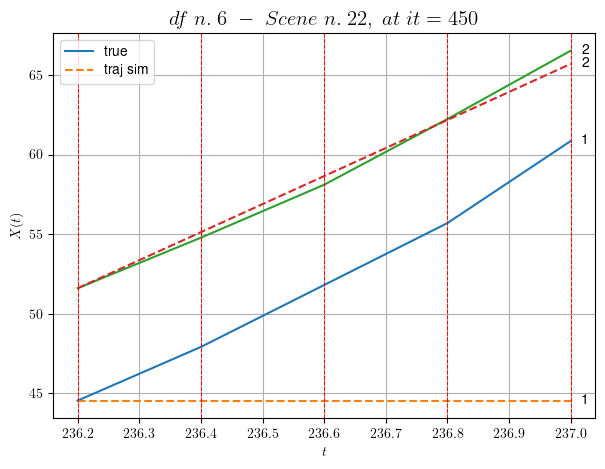

----------------------------------------------------------------------------------------------------
        For scene 19/34:
        * After LR finder: LR_NN=0.005 with mse=17.800064743055316 at it=24
        * v0 = 17.63413097572419
        * MSE = 45.64282149648309
        * iterations = 450
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.20/34
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [29.80,30.80]


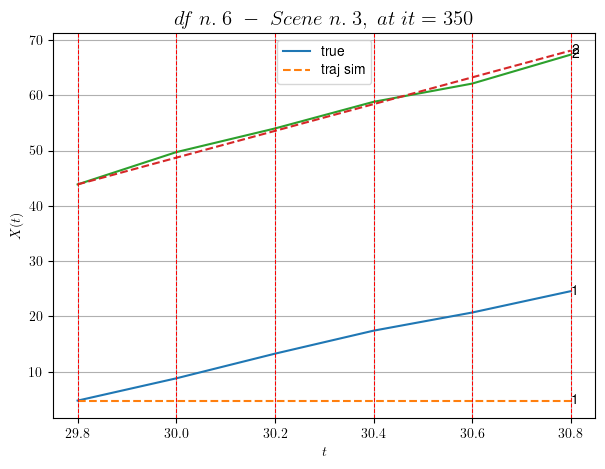

----------------------------------------------------------------------------------------------------
        For scene 20/34:
        * After LR finder: LR_NN=0.01 with mse=7.476413266911821 at it=24
        * v0 = 24.207929143818735
        * MSE = 74.79455734398798
        * iterations = 350
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.21/34
----------------------------------------------------------------------------------------------------
We have 10 time intervals inside [477.80,479.80]


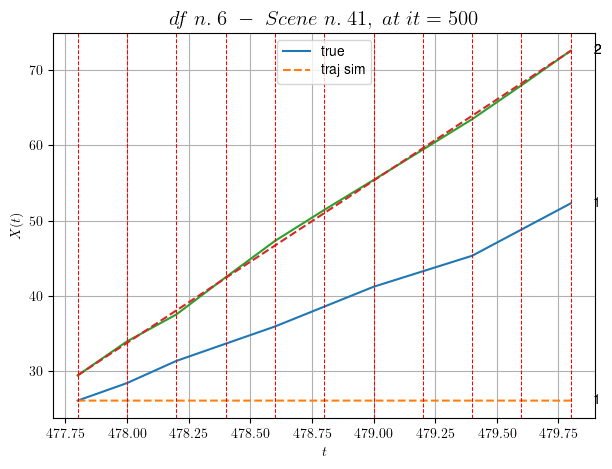

----------------------------------------------------------------------------------------------------
        For scene 21/34:
        * After LR finder: LR_NN=0.005 with mse=50.31768329865072 at it=24
        * v0 = 21.601430911083135
        * MSE = 111.41869757484312
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.22/34
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [450.60,451.20]


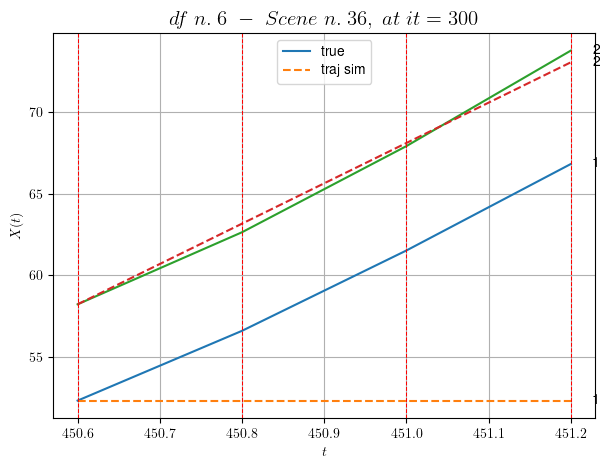

----------------------------------------------------------------------------------------------------
        For scene 22/34:
        * After LR finder: LR_NN=0.001 with mse=1.7829144168570021 at it=24
        * v0 = 24.707839283039405
        * MSE = 39.20975604690239
        * iterations = 300
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.23/34
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [263.80,264.20]


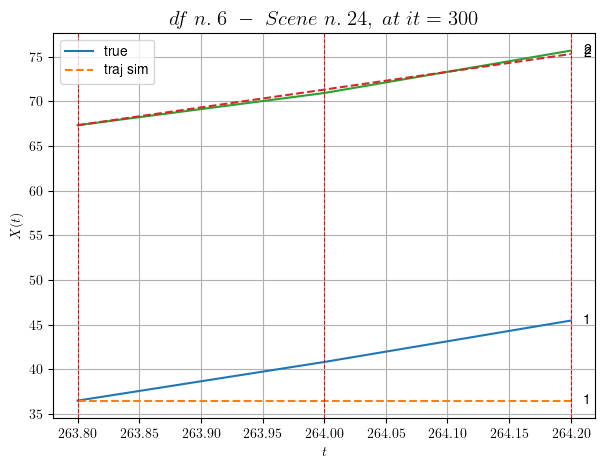

----------------------------------------------------------------------------------------------------
        For scene 23/34:
        * After LR finder: LR_NN=0.005 with mse=3.173803755721484 at it=24
        * v0 = 19.93862625815393
        * MSE = 16.55454463050604
        * iterations = 300
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.24/34
----------------------------------------------------------------------------------------------------
We have 6 time intervals inside [593.40,594.60]


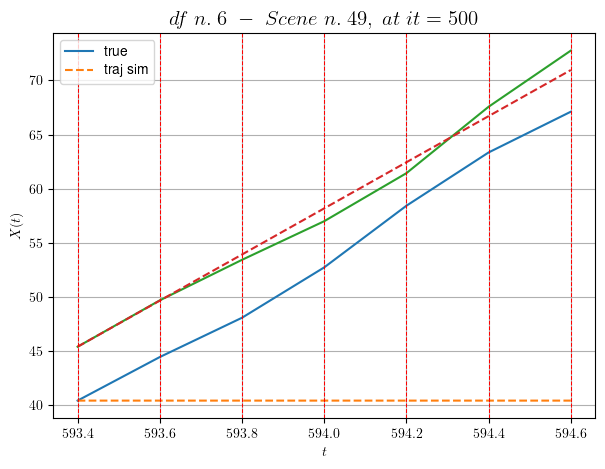

----------------------------------------------------------------------------------------------------
        For scene 24/34:
        * After LR finder: LR_NN=0.005 with mse=18.894482281262196 at it=24
        * v0 = 21.280809908315508
        * MSE = 127.92454503481682
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.25/34
----------------------------------------------------------------------------------------------------
We have 8 time intervals inside [131.80,133.40]


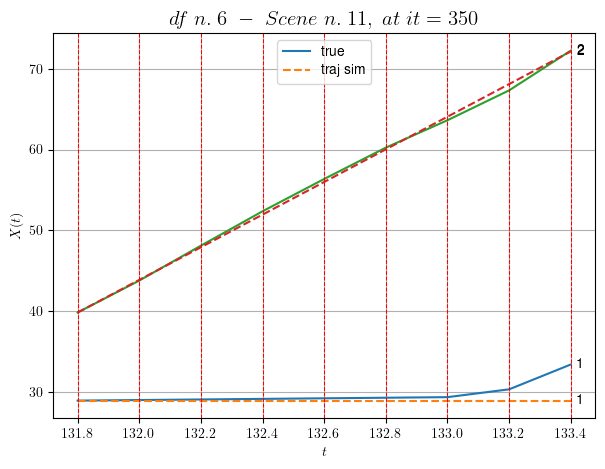

----------------------------------------------------------------------------------------------------
        For scene 25/34:
        * After LR finder: LR_NN=0.005 with mse=44.70836222294621 at it=24
        * v0 = 20.22300048803772
        * MSE = 1.3154186713314986
        * iterations = 350
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.26/34
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [252.60,253.20]


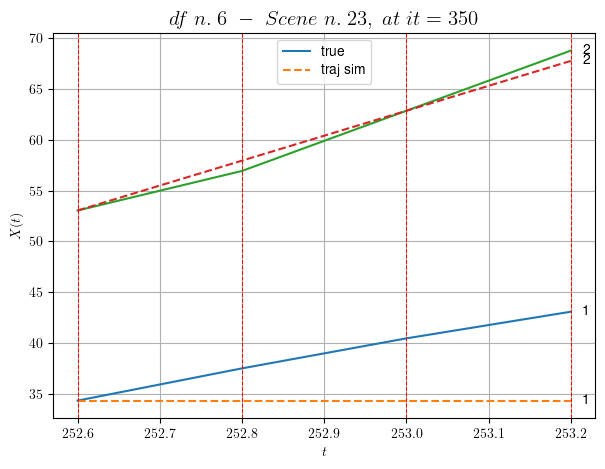

----------------------------------------------------------------------------------------------------
        For scene 26/34:
        * After LR finder: LR_NN=0.005 with mse=1.8337794690997486 at it=24
        * v0 = 24.514205540242504
        * MSE = 15.70699111839428
        * iterations = 350
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.27/34
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [228.80,229.40]


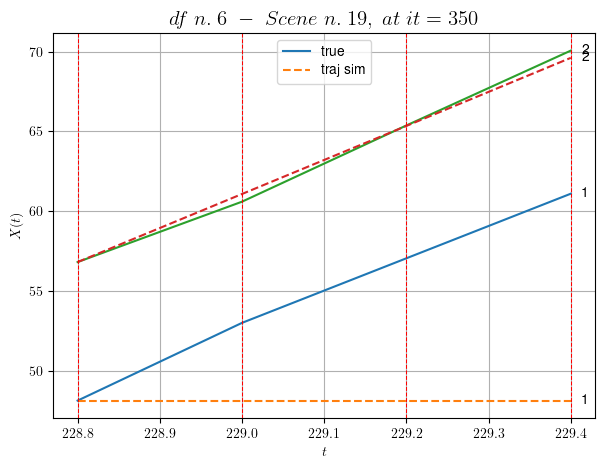

----------------------------------------------------------------------------------------------------
        For scene 27/34:
        * After LR finder: LR_NN=0.001 with mse=4.979948335230168 at it=24
        * v0 = 21.319904979846683
        * MSE = 33.94509179429765
        * iterations = 350
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.28/34
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [554.00,554.40]


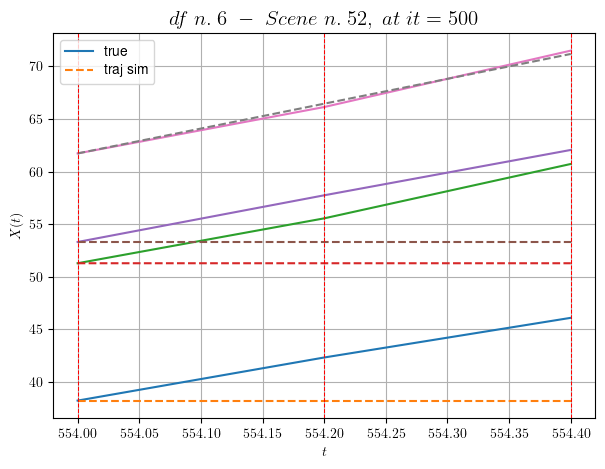

----------------------------------------------------------------------------------------------------
        For scene 28/34:
        * After LR finder: LR_NN=0.01 with mse=0.7340128384494058 at it=24
        * v0 = 23.647050620331452
        * MSE = 23.554245411449113
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.29/34
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [234.00,234.60]


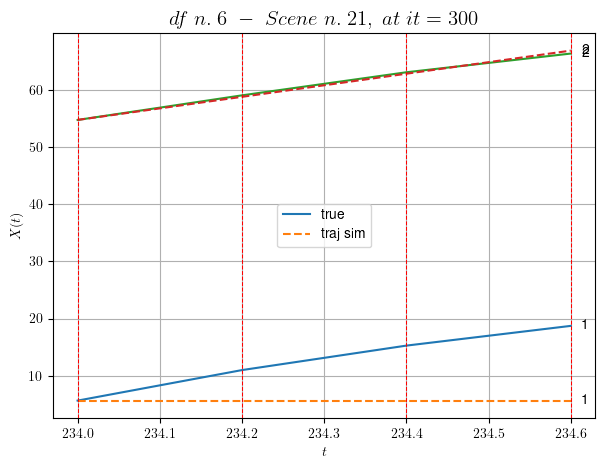

----------------------------------------------------------------------------------------------------
        For scene 29/34:
        * After LR finder: LR_NN=1e-05 with mse=7.373449580486444 at it=24
        * v0 = 20.201368997739912
        * MSE = 36.510009283372106
        * iterations = 300
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.30/34
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [86.60,87.40]


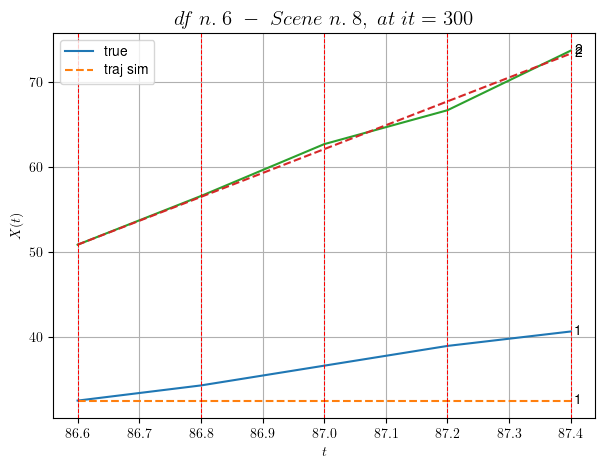

----------------------------------------------------------------------------------------------------
        For scene 30/34:
        * After LR finder: LR_NN=0.005 with mse=0.6122165539146776 at it=24
        * v0 = 28.176915561930645
        * MSE = 12.983827742693276
        * iterations = 300
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.31/34
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [493.80,494.40]


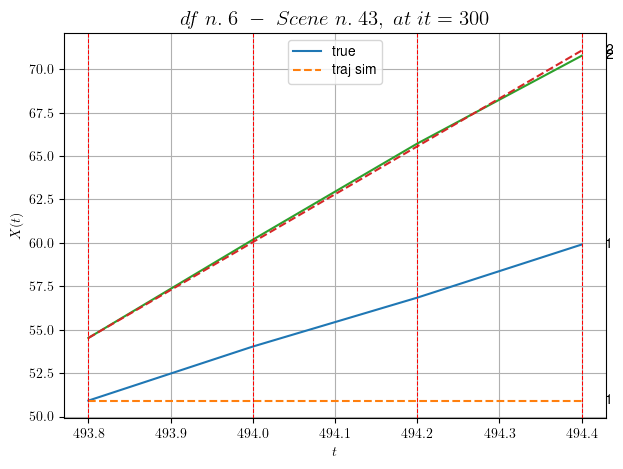

----------------------------------------------------------------------------------------------------
        For scene 31/34:
        * After LR finder: LR_NN=0.005 with mse=0.4843230143021089 at it=24
        * v0 = 27.577028073805153
        * MSE = 15.709501143771302
        * iterations = 300
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.32/34
----------------------------------------------------------------------------------------------------
We have 7 time intervals inside [162.20,163.60]


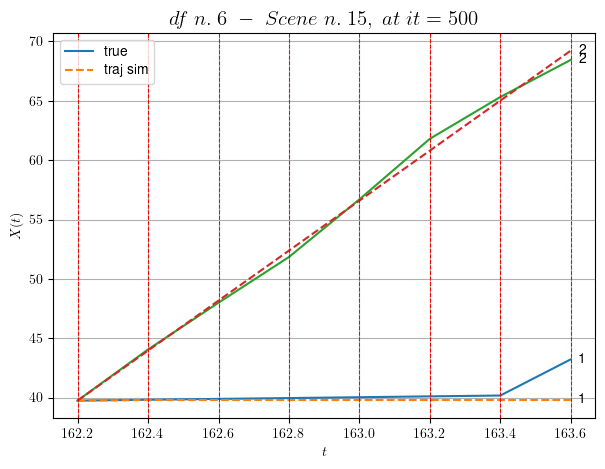

----------------------------------------------------------------------------------------------------
        For scene 32/34:
        * After LR finder: LR_NN=0.01 with mse=28.903249919671126 at it=24
        * v0 = 21.059787487615633
        * MSE = 0.8816965497107004
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.33/34
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [368.20,369.20]


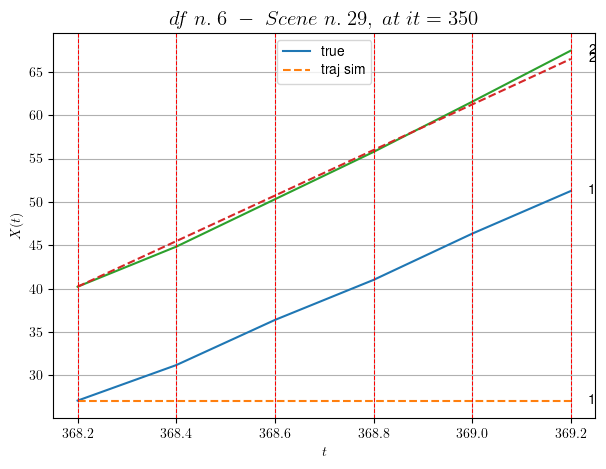

----------------------------------------------------------------------------------------------------
        For scene 33/34:
        * After LR finder: LR_NN=0.0001 with mse=2.2299297984099553 at it=24
        * v0 = 26.26965467684627
        * MSE = 104.49110770376772
        * iterations = 350
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.34/34
----------------------------------------------------------------------------------------------------
We have 6 time intervals inside [465.20,466.40]


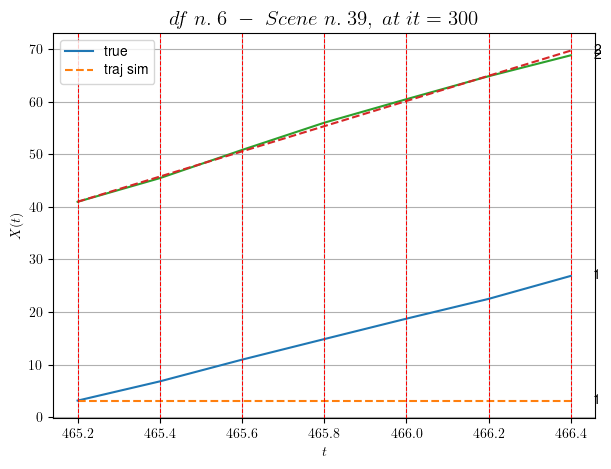

----------------------------------------------------------------------------------------------------
        For scene 34/34:
        * After LR finder: LR_NN=1e-05 with mse=9.993266784233379 at it=24
        * v0 = 23.95696377887453
        * MSE = 99.4160222286852
        * iterations = 300
----------------------------------------------------------------------------------------------------


MSE train: 58.61612410231505
- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -

Testing step. (18 scenes)
DataFrame n.6. Scene n.1/18


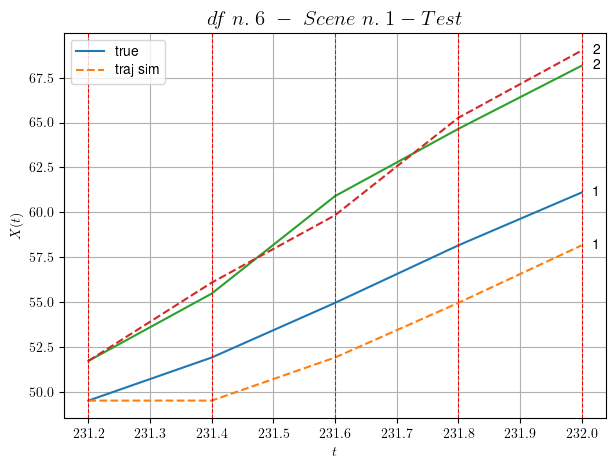

        For scene 1/18:
        * MSE = 3.6576638010525513
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.2/18


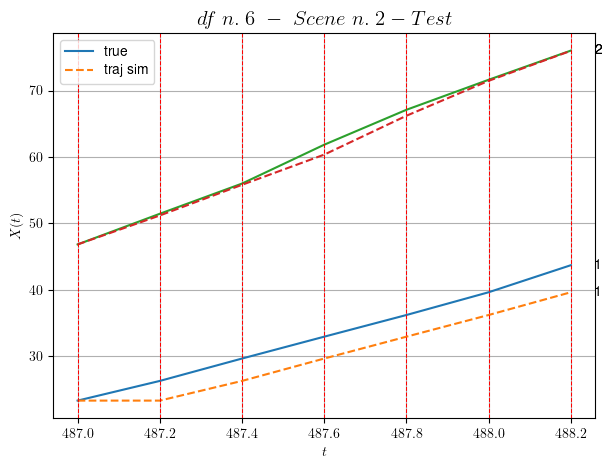

        For scene 2/18:
        * MSE = 5.227586948736201
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.3/18


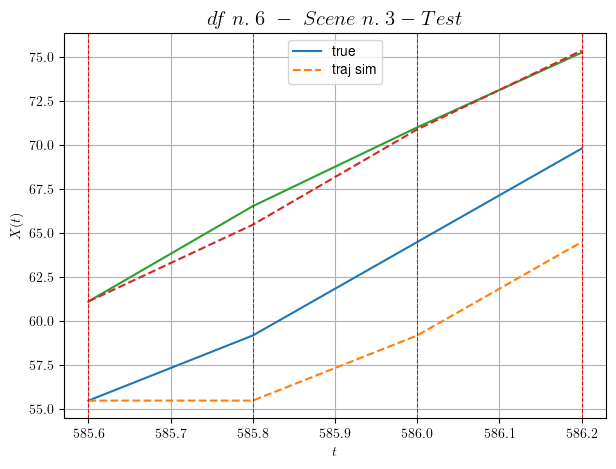

        For scene 3/18:
        * MSE = 8.903695941615318
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.4/18


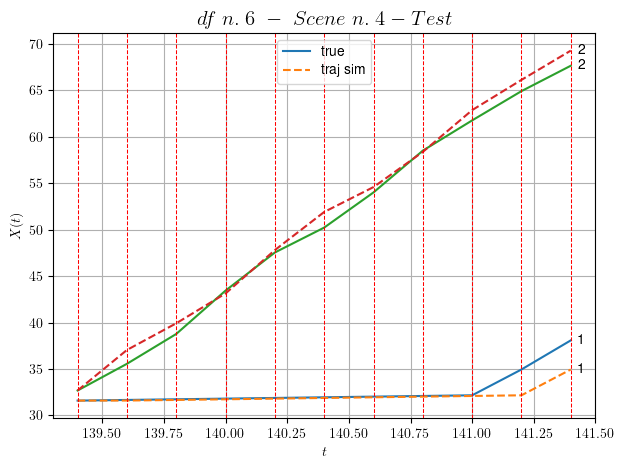

        For scene 4/18:
        * MSE = 1.3548573773421166
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.5/18


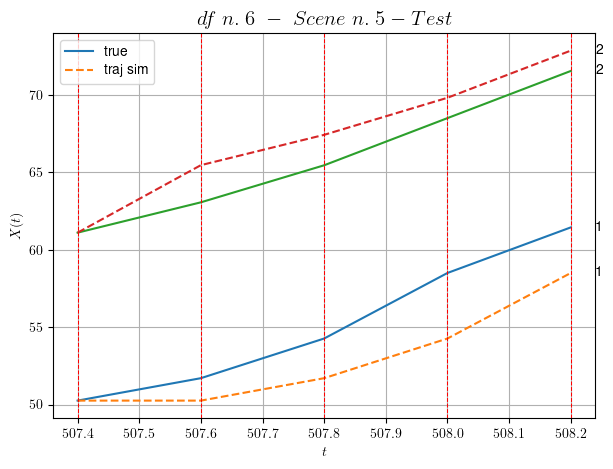

        For scene 5/18:
        * MSE = 4.83891385965225
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.6/18


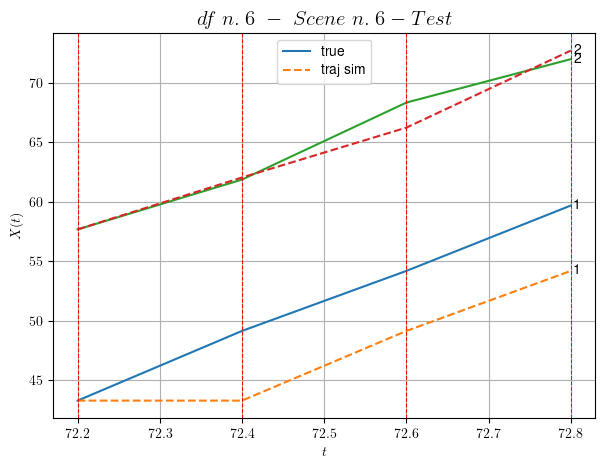

        For scene 6/18:
        * MSE = 11.840028875485377
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.7/18


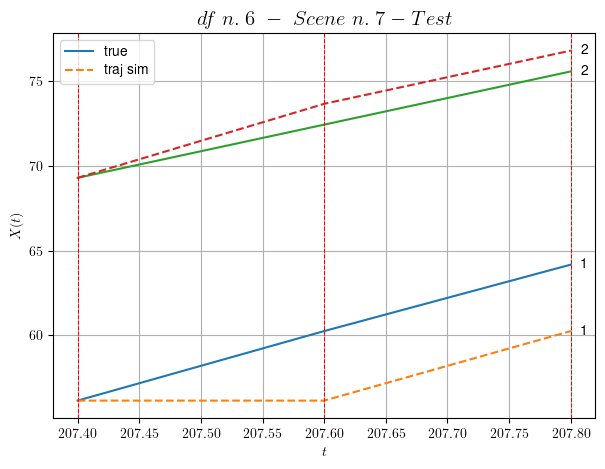

        For scene 7/18:
        * MSE = 5.855958789068772
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.8/18


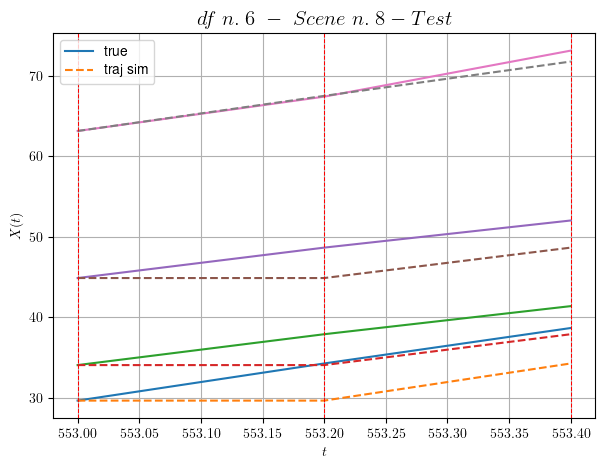

        For scene 8/18:
        * MSE = 7.924630268714804
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.9/18


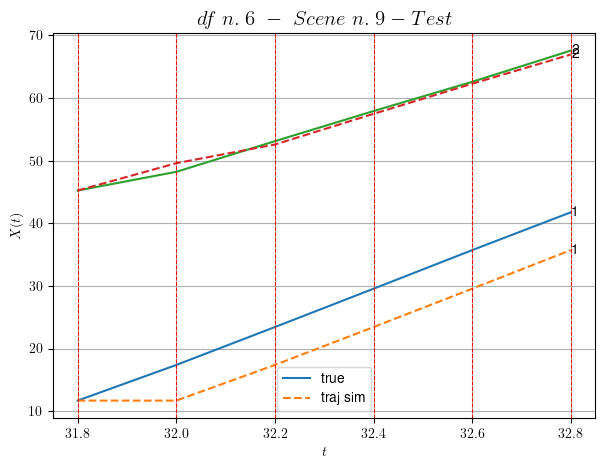

        For scene 9/18:
        * MSE = 15.310443479835739
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.10/18


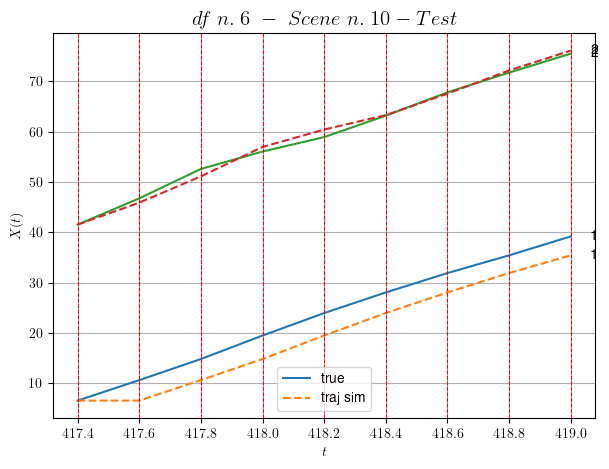

        For scene 10/18:
        * MSE = 7.803124437066321
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.11/18


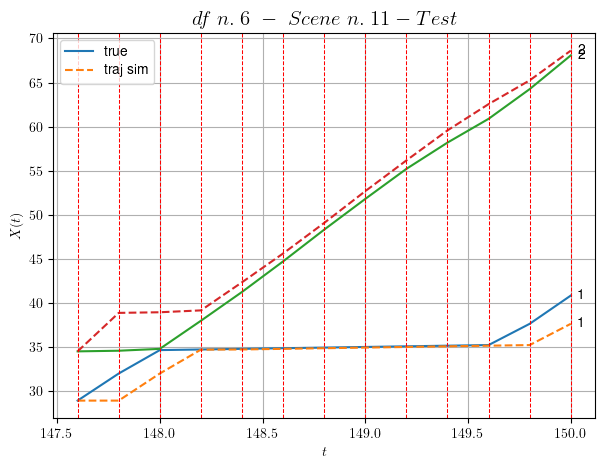

        For scene 11/18:
        * MSE = 3.0712176078571343
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.12/18


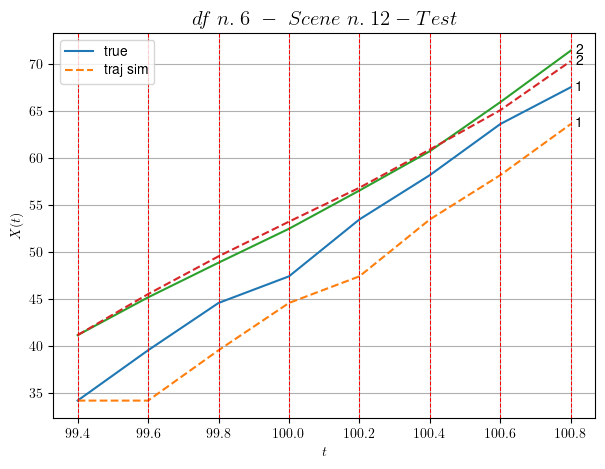

        For scene 12/18:
        * MSE = 10.546353756434037
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.13/18


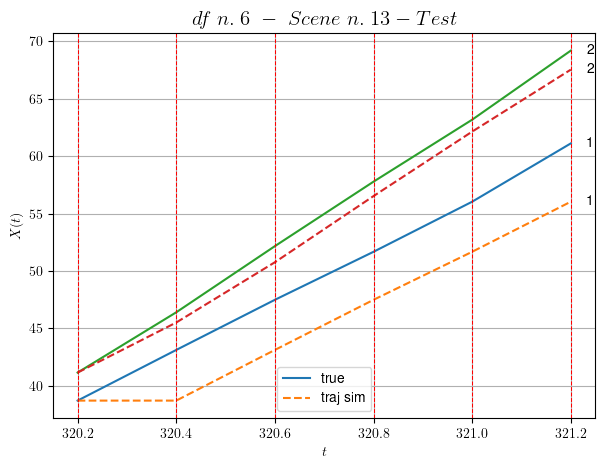

        For scene 13/18:
        * MSE = 9.09344678240492
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.14/18


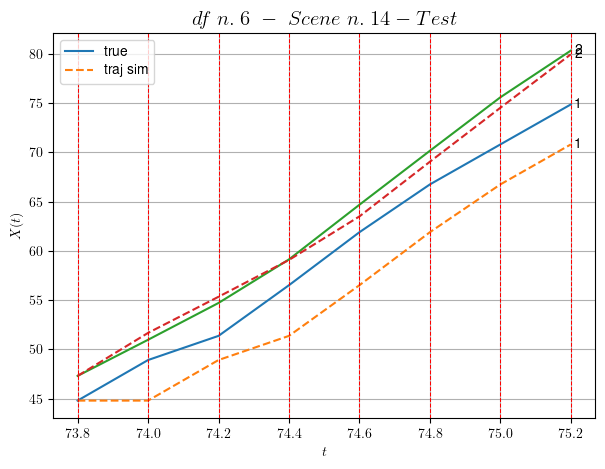

        For scene 14/18:
        * MSE = 8.717750616098796
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.15/18


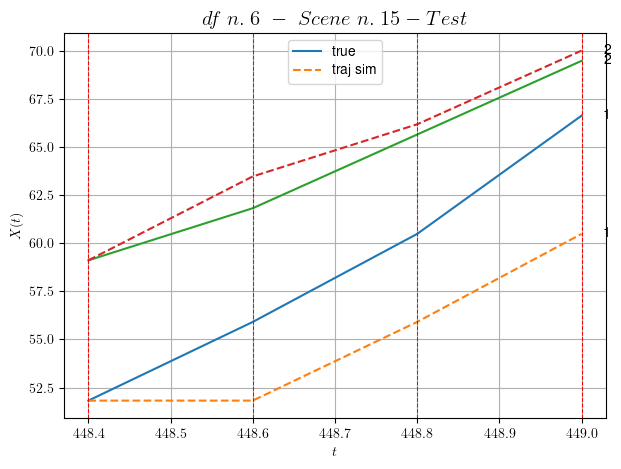

        For scene 15/18:
        * MSE = 9.843329981251724
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.16/18


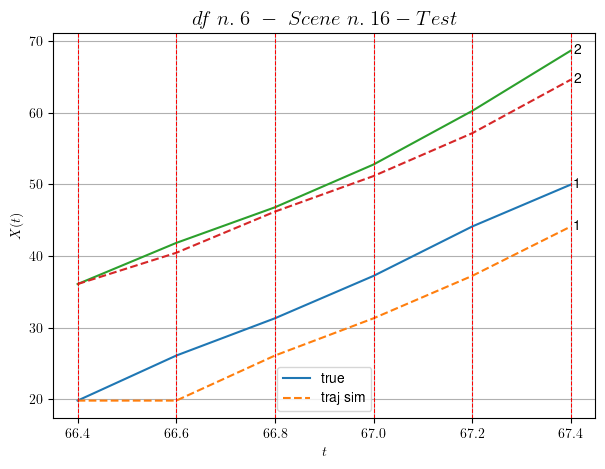

        For scene 16/18:
        * MSE = 17.84334005885013
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.17/18


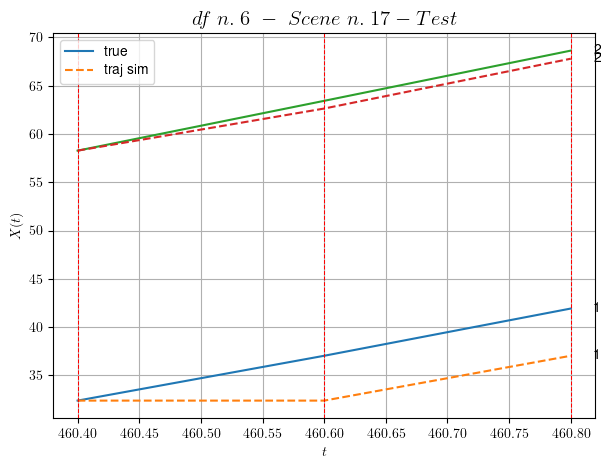

        For scene 17/18:
        * MSE = 7.806773434011033
----------------------------------------------------------------------------------------------------


DataFrame n.6. Scene n.18/18


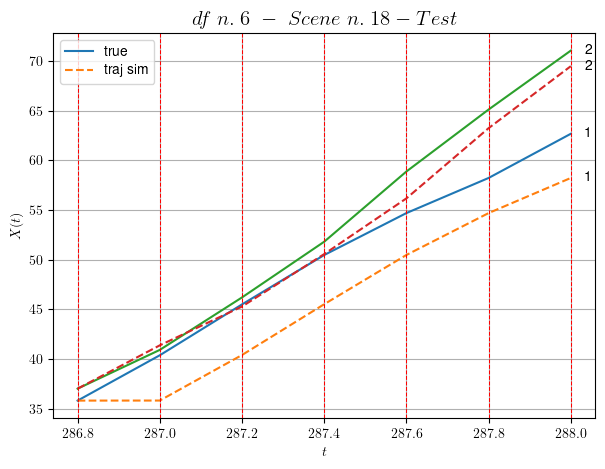

        For scene 18/18:
        * MSE = 9.799241730209484
----------------------------------------------------------------------------------------------------


MSE test: 8.302130985871484

- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -

    Summing up:
          * MSE train: 58.61612410231505
          * MSE test: 8.302130985871484
          
- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -




Analyzing 7/10 dfs.
In DataFrame n.7 we have 30 scenes.
    To train the model we use 20 scenes, the remaining 10 to test the model.

Training step. (20 scenes)
DataFrame n.7. Scene n.1/20
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [60.56,61.56]


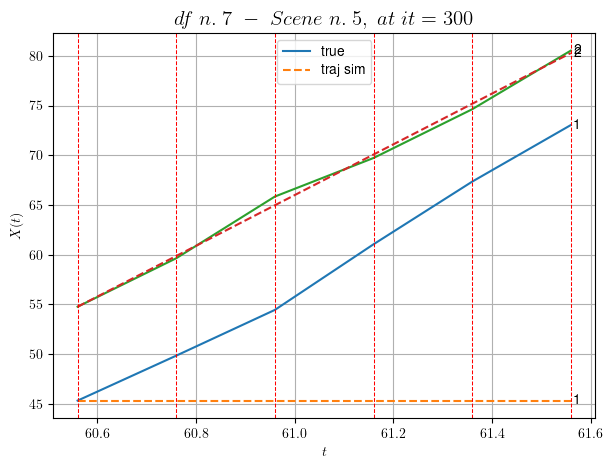

----------------------------------------------------------------------------------------------------
        For scene 1/20:
        * After LR finder: LR_NN=0.01 with mse=4.169019041422149 at it=24
        * v0 = 25.527221143500565
        * MSE = 133.90797159551326
        * iterations = 300
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.2/20
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [177.76,178.56]


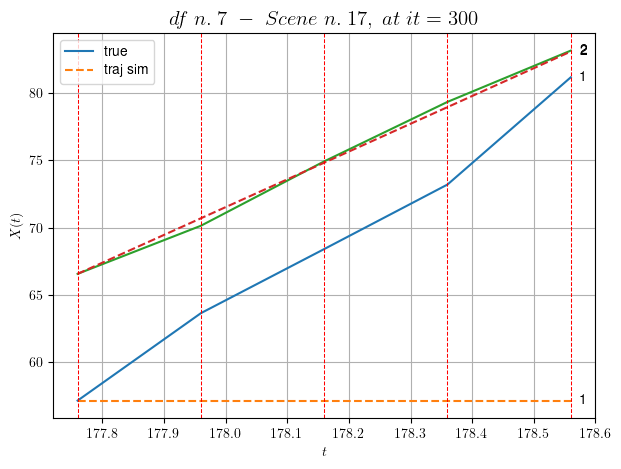

----------------------------------------------------------------------------------------------------
        For scene 2/20:
        * After LR finder: LR_NN=5e-05 with mse=10.785590230092842 at it=24
        * v0 = 20.683528238846485
        * MSE = 100.77487127564417
        * iterations = 300
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.3/20
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [76.36,77.16]


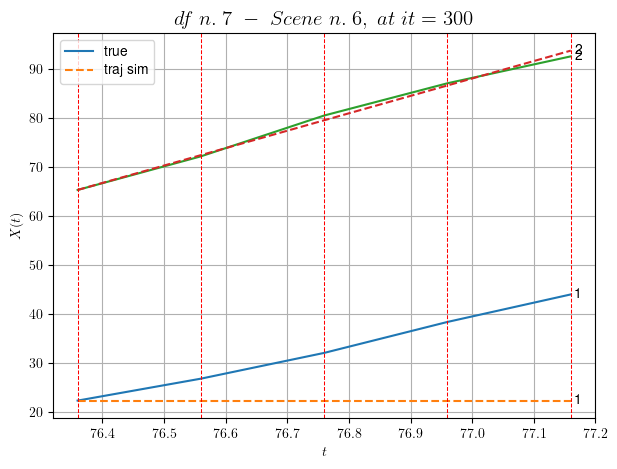

----------------------------------------------------------------------------------------------------
        For scene 3/20:
        * After LR finder: LR_NN=0.0001 with mse=3.6384899328139784 at it=24
        * v0 = 35.53676661235236
        * MSE = 84.42608418592441
        * iterations = 300
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.4/20
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [154.96,155.56]


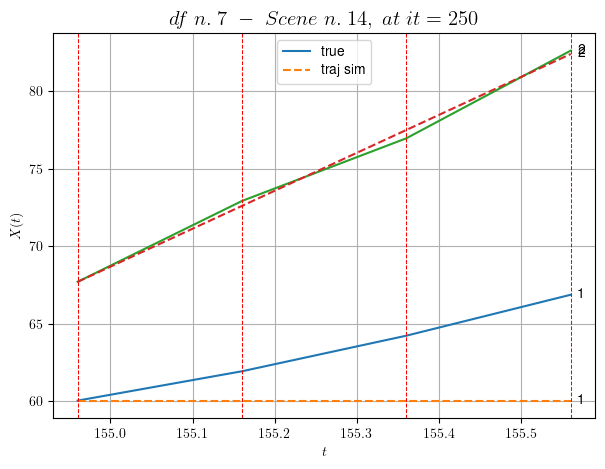

----------------------------------------------------------------------------------------------------
        For scene 4/20:
        * After LR finder: LR_NN=0.0005 with mse=2.208938006419023 at it=24
        * v0 = 24.524894225750582
        * MSE = 8.547902911130615
        * iterations = 250
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.5/20
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [116.96,117.56]


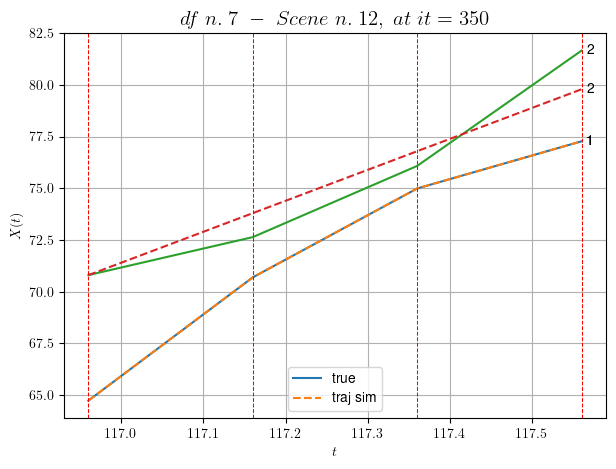

----------------------------------------------------------------------------------------------------
        For scene 5/20:
        * After LR finder: LR_NN=0.005 with mse=14.424762725499733 at it=24
        * v0 = 14.981640977108402
        * MSE = 0.594067210614945
        * iterations = 350
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.6/20
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [38.56,38.96]


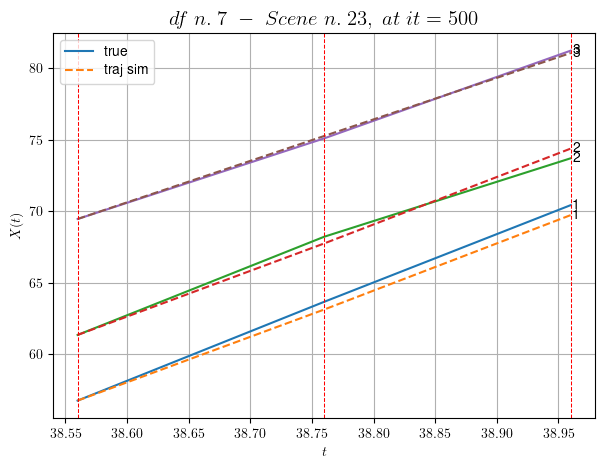

----------------------------------------------------------------------------------------------------
        For scene 6/20:
        * After LR finder: LR_NN=0.005 with mse=0.190274083513407 at it=24
        * v0 = 28.990010590084616
        * MSE = 0.16578689570164915
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.7/20
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [43.16,43.76]


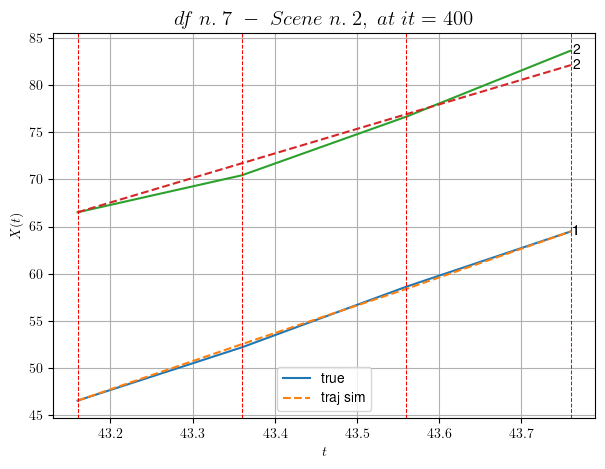

----------------------------------------------------------------------------------------------------
        For scene 7/20:
        * After LR finder: LR_NN=0.005 with mse=1.1065240684131497 at it=24
        * v0 = 25.959463575253253
        * MSE = 0.46117762776724175
        * iterations = 400
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.8/20
----------------------------------------------------------------------------------------------------
We have 7 time intervals inside [44.96,46.36]


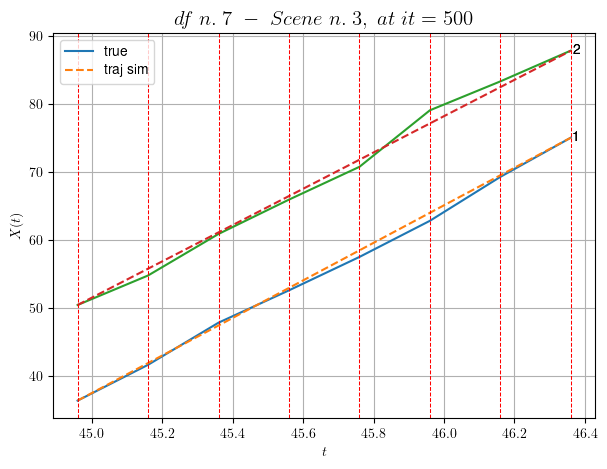

----------------------------------------------------------------------------------------------------
        For scene 8/20:
        * After LR finder: LR_NN=5e-05 with mse=3.7409219773044224 at it=24
        * v0 = 26.657757035933585
        * MSE = 0.5978493793215853
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.9/20
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [162.76,163.16]


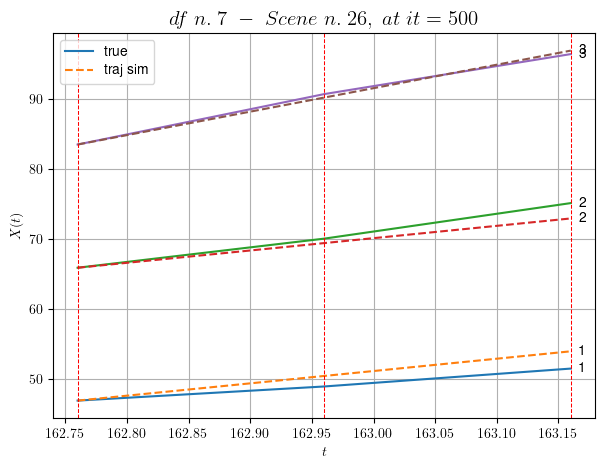

----------------------------------------------------------------------------------------------------
        For scene 9/20:
        * After LR finder: LR_NN=5e-05 with mse=1.9343886915882587 at it=24
        * v0 = 33.51455461644857
        * MSE = 1.5587064519082363
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.10/20
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [51.36,52.36]


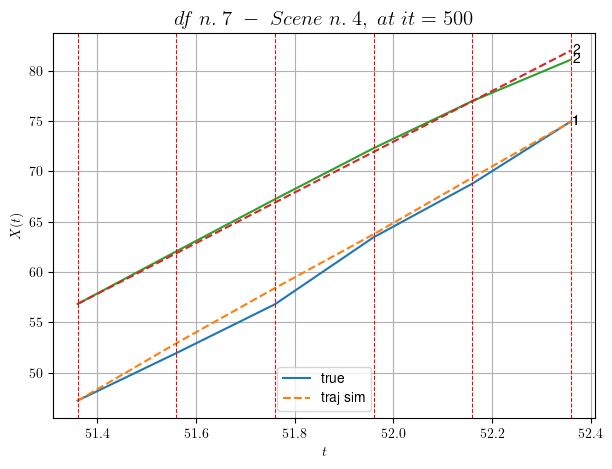

----------------------------------------------------------------------------------------------------
        For scene 10/20:
        * After LR finder: LR_NN=0.005 with mse=5.139627835694058 at it=24
        * v0 = 25.15874060713291
        * MSE = 0.41578606817601016
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.11/20
----------------------------------------------------------------------------------------------------
We have 7 time intervals inside [226.76,228.16]


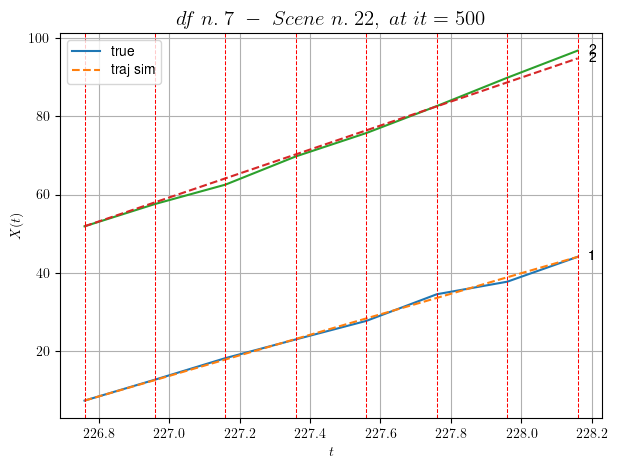

----------------------------------------------------------------------------------------------------
        For scene 11/20:
        * After LR finder: LR_NN=0.001 with mse=1.1448255653580484 at it=24
        * v0 = 30.698361324533057
        * MSE = 0.7261478489728755
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.12/20
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [165.76,166.36]


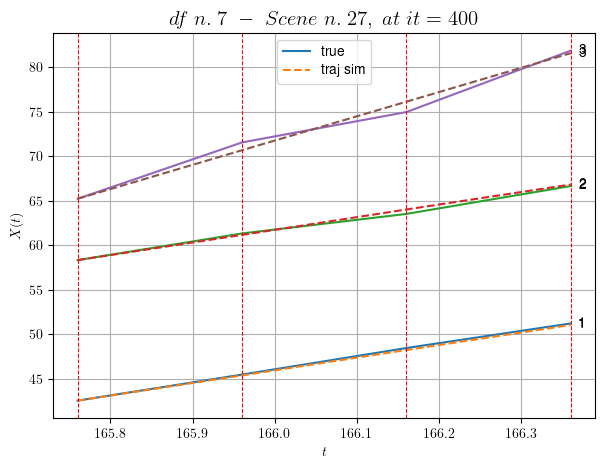

----------------------------------------------------------------------------------------------------
        For scene 12/20:
        * After LR finder: LR_NN=0.005 with mse=0.6197344433602036 at it=24
        * v0 = 27.262213356187985
        * MSE = 0.2159810035097539
        * iterations = 400
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.13/20
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [190.56,190.96]


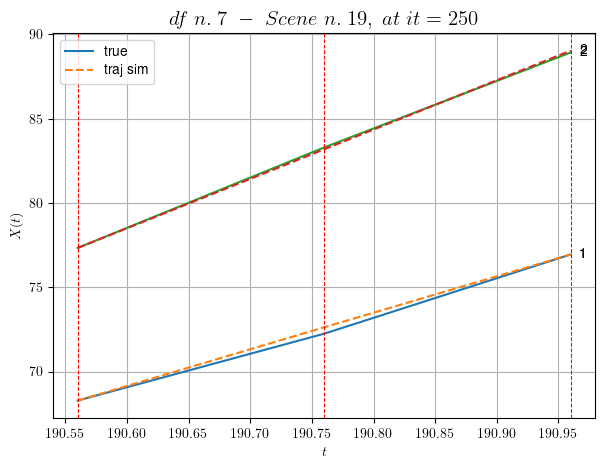

----------------------------------------------------------------------------------------------------
        For scene 13/20:
        * After LR finder: LR_NN=0.001 with mse=0.07047826173199237 at it=24
        * v0 = 29.283628125142897
        * MSE = 0.027552608432961583
        * iterations = 250
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.14/20
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [166.56,167.36]


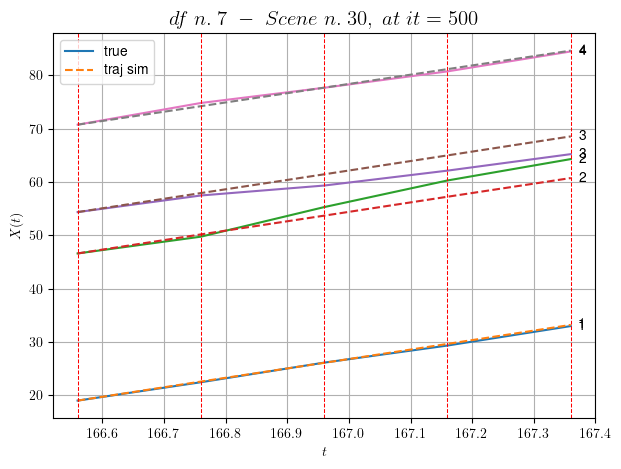

----------------------------------------------------------------------------------------------------
        For scene 14/20:
        * After LR finder: LR_NN=0.005 with mse=12.421450339617895 at it=24
        * v0 = 17.368635969066247
        * MSE = 2.4663990515106473
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.15/20
----------------------------------------------------------------------------------------------------
We have 7 time intervals inside [219.96,221.36]


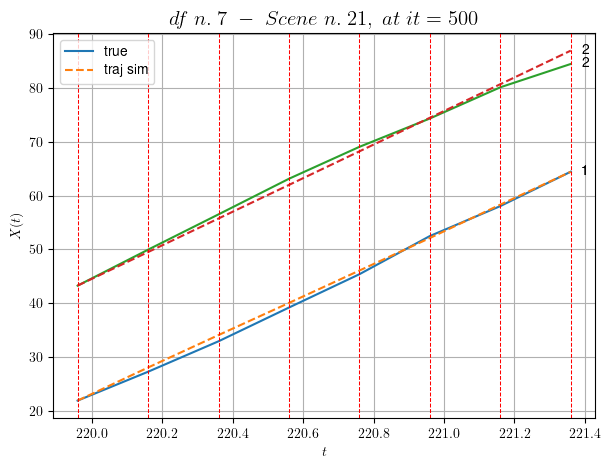

----------------------------------------------------------------------------------------------------
        For scene 15/20:
        * After LR finder: LR_NN=0.005 with mse=0.8744752455799362 at it=24
        * v0 = 31.227007582862125
        * MSE = 0.6654620548611134
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.16/20
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [86.96,87.56]


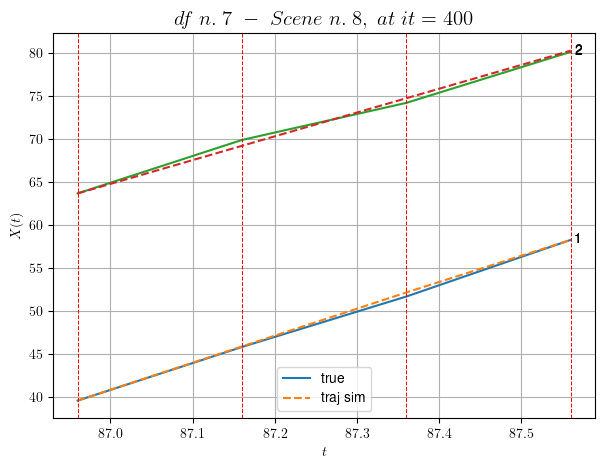

----------------------------------------------------------------------------------------------------
        For scene 16/20:
        * After LR finder: LR_NN=0.005 with mse=0.6258429165647894 at it=24
        * v0 = 27.633294790058404
        * MSE = 0.12303076511094321
        * iterations = 400
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.17/20
----------------------------------------------------------------------------------------------------
We have 7 time intervals inside [110.96,112.36]


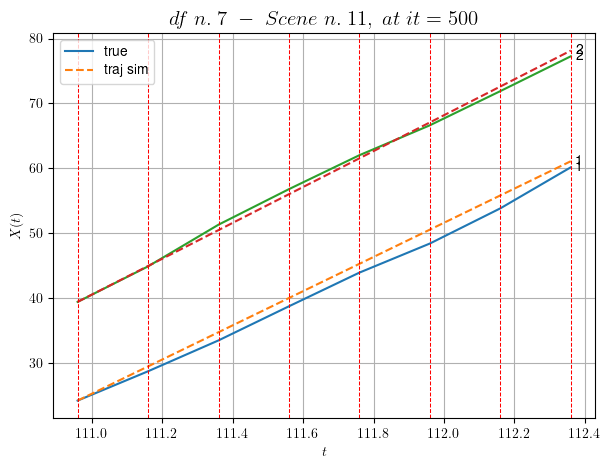

----------------------------------------------------------------------------------------------------
        For scene 17/20:
        * After LR finder: LR_NN=1e-05 with mse=2.544137795014685 at it=24
        * v0 = 27.676256807459225
        * MSE = 1.1296013040251232
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.18/20
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [162.36,163.16]


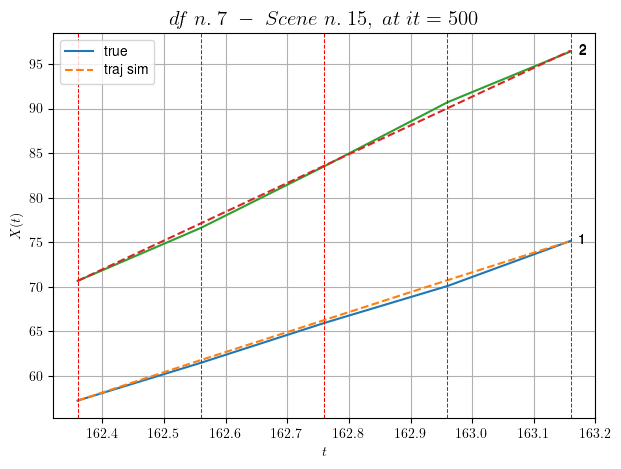

----------------------------------------------------------------------------------------------------
        For scene 18/20:
        * After LR finder: LR_NN=0.005 with mse=0.8991137845891469 at it=24
        * v0 = 32.323787690864414
        * MSE = 0.1343035457549653
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.19/20
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [206.96,207.56]


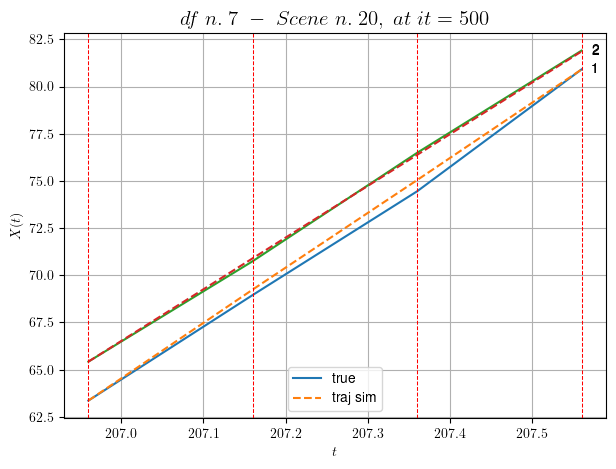

----------------------------------------------------------------------------------------------------
        For scene 19/20:
        * After LR finder: LR_NN=0.0005 with mse=0.5343875541413695 at it=24
        * v0 = 27.399256338801024
        * MSE = 0.05951774276852372
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.20/20
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [82.16,82.76]


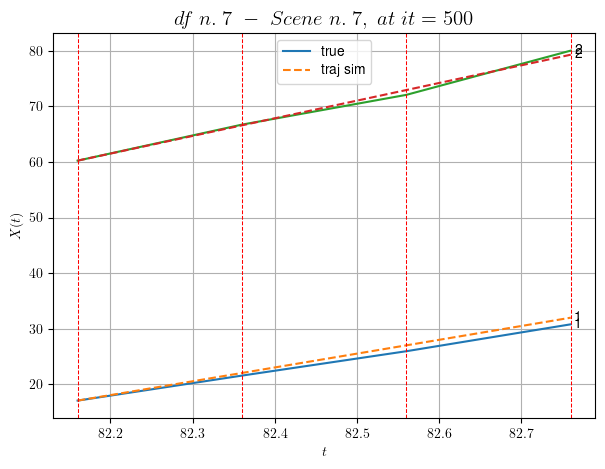

----------------------------------------------------------------------------------------------------
        For scene 20/20:
        * After LR finder: LR_NN=1e-05 with mse=0.433684516088314 at it=24
        * v0 = 31.745431023356105
        * MSE = 0.5090618329669881
        * iterations = 500
----------------------------------------------------------------------------------------------------


MSE train: 16.875363067980803
- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -

Testing step. (10 scenes)
DataFrame n.7. Scene n.1/10


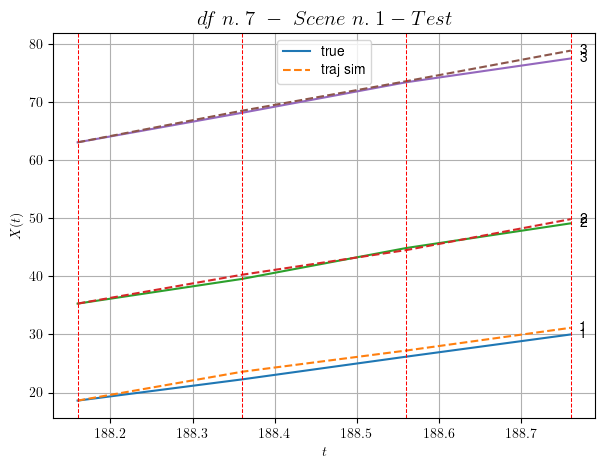

        For scene 1/10:
        * MSE = 0.6093298209737649
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.2/10


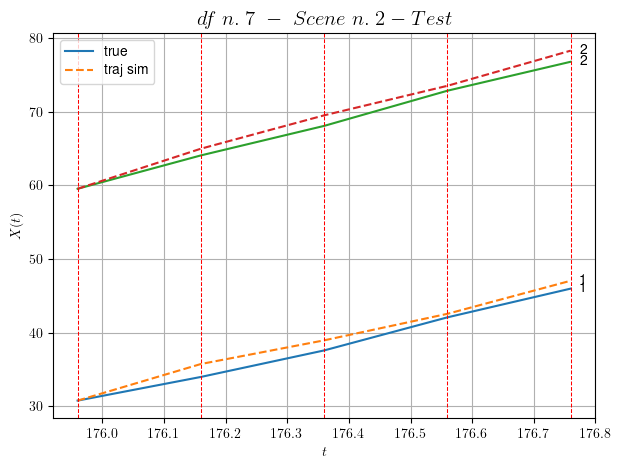

        For scene 2/10:
        * MSE = 1.193264639115469
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.3/10


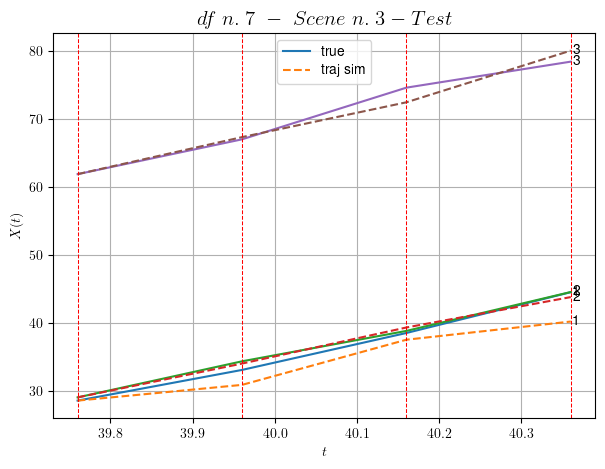

        For scene 3/10:
        * MSE = 2.7225672908180214
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.4/10


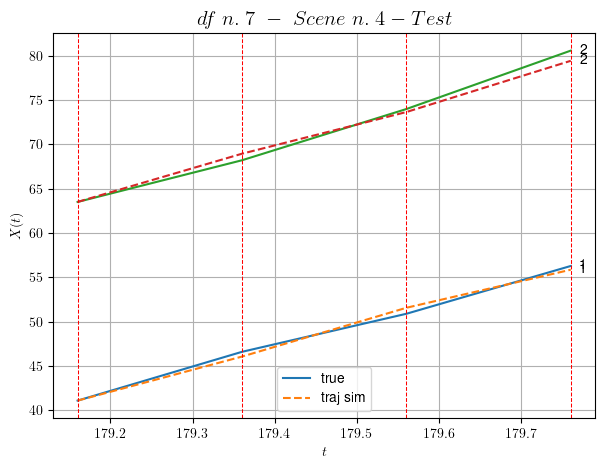

        For scene 4/10:
        * MSE = 0.36262915507874094
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.5/10


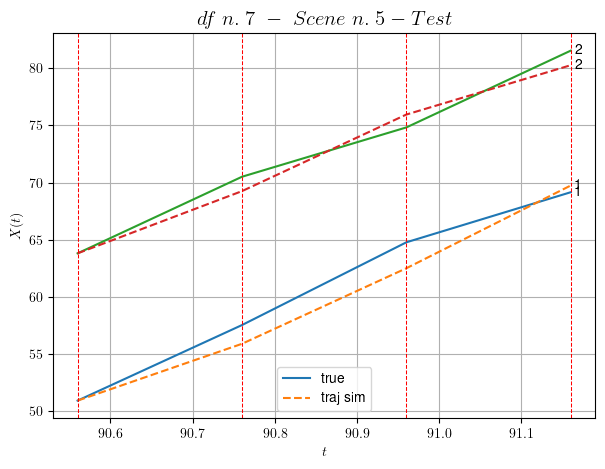

        For scene 5/10:
        * MSE = 1.5817568747813295
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.6/10


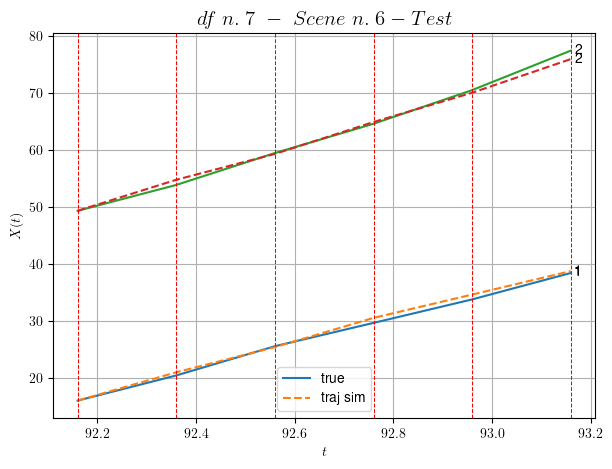

        For scene 6/10:
        * MSE = 0.4417493446321985
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.7/10


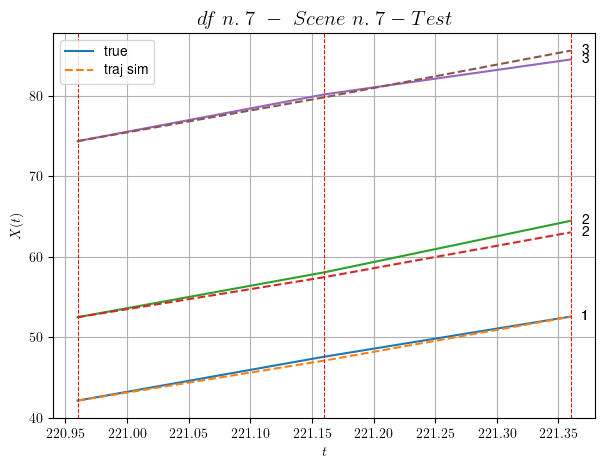

        For scene 7/10:
        * MSE = 0.4433138227457675
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.8/10


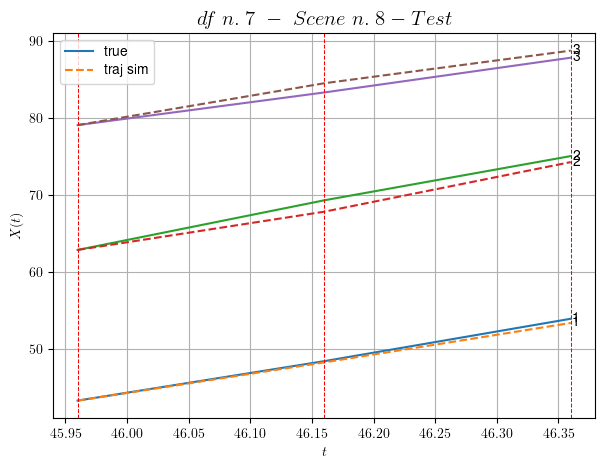

        For scene 8/10:
        * MSE = 0.6009569616729354
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.9/10


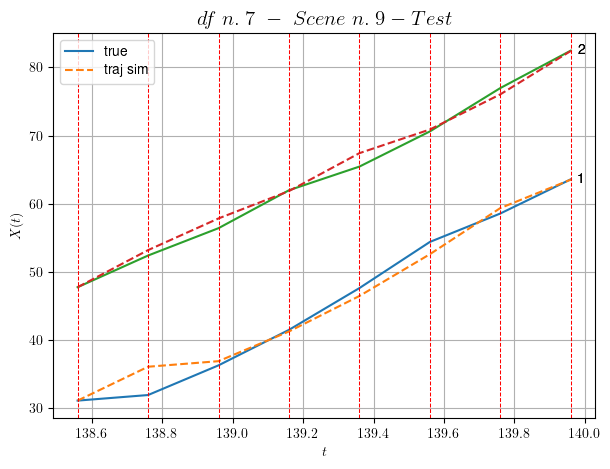

        For scene 9/10:
        * MSE = 1.8990041293574276
----------------------------------------------------------------------------------------------------


DataFrame n.7. Scene n.10/10


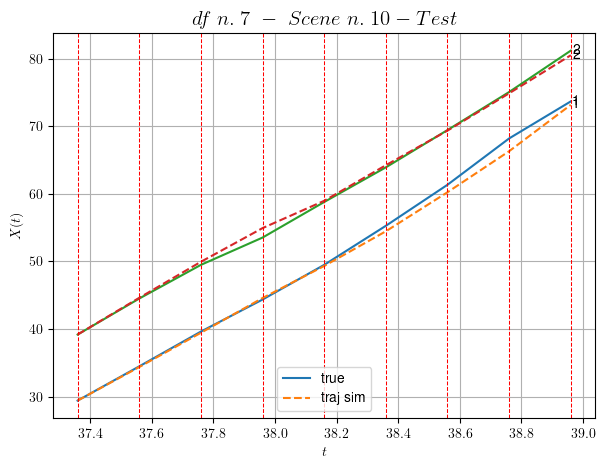

        For scene 10/10:
        * MSE = 0.4812786001759102
----------------------------------------------------------------------------------------------------


MSE test: 1.0335850639351565

- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -

    Summing up:
          * MSE train: 16.875363067980803
          * MSE test: 1.0335850639351565
          
- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -




Analyzing 8/10 dfs.
In DataFrame n.8 we have 79 scenes.
    To train the model we use 52 scenes, the remaining 27 to test the model.

Training step. (52 scenes)
DataFrame n.8. Scene n.1/52
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [574.24,575.04]


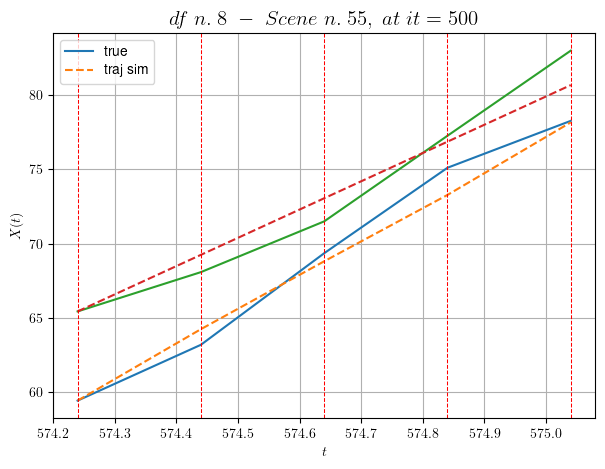

----------------------------------------------------------------------------------------------------
        For scene 1/52:
        * After LR finder: LR_NN=0.005 with mse=13.371896684121012 at it=24
        * v0 = 19.077749443551937
        * MSE = 1.4120655208790986
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.2/52
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [194.44,194.84]


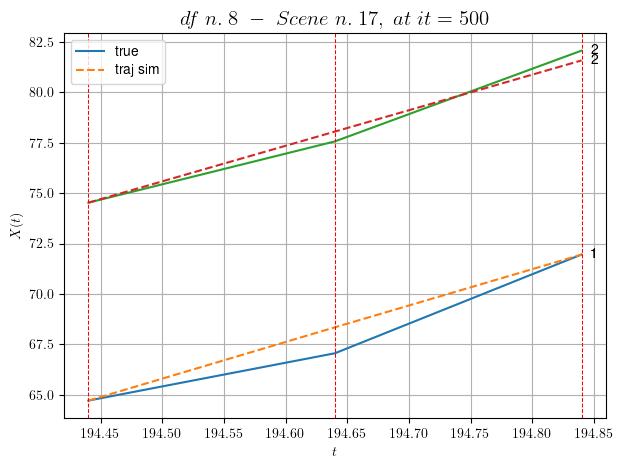

----------------------------------------------------------------------------------------------------
        For scene 2/52:
        * After LR finder: LR_NN=0.0005 with mse=5.193696473576067 at it=24
        * v0 = 17.64870499817794
        * MSE = 0.3534095358265583
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.3/52
----------------------------------------------------------------------------------------------------
We have 8 time intervals inside [458.64,460.24]


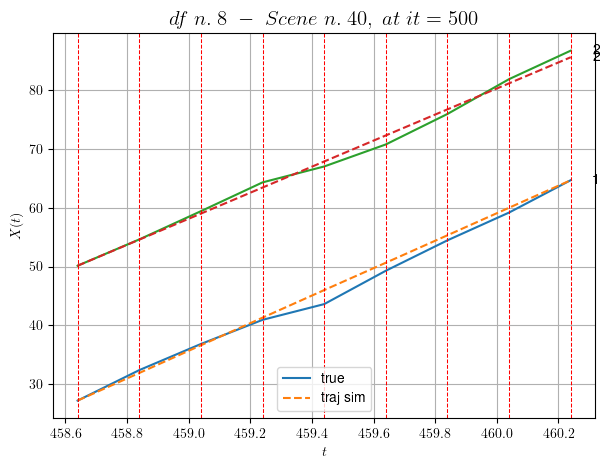

----------------------------------------------------------------------------------------------------
        For scene 3/52:
        * After LR finder: LR_NN=0.001 with mse=28.330472901110532 at it=24
        * v0 = 22.184785448498644
        * MSE = 0.8702284701355025
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.4/52
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [587.44,587.84]


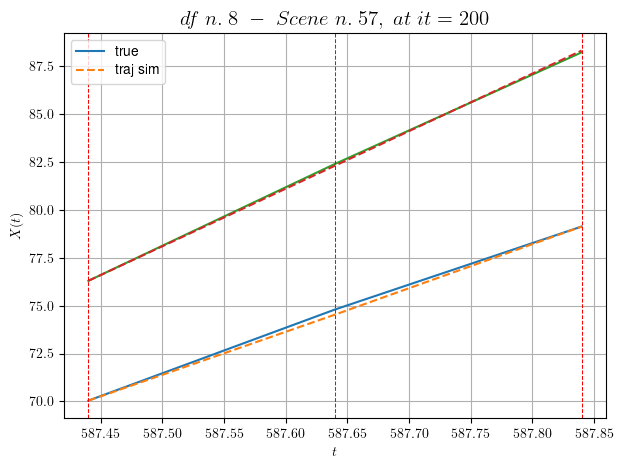

----------------------------------------------------------------------------------------------------
        For scene 4/52:
        * After LR finder: LR_NN=0.005 with mse=0.015825424946027986 at it=24
        * v0 = 30.037169893910686
        * MSE = 0.011755075985984399
        * iterations = 200
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.5/52
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [256.44,257.24]


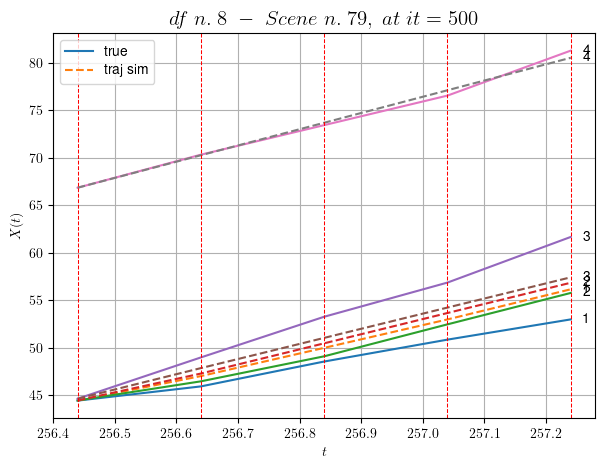

----------------------------------------------------------------------------------------------------
        For scene 5/52:
        * After LR finder: LR_NN=0.005 with mse=12.775252808314868 at it=24
        * v0 = 17.104258674666383
        * MSE = 2.717603257292133
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.6/52
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [105.04,105.64]


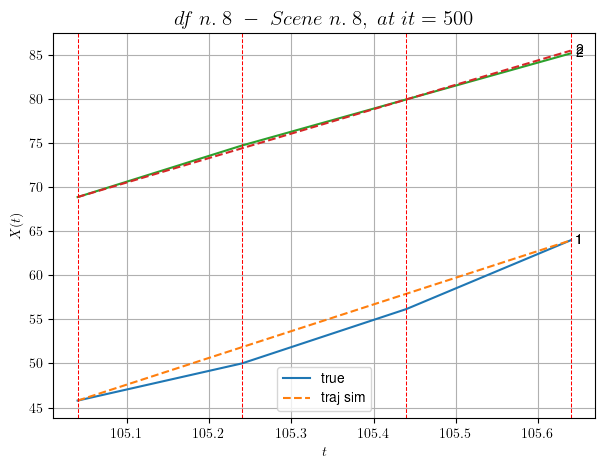

----------------------------------------------------------------------------------------------------
        For scene 6/52:
        * After LR finder: LR_NN=5e-05 with mse=1.3981526705583327 at it=24
        * v0 = 27.688024621823565
        * MSE = 0.5773449741561583
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.7/52
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [531.84,532.84]


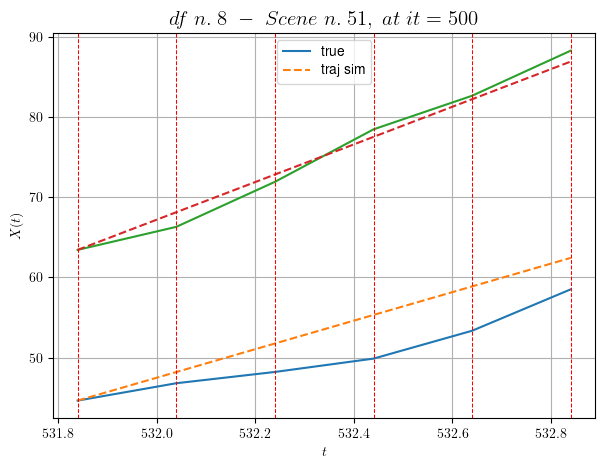

----------------------------------------------------------------------------------------------------
        For scene 7/52:
        * After LR finder: LR_NN=1e-05 with mse=7.76059964869741 at it=24
        * v0 = 23.47241077464472
        * MSE = 8.085896408944004
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.8/52
----------------------------------------------------------------------------------------------------
We have 7 time intervals inside [548.04,549.44]


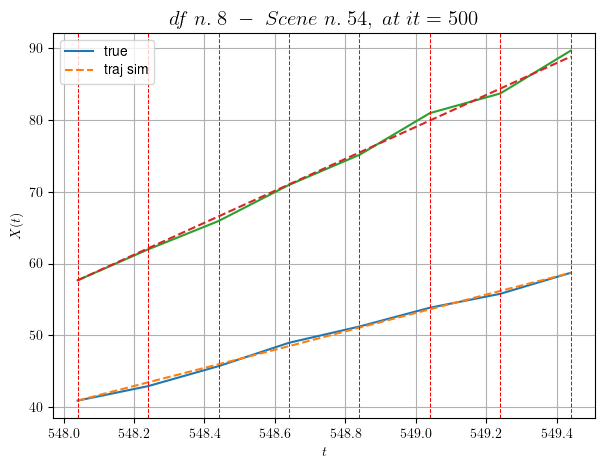

----------------------------------------------------------------------------------------------------
        For scene 8/52:
        * After LR finder: LR_NN=0.005 with mse=20.298757126828733 at it=24
        * v0 = 22.28422335728387
        * MSE = 0.22299186044093688
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.9/52
----------------------------------------------------------------------------------------------------
We have 11 time intervals inside [250.44,252.64]


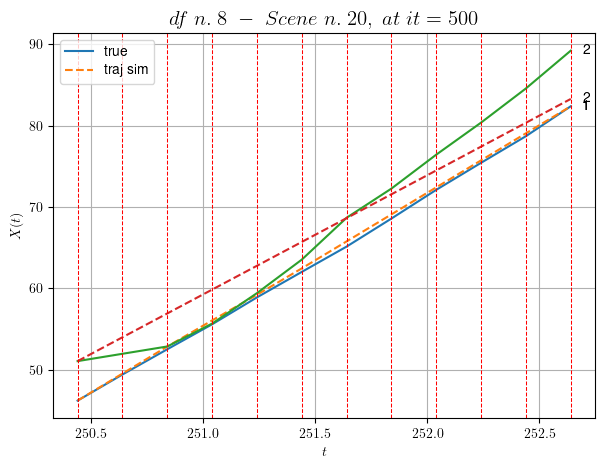

----------------------------------------------------------------------------------------------------
        For scene 9/52:
        * After LR finder: LR_NN=0.0005 with mse=176.28056218557805 at it=24
        * v0 = 14.644824448517745
        * MSE = 4.116864726781979
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.10/52
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [227.04,227.84]


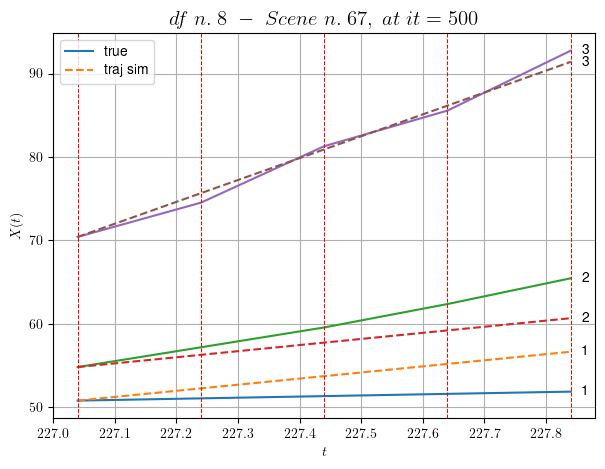

----------------------------------------------------------------------------------------------------
        For scene 10/52:
        * After LR finder: LR_NN=0.001 with mse=2.9566919227196746 at it=24
        * v0 = 26.24315546538644
        * MSE = 5.550802601732204
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.11/52
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [319.44,320.44]


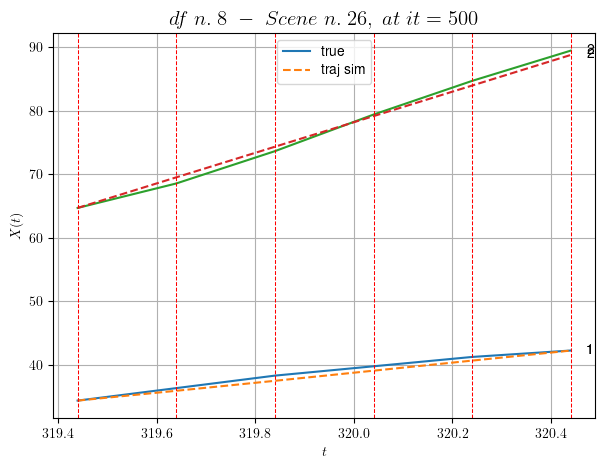

----------------------------------------------------------------------------------------------------
        For scene 11/52:
        * After LR finder: LR_NN=0.005 with mse=5.86715574487389 at it=24
        * v0 = 24.072557838554268
        * MSE = 0.3241401180950447
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.12/52
----------------------------------------------------------------------------------------------------
We have 12 time intervals inside [496.44,498.84]


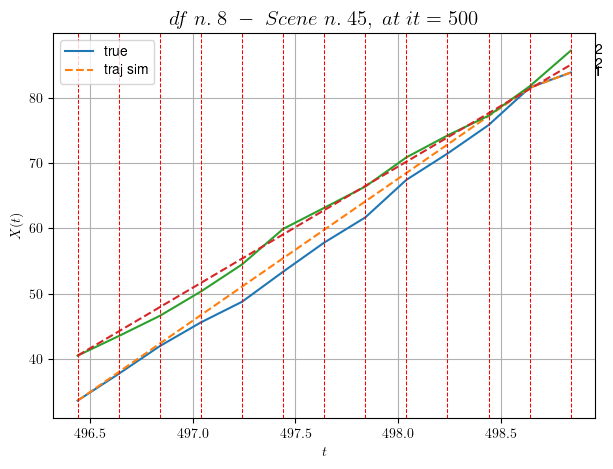

----------------------------------------------------------------------------------------------------
        For scene 12/52:
        * After LR finder: LR_NN=0.001 with mse=126.88519789666704 at it=24
        * v0 = 18.546831523765636
        * MSE = 1.4192606548915747
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.13/52
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [176.24,176.64]


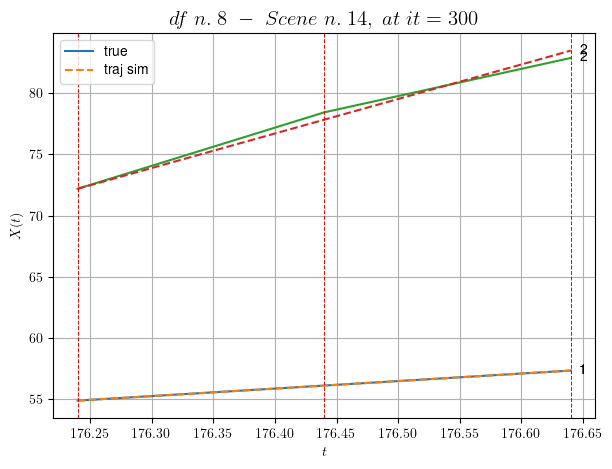

----------------------------------------------------------------------------------------------------
        For scene 13/52:
        * After LR finder: LR_NN=0.01 with mse=0.29777083926302206 at it=24
        * v0 = 28.209764281783194
        * MSE = 0.11948262176130375
        * iterations = 300
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.14/52
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [477.84,478.84]


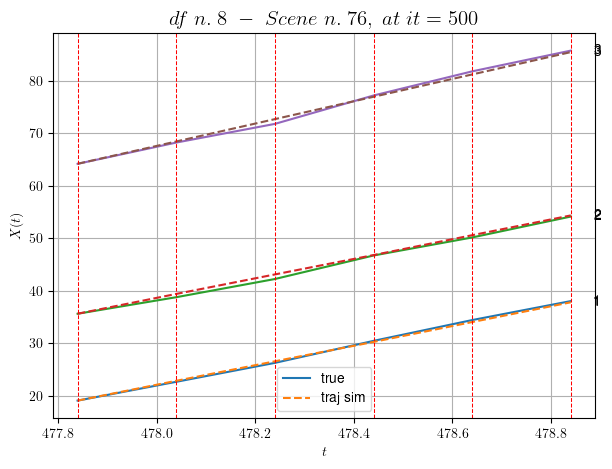

----------------------------------------------------------------------------------------------------
        For scene 14/52:
        * After LR finder: LR_NN=0.005 with mse=9.010910794023577 at it=24
        * v0 = 21.268159302176777
        * MSE = 0.1663455884700958
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.15/52
----------------------------------------------------------------------------------------------------
We have 7 time intervals inside [58.44,59.84]


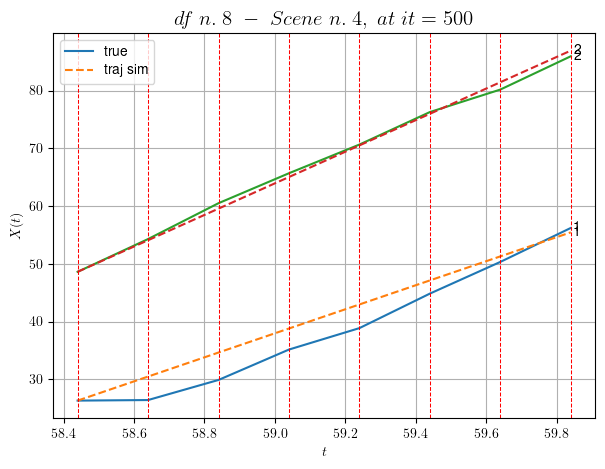

----------------------------------------------------------------------------------------------------
        For scene 15/52:
        * After LR finder: LR_NN=1e-05 with mse=7.0913330063267725 at it=24
        * v0 = 27.356016886559036
        * MSE = 3.891664443127765
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.16/52
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [197.84,198.64]


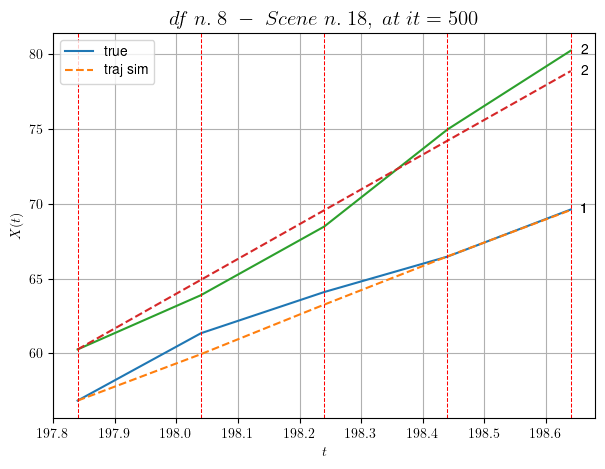

----------------------------------------------------------------------------------------------------
        For scene 16/52:
        * After LR finder: LR_NN=0.005 with mse=4.9634872387088995 at it=24
        * v0 = 23.275091763732032
        * MSE = 0.6812609799461431
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.17/52
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [456.44,457.24]


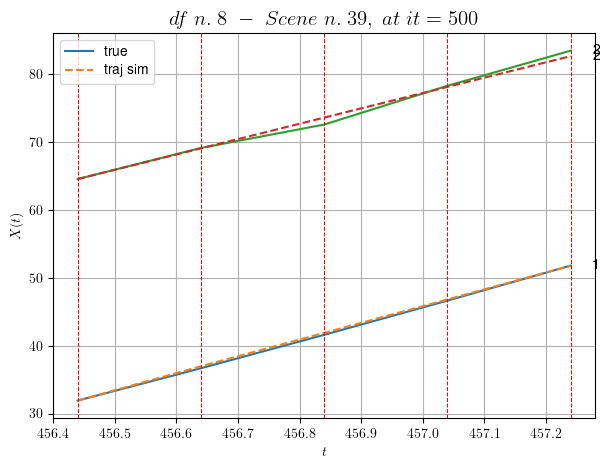

----------------------------------------------------------------------------------------------------
        For scene 17/52:
        * After LR finder: LR_NN=0.01 with mse=6.1900391724870065 at it=24
        * v0 = 22.637249688333455
        * MSE = 0.18425128774189123
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.18/52
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [116.04,116.44]


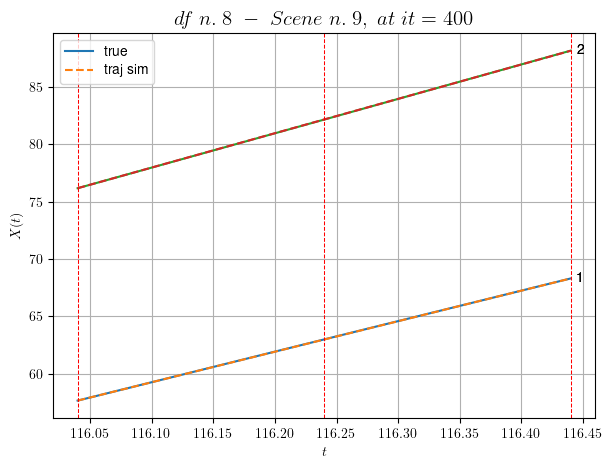

----------------------------------------------------------------------------------------------------
        For scene 18/52:
        * After LR finder: LR_NN=0.0001 with mse=22.159618185717807 at it=24
        * v0 = 29.9905083383104
        * MSE = 4.644354665963851e-05
        * iterations = 400
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.19/52
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [225.24,226.24]


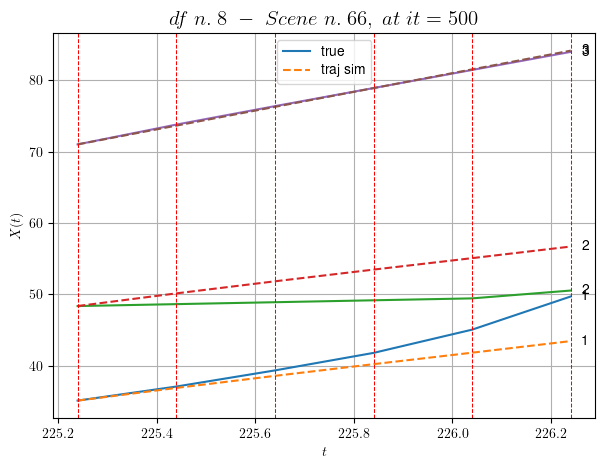

----------------------------------------------------------------------------------------------------
        For scene 19/52:
        * After LR finder: LR_NN=0.01 with mse=43.255110351619415 at it=24
        * v0 = 13.143683398703441
        * MSE = 8.428811377355334
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.20/52
----------------------------------------------------------------------------------------------------
We have 10 time intervals inside [101.04,103.04]


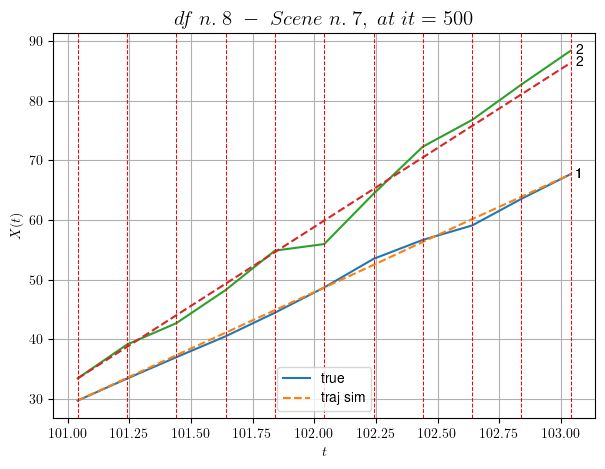

----------------------------------------------------------------------------------------------------
        For scene 20/52:
        * After LR finder: LR_NN=0.005 with mse=8.471266659752262 at it=24
        * v0 = 26.48969548240825
        * MSE = 1.4718472930230968
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.21/52
----------------------------------------------------------------------------------------------------
We have 14 time intervals inside [445.44,448.24]


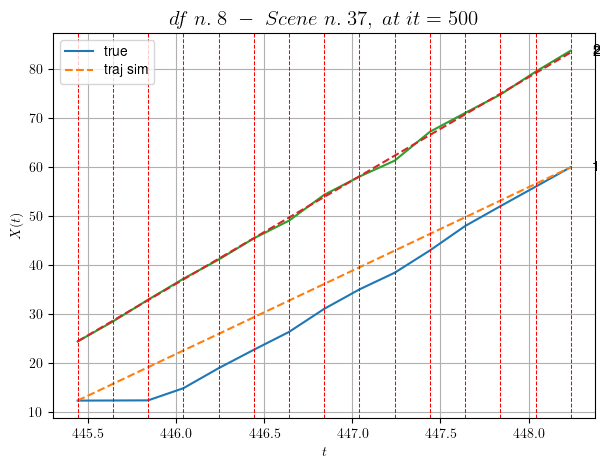

----------------------------------------------------------------------------------------------------
        For scene 21/52:
        * After LR finder: LR_NN=0.0005 with mse=109.08421027388621 at it=24
        * v0 = 21.04037373587069
        * MSE = 10.824521894052346
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.22/52
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [350.64,351.64]


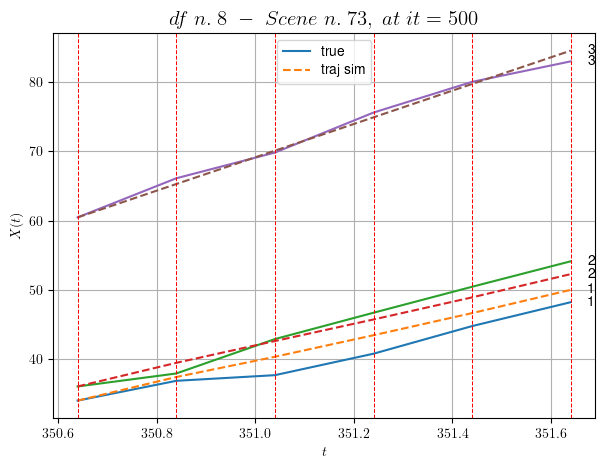

----------------------------------------------------------------------------------------------------
        For scene 22/52:
        * After LR finder: LR_NN=0.01 with mse=6.377712706822469 at it=24
        * v0 = 24.01755603165841
        * MSE = 1.8812947481146614
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.23/52
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [36.44,37.04]


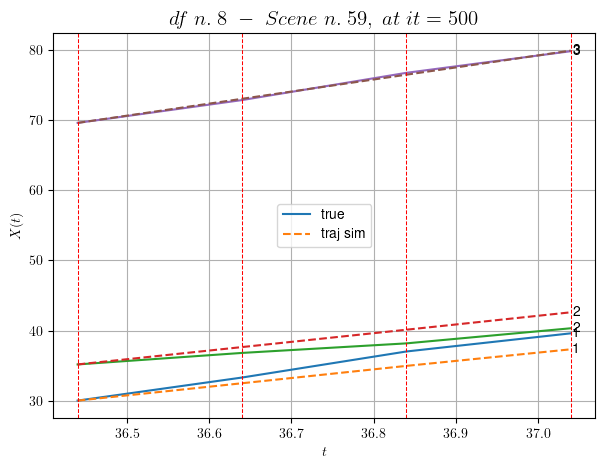

----------------------------------------------------------------------------------------------------
        For scene 23/52:
        * After LR finder: LR_NN=0.005 with mse=9.254484107514713 at it=24
        * v0 = 17.15679593462082
        * MSE = 1.650572566785313
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.24/52
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [516.64,517.44]


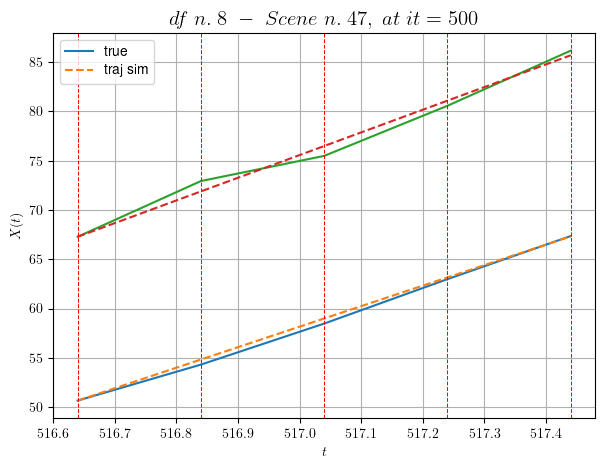

----------------------------------------------------------------------------------------------------
        For scene 24/52:
        * After LR finder: LR_NN=5e-05 with mse=6.3217595194392535 at it=24
        * v0 = 23.01946389183603
        * MSE = 0.30363218130824643
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.25/52
----------------------------------------------------------------------------------------------------
We have 7 time intervals inside [593.04,594.44]


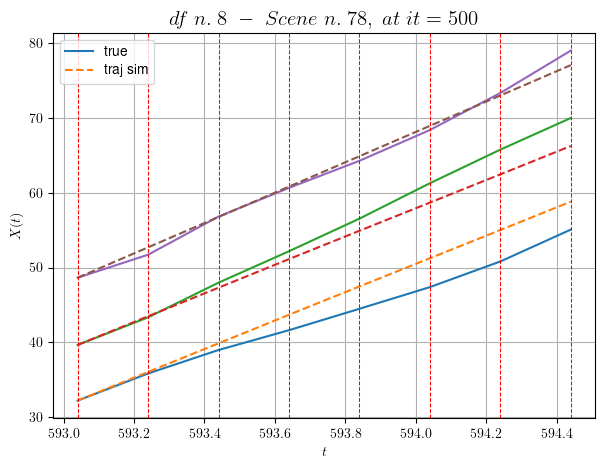

----------------------------------------------------------------------------------------------------
        For scene 25/52:
        * After LR finder: LR_NN=0.005 with mse=24.81187546165067 at it=24
        * v0 = 20.297836048725642
        * MSE = 4.246049600326808
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.26/52
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [190.84,191.84]


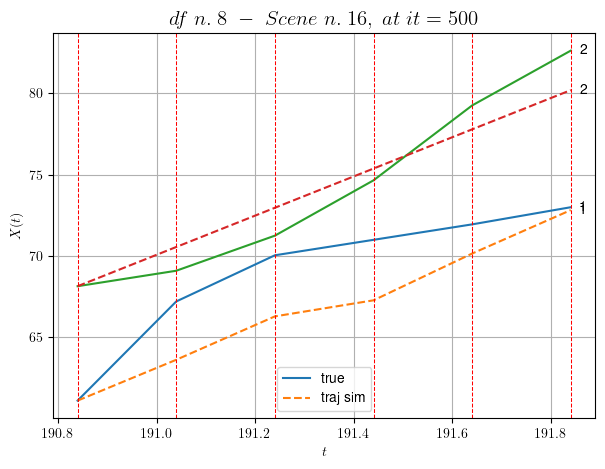

----------------------------------------------------------------------------------------------------
        For scene 26/52:
        * After LR finder: LR_NN=0.005 with mse=57.43902586034891 at it=24
        * v0 = 12.068548421445575
        * MSE = 4.818648189570144
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.27/52
----------------------------------------------------------------------------------------------------
We have 9 time intervals inside [327.84,329.64]


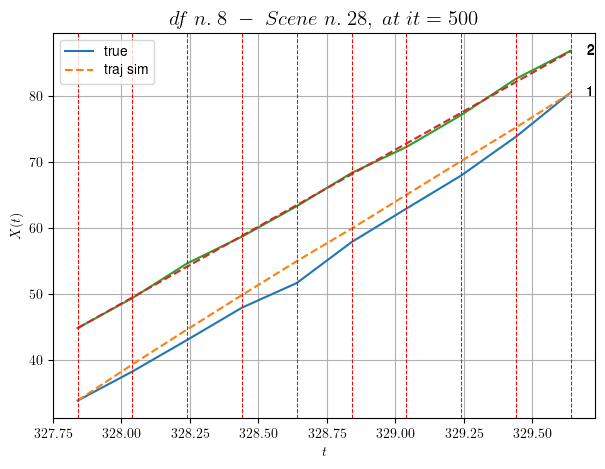

----------------------------------------------------------------------------------------------------
        For scene 27/52:
        * After LR finder: LR_NN=0.01 with mse=26.458865167149614 at it=24
        * v0 = 23.318084130194393
        * MSE = 1.2044736100307831
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.28/52
----------------------------------------------------------------------------------------------------
We have 9 time intervals inside [488.24,490.04]


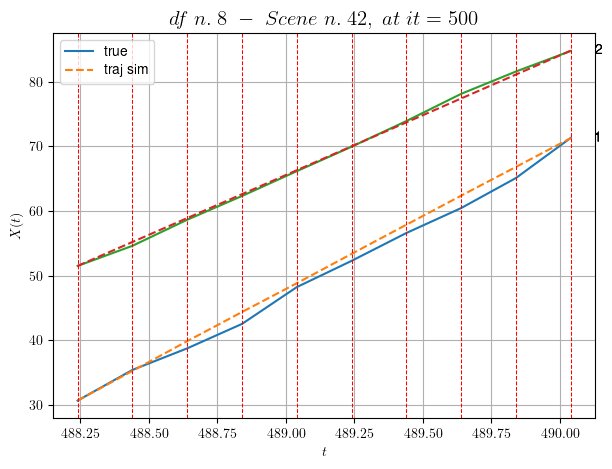

----------------------------------------------------------------------------------------------------
        For scene 28/52:
        * After LR finder: LR_NN=0.005 with mse=74.92643910787274 at it=24
        * v0 = 18.510799599163246
        * MSE = 0.7875621530515509
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.29/52
----------------------------------------------------------------------------------------------------
We have 8 time intervals inside [323.44,325.04]


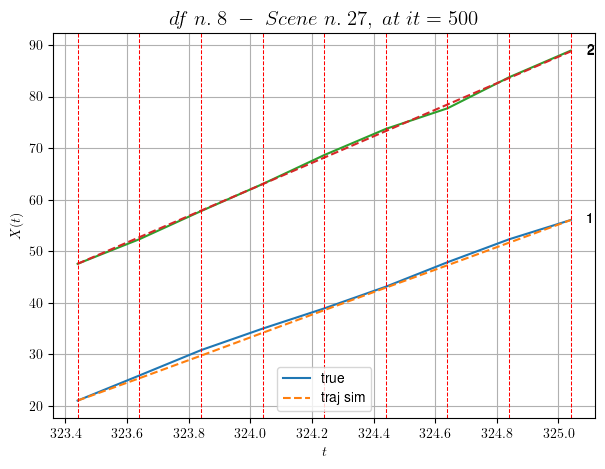

----------------------------------------------------------------------------------------------------
        For scene 29/52:
        * After LR finder: LR_NN=0.005 with mse=8.302876185197954 at it=24
        * v0 = 25.758374409859535
        * MSE = 0.2286195752628305
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.30/52
----------------------------------------------------------------------------------------------------
We have 7 time intervals inside [521.04,522.44]


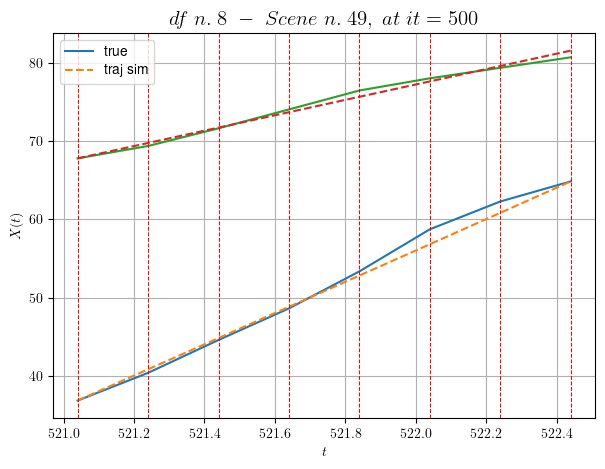

----------------------------------------------------------------------------------------------------
        For scene 30/52:
        * After LR finder: LR_NN=0.0005 with mse=143.68346471426057 at it=24
        * v0 = 9.856007983844984
        * MSE = 0.5139919328390303
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.31/52
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [313.24,313.64]


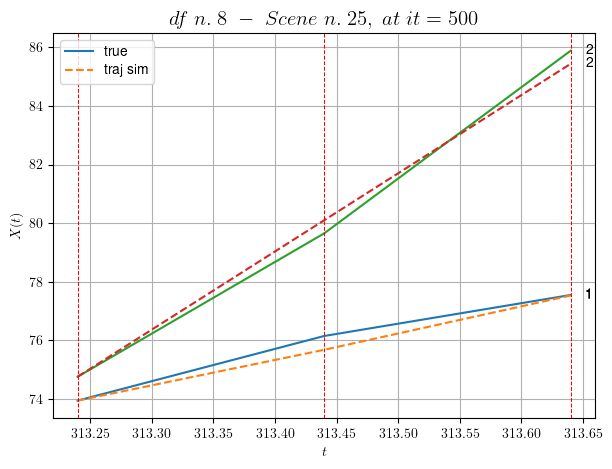

----------------------------------------------------------------------------------------------------
        For scene 31/52:
        * After LR finder: LR_NN=0.01 with mse=0.33155859582689823 at it=24
        * v0 = 26.698670162295386
        * MSE = 0.10324581805715072
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.32/52
----------------------------------------------------------------------------------------------------
We have 7 time intervals inside [494.44,495.84]


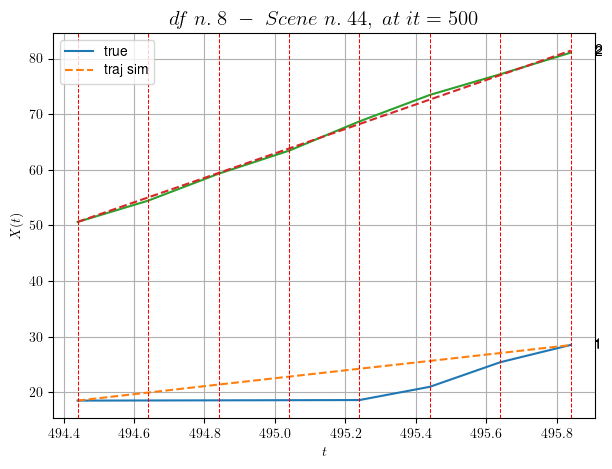

----------------------------------------------------------------------------------------------------
        For scene 32/52:
        * After LR finder: LR_NN=0.001 with mse=26.027263626908976 at it=24
        * v0 = 22.008439992316802
        * MSE = 5.308882559586387
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.33/52
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [522.64,523.04]


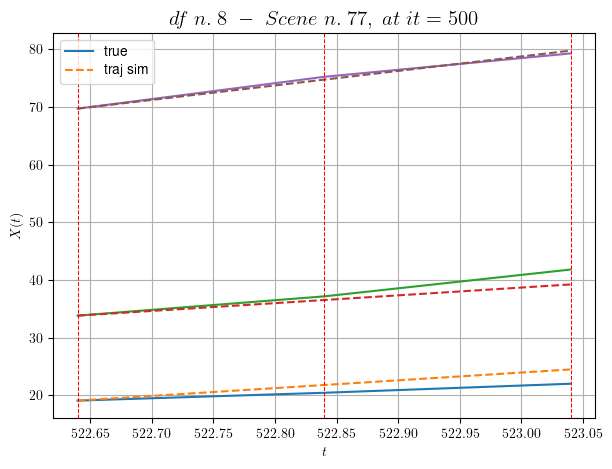

----------------------------------------------------------------------------------------------------
        For scene 33/52:
        * After LR finder: LR_NN=0.0001 with mse=0.9031111091680731 at it=24
        * v0 = 25.15597288259508
        * MSE = 1.7264258700797421
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.34/52
----------------------------------------------------------------------------------------------------
We have 8 time intervals inside [592.84,594.44]


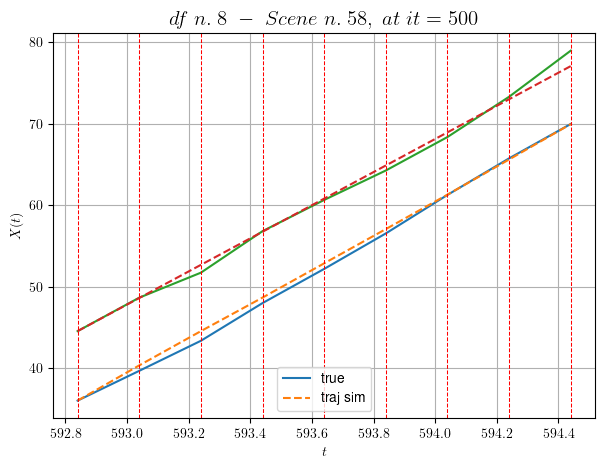

----------------------------------------------------------------------------------------------------
        For scene 34/52:
        * After LR finder: LR_NN=0.01 with mse=40.73463204781158 at it=24
        * v0 = 20.354057423511986
        * MSE = 0.36080294261449813
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.35/52
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [154.24,154.84]


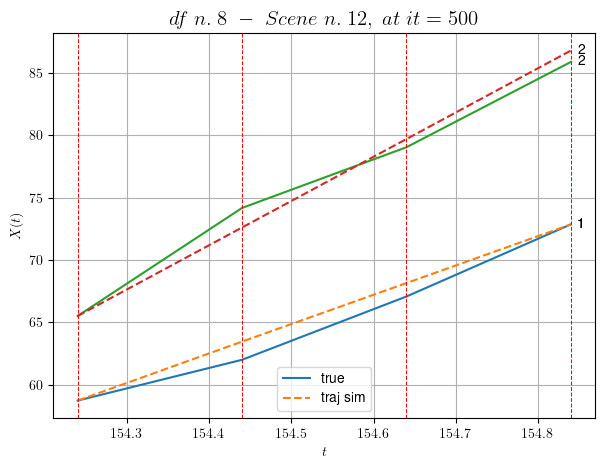

----------------------------------------------------------------------------------------------------
        For scene 35/52:
        * After LR finder: LR_NN=0.0005 with mse=1.9881716014448152 at it=24
        * v0 = 35.440393347036846
        * MSE = 0.823609536257981
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.36/52
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [404.84,405.44]


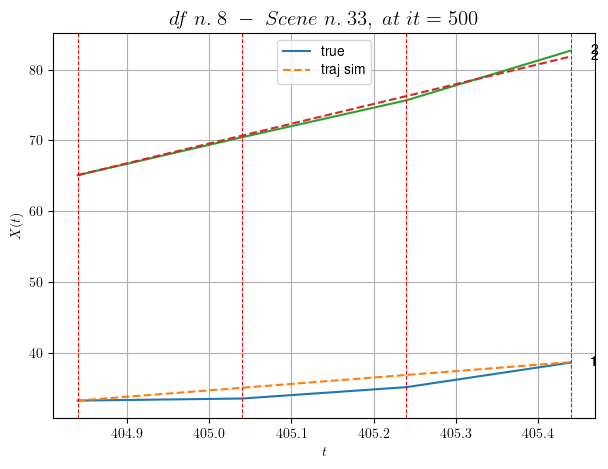

----------------------------------------------------------------------------------------------------
        For scene 36/52:
        * After LR finder: LR_NN=0.0001 with mse=1.0891218416063484 at it=24
        * v0 = 27.902766852719747
        * MSE = 0.7940930568044028
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.37/52
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [414.44,414.84]


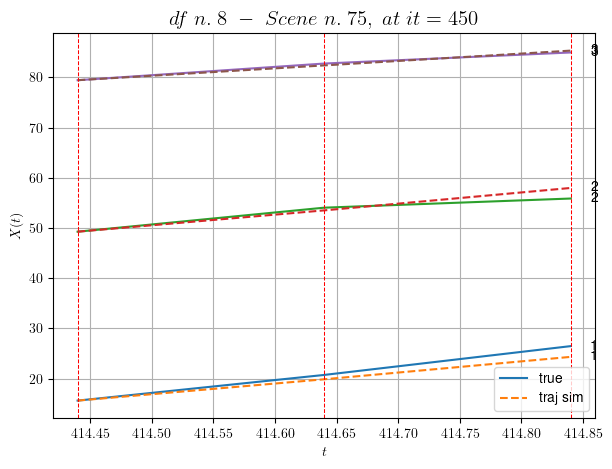

----------------------------------------------------------------------------------------------------
        For scene 37/52:
        * After LR finder: LR_NN=0.005 with mse=6.595231461145854 at it=24
        * v0 = 14.740231690535635
        * MSE = 1.1459806635735086
        * iterations = 450
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.38/52
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [50.24,51.04]


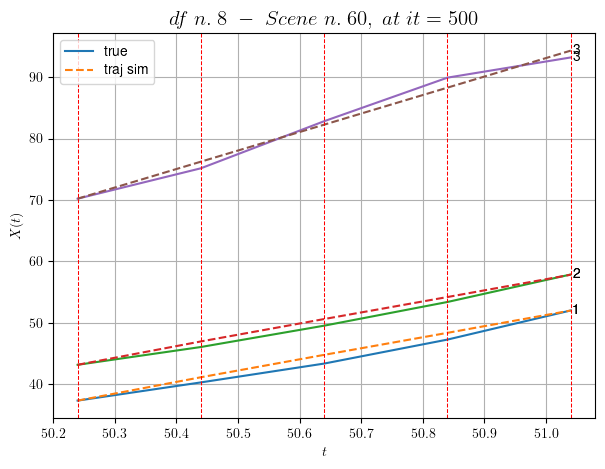

----------------------------------------------------------------------------------------------------
        For scene 38/52:
        * After LR finder: LR_NN=0.005 with mse=0.8688414840981625 at it=24
        * v0 = 30.157660974110687
        * MSE = 0.7910781713413672
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.39/52
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [215.24,216.24]


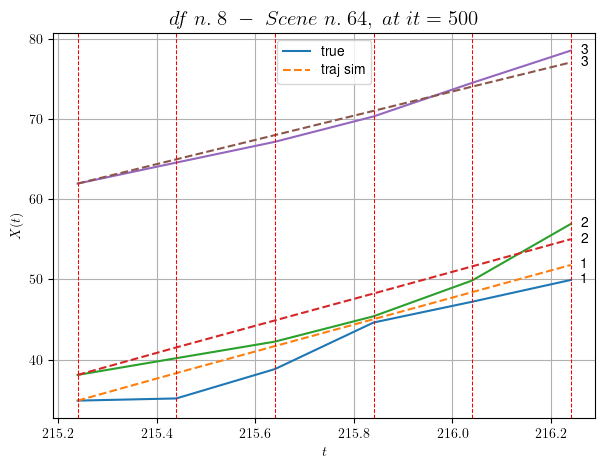

----------------------------------------------------------------------------------------------------
        For scene 39/52:
        * After LR finder: LR_NN=0.001 with mse=27.646065709084368 at it=24
        * v0 = 15.100689610550312
        * MSE = 2.775873680060617
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.40/52
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [243.44,244.24]


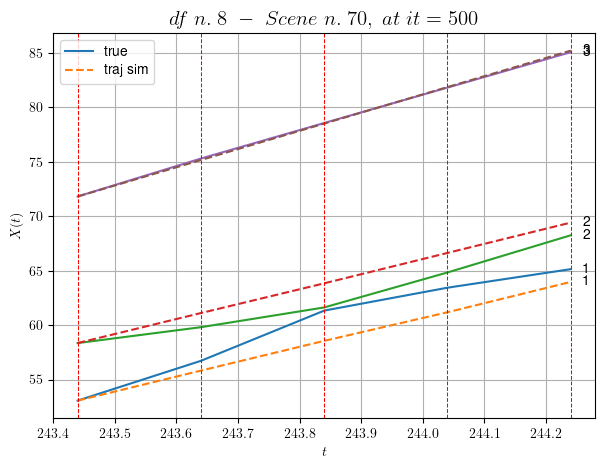

----------------------------------------------------------------------------------------------------
        For scene 40/52:
        * After LR finder: LR_NN=0.005 with mse=15.874098742488611 at it=24
        * v0 = 16.742914270051028
        * MSE = 1.745439155513653
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.41/52
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [453.64,454.24]


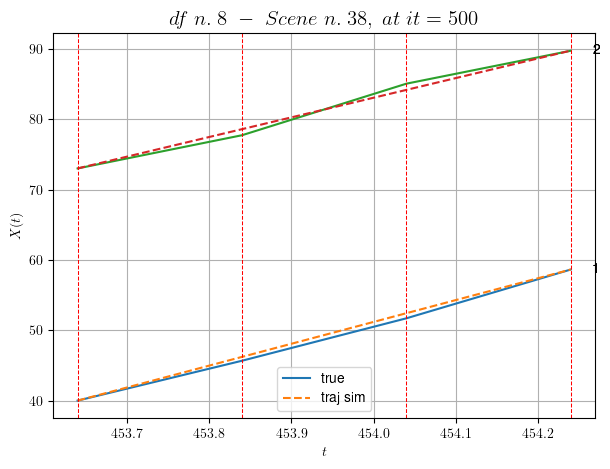

----------------------------------------------------------------------------------------------------
        For scene 41/52:
        * After LR finder: LR_NN=0.0001 with mse=0.5766786248202798 at it=24
        * v0 = 27.920103284427466
        * MSE = 0.25808932922407046
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.42/52
----------------------------------------------------------------------------------------------------
We have 14 time intervals inside [366.64,369.44]


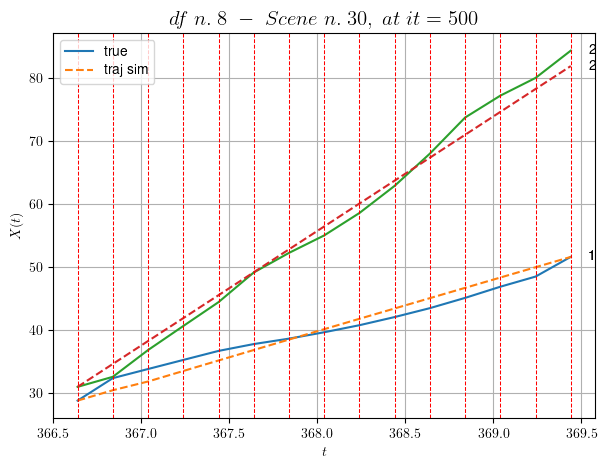

----------------------------------------------------------------------------------------------------
        For scene 42/52:
        * After LR finder: LR_NN=0.005 with mse=178.00734594362052 at it=24
        * v0 = 18.211190440756237
        * MSE = 2.006702578095826
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.43/52
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [28.44,29.24]


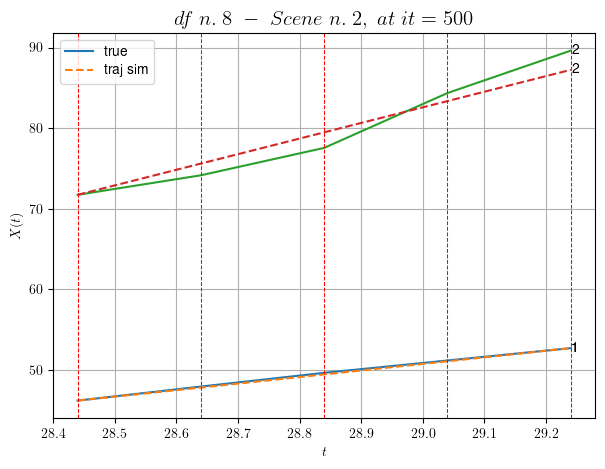

----------------------------------------------------------------------------------------------------
        For scene 43/52:
        * After LR finder: LR_NN=0.005 with mse=11.73820788157628 at it=24
        * v0 = 19.374312728051596
        * MSE = 1.0843602525325462
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.44/52
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [545.44,545.84]


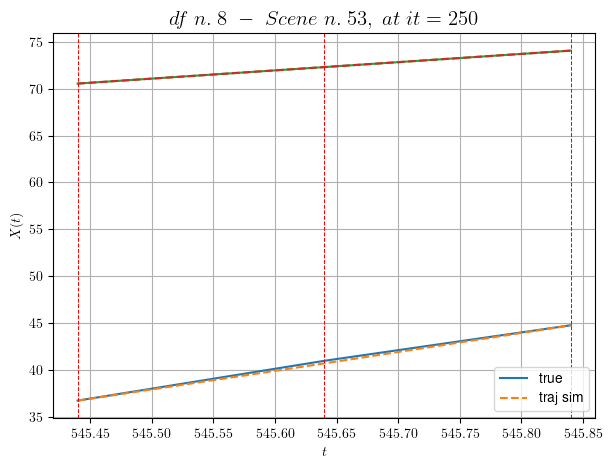

----------------------------------------------------------------------------------------------------
        For scene 44/52:
        * After LR finder: LR_NN=0.005 with mse=15.003351069498079 at it=24
        * v0 = 8.800949247287214
        * MSE = 0.012452278861646734
        * iterations = 250
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.45/52
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [278.64,279.64]


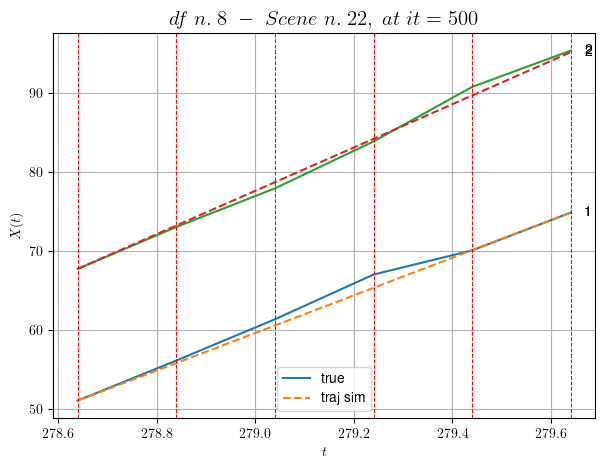

----------------------------------------------------------------------------------------------------
        For scene 45/52:
        * After LR finder: LR_NN=0.0005 with mse=3.9435183949871897 at it=24
        * v0 = 27.407259315732734
        * MSE = 0.4607425412800472
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.46/52
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [48.04,48.84]


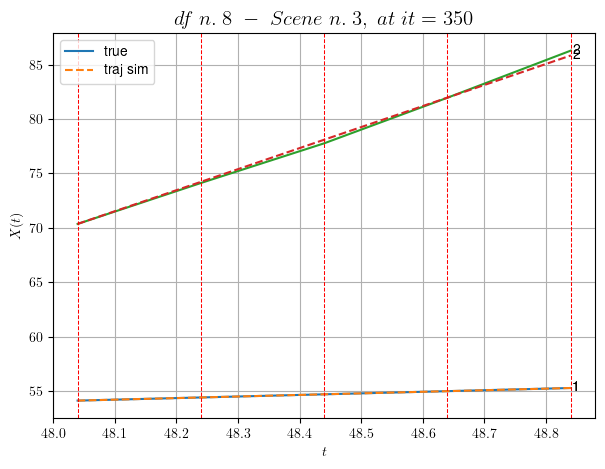

----------------------------------------------------------------------------------------------------
        For scene 46/52:
        * After LR finder: LR_NN=0.01 with mse=13.17856254382189 at it=24
        * v0 = 19.366199429857964
        * MSE = 0.02887728133310406
        * iterations = 350
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.47/52
----------------------------------------------------------------------------------------------------
We have 6 time intervals inside [283.84,285.04]


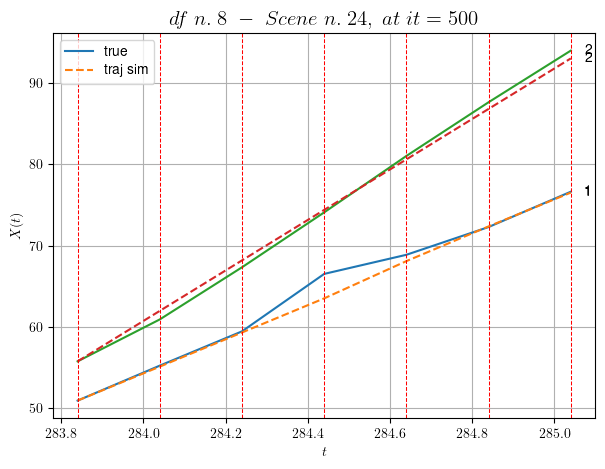

----------------------------------------------------------------------------------------------------
        For scene 47/52:
        * After LR finder: LR_NN=0.005 with mse=1.6497866177788585 at it=24
        * v0 = 31.024373752742626
        * MSE = 0.9450610616191086
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.48/52
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [276.64,277.64]


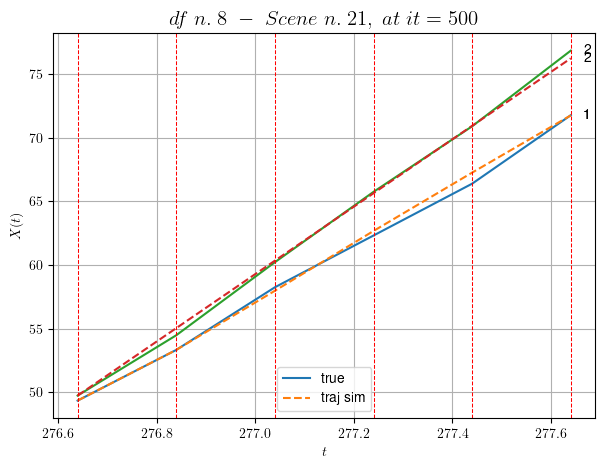

----------------------------------------------------------------------------------------------------
        For scene 48/52:
        * After LR finder: LR_NN=0.005 with mse=2.141289767364757 at it=24
        * v0 = 26.49050884606435
        * MSE = 0.13321140041380844
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.49/52
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [102.24,103.04]


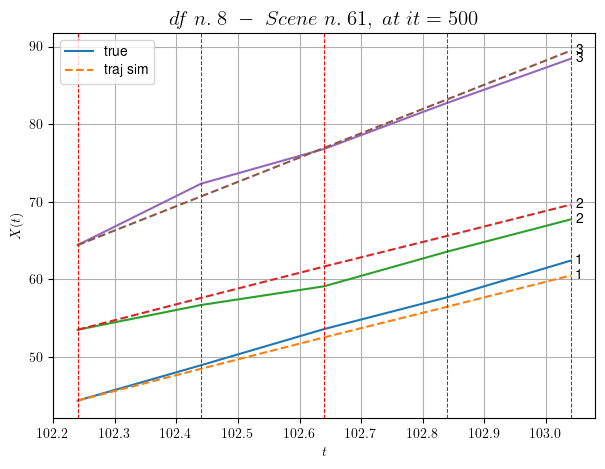

----------------------------------------------------------------------------------------------------
        For scene 49/52:
        * After LR finder: LR_NN=0.005 with mse=1.7334217228353797 at it=24
        * v0 = 31.34829198332158
        * MSE = 1.6923446764591359
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.50/52
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [290.84,291.44]


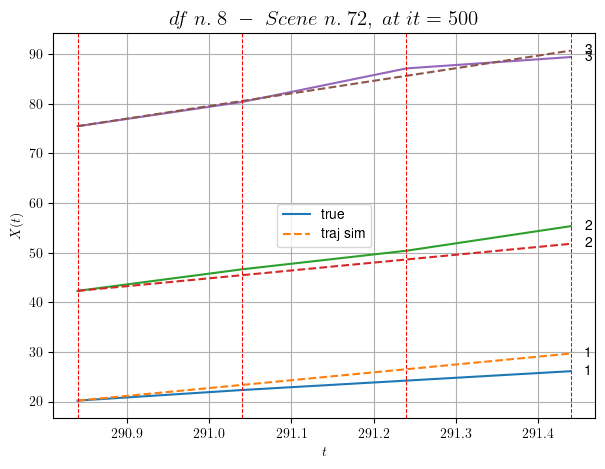

----------------------------------------------------------------------------------------------------
        For scene 50/52:
        * After LR finder: LR_NN=0.0005 with mse=2.4026603969633817 at it=24
        * v0 = 25.37824427977473
        * MSE = 3.3359625439662044
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.51/52
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [178.44,179.24]


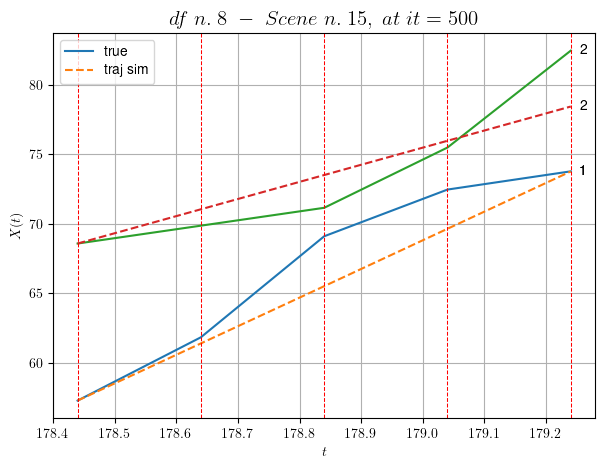

----------------------------------------------------------------------------------------------------
        For scene 51/52:
        * After LR finder: LR_NN=0.0001 with mse=35.477848588565756 at it=24
        * v0 = 12.30898288993194
        * MSE = 4.429757111297634
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.52/52
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [536.64,537.24]


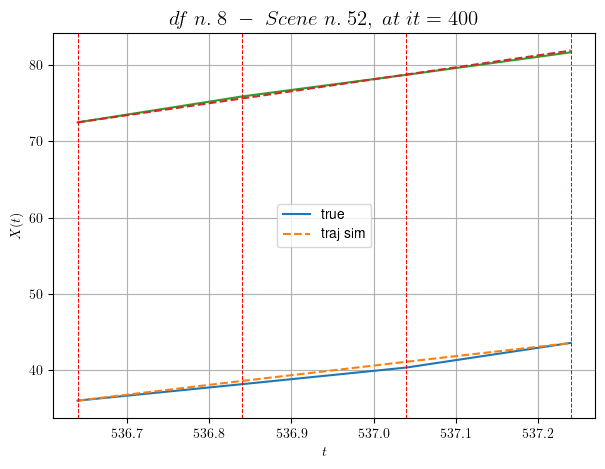

----------------------------------------------------------------------------------------------------
        For scene 52/52:
        * After LR finder: LR_NN=0.005 with mse=14.814061213637249 at it=24
        * v0 = 15.683354901824034
        * MSE = 0.10652591256382996
        * iterations = 400
----------------------------------------------------------------------------------------------------


MSE train: 1.8679799637117585
- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -

Testing step. (27 scenes)
DataFrame n.8. Scene n.1/27


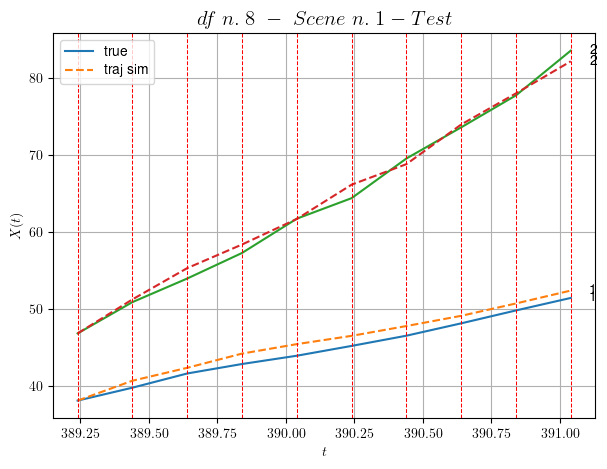

        For scene 1/27:
        * MSE = 1.0164541415784738
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.2/27


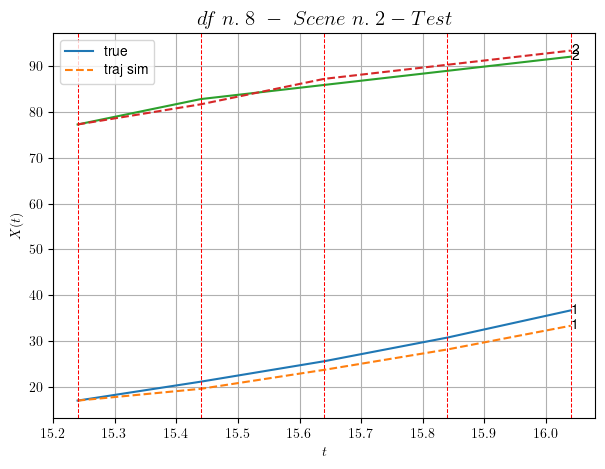

        For scene 2/27:
        * MSE = 3.0608191957205193
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.3/27


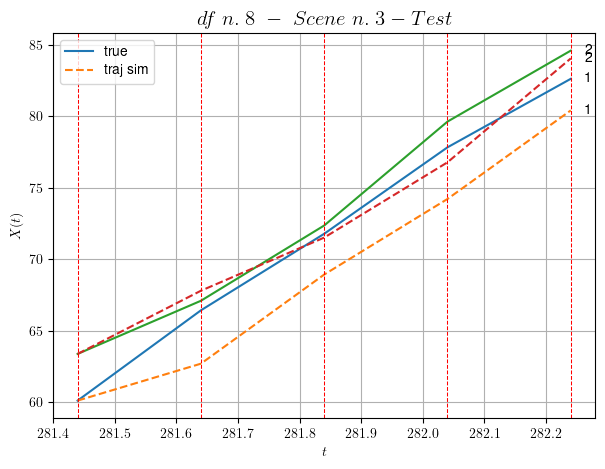

        For scene 3/27:
        * MSE = 4.950139327424785
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.4/27


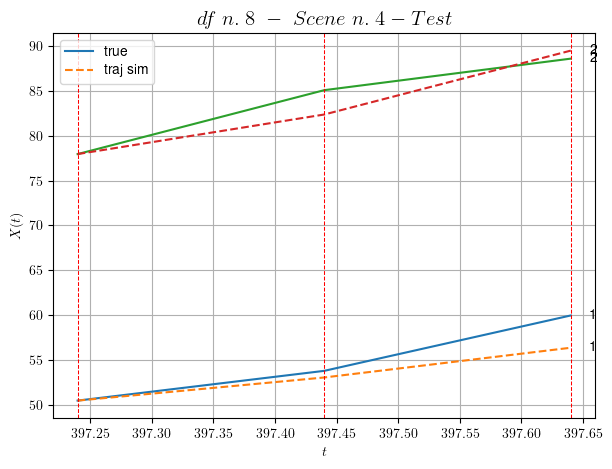

        For scene 4/27:
        * MSE = 3.6152054324333847
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.5/27


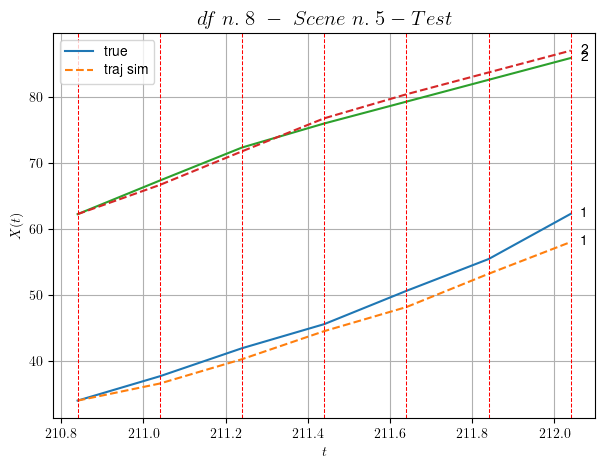

        For scene 5/27:
        * MSE = 2.8078945184740833
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.6/27


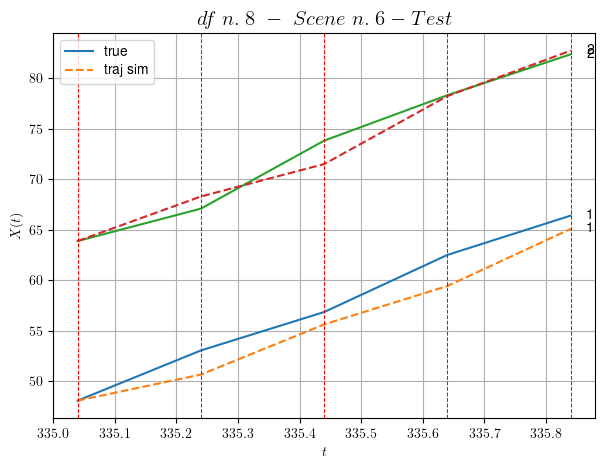

        For scene 6/27:
        * MSE = 2.5401641571380327
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.7/27


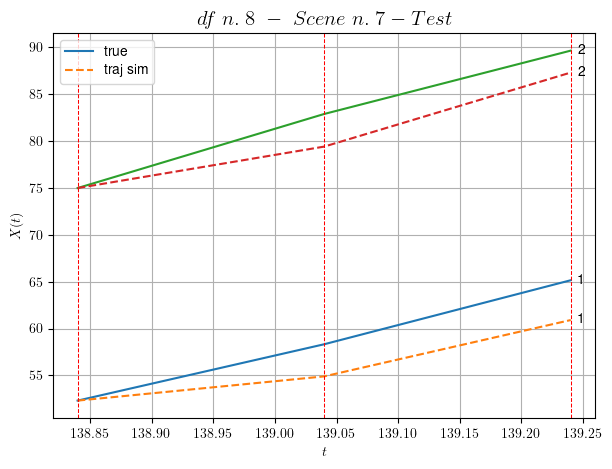

        For scene 7/27:
        * MSE = 7.871425015797367
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.8/27


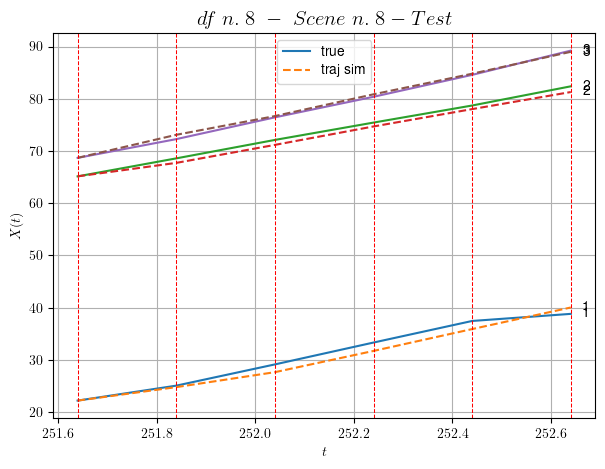

        For scene 8/27:
        * MSE = 0.7615034107562445
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.9/27


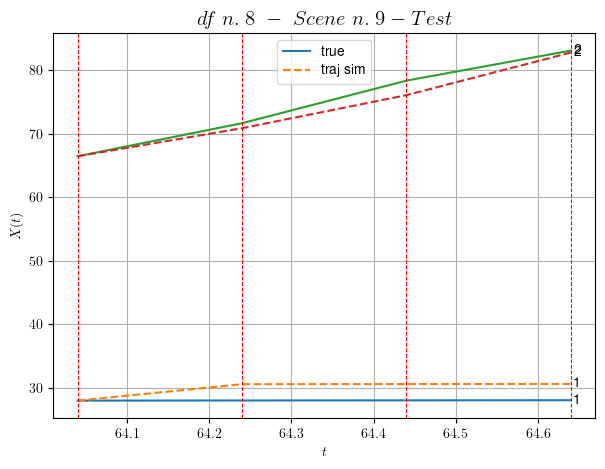

        For scene 9/27:
        * MSE = 3.2000682074497266
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.10/27


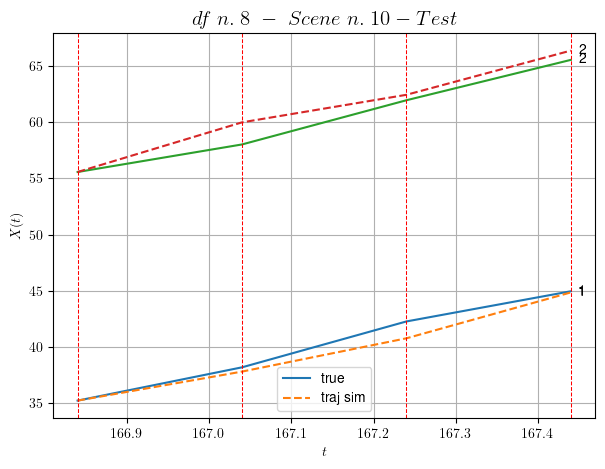

        For scene 10/27:
        * MSE = 0.8976347770948989
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.11/27


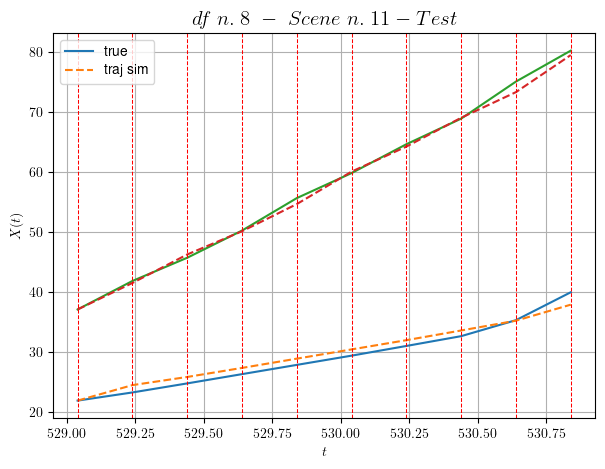

        For scene 11/27:
        * MSE = 0.8647058119088429
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.12/27


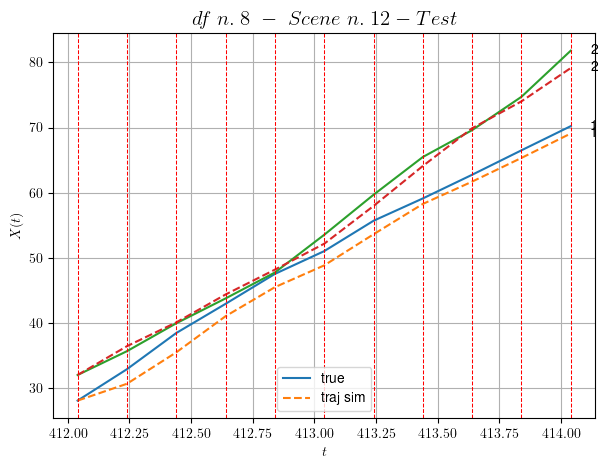

        For scene 12/27:
        * MSE = 2.3020483173167627
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.13/27


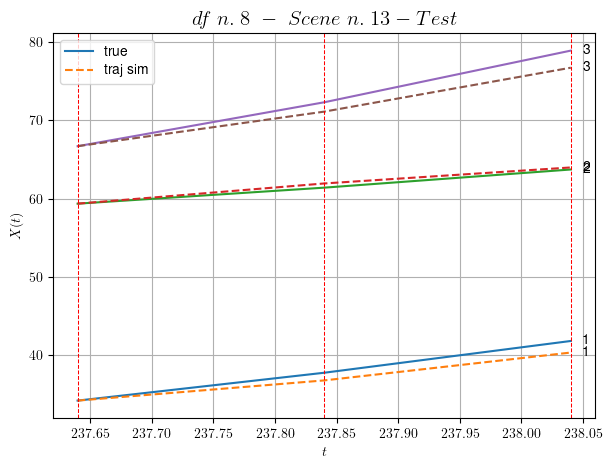

        For scene 13/27:
        * MSE = 1.077673739391743
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.14/27


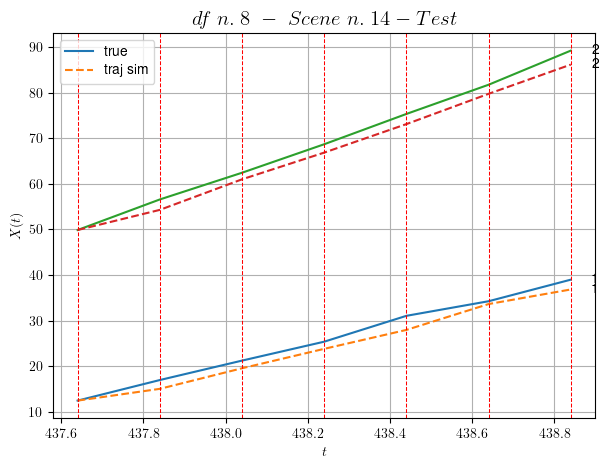

        For scene 14/27:
        * MSE = 3.7526574006430145
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.15/27


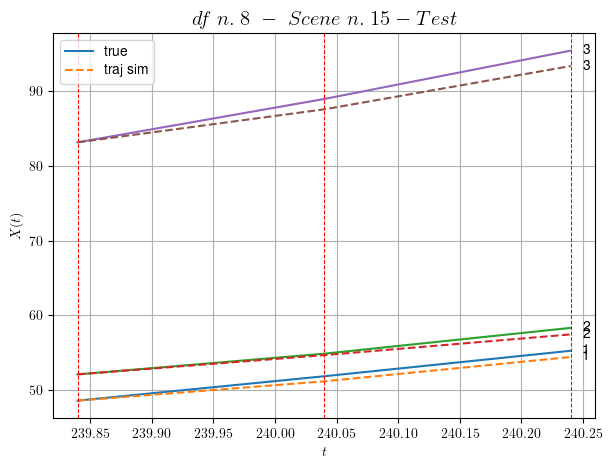

        For scene 15/27:
        * MSE = 0.9024303520408116
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.16/27


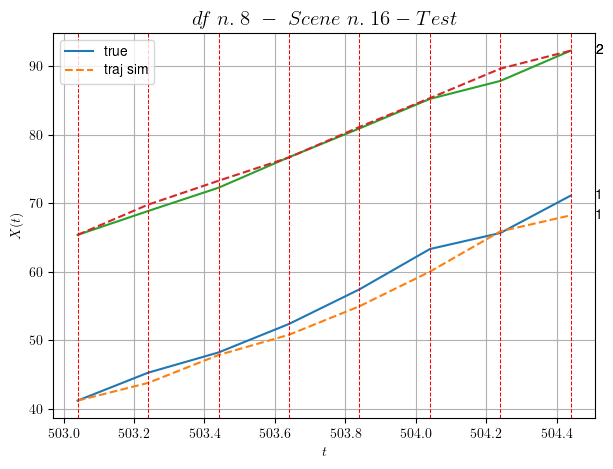

        For scene 16/27:
        * MSE = 2.213152679511053
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.17/27


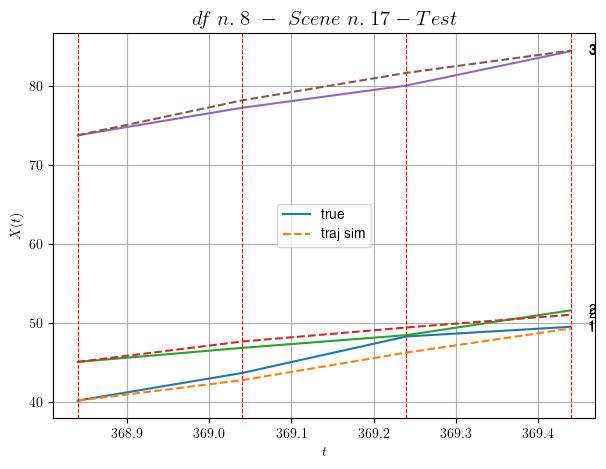

        For scene 17/27:
        * MSE = 0.864976613522901
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.18/27


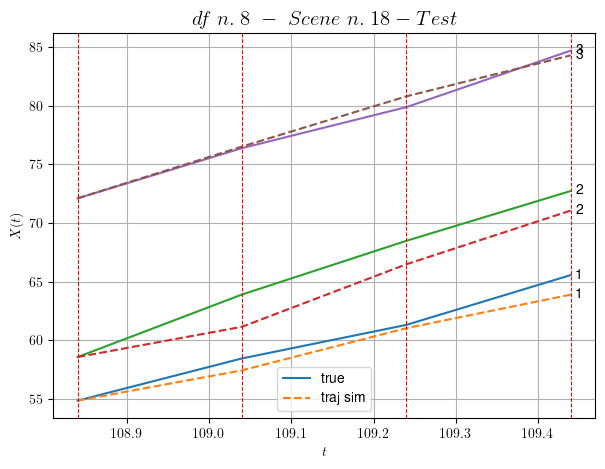

        For scene 18/27:
        * MSE = 1.604857458870147
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.19/27


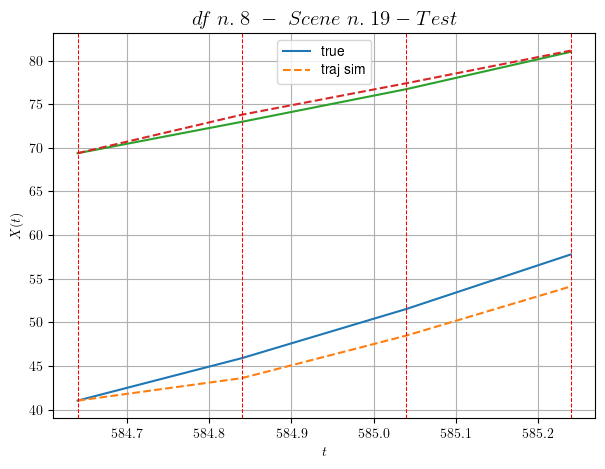

        For scene 19/27:
        * MSE = 3.6432254851389008
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.20/27


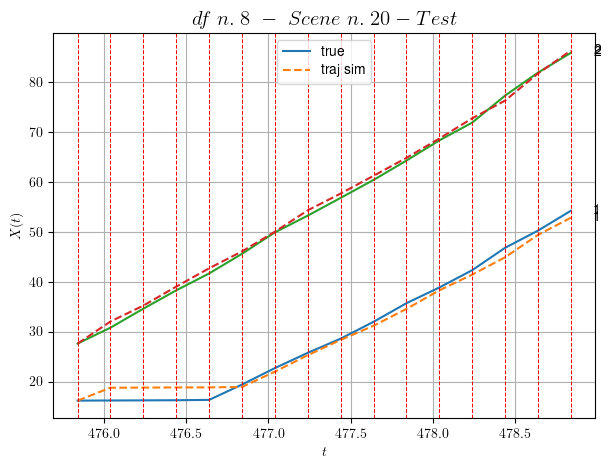

        For scene 20/27:
        * MSE = 1.4054063633207554
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.21/27


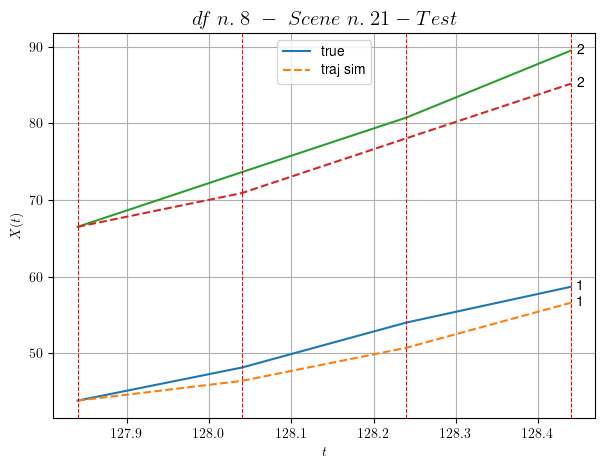

        For scene 21/27:
        * MSE = 6.470198619584782
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.22/27


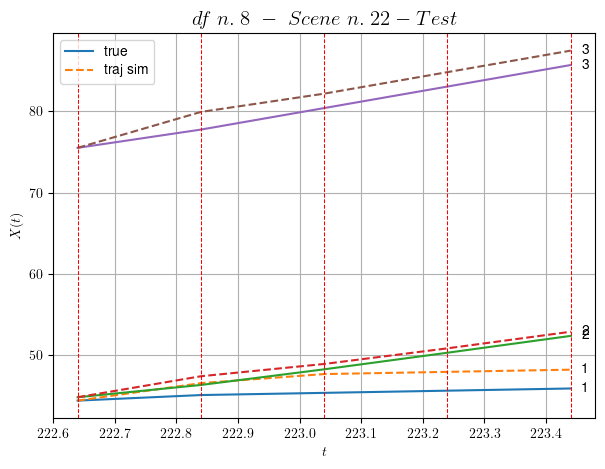

        For scene 22/27:
        * MSE = 2.2943968149153315
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.23/27


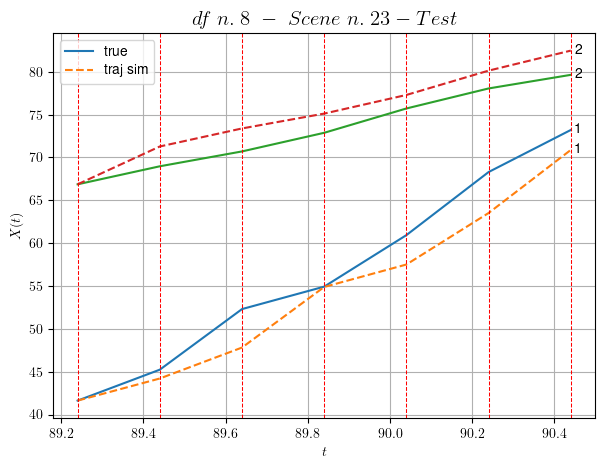

        For scene 23/27:
        * MSE = 6.686689247909245
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.24/27


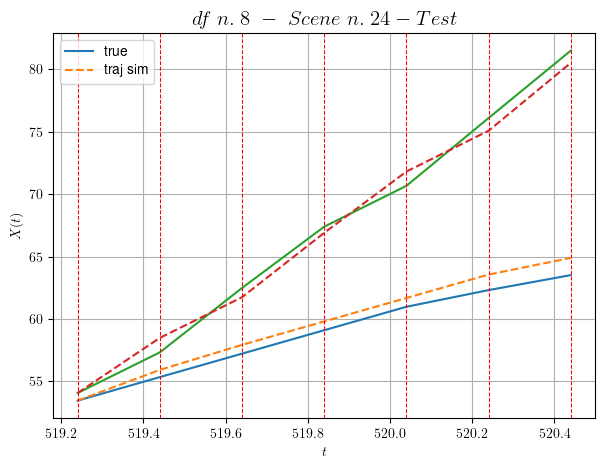

        For scene 24/27:
        * MSE = 0.7668168232546659
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.25/27


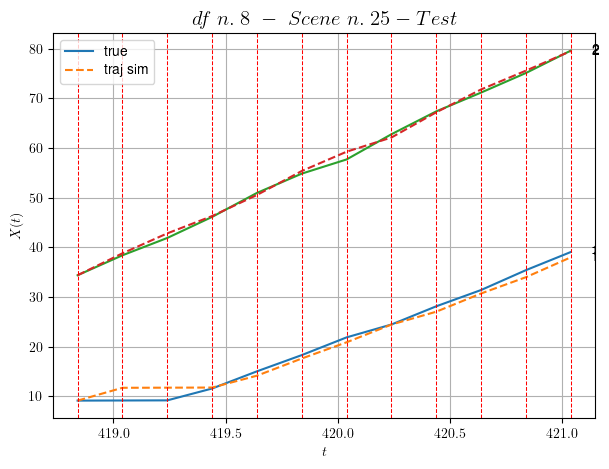

        For scene 25/27:
        * MSE = 1.04936274615792
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.26/27


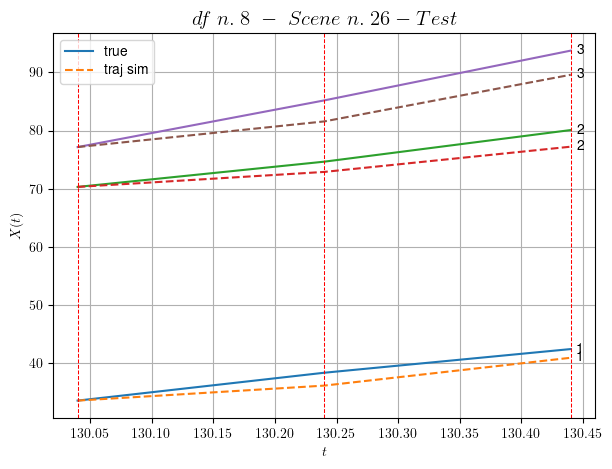

        For scene 26/27:
        * MSE = 5.42175720726577
----------------------------------------------------------------------------------------------------


DataFrame n.8. Scene n.27/27


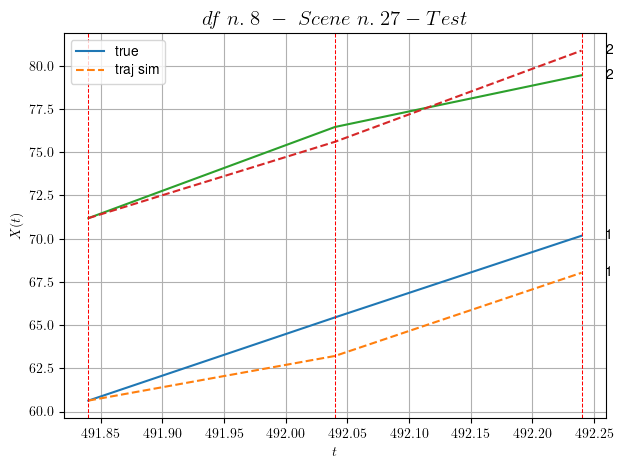

        For scene 27/27:
        * MSE = 2.0516376117772688
----------------------------------------------------------------------------------------------------


MSE test: 2.7441963509776826

- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -

    Summing up:
          * MSE train: 1.8679799637117585
          * MSE test: 2.7441963509776826
          
- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -




Analyzing 9/10 dfs.
In DataFrame n.9 we have 33 scenes.
    To train the model we use 22 scenes, the remaining 11 to test the model.

Training step. (22 scenes)
DataFrame n.9. Scene n.1/22
----------------------------------------------------------------------------------------------------
We have 18 time intervals inside [172.60,176.20]


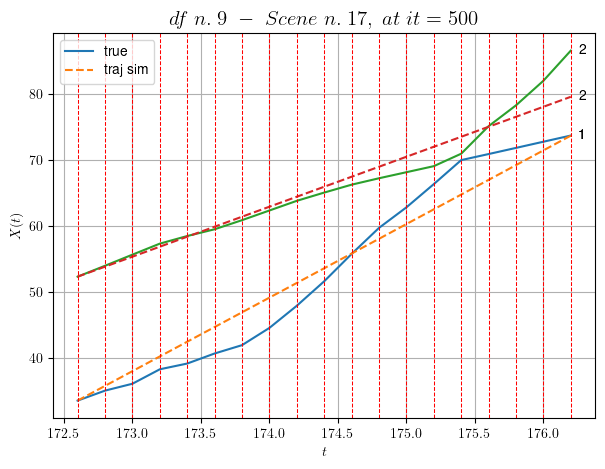

----------------------------------------------------------------------------------------------------
        For scene 1/22:
        * After LR finder: LR_NN=0.001 with mse=1107.2403896346477 at it=24
        * v0 = 7.579600948718953
        * MSE = 6.986304632862444
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.2/22
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [57.80,58.20]


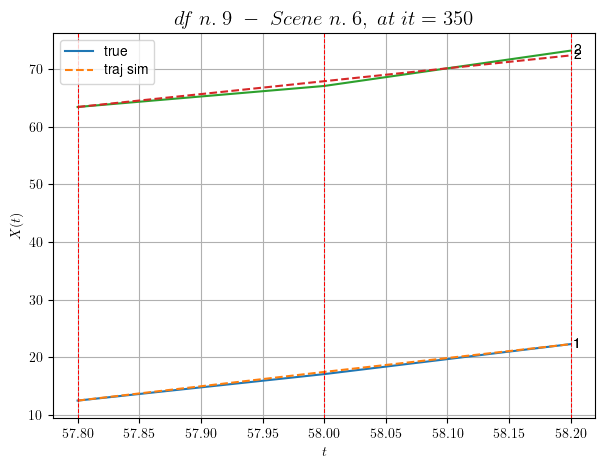

----------------------------------------------------------------------------------------------------
        For scene 2/22:
        * After LR finder: LR_NN=0.005 with mse=1.768036387089294 at it=24
        * v0 = 22.383621783859834
        * MSE = 0.23269420721666004
        * iterations = 350
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.3/22
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [155.40,156.40]


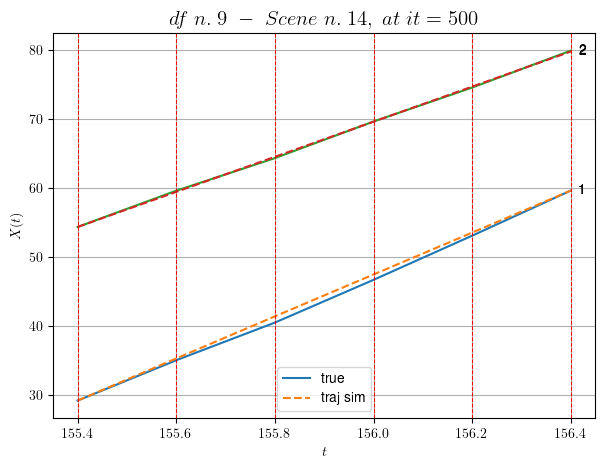

----------------------------------------------------------------------------------------------------
        For scene 3/22:
        * After LR finder: LR_NN=0.001 with mse=4.0024650555962875 at it=24
        * v0 = 25.423521542135635
        * MSE = 0.1482568565161157
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.4/22
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [143.60,144.00]


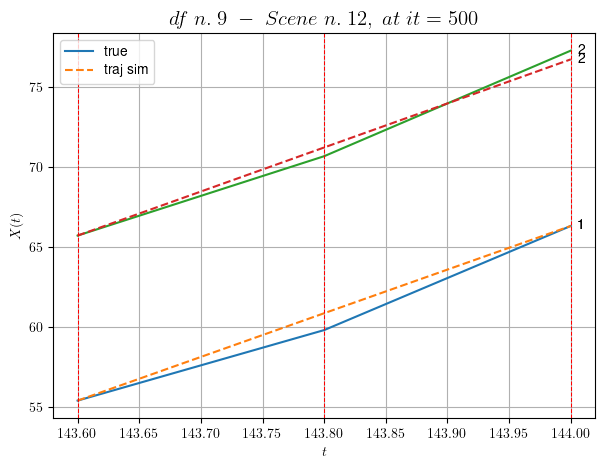

----------------------------------------------------------------------------------------------------
        For scene 4/22:
        * After LR finder: LR_NN=0.0001 with mse=0.40401483125867144 at it=24
        * v0 = 27.47606787617002
        * MSE = 0.2831442461346597
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.5/22
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [5.40,6.00]


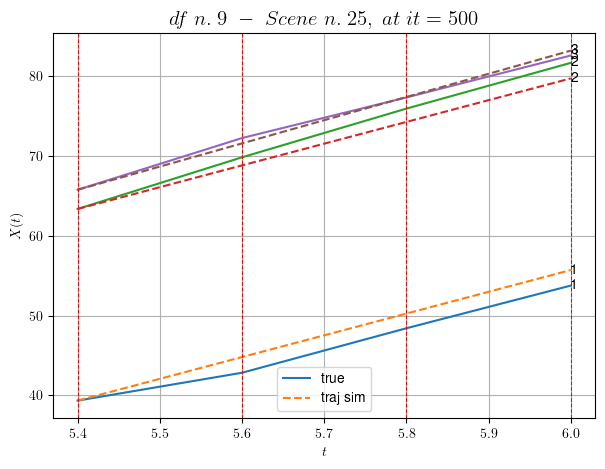

----------------------------------------------------------------------------------------------------
        For scene 5/22:
        * After LR finder: LR_NN=0.0005 with mse=22.443265320265045 at it=24
        * v0 = 29.081107080157096
        * MSE = 1.6263075660891273
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.6/22
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [19.80,20.20]


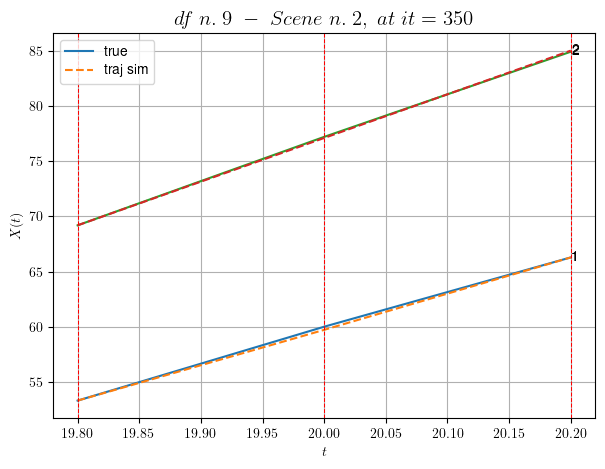

----------------------------------------------------------------------------------------------------
        For scene 6/22:
        * After LR finder: LR_NN=0.005 with mse=3.0560238677411 at it=24
        * v0 = 39.645705865285116
        * MSE = 0.016923243515715388
        * iterations = 350
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.7/22
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [30.80,31.20]


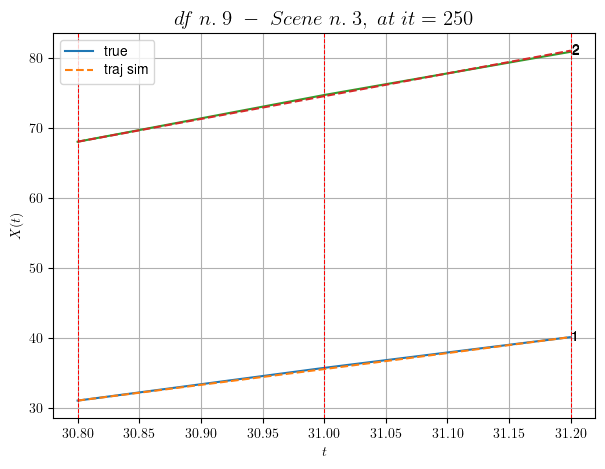

----------------------------------------------------------------------------------------------------
        For scene 7/22:
        * After LR finder: LR_NN=0.005 with mse=0.2011084328495996 at it=24
        * v0 = 32.535915603889215
        * MSE = 0.013814148494808873
        * iterations = 250
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.8/22
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [119.20,119.60]


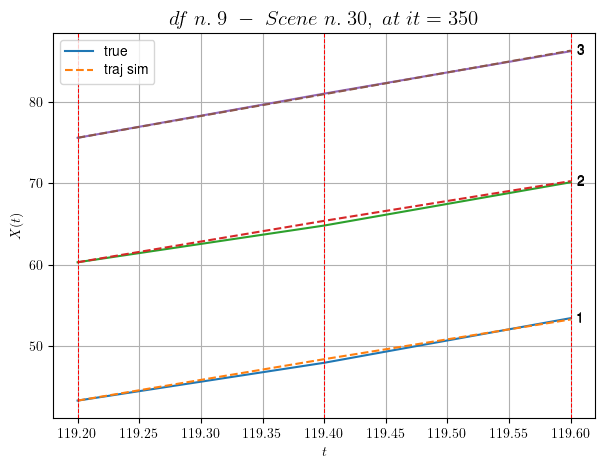

----------------------------------------------------------------------------------------------------
        For scene 8/22:
        * After LR finder: LR_NN=0.005 with mse=0.3201535111483181 at it=24
        * v0 = 26.734613425844103
        * MSE = 0.064928007676179
        * iterations = 350
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.9/22
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [36.60,37.60]


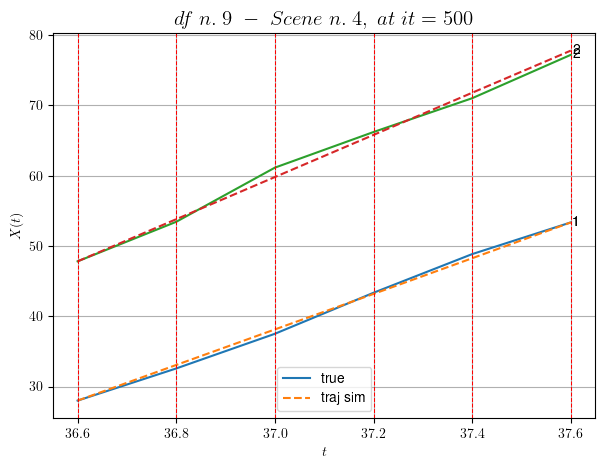

----------------------------------------------------------------------------------------------------
        For scene 9/22:
        * After LR finder: LR_NN=0.001 with mse=0.3446346379358872 at it=24
        * v0 = 29.981948107113627
        * MSE = 0.33862602033656397
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.10/22
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [44.40,44.80]


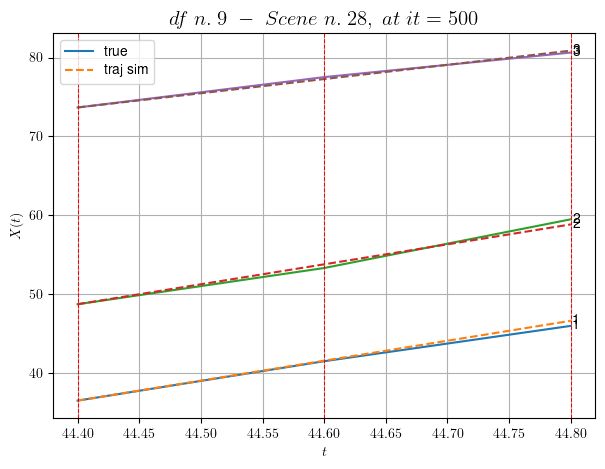

----------------------------------------------------------------------------------------------------
        For scene 10/22:
        * After LR finder: LR_NN=0.0001 with mse=5.457196872429216 at it=24
        * v0 = 18.01610672050793
        * MSE = 0.130952378808752
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.11/22
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [225.20,226.00]


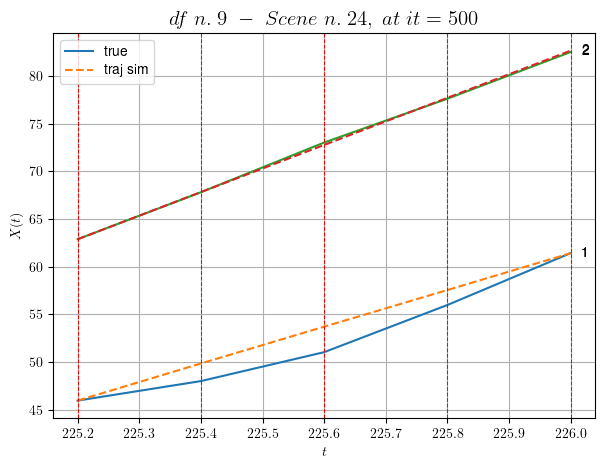

----------------------------------------------------------------------------------------------------
        For scene 11/22:
        * After LR finder: LR_NN=0.0005 with mse=4.470732442878662 at it=24
        * v0 = 24.737876605773167
        * MSE = 1.3069566824628653
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.12/22
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [120.20,120.60]


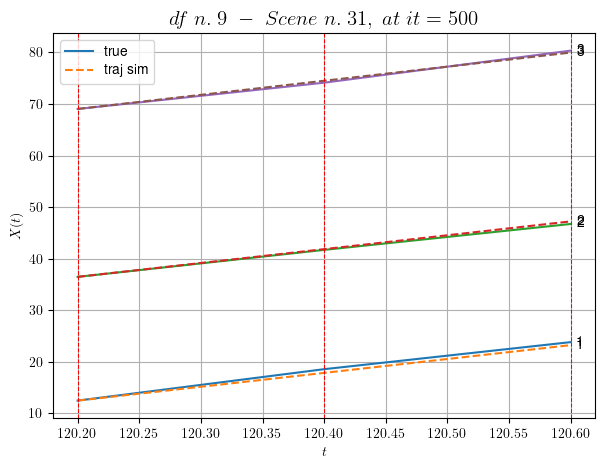

----------------------------------------------------------------------------------------------------
        For scene 12/22:
        * After LR finder: LR_NN=5e-05 with mse=1.6034798412204514 at it=24
        * v0 = 27.348987307571388
        * MSE = 0.156355457983133
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.13/22
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [219.80,220.20]


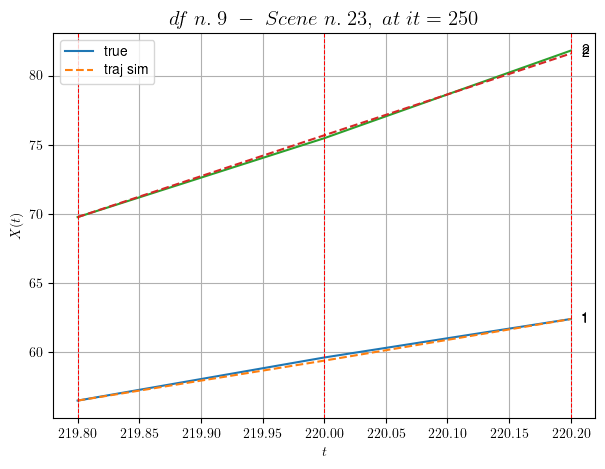

----------------------------------------------------------------------------------------------------
        For scene 13/22:
        * After LR finder: LR_NN=0.01 with mse=0.023803582054925165 at it=24
        * v0 = 29.573993712253266
        * MSE = 0.020605238978773834
        * iterations = 250
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.14/22
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [191.20,192.20]


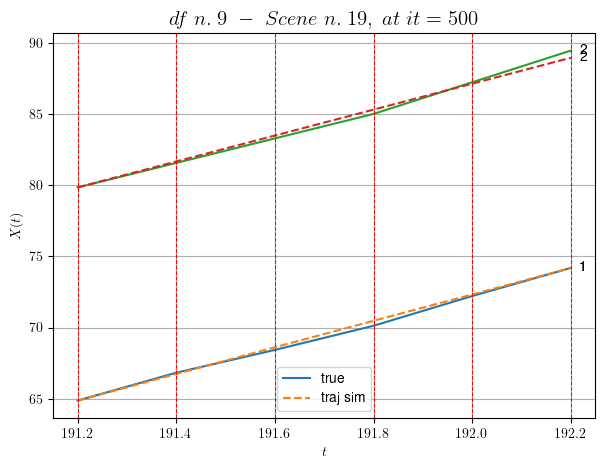

----------------------------------------------------------------------------------------------------
        For scene 14/22:
        * After LR finder: LR_NN=0.005 with mse=78.9495450638573 at it=24
        * v0 = 9.117095848783872
        * MSE = 0.04637249724390117
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.15/22
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [20.80,21.20]


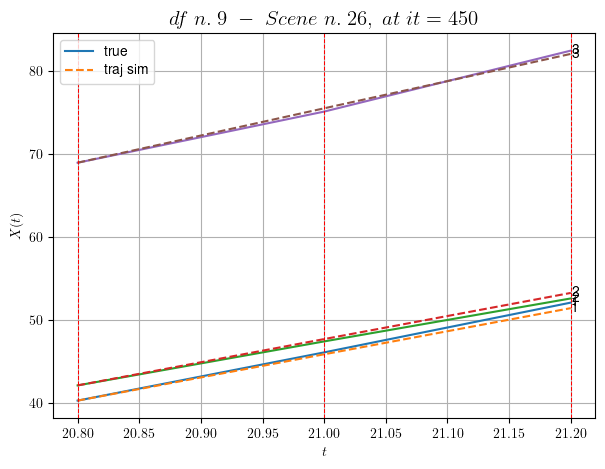

----------------------------------------------------------------------------------------------------
        For scene 15/22:
        * After LR finder: LR_NN=0.01 with mse=0.36135918452784416 at it=24
        * v0 = 32.733311025125886
        * MSE = 0.14752597624909122
        * iterations = 450
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.16/22
----------------------------------------------------------------------------------------------------
We have 8 time intervals inside [82.40,84.00]


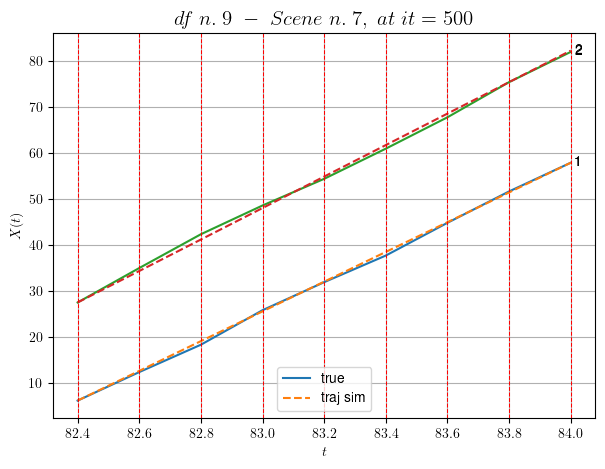

----------------------------------------------------------------------------------------------------
        For scene 16/22:
        * After LR finder: LR_NN=5e-05 with mse=7.835680826803386 at it=24
        * v0 = 34.294801544759714
        * MSE = 0.26163337361857386
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.17/22
----------------------------------------------------------------------------------------------------
We have 6 time intervals inside [197.60,198.80]


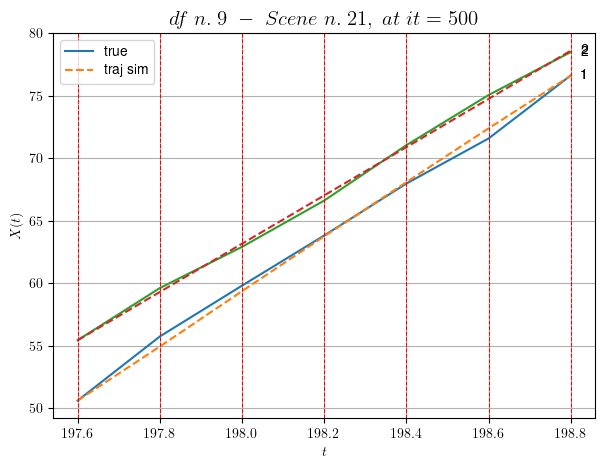

----------------------------------------------------------------------------------------------------
        For scene 17/22:
        * After LR finder: LR_NN=0.005 with mse=29.848909886616806 at it=24
        * v0 = 19.310295514409272
        * MSE = 0.14121825294195423
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.18/22
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [205.80,206.20]


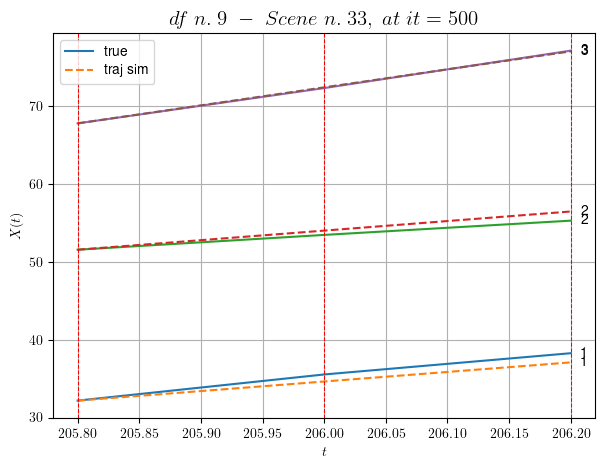

----------------------------------------------------------------------------------------------------
        For scene 18/22:
        * After LR finder: LR_NN=0.0005 with mse=1.3326740574268705 at it=24
        * v0 = 23.15865117600601
        * MSE = 0.43535741860832794
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.19/22
----------------------------------------------------------------------------------------------------
We have 7 time intervals inside [117.00,118.40]


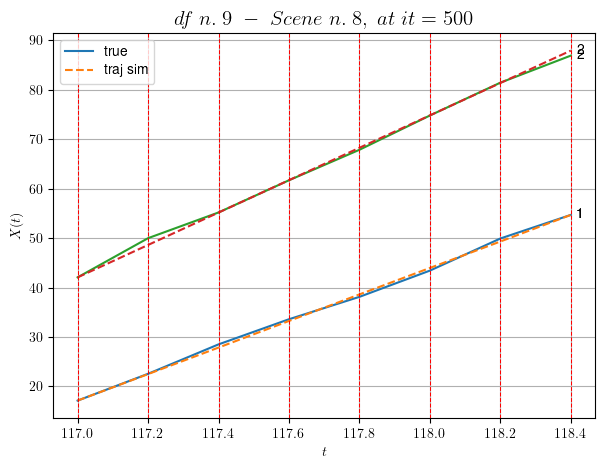

----------------------------------------------------------------------------------------------------
        For scene 19/22:
        * After LR finder: LR_NN=0.001 with mse=2.44458317588733 at it=24
        * v0 = 32.746751311390014
        * MSE = 0.26652867691639315
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.20/22
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [140.00,140.40]


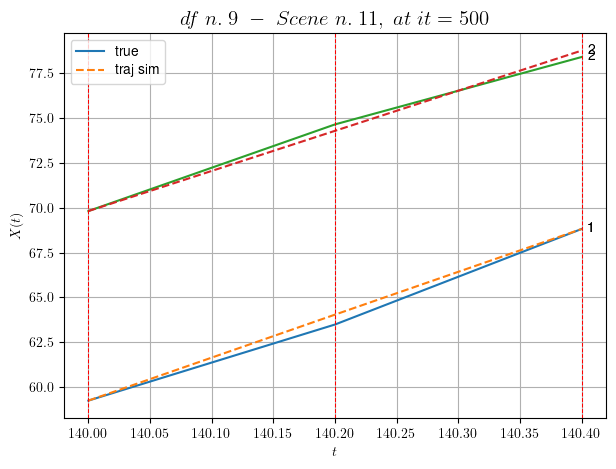

----------------------------------------------------------------------------------------------------
        For scene 20/22:
        * After LR finder: LR_NN=0.0005 with mse=2.2772220768456353 at it=24
        * v0 = 22.365188336410537
        * MSE = 0.09304560802837833
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.21/22
----------------------------------------------------------------------------------------------------
We have 6 time intervals inside [161.60,162.80]


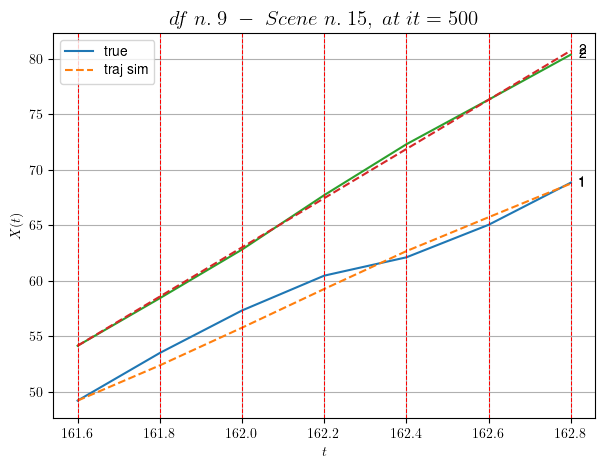

----------------------------------------------------------------------------------------------------
        For scene 21/22:
        * After LR finder: LR_NN=0.01 with mse=16.387084355263646 at it=24
        * v0 = 22.164023913692947
        * MSE = 0.4013071369991626
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.22/22
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [117.80,118.40]


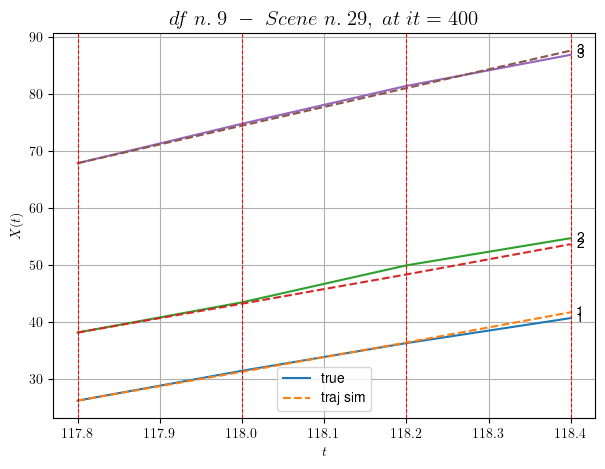

----------------------------------------------------------------------------------------------------
        For scene 22/22:
        * After LR finder: LR_NN=0.005 with mse=0.8031656621184032 at it=24
        * v0 = 32.94782183132004
        * MSE = 0.46190683689351414
        * iterations = 400
----------------------------------------------------------------------------------------------------


MSE train: 0.6173074756625043
- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -

Testing step. (11 scenes)
DataFrame n.9. Scene n.1/11


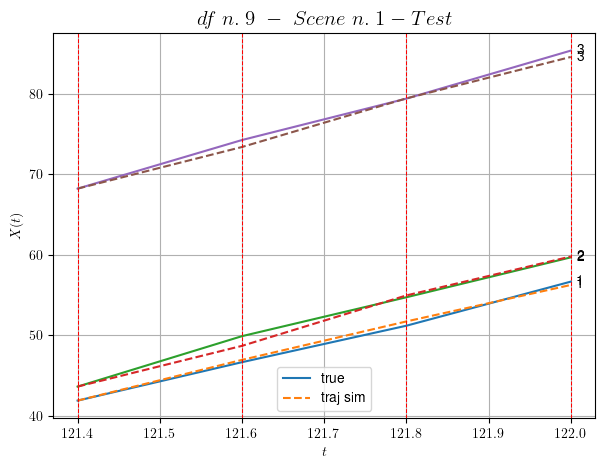

        For scene 1/11:
        * MSE = 0.28546317559977713
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.2/11


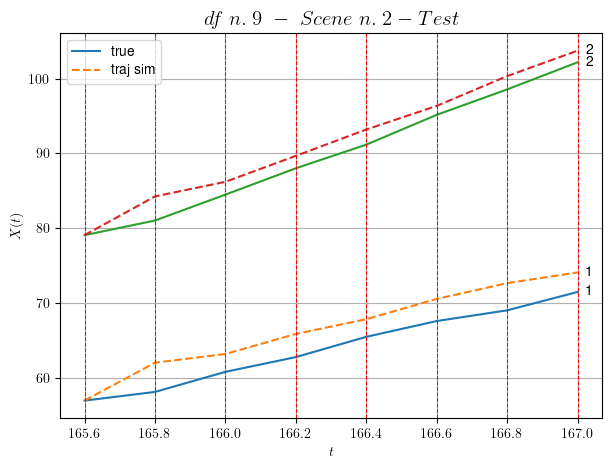

        For scene 2/11:
        * MSE = 5.742271391278653
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.3/11


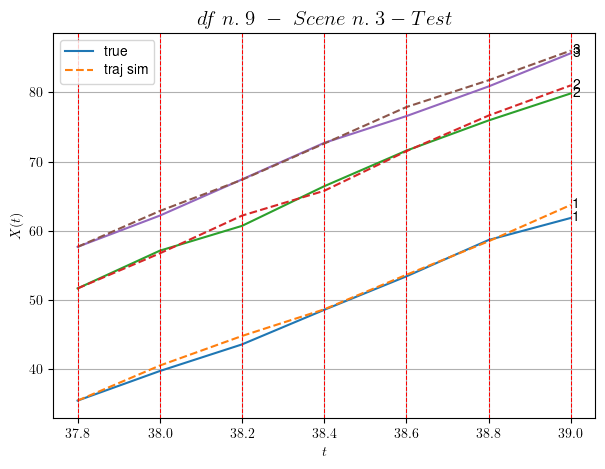

        For scene 3/11:
        * MSE = 0.6416495241907908
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.4/11


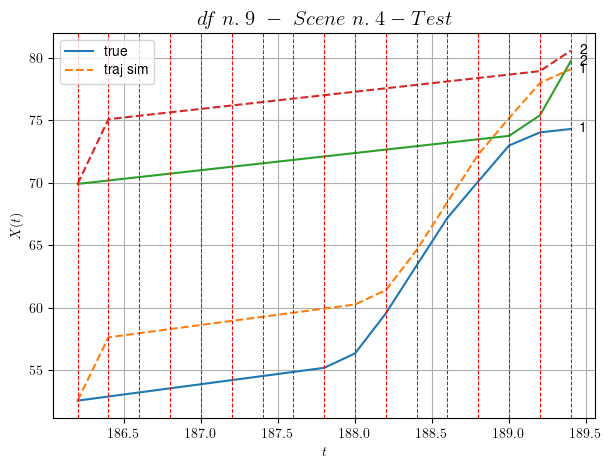

        For scene 4/11:
        * MSE = 17.614665646115835
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.5/11


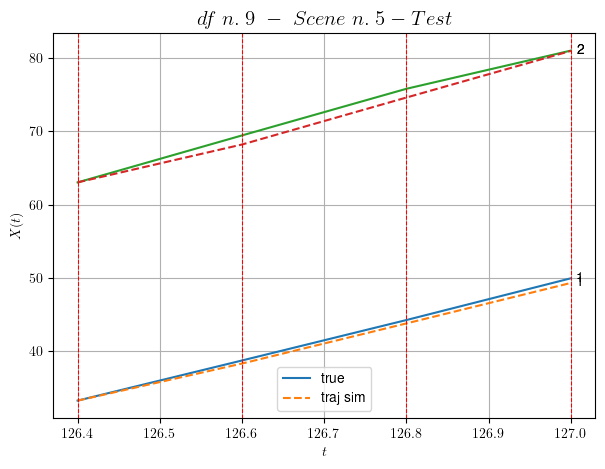

        For scene 5/11:
        * MSE = 0.47128351997726814
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.6/11


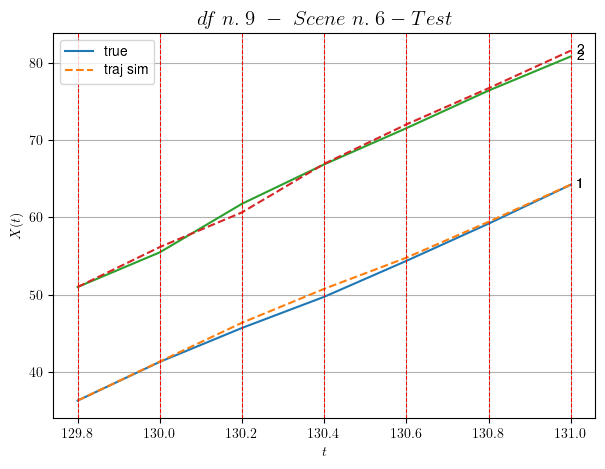

        For scene 6/11:
        * MSE = 0.31150434360353296
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.7/11


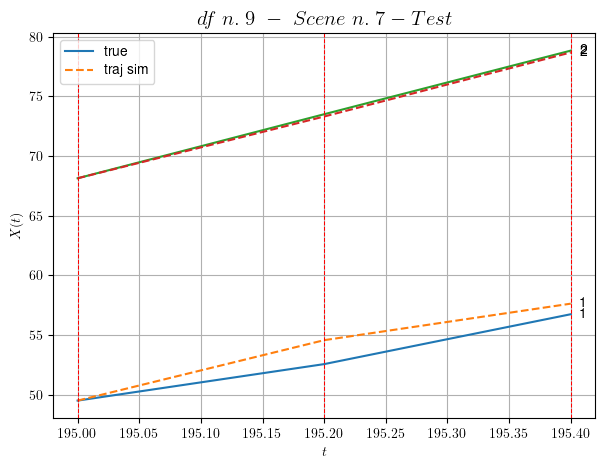

        For scene 7/11:
        * MSE = 0.8113900451460535
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.8/11


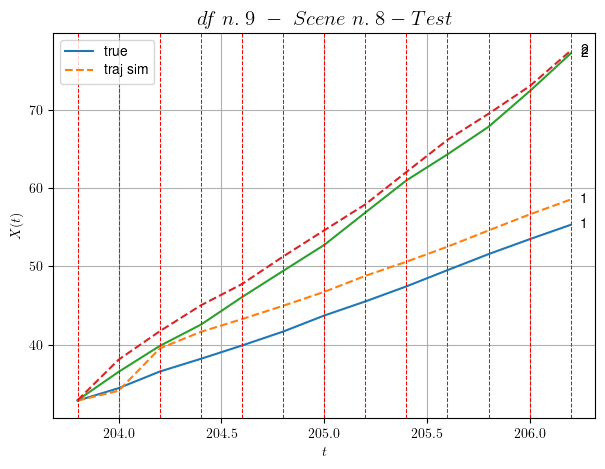

        For scene 8/11:
        * MSE = 5.441376609488012
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.9/11


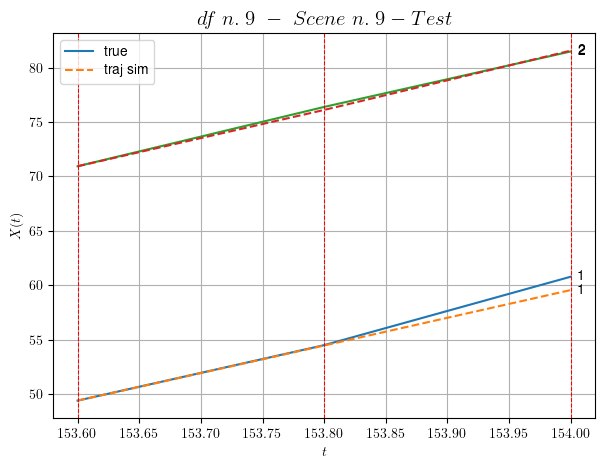

        For scene 9/11:
        * MSE = 0.2643942101960628
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.10/11


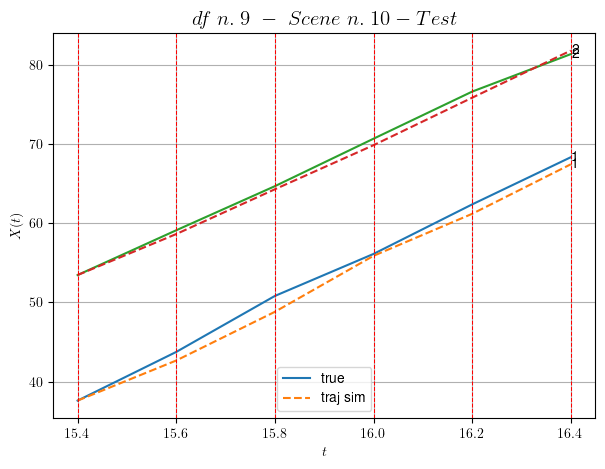

        For scene 10/11:
        * MSE = 0.7738502166353026
----------------------------------------------------------------------------------------------------


DataFrame n.9. Scene n.11/11


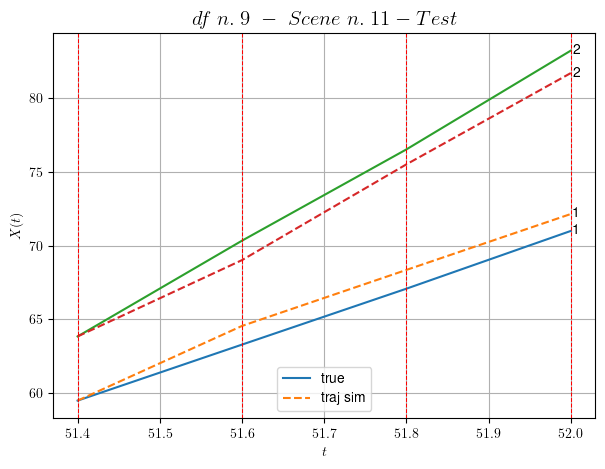

        For scene 11/11:
        * MSE = 1.2033481265413066
----------------------------------------------------------------------------------------------------


MSE test: 3.0510178917065995

- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -

    Summing up:
          * MSE train: 0.6173074756625043
          * MSE test: 3.0510178917065995
          
- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -




Analyzing 10/10 dfs.
In DataFrame n.10 we have 74 scenes.
    To train the model we use 49 scenes, the remaining 25 to test the model.

Training step. (49 scenes)
DataFrame n.10. Scene n.1/49
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [81.72,82.52]


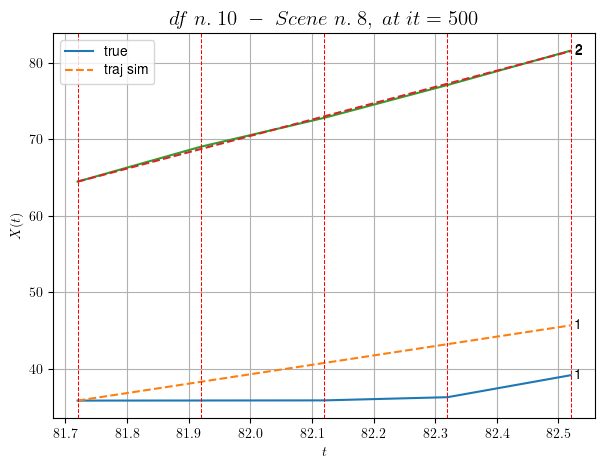

----------------------------------------------------------------------------------------------------
        For scene 1/49:
        * After LR finder: LR_NN=1e-05 with mse=9.540482006609363 at it=24
        * v0 = 21.364063026712998
        * MSE = 12.096798188177722
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.2/49
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [194.52,195.12]


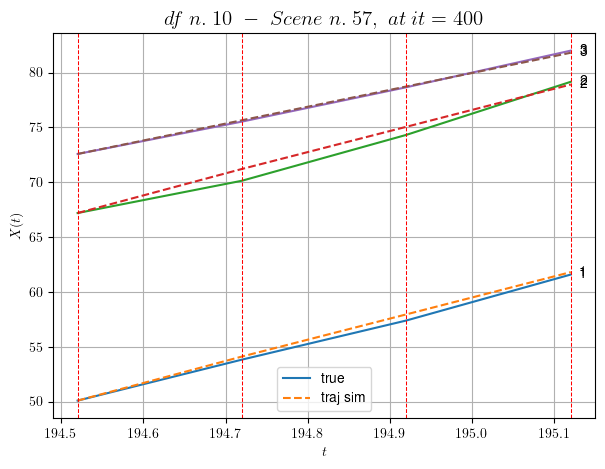

----------------------------------------------------------------------------------------------------
        For scene 2/49:
        * After LR finder: LR_NN=0.005 with mse=10.019263953041577 at it=24
        * v0 = 15.385065513726987
        * MSE = 0.18520517338006118
        * iterations = 400
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.3/49
----------------------------------------------------------------------------------------------------
We have 8 time intervals inside [450.52,452.12]


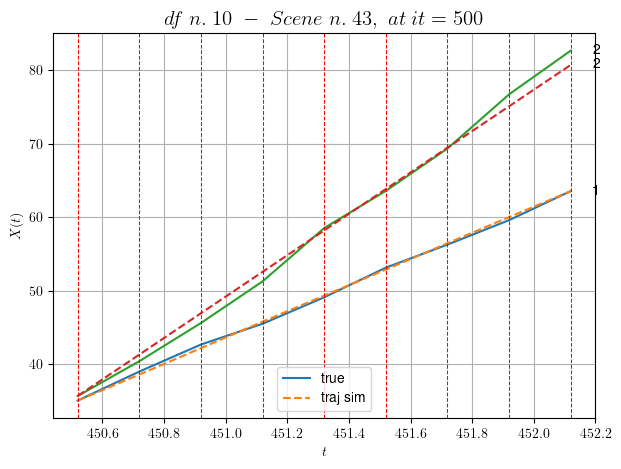

----------------------------------------------------------------------------------------------------
        For scene 3/49:
        * After LR finder: LR_NN=0.005 with mse=1.4432757156353513 at it=24
        * v0 = 28.147396988326644
        * MSE = 0.5676412055467351
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.4/49
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [305.72,306.12]


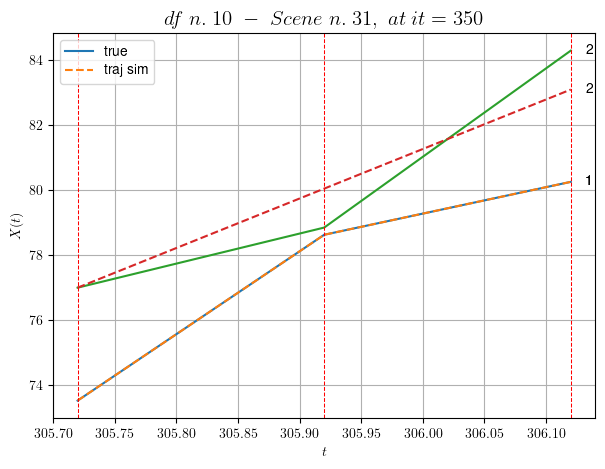

----------------------------------------------------------------------------------------------------
        For scene 4/49:
        * After LR finder: LR_NN=0.0005 with mse=6.716224522496875 at it=24
        * v0 = 15.228607431685102
        * MSE = 0.47796395992557444
        * iterations = 350
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.5/49
----------------------------------------------------------------------------------------------------
We have 8 time intervals inside [502.92,504.52]


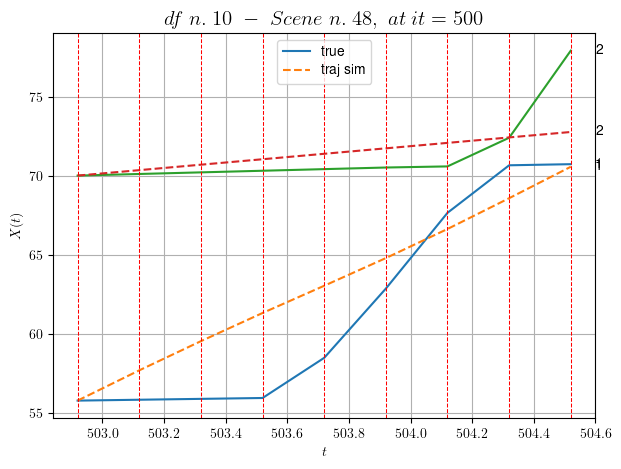

----------------------------------------------------------------------------------------------------
        For scene 5/49:
        * After LR finder: LR_NN=0.005 with mse=357.05462759304777 at it=24
        * v0 = 1.7269359387544378
        * MSE = 5.553988380757092
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.6/49
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [569.72,570.72]


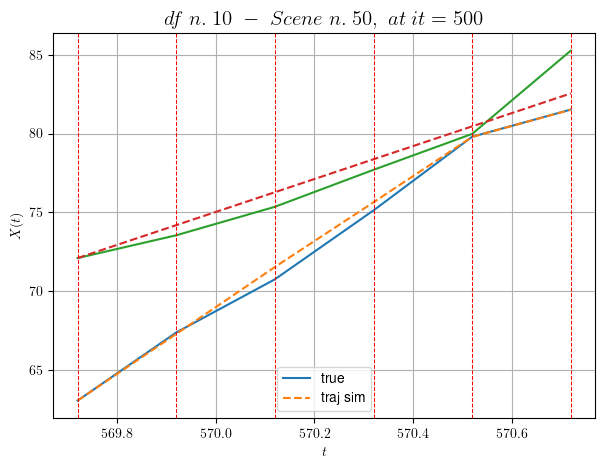

----------------------------------------------------------------------------------------------------
        For scene 6/49:
        * After LR finder: LR_NN=0.005 with mse=66.35953679991324 at it=24
        * v0 = 10.439737963466763
        * MSE = 0.7958807533819493
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.7/49
----------------------------------------------------------------------------------------------------
We have 9 time intervals inside [201.32,203.12]


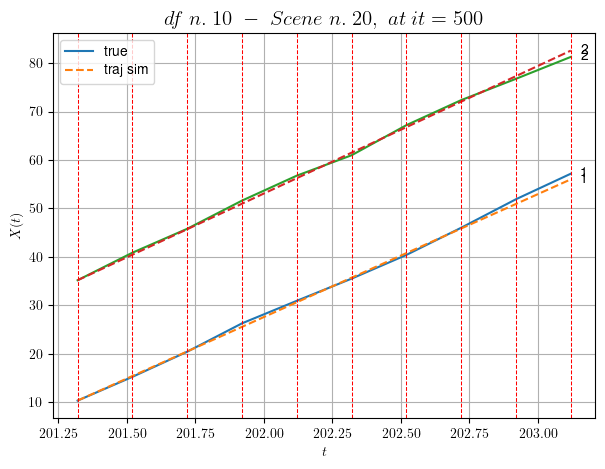

----------------------------------------------------------------------------------------------------
        For scene 7/49:
        * After LR finder: LR_NN=1e-05 with mse=8.709716333398232 at it=24
        * v0 = 26.320098161162164
        * MSE = 0.3280588690165819
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.8/49
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [236.52,237.12]


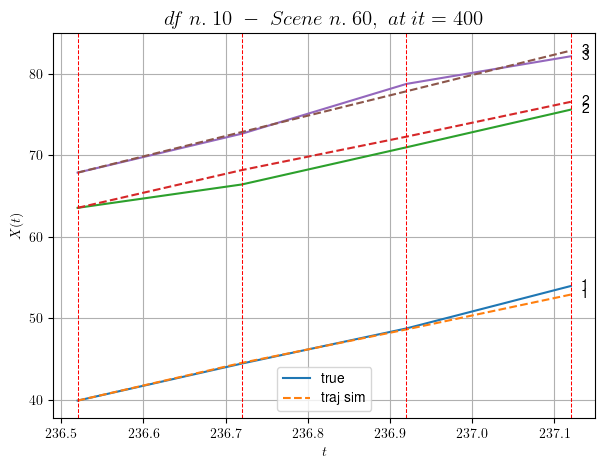

----------------------------------------------------------------------------------------------------
        For scene 8/49:
        * After LR finder: LR_NN=0.01 with mse=2.008780882975965 at it=24
        * v0 = 24.9442672771565
        * MSE = 0.6829247441140044
        * iterations = 400
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.9/49
----------------------------------------------------------------------------------------------------
We have 6 time intervals inside [275.92,277.12]


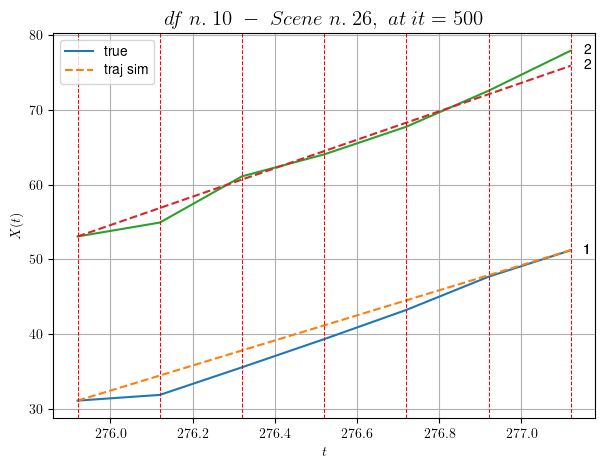

----------------------------------------------------------------------------------------------------
        For scene 9/49:
        * After LR finder: LR_NN=5e-05 with mse=29.372863866495262 at it=24
        * v0 = 19.05141022652648
        * MSE = 1.8395095769478365
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.10/49
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [414.72,415.72]


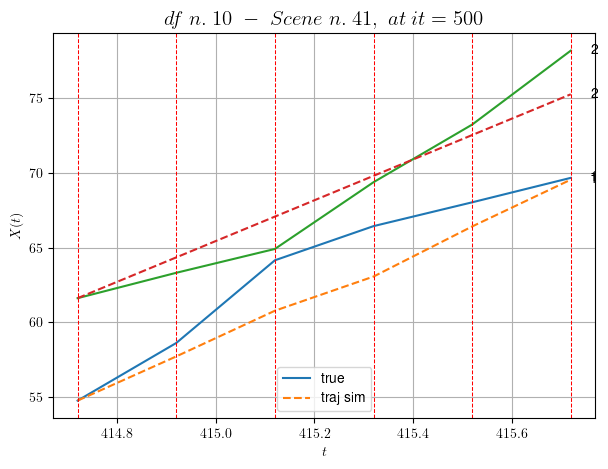

----------------------------------------------------------------------------------------------------
        For scene 10/49:
        * After LR finder: LR_NN=0.005 with mse=46.8836226989544 at it=24
        * v0 = 13.666087163341224
        * MSE = 3.44075128210086
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.11/49
----------------------------------------------------------------------------------------------------
We have 8 time intervals inside [116.72,118.32]


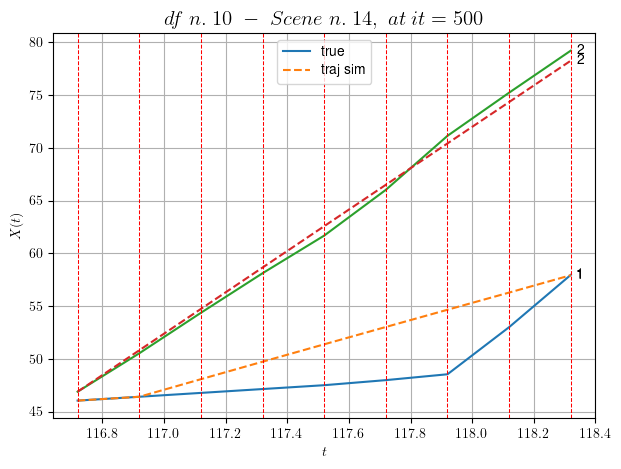

----------------------------------------------------------------------------------------------------
        For scene 11/49:
        * After LR finder: LR_NN=0.001 with mse=49.49620207255112 at it=24
        * v0 = 19.612707397568297
        * MSE = 5.566747396657866
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.12/49
----------------------------------------------------------------------------------------------------
We have 7 time intervals inside [71.72,73.12]


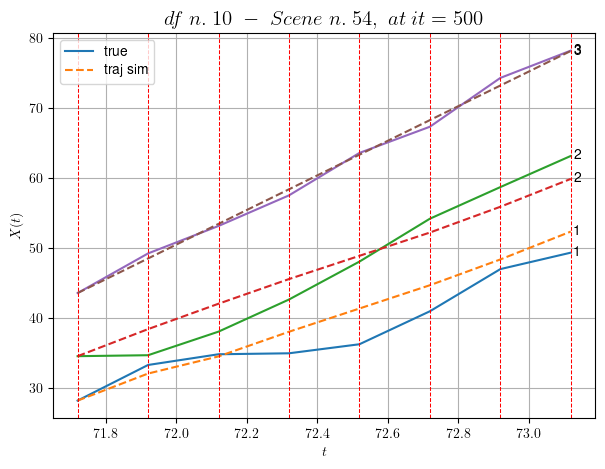

----------------------------------------------------------------------------------------------------
        For scene 12/49:
        * After LR finder: LR_NN=0.01 with mse=10.967451661531834 at it=24
        * v0 = 24.696180100224375
        * MSE = 4.97034790654362
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.13/49
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [41.32,41.92]


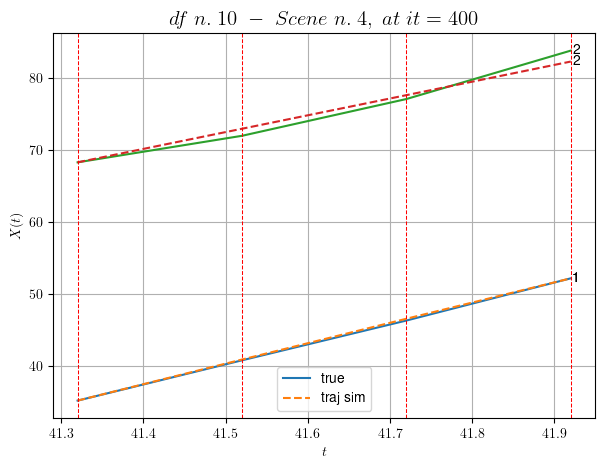

----------------------------------------------------------------------------------------------------
        For scene 13/49:
        * After LR finder: LR_NN=0.005 with mse=2.785530271529204 at it=24
        * v0 = 23.270817814815494
        * MSE = 0.39914088056532
        * iterations = 400
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.14/49
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [182.72,183.52]


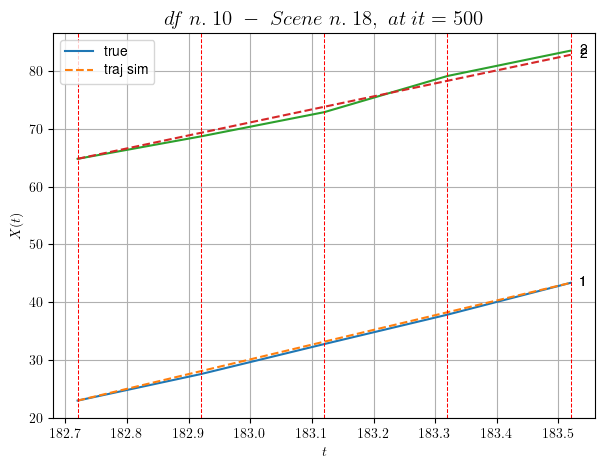

----------------------------------------------------------------------------------------------------
        For scene 14/49:
        * After LR finder: LR_NN=5e-05 with mse=6.215147987143662 at it=24
        * v0 = 22.50226017911424
        * MSE = 0.3054226939661585
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.15/49
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [410.32,410.72]


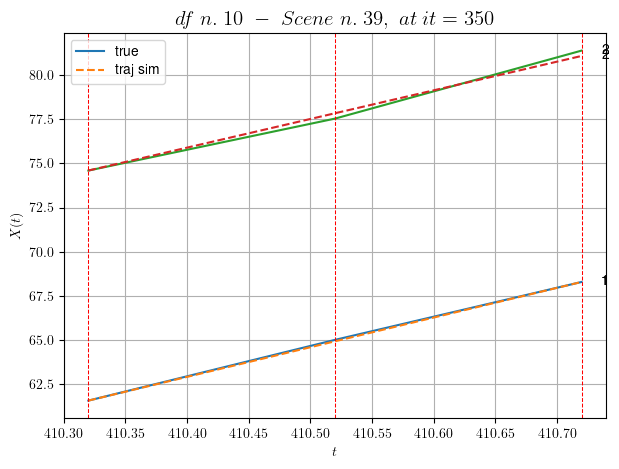

----------------------------------------------------------------------------------------------------
        For scene 15/49:
        * After LR finder: LR_NN=0.0005 with mse=6.056118163046017 at it=24
        * v0 = 16.2485221368002
        * MSE = 0.02855469600893061
        * iterations = 350
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.16/49
----------------------------------------------------------------------------------------------------
We have 8 time intervals inside [85.72,87.32]


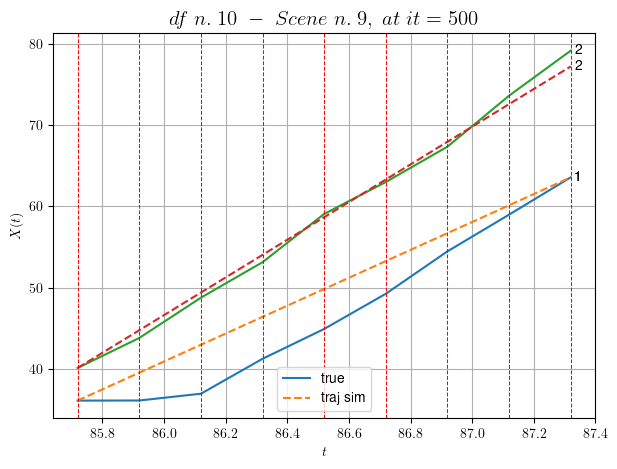

----------------------------------------------------------------------------------------------------
        For scene 16/49:
        * After LR finder: LR_NN=5e-05 with mse=21.283296110733342 at it=24
        * v0 = 23.19995130380224
        * MSE = 6.8864659448219125
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.17/49
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [210.12,210.52]


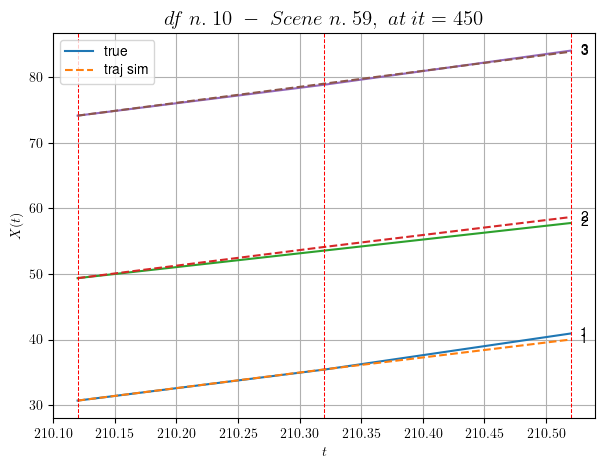

----------------------------------------------------------------------------------------------------
        For scene 17/49:
        * After LR finder: LR_NN=0.01 with mse=0.8940335604898673 at it=24
        * v0 = 24.382900546981606
        * MSE = 0.22474188056937702
        * iterations = 450
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.18/49
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [64.92,65.92]


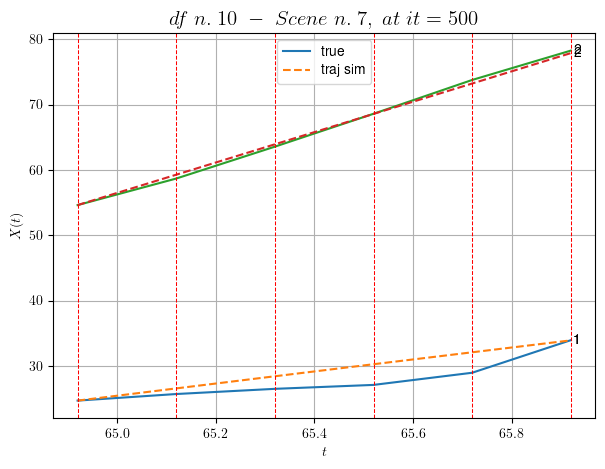

----------------------------------------------------------------------------------------------------
        For scene 18/49:
        * After LR finder: LR_NN=0.001 with mse=9.11181219066599 at it=24
        * v0 = 23.262500294243573
        * MSE = 2.0889938926967315
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.19/49
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [401.52,402.32]


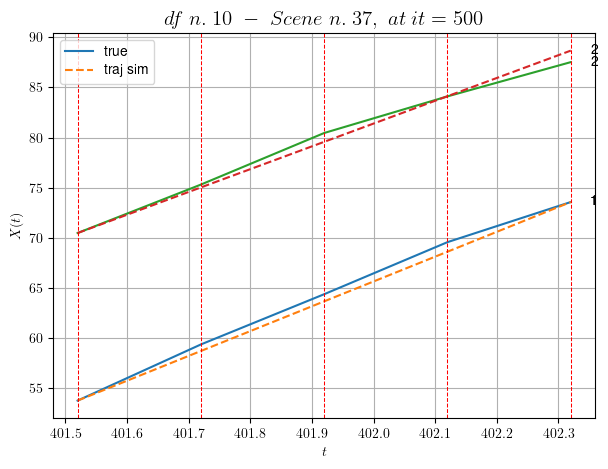

----------------------------------------------------------------------------------------------------
        For scene 19/49:
        * After LR finder: LR_NN=0.0001 with mse=7.383273337891079 at it=24
        * v0 = 22.732620950386917
        * MSE = 0.40161923694178403
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.20/49
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [376.92,377.52]


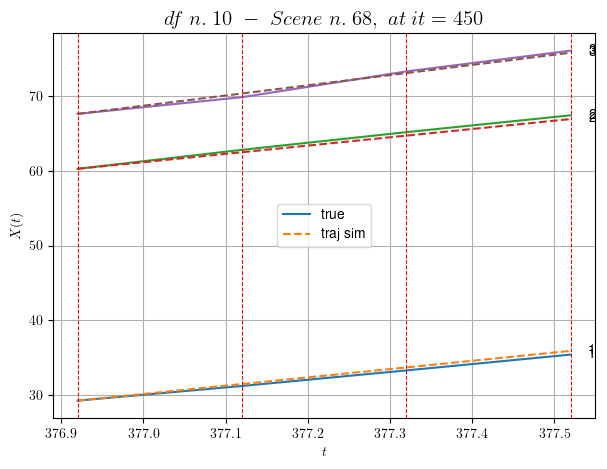

----------------------------------------------------------------------------------------------------
        For scene 20/49:
        * After LR finder: LR_NN=0.001 with mse=15.724037907163291 at it=24
        * v0 = 13.629669506315873
        * MSE = 0.1141586501193285
        * iterations = 450
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.21/49
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [120.92,121.52]


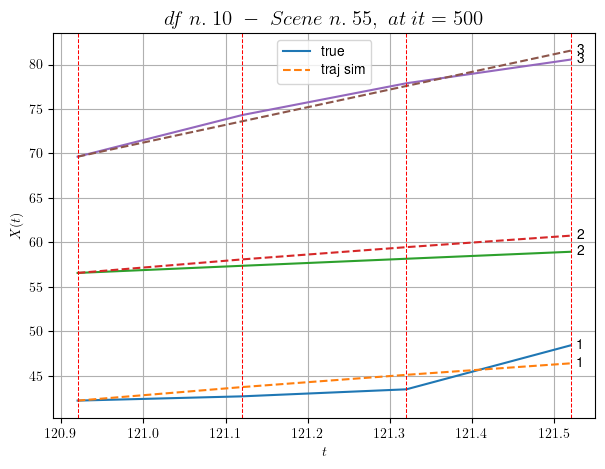

----------------------------------------------------------------------------------------------------
        For scene 21/49:
        * After LR finder: LR_NN=0.01 with mse=6.629893740145525 at it=24
        * v0 = 19.87543626344988
        * MSE = 1.2307045343644207
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.22/49
----------------------------------------------------------------------------------------------------
We have 14 time intervals inside [496.52,499.32]


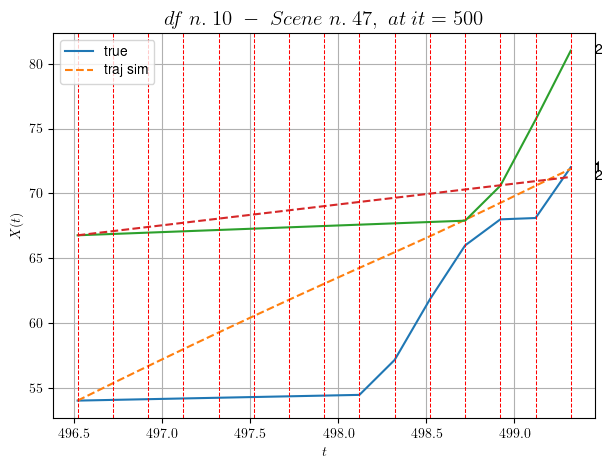

----------------------------------------------------------------------------------------------------
        For scene 22/49:
        * After LR finder: LR_NN=0.01 with mse=1072.365497014648 at it=24
        * v0 = 1.6060119985537813
        * MSE = 15.633845875240137
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.23/49
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [342.92,343.32]


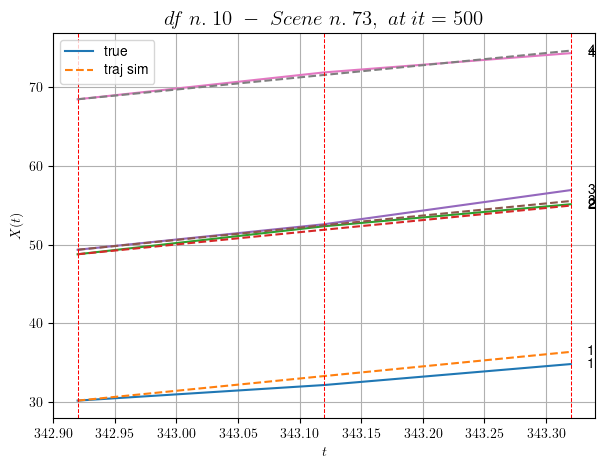

----------------------------------------------------------------------------------------------------
        For scene 23/49:
        * After LR finder: LR_NN=0.005 with mse=4.180619854356788 at it=24
        * v0 = 15.471537794288082
        * MSE = 0.5072195193019088
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.24/49
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [139.92,140.32]


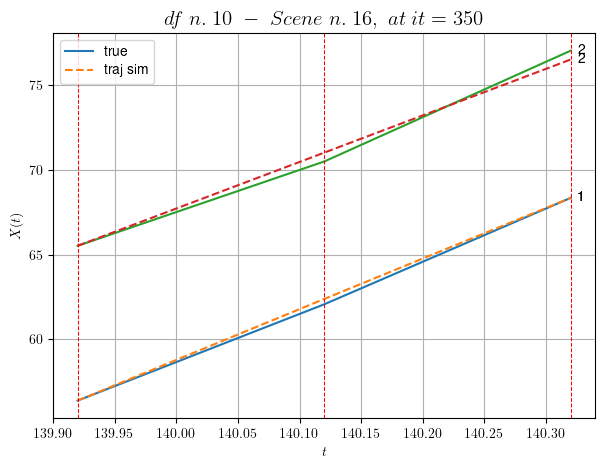

----------------------------------------------------------------------------------------------------
        For scene 24/49:
        * After LR finder: LR_NN=0.001 with mse=2.0739556587988934 at it=24
        * v0 = 27.422660991971668
        * MSE = 0.0984222712023499
        * iterations = 350
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.25/49
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [282.72,283.52]


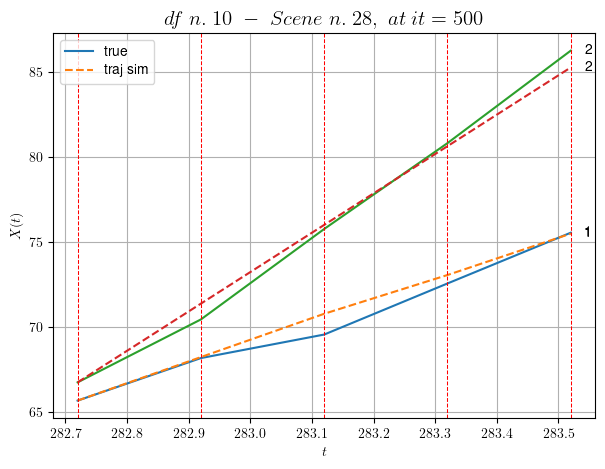

----------------------------------------------------------------------------------------------------
        For scene 25/49:
        * After LR finder: LR_NN=0.01 with mse=5.064316092662139 at it=24
        * v0 = 23.180355370996622
        * MSE = 0.36211471959973096
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.26/49
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [438.12,438.52]


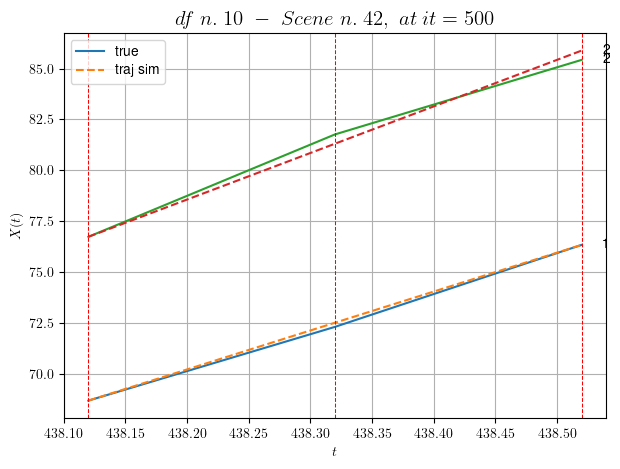

----------------------------------------------------------------------------------------------------
        For scene 26/49:
        * After LR finder: LR_NN=0.0005 with mse=1.9882424413162474 at it=24
        * v0 = 22.869527063595935
        * MSE = 0.07649419671275218
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.27/49
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [279.52,279.92]


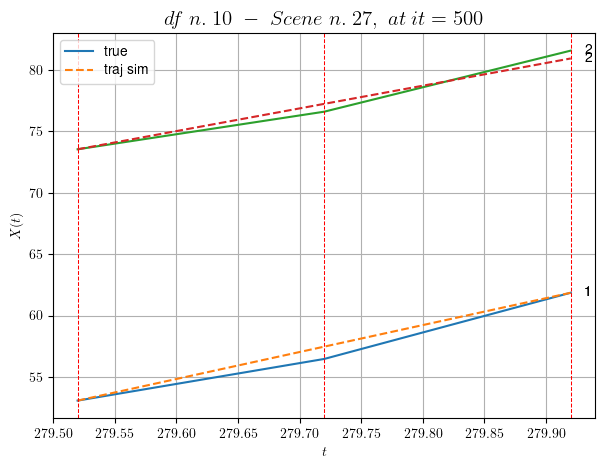

----------------------------------------------------------------------------------------------------
        For scene 27/49:
        * After LR finder: LR_NN=0.0001 with mse=4.297890880228872 at it=24
        * v0 = 18.485445092005165
        * MSE = 0.25638986552138426
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.28/49
----------------------------------------------------------------------------------------------------
We have 6 time intervals inside [541.32,542.52]


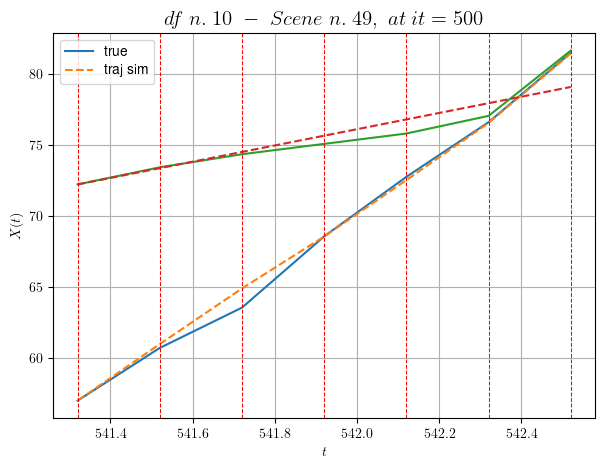

----------------------------------------------------------------------------------------------------
        For scene 28/49:
        * After LR finder: LR_NN=0.01 with mse=150.62251911892656 at it=24
        * v0 = 5.721147250846639
        * MSE = 0.7588899973890217
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.29/49
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [264.12,264.92]


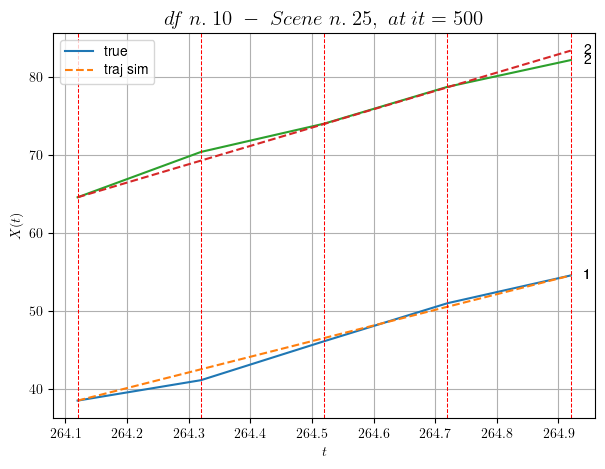

----------------------------------------------------------------------------------------------------
        For scene 29/49:
        * After LR finder: LR_NN=5e-05 with mse=6.503873217760646 at it=24
        * v0 = 23.45229191089271
        * MSE = 0.5008246710472287
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.30/49
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [321.12,321.92]


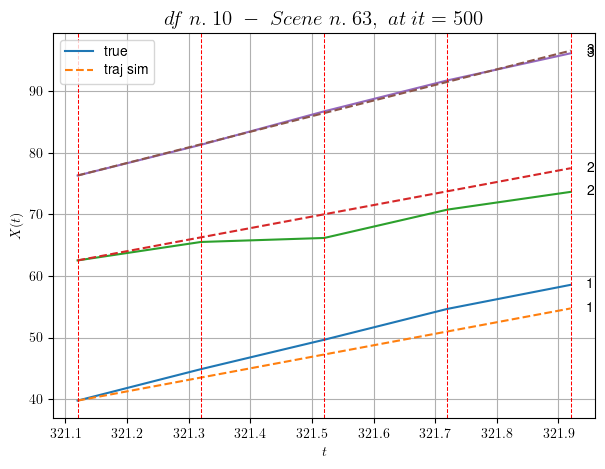

----------------------------------------------------------------------------------------------------
        For scene 30/49:
        * After LR finder: LR_NN=5e-05 with mse=4.6917097841117625 at it=24
        * v0 = 25.32842863555282
        * MSE = 4.992731204643373
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.31/49
----------------------------------------------------------------------------------------------------
We have 6 time intervals inside [370.92,372.12]


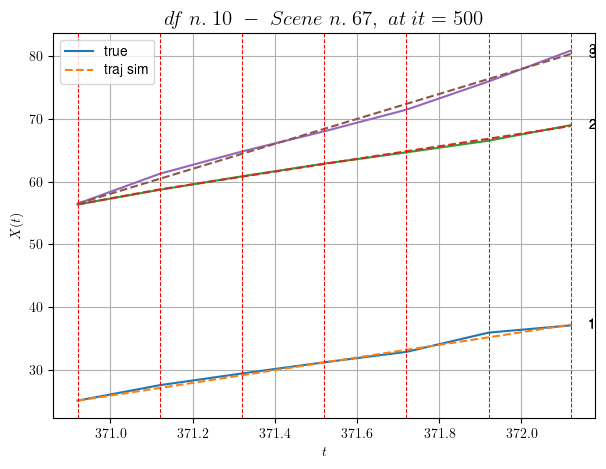

----------------------------------------------------------------------------------------------------
        For scene 31/49:
        * After LR finder: LR_NN=0.005 with mse=18.271121520086158 at it=24
        * v0 = 19.892120453787257
        * MSE = 0.15967562315488004
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.32/49
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [103.72,104.52]


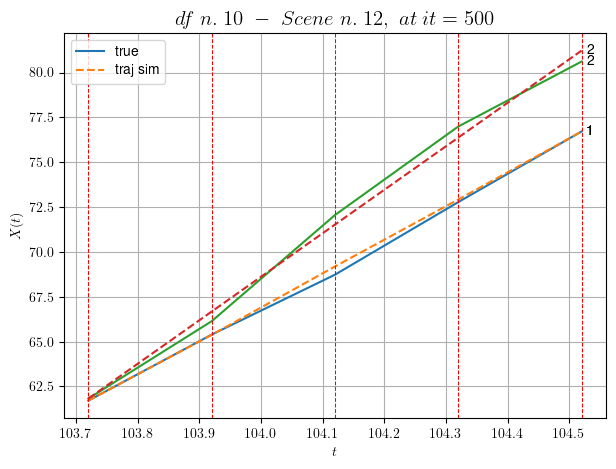

----------------------------------------------------------------------------------------------------
        For scene 32/49:
        * After LR finder: LR_NN=0.005 with mse=4.136377897887591 at it=24
        * v0 = 24.24265454583431
        * MSE = 0.15462083993490058
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.33/49
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [316.12,316.92]


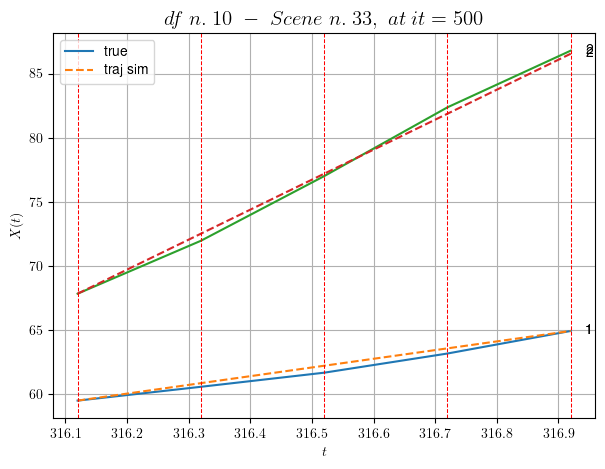

----------------------------------------------------------------------------------------------------
        For scene 33/49:
        * After LR finder: LR_NN=0.001 with mse=4.895245518743512 at it=24
        * v0 = 23.40156520227089
        * MSE = 0.11151260028694207
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.34/49
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [483.92,484.32]


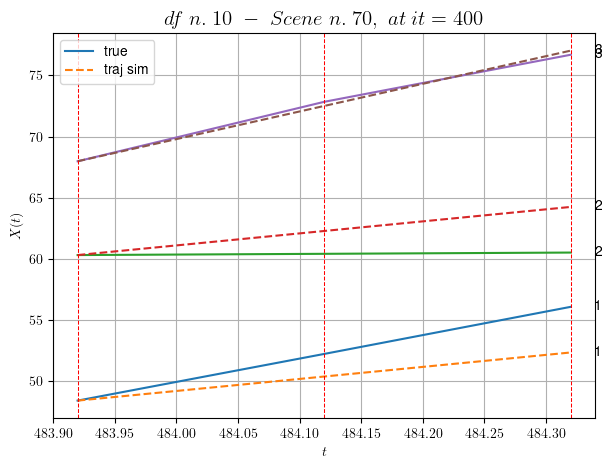

----------------------------------------------------------------------------------------------------
        For scene 34/49:
        * After LR finder: LR_NN=0.005 with mse=4.465321139874194 at it=24
        * v0 = 22.618926459958995
        * MSE = 3.886105025478237
        * iterations = 400
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.35/49
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [337.72,338.32]


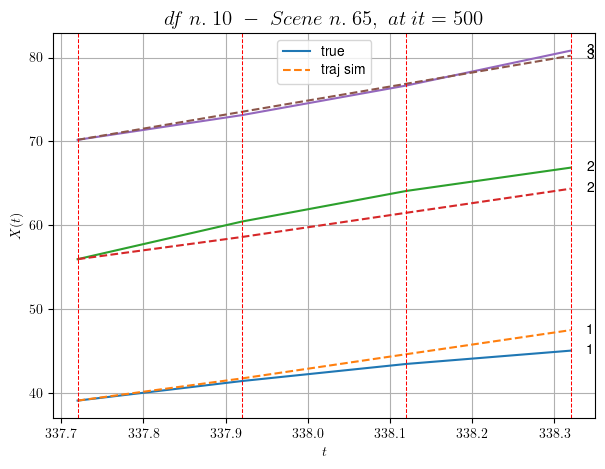

----------------------------------------------------------------------------------------------------
        For scene 35/49:
        * After LR finder: LR_NN=0.01 with mse=9.861290821015968 at it=24
        * v0 = 16.738444449806725
        * MSE = 2.04221135724995
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.36/49
----------------------------------------------------------------------------------------------------
We have 8 time intervals inside [403.52,405.12]


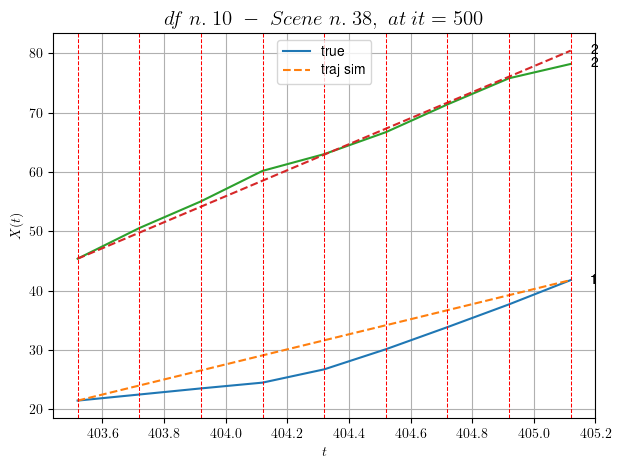

----------------------------------------------------------------------------------------------------
        For scene 36/49:
        * After LR finder: LR_NN=0.0001 with mse=36.853590152034485 at it=24
        * v0 = 21.916705677642515
        * MSE = 5.16625535700568
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.37/49
----------------------------------------------------------------------------------------------------
We have 4 time intervals inside [303.52,304.32]


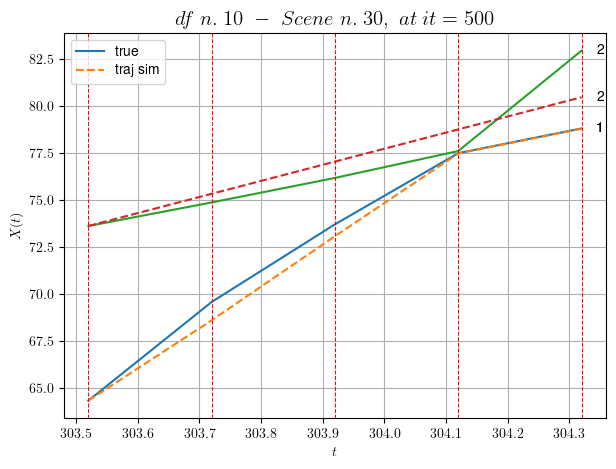

----------------------------------------------------------------------------------------------------
        For scene 37/49:
        * After LR finder: LR_NN=0.005 with mse=52.48865002517471 at it=24
        * v0 = 8.561224404570524
        * MSE = 0.9432152473832678
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.38/49
----------------------------------------------------------------------------------------------------
We have 6 time intervals inside [473.52,474.72]


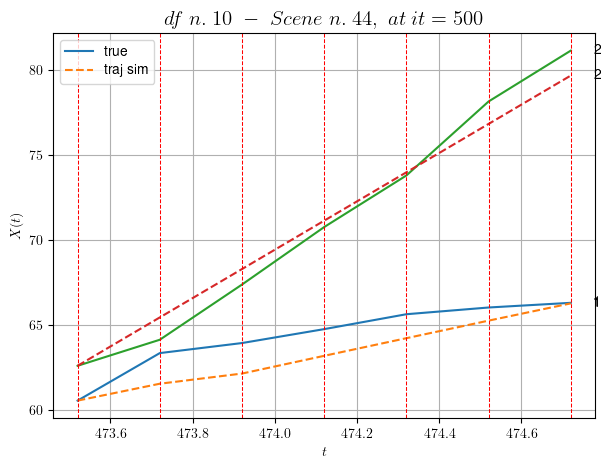

----------------------------------------------------------------------------------------------------
        For scene 38/49:
        * After LR finder: LR_NN=0.005 with mse=61.05319318621796 at it=24
        * v0 = 14.20936957568644
        * MSE = 1.1571998691081606
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.39/49
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [433.52,434.12]


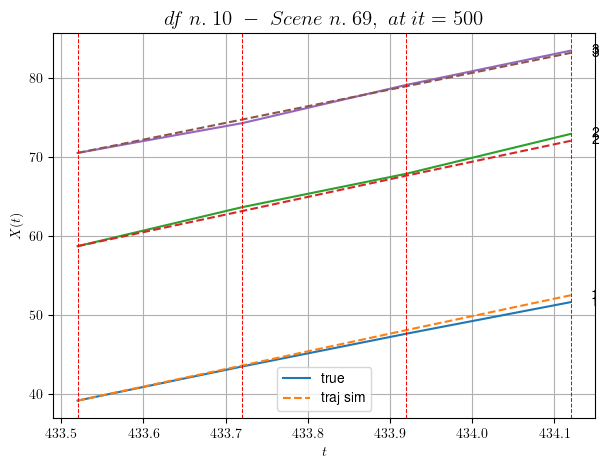

----------------------------------------------------------------------------------------------------
        For scene 39/49:
        * After LR finder: LR_NN=0.005 with mse=3.6807884745725694 at it=24
        * v0 = 21.095678523799847
        * MSE = 0.1948455228250202
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.40/49
----------------------------------------------------------------------------------------------------
We have 5 time intervals inside [24.52,25.52]


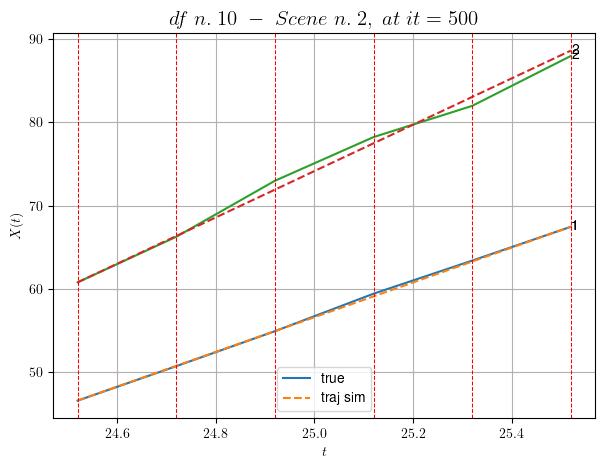

----------------------------------------------------------------------------------------------------
        For scene 40/49:
        * After LR finder: LR_NN=0.001 with mse=1.3694913689613655 at it=24
        * v0 = 27.846729228086406
        * MSE = 0.281983568229891
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.41/49
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [25.72,26.12]


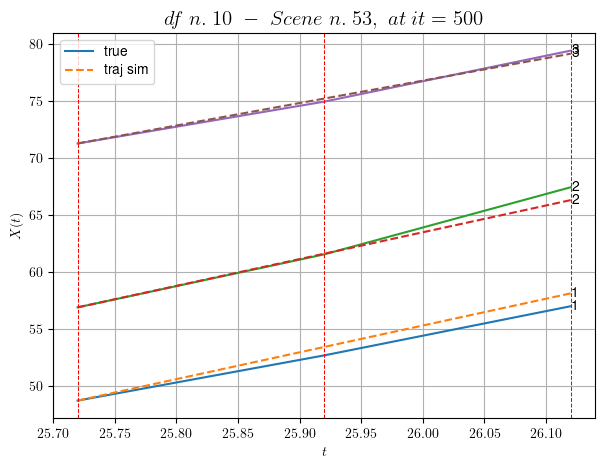

----------------------------------------------------------------------------------------------------
        For scene 41/49:
        * After LR finder: LR_NN=0.0001 with mse=2.7451041479644647 at it=24
        * v0 = 19.70878358322816
        * MSE = 0.35201976253660566
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.42/49
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [214.72,215.32]


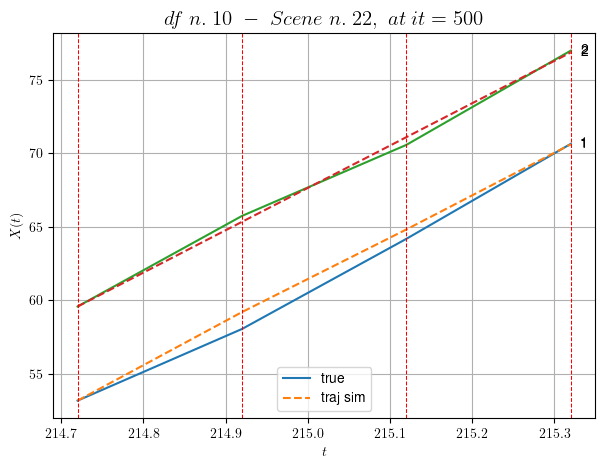

----------------------------------------------------------------------------------------------------
        For scene 42/49:
        * After LR finder: LR_NN=0.005 with mse=0.4287703192201309 at it=24
        * v0 = 28.844117231533595
        * MSE = 0.26620436999250824
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.43/49
----------------------------------------------------------------------------------------------------
We have 7 time intervals inside [34.92,36.32]


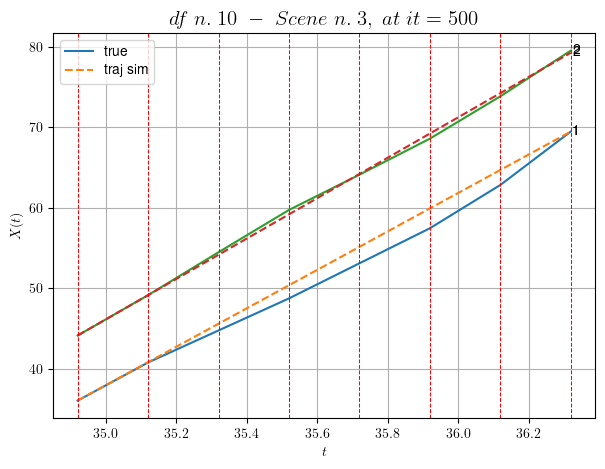

----------------------------------------------------------------------------------------------------
        For scene 43/49:
        * After LR finder: LR_NN=5e-05 with mse=9.001776041984746 at it=24
        * v0 = 25.102289962227577
        * MSE = 1.1337827553999817
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.44/49
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [235.52,235.92]


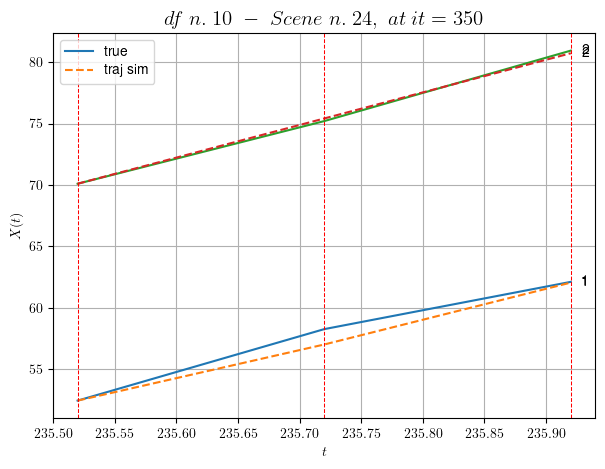

----------------------------------------------------------------------------------------------------
        For scene 44/49:
        * After LR finder: LR_NN=0.005 with mse=0.6556887283637647 at it=24
        * v0 = 26.56953143155122
        * MSE = 0.27659276985569736
        * iterations = 350
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.45/49
----------------------------------------------------------------------------------------------------
We have 6 time intervals inside [209.32,210.52]


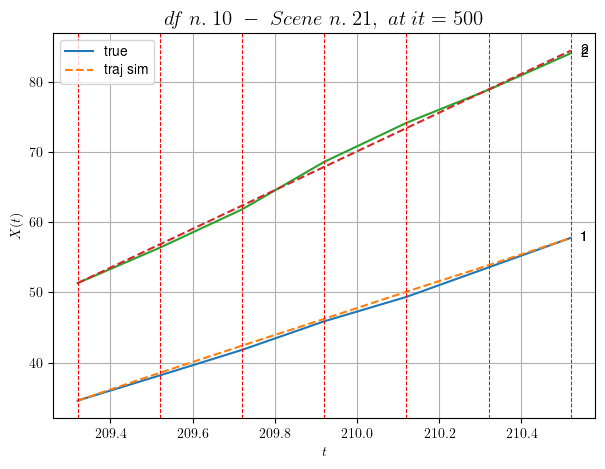

----------------------------------------------------------------------------------------------------
        For scene 45/49:
        * After LR finder: LR_NN=0.01 with mse=1.6562254540329333 at it=24
        * v0 = 27.594562747146554
        * MSE = 0.21320897284929521
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.46/49
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [237.72,238.12]


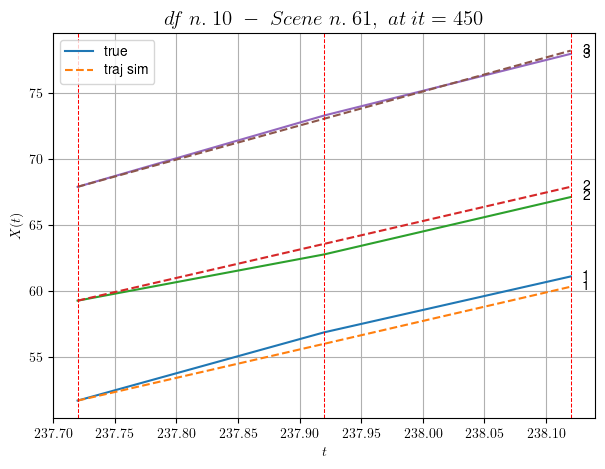

----------------------------------------------------------------------------------------------------
        For scene 46/49:
        * After LR finder: LR_NN=0.01 with mse=0.734921833937736 at it=24
        * v0 = 25.832593273219228
        * MSE = 0.30329594794166853
        * iterations = 450
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.47/49
----------------------------------------------------------------------------------------------------
We have 3 time intervals inside [202.52,203.12]


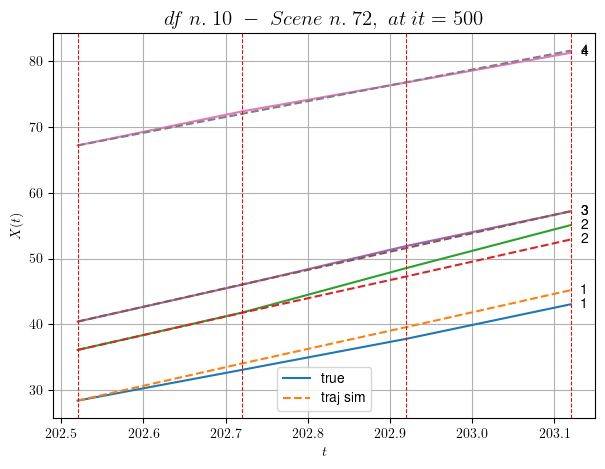

----------------------------------------------------------------------------------------------------
        For scene 47/49:
        * After LR finder: LR_NN=0.005 with mse=2.281265995394446 at it=24
        * v0 = 24.014144704148425
        * MSE = 0.9659835114880901
        * iterations = 500
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.48/49
----------------------------------------------------------------------------------------------------
We have 2 time intervals inside [118.92,119.32]


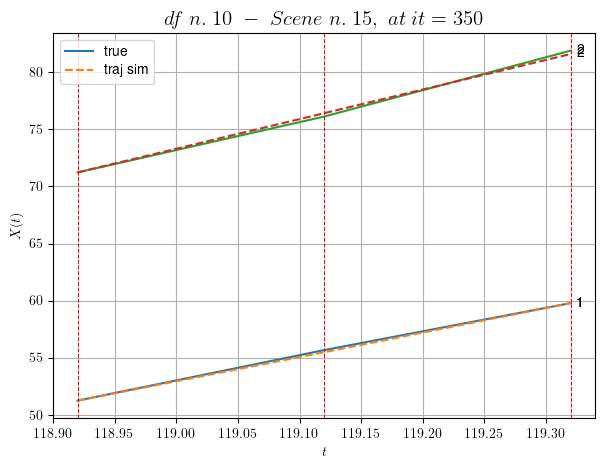

----------------------------------------------------------------------------------------------------
        For scene 48/49:
        * After LR finder: LR_NN=0.005 with mse=0.49765207899100683 at it=24
        * v0 = 25.969534482224404
        * MSE = 0.032061898858828
        * iterations = 350
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.49/49
----------------------------------------------------------------------------------------------------
We have 8 time intervals inside [578.92,580.52]


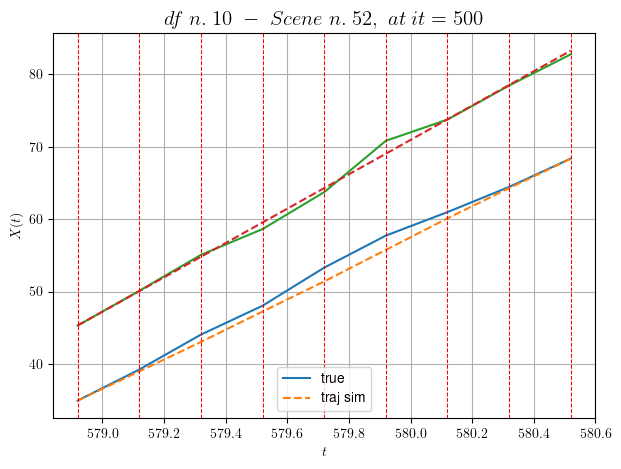

----------------------------------------------------------------------------------------------------
        For scene 49/49:
        * After LR finder: LR_NN=0.01 with mse=18.442680241235134 at it=24
        * v0 = 23.728017954301446
        * MSE = 0.6428436280389089
        * iterations = 500
----------------------------------------------------------------------------------------------------


MSE train: 1.829717771324087
- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -

Testing step. (25 scenes)
DataFrame n.10. Scene n.1/25


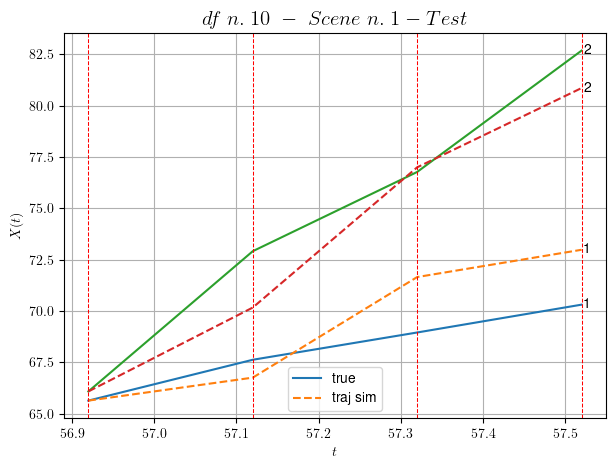

        For scene 1/25:
        * MSE = 3.263359673780811
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.2/25


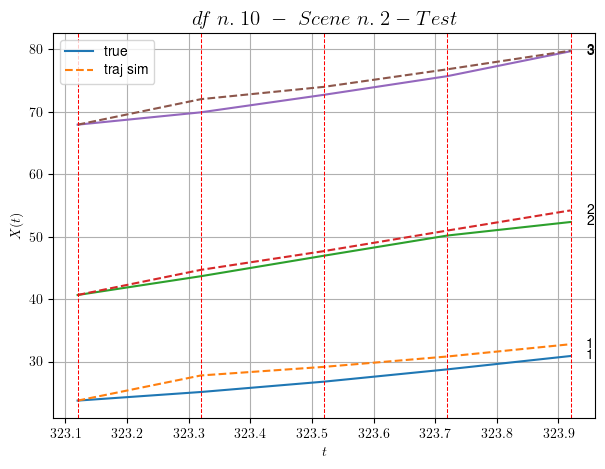

        For scene 2/25:
        * MSE = 2.2258994586245944
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.3/25


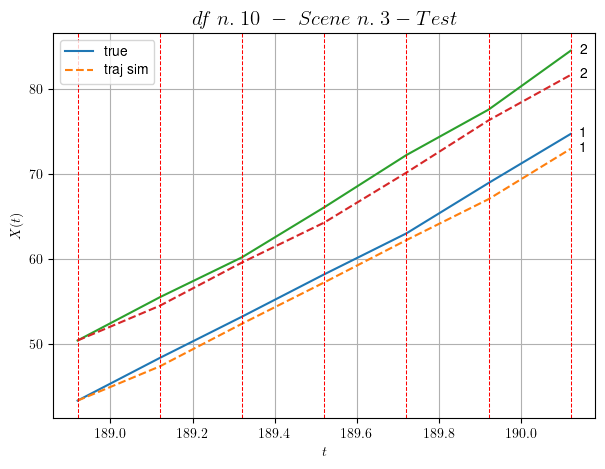

        For scene 3/25:
        * MSE = 2.035934918856773
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.4/25


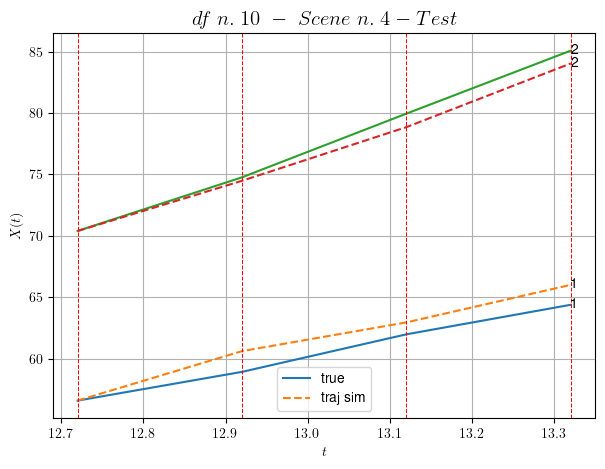

        For scene 4/25:
        * MSE = 1.1011945162266532
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.5/25


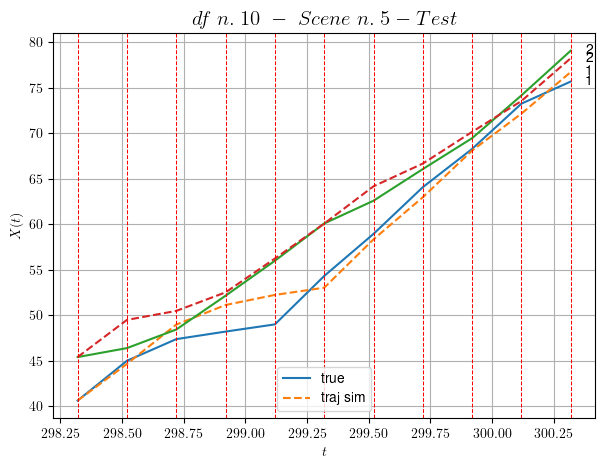

        For scene 5/25:
        * MSE = 2.076036858417549
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.6/25


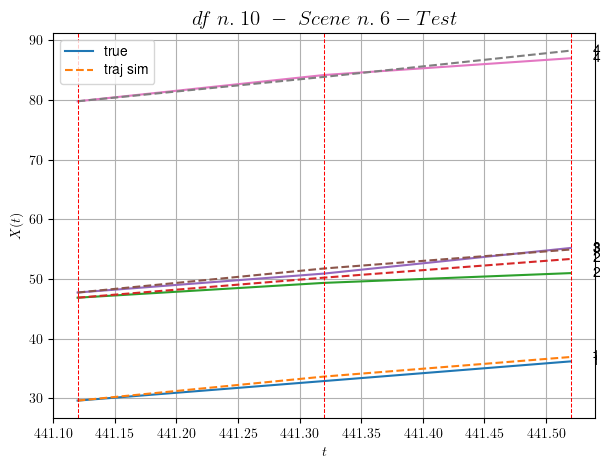

        For scene 6/25:
        * MSE = 0.8341983212640338
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.7/25


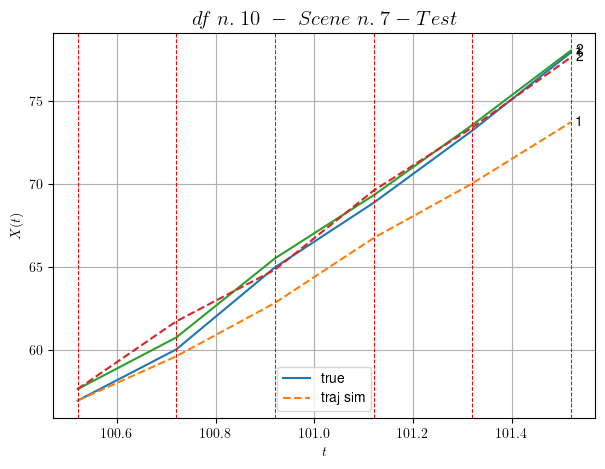

        For scene 7/25:
        * MSE = 3.2345493287205693
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.8/25


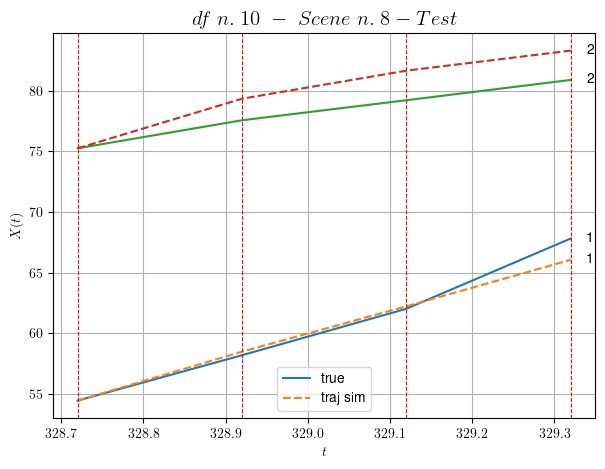

        For scene 8/25:
        * MSE = 2.2682519405406065
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.9/25


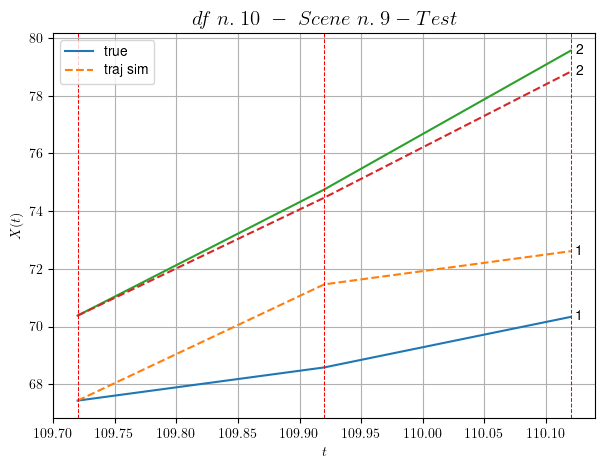

        For scene 9/25:
        * MSE = 2.347271906255399
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.10/25


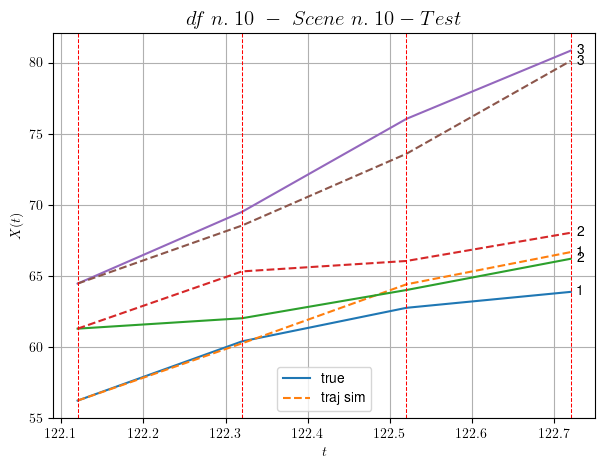

        For scene 10/25:
        * MSE = 3.037265544074787
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.11/25


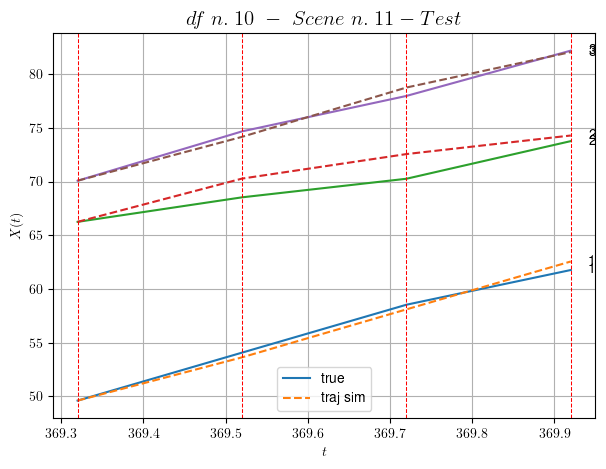

        For scene 11/25:
        * MSE = 0.8755071205565416
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.12/25


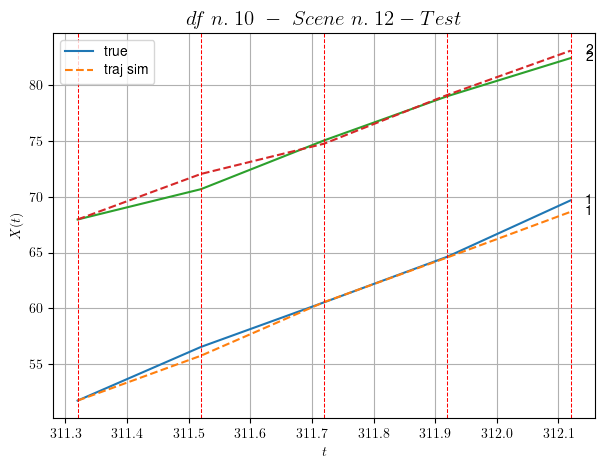

        For scene 12/25:
        * MSE = 0.4093320059848916
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.13/25


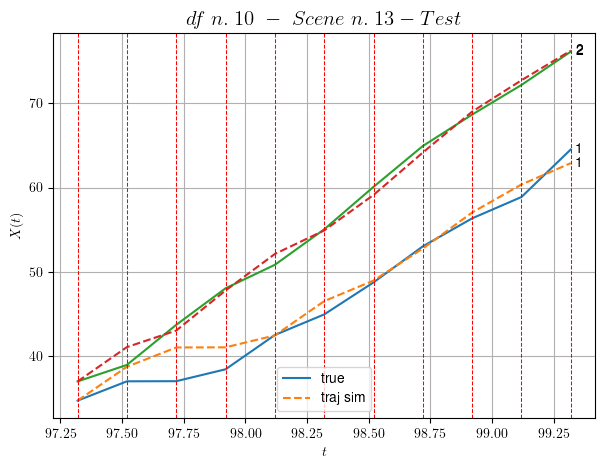

        For scene 13/25:
        * MSE = 1.936521918782398
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.14/25


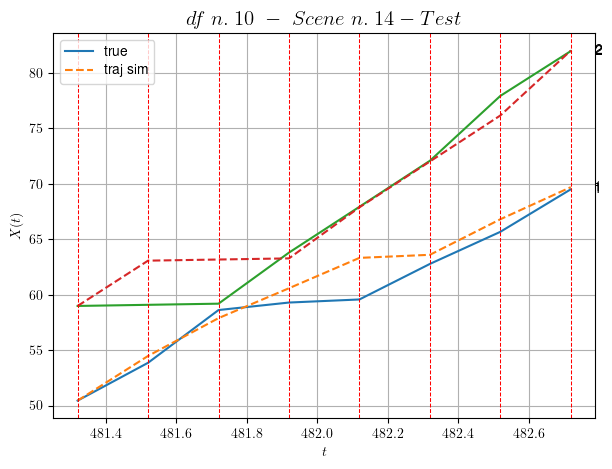

        For scene 14/25:
        * MSE = 3.361789964642613
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.15/25


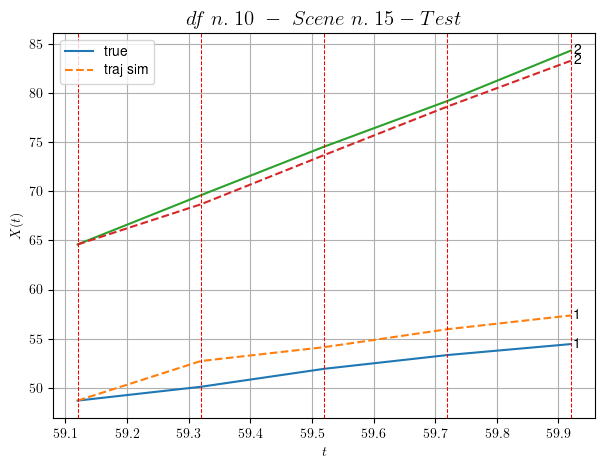

        For scene 15/25:
        * MSE = 3.008943692388792
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.16/25


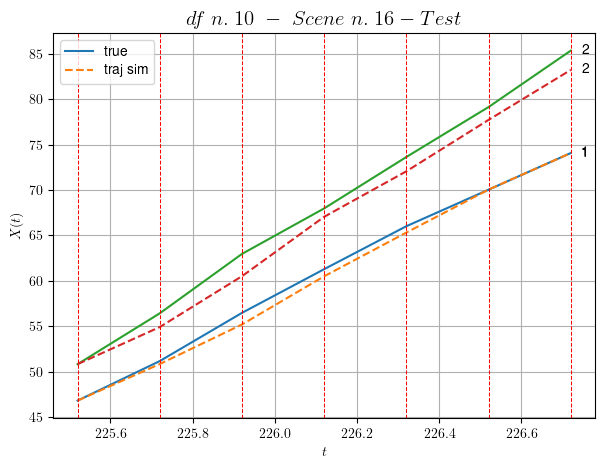

        For scene 16/25:
        * MSE = 1.5005689774991438
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.17/25


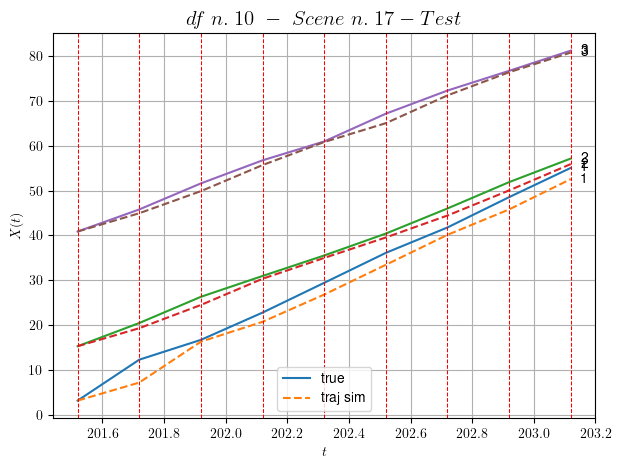

        For scene 17/25:
        * MSE = 3.155595353956381
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.18/25


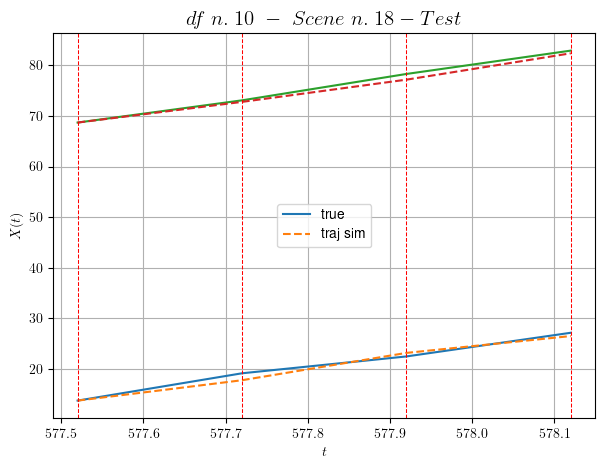

        For scene 18/25:
        * MSE = 0.5544982800871214
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.19/25


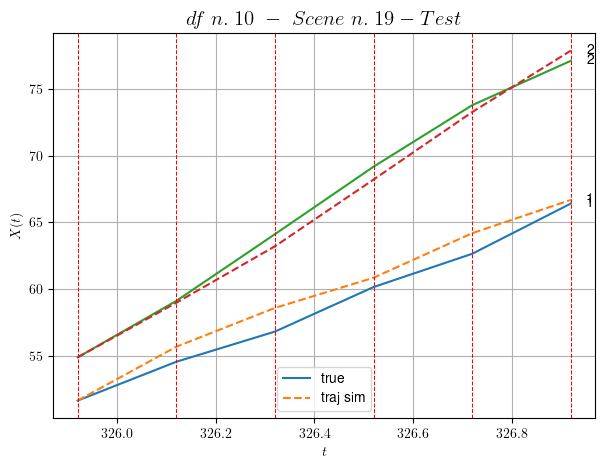

        For scene 19/25:
        * MSE = 0.8290016161056444
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.20/25


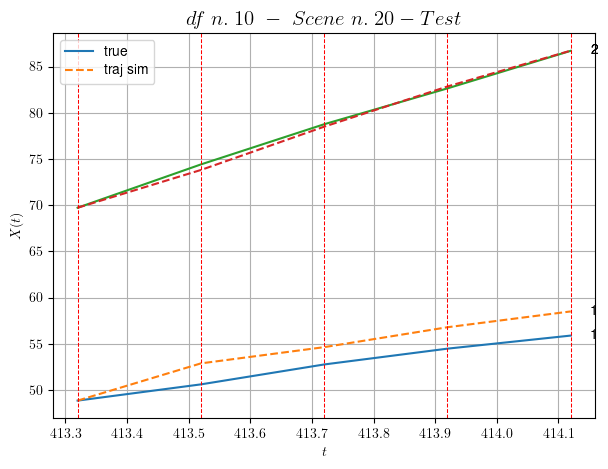

        For scene 20/25:
        * MSE = 2.135191089412535
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.21/25


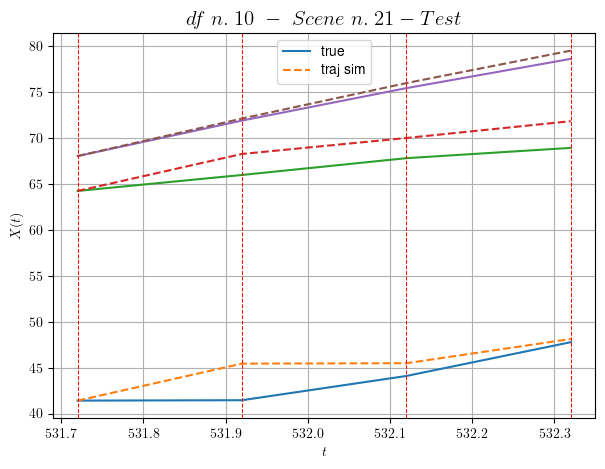

        For scene 21/25:
        * MSE = 3.135860647828198
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.22/25


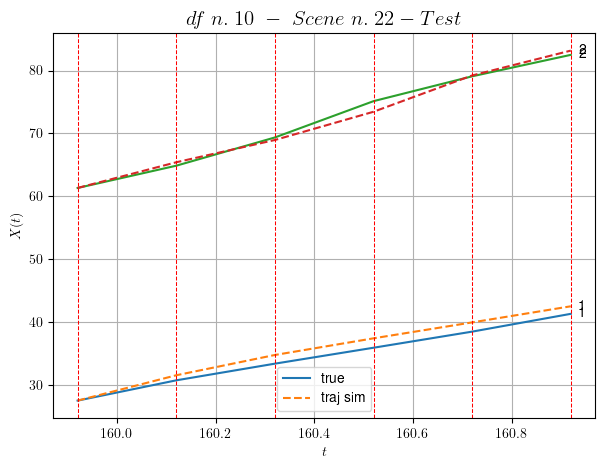

        For scene 22/25:
        * MSE = 1.0132942167884729
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.23/25


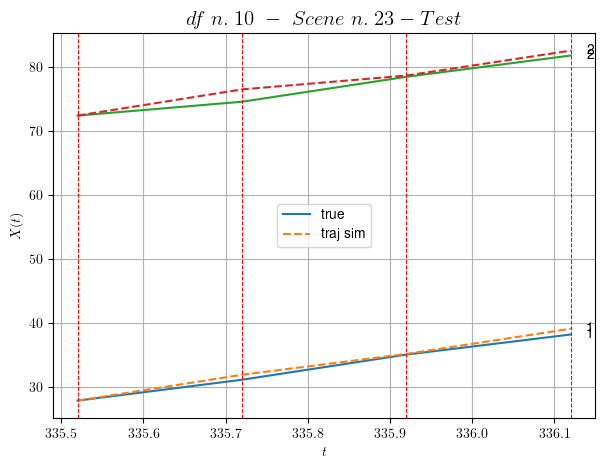

        For scene 23/25:
        * MSE = 0.717483974246919
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.24/25


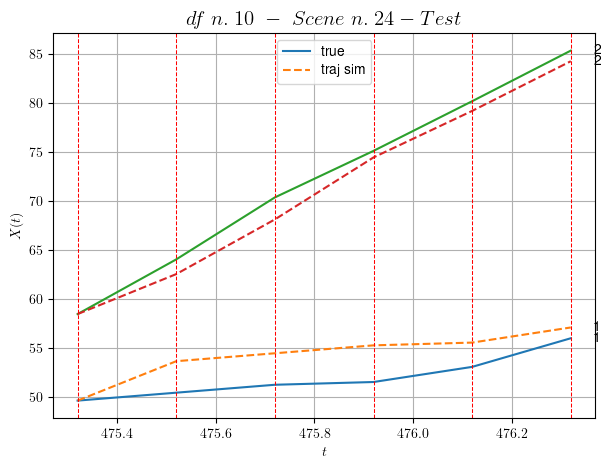

        For scene 24/25:
        * MSE = 4.340364448699708
----------------------------------------------------------------------------------------------------


DataFrame n.10. Scene n.25/25


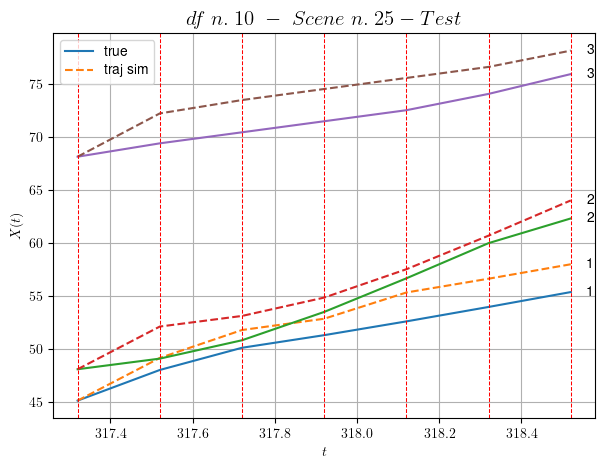

        For scene 25/25:
        * MSE = 4.547416634284892
----------------------------------------------------------------------------------------------------


MSE test: 2.157813296321041

- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -

    Summing up:
          * MSE train: 1.829717771324087
          * MSE test: 2.157813296321041
          
- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -- -






In [6]:
info_nn, model_trained = solve_nn_dataset(dataset, DOE, v0, processed_flag, NUM_ITER, LEARNING_RATE_v0,
                                           test, plot_flag)

In [7]:
get_stats(model_trained)


-------------------- Model Summary --------------------
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 Hidden-Layer-1 (Dense)      (None, 2)                 4         
                                                                 
 Hidden-Layer-2 (Dense)      (None, 2)                 6         
                                                                 
 Output-Layer (Dense)        (None, 1)                 2         
                                                                 
Total params: 12 (48.00 Byte)
Trainable params: 12 (48.00 Byte)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________

-------------------- Weights and Biases --------------------
Layer:  Hidden-Layer-1
  --Kernels (Weights): 
[[-53.334366   -5.0880685]]
  --Biases: 
[-1.8207027  3.2571864]

Layer:  Hidden-Layer-2
  --Kernels (Weights): 
[[-43.8

## Plot

### Leading velocity $v_{0}$

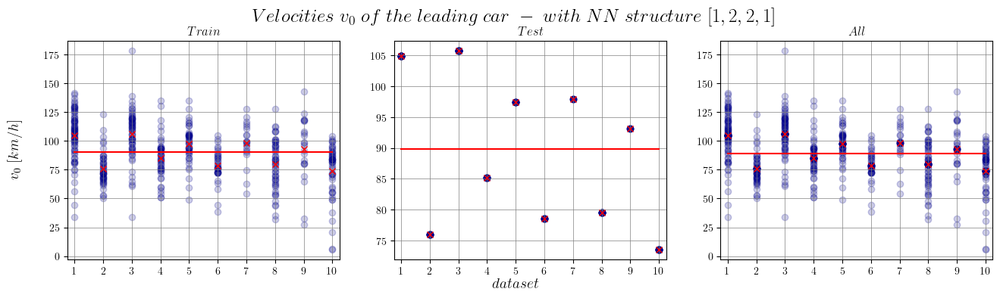

In [8]:
# Initialize the fig
nrow, ncol = 1, 3
width, height = 7, 5 # single subplot
fig, axes = plt.subplots(nrow,ncol,figsize=(width*ncol*.75,height*.75))

ms2kmh = 3.6

info_train = info_nn[info_nn["type"] == "train"]
info_test = info_nn[info_nn["type"] == "test"]
info_grouped = info_nn.groupby(['N. file', 'type']).mean(numeric_only=True)
info_grouped2 = info_nn.groupby(['N. file']).mean(numeric_only=True)
info_avg = info_nn.groupby(['type']).mean(numeric_only=True)

# For each scene, plot v0 mean
for _, scn in info_train.iterrows():
    axes[0].scatter(scn['N. file'], scn['v0']*ms2kmh, alpha = .2, color = 'darkblue');
    
for _, scn in info_test.iterrows():
    axes[1].scatter(scn['N. file'], scn['v0']*ms2kmh, alpha = .2, color = 'darkblue');

# Avg value
for (nf,typef), infof in info_grouped.iterrows():
    
    if typef == "train":
        axes[0].plot(nf, infof['v0']*ms2kmh, color = 'r', marker="x")
        
    if typef == "test":
        axes[1].plot(nf, infof['v0']*ms2kmh, color = 'r', marker="x")

# For each scene, plot v0 mean
for _, scn in info_nn.iterrows():
    axes[2].scatter(scn['N. file'], scn['v0']*ms2kmh, alpha = .2, color = 'darkblue');

# For a dataset, plot v0 mean (averaging v0 mean in all the scenes)
for nf, p in info_grouped2.iterrows():
    axes[2].plot(nf, p['v0']*ms2kmh, color = 'r', marker="x")

# Plot v0 mean over all dfs
alldfs = [a for a, _ in info_nn.groupby('N. file')]
v0_mean = np.mean([ infof['v0']*ms2kmh for _, infof in info_grouped.iterrows()])
axes[0].plot(alldfs, [info_avg['v0']['train']*ms2kmh]*len(alldfs), color = 'r')  
axes[1].plot(alldfs, [info_avg['v0']['test']*ms2kmh]*len(alldfs), color = 'r')  
axes[2].plot(alldfs, [v0_mean]*len(alldfs), color = 'r')  

# labeling     
axes[0].set_title(fr"$Train$",fontsize=12)
axes[1].set_title(fr"$Test$",fontsize=12)
axes[2].set_title(fr"$All$",fontsize=12)
fig.supxlabel(r"$data set$",fontsize=14, y=0.0005)
fig.supylabel(r"$v_{0}\ [km/h]$",fontsize=14, x = 0.075)
plt.suptitle(fr"$Velocities\ v_{0}\ of\ the\ leading\ car\ -\ with\ NN\ structure\ {str(DOE)}$",
             fontsize=18, y=1)

# Setting the values for all axes.
custom_xlim = (0.75,10.25)
custom_xticks = range(1,11)
plt.setp(axes, xlim=custom_xlim, xticks=custom_xticks)

axes[0].grid(color='grey', linestyle='-', linewidth=0.5);
axes[1].grid(color='grey', linestyle='-', linewidth=0.5);
axes[2].grid(color='grey', linestyle='-', linewidth=0.5);

plt.show()

### Test 1: `cons_dis` vs `velocities`

In [9]:
Nx = 10
Nt = 100
T = 0.5

In [10]:
# Intial positions and consecutive distances
## Space
rng = np.random.default_rng(12345)
a = rng.uniform(-1, 0, int(Nx/3)+1)
b = rng.uniform(0, 1, 2*int(Nx/3))

my_rnd = np.concatenate([a, b])

# Check if sorted
if all(my_rnd[i] <= my_rnd[i+1] for i in range(len(my_rnd) - 1)):
    print("All the vehicles are sorted")
    X = m_rnd
else:
    print("There's at least a vehicle not sorted")
    X = my_rnd.copy()
    X.sort()
    
cons_dis = np.diff(X, axis=0)  # Consecutive distances of vehicles in this scene

##Time
tspan = np.linspace(0,T,Nt)

There's at least a vehicle not sorted


In [11]:
## Compute the velocities
y_pred = model_trained(cons_dis, training=False)
v0 = y_pred.numpy().mean() # Approximate the velocity of the leading car ?
vel_nn = y_pred.numpy().flatten().tolist() + [v0]

# check
if all(i >= v0 for i in y_pred):
    print("There is at least a vehicle faster than the leading car")   

In [12]:
y_pred

<tf.Tensor: shape=(9, 1), dtype=float32, numpy=
array([[0.15851359],
       [3.0621471 ],
       [0.23731197],
       [3.8512833 ],
       [0.3236466 ],
       [0.10461845],
       [0.6712209 ],
       [0.13027735],
       [1.3236927 ]], dtype=float32)>

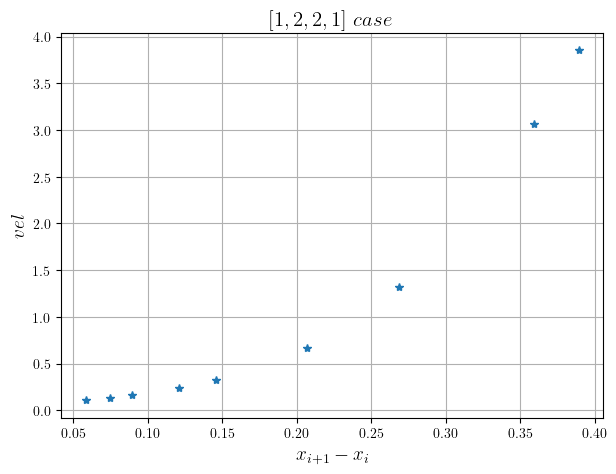

In [13]:
# Create a figure and axis for the plot
width, height = 7, 5
fig, ax = plt.subplots(1,1,figsize=(width, height))

# Plot
ax.plot(cons_dis,vel_nn[:-1], marker="*", linestyle='None') # there's no car in front of the leading one

ax.set_xlabel("$x_{i+1} - x_{i}$", fontsize=14)
ax.set_ylabel("$vel$", fontsize=14)
ax.set_title(fr"${str(DOE)}\ case$", fontsize=15)
ax.grid()
    
plt.show()

### Test 2: `cons_dis` vs `velocities`

In [14]:
Nx = 100
Nt = 100
T = 0.5

In [15]:
# Intial positions and consecutive distances
## Space
rng = np.random.default_rng(12345)
a = rng.uniform(-1, 0, int(Nx/3)+1)
b = rng.uniform(0, 1, 2*int(Nx/3))

my_rnd = np.concatenate([a, b])

# Check if sorted
if all(my_rnd[i] <= my_rnd[i+1] for i in range(len(my_rnd) - 1)):
    print("All the vehicles are sorted")
    X = m_rnd
else:
    print("There's at least a vehicle not sorted")
    X = my_rnd.copy()
    X.sort()
    
cons_dis = np.diff(X, axis=0)  # Consecutive distances of vehicles in this scene

##Time
tspan = np.linspace(0,T,Nt)

There's at least a vehicle not sorted


In [16]:
## Compute the velocities
y_pred = model_trained(cons_dis, training=False)
v0 = y_pred.numpy().mean() # Approximate the velocity of the leading car ?
vel_nn = y_pred.numpy().flatten().tolist() + [v0]

# check
if all(i >= v0 for i in y_pred):
    print("There is at least a vehicle faster than the leading car")   

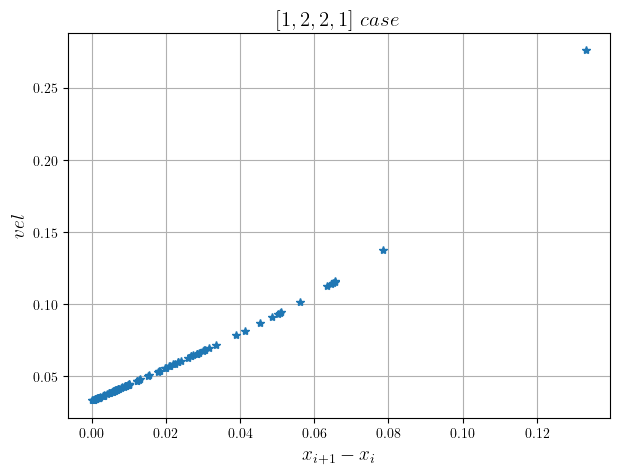

In [17]:
# Create a figure and axis for the plot
width, height = 7, 5
fig, ax = plt.subplots(1,1,figsize=(width, height))

# Plot
ax.plot(cons_dis,vel_nn[:-1], marker="*", linestyle='None') # there's no car in front of the leading one

ax.set_xlabel("$x_{i+1} - x_{i}$", fontsize=14)
ax.set_ylabel("$vel$", fontsize=14)
ax.set_title(fr"${str(DOE)}\ case$", fontsize=15)
ax.grid()
    
plt.show()

## Prepare the out dir

In [18]:
# Create the directory..
if flag_save:
    
    df_seen = [df['N. file'][0] for df in dataset]
    df_seen_str = '-'.join(str(x) for x in df_seen)
    
    # Create directory where to save the image
    now = datetime.now() 
    d = now.strftime(f"%Y-%m-%d_%H-%M-%S_df{df_seen_str}_{NUM_ITER}it-PRE-nn{str(DOE)}")
    
    path = 'out/' + d
    os.mkdir(path)
    
    # Save the solution in a file
    namefile = '/info_nn.txt'

    with open(path + namefile, 'w') as output:
        info_nn.to_csv(path + namefile, sep=',', index=False)
        
    # Save model in a file
    namefile_model = '/model_nn.keras'
    model_trained.compile(optimizer='SGD', loss='MAE')
    model_trained.save(path + namefile_model)  # The file needs to end with the .keras extension